<a href="https://colab.research.google.com/github/Sajini29/-Risk-of-Giving-Advances-in-the-Tea-Brokerage-Industry/blob/main/ARIMA_Model_Risk_of_Giving_Advances_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Here, the ARIMA Model was built. The factories were divided into 4 groups and then take a sample form them and build the ARIMA model for each of them.

In [1]:
# mount drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!ls "/content/drive/MyDrive/Asia Siyaka"

 Advancing__Preprossed.csv			    Final02_DroppedAfterDecomposition.csv
'Building Risk indicator_Test02.csv'		    Final_02_Preprossed.csv
'Building Risk indicator_Test02_intermidiate.csv'   Final02_RowRiskIndicator.csv
 DropNot_tuesday_riskIndicator.csv		   'Monte Carlo Function.csv'
 Drop_Tuesday.csv				   'risk indicator 01.csv'
 Drop_tuesday_risk_test_01.csv			   'risk indicator 02.csv'
 file.csv					    RowRiskIndicator.csv
 Final_01.csv					    SaleData_Factory_2023.csv
 FINAL_02.csv


In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
import pandas as pd
import numpy as np

Here I used the dataset which I create the risk indicatoe by assigning weights, insted of the dataset that created using factor analysis


In [5]:
csv_file1 = "/content/drive/MyDrive/Asia Siyaka/Final02_RowRiskIndicator.csv"

df = pd.read_csv(csv_file1)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33518 entries, 0 to 33517
Data columns (total 16 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   TCode                    33518 non-null  object 
 1   Average                  33518 non-null  float64
 2   Stock                    33518 non-null  float64
 3   StockValue               33518 non-null  float64
 4   70%StockValue            33518 non-null  float64
 5   Proceeds                 33518 non-null  float64
 6   AdvanceBalance           33518 non-null  float64
 7   IsOverAdvance            33518 non-null  int64  
 8   AdvanceInterest          33518 non-null  float64
 9   OverAdvanceInterest      33518 non-null  float64
 10  OverAdvanceAmount        33518 non-null  float64
 11  TransferDate             33518 non-null  object 
 12  FactoryName              33518 non-null  object 
 13  Elevation                33518 non-null  object 
 14  RiskIndicator         

In [7]:
columns_to_drop = ['Average', 'Stock','StockValue','70%StockValue','Proceeds','AdvanceBalance','IsOverAdvance', 'AdvanceInterest','OverAdvanceInterest','OverAdvanceAmount','FactoryName','Elevation','RiskIndicator']

In [8]:
df.drop(columns=columns_to_drop, inplace=True)

In [9]:
df.head()

,TCode,TransferDate,NormalizedRiskIndicator
0,BF0111,2019-01-03,0.008070
1,BF0111,2019-01-10,0.010255
2,BF0111,2019-01-17,0.012835
3,BF0111,2019-01-24,0.008457
4,BF0111,2019-01-31,0.010042


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33518 entries, 0 to 33517
Data columns (total 3 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   TCode                    33518 non-null  object 
 1   TransferDate             33518 non-null  object 
 2   NormalizedRiskIndicator  33518 non-null  float64
dtypes: float64(1), object(2)
memory usage: 785.7+ KB


In [11]:
unique_tcode_count = df['TCode'].nunique()

print(f"Count of unique TCode: {unique_tcode_count}")

Count of unique TCode: 107


In [12]:
df['TransferDate'] = pd.to_datetime(df['TransferDate'])

Plotting Time series data seperately for each TCode

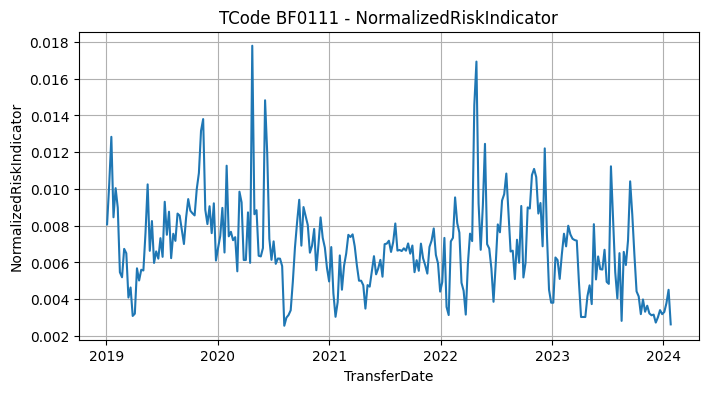

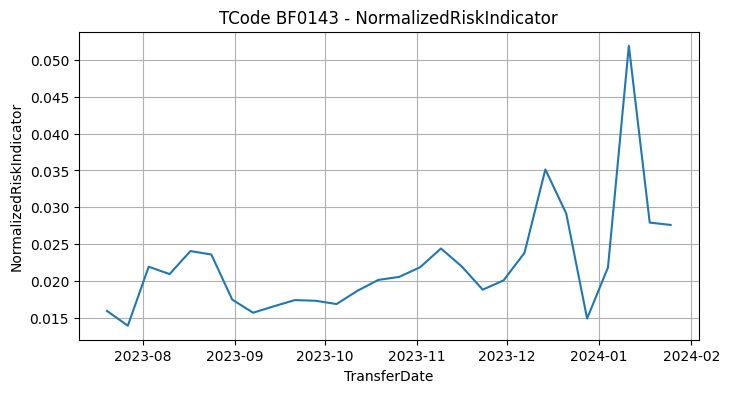

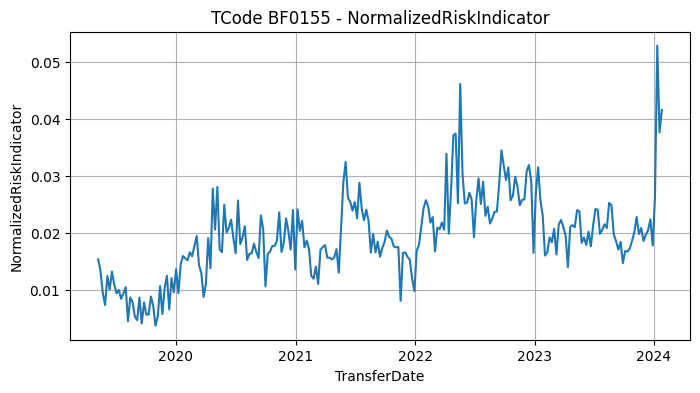

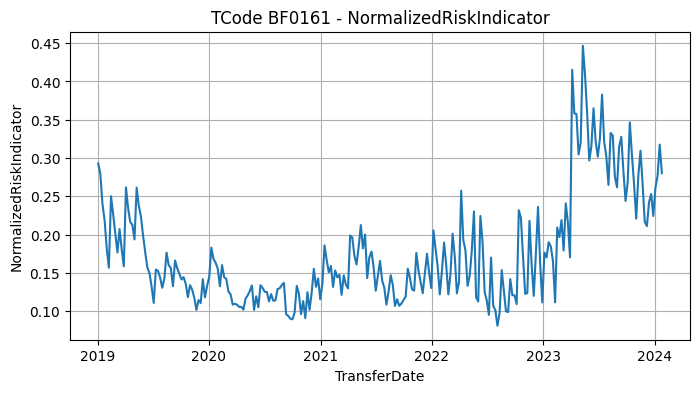

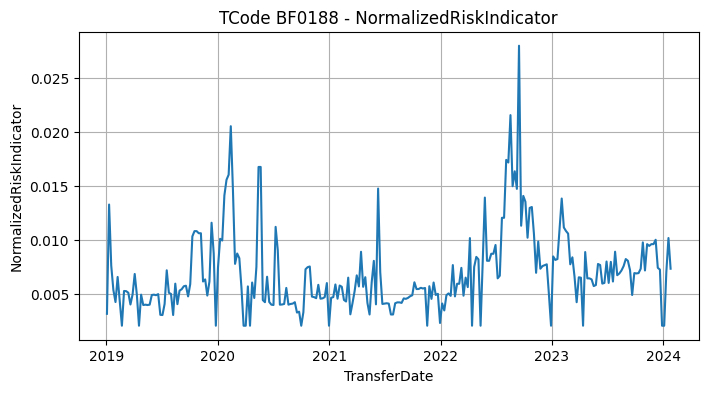

...

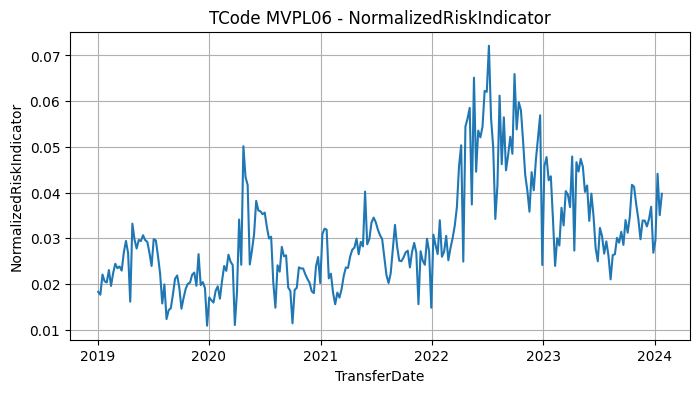

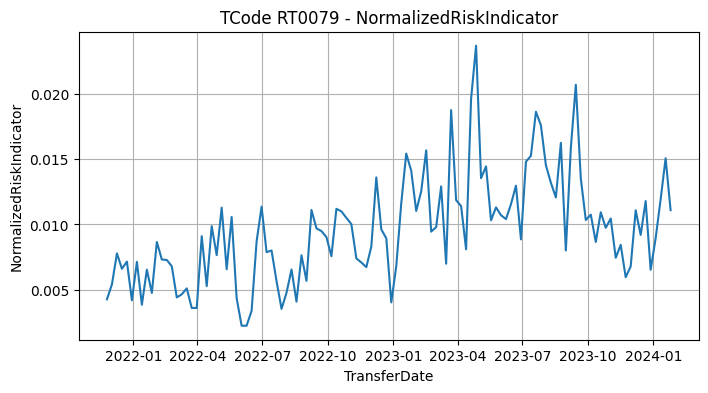

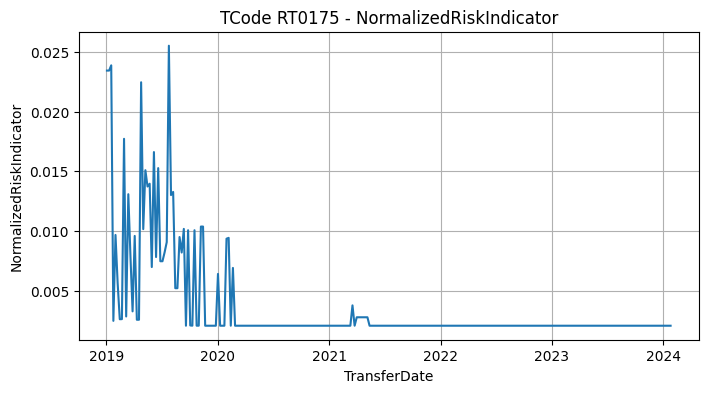

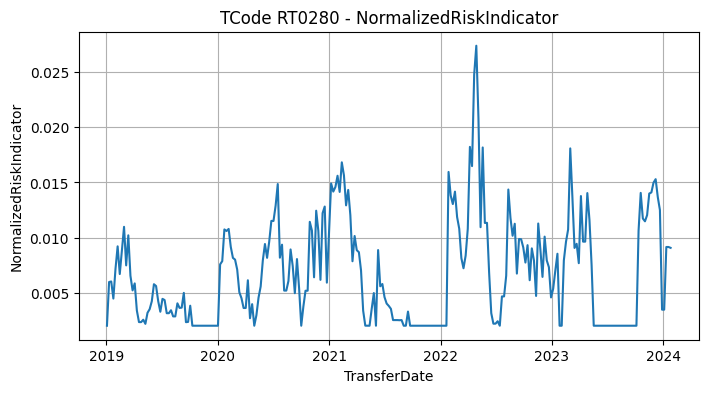

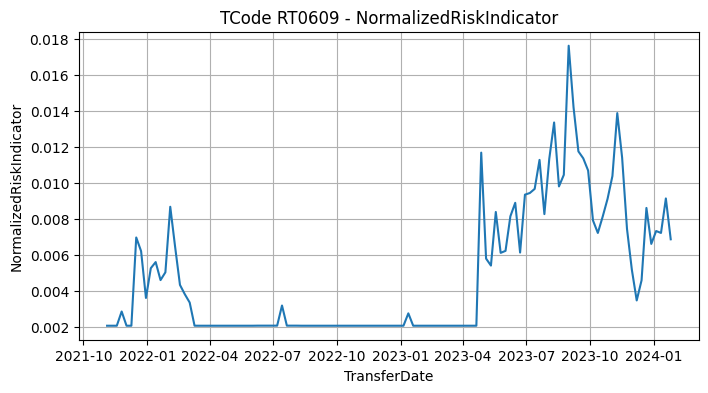

In [13]:
import pandas as pd
import matplotlib.pyplot as plt

unique_tcodes = df['TCode'].unique()

for tcode in unique_tcodes:
    subset = df[df['TCode'] == tcode]

    plt.figure(figsize=(8, 4))
    plt.plot(subset['TransferDate'], subset['NormalizedRiskIndicator'])

    plt.title(f'TCode {tcode} - NormalizedRiskIndicator')
    plt.xlabel('TransferDate')
    plt.ylabel('NormalizedRiskIndicator')
    plt.grid(True)
    plt.savefig(f'TCode_{tcode}_Plot.png')
    plt.show()


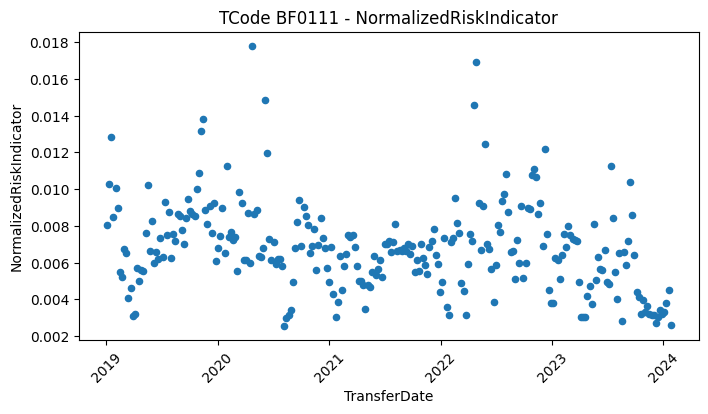

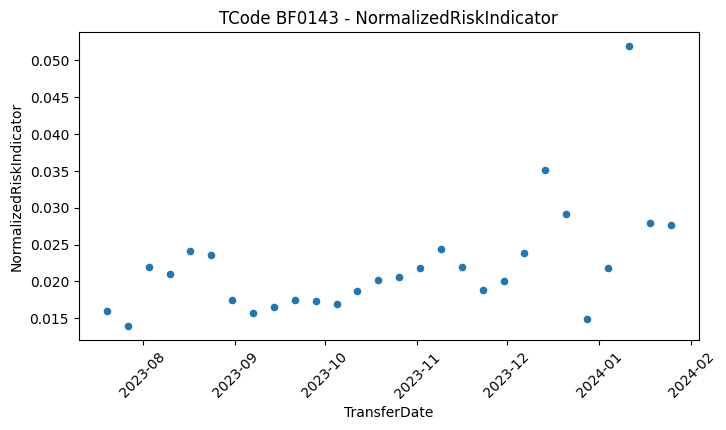

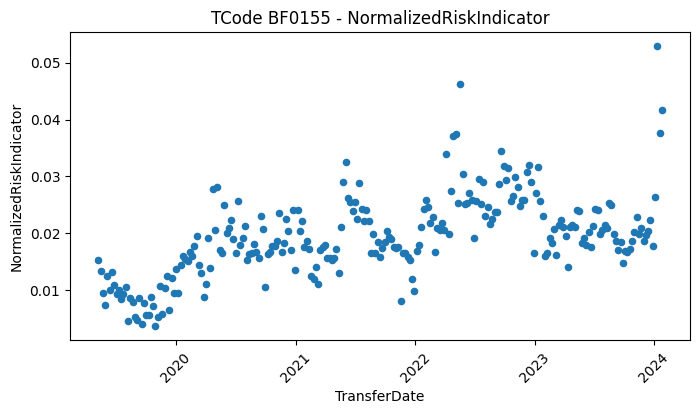

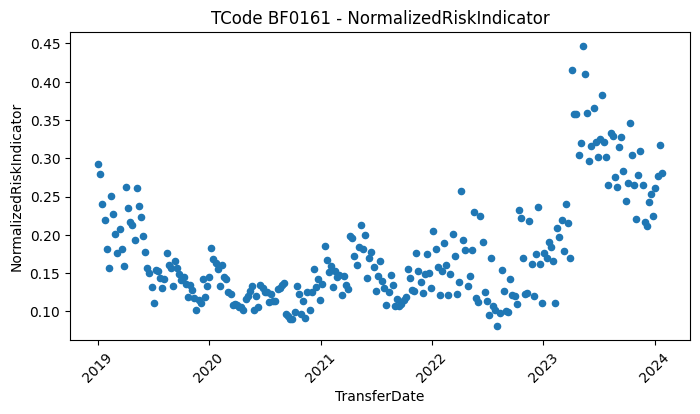

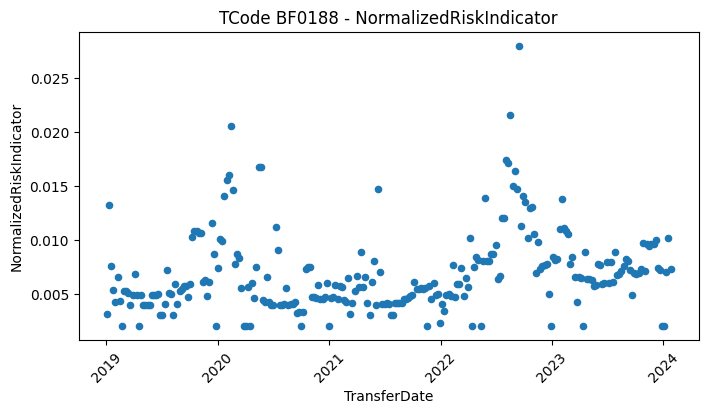

...

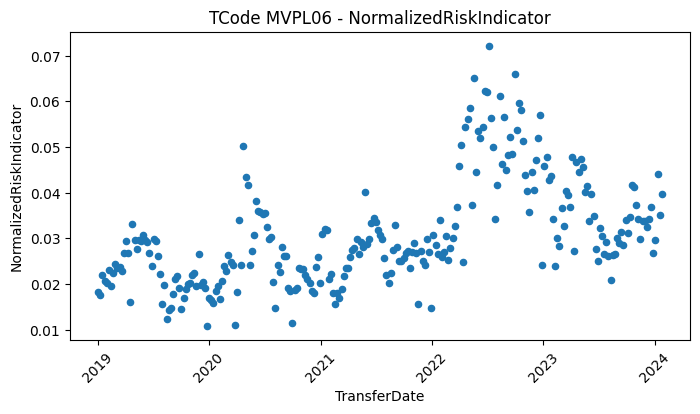

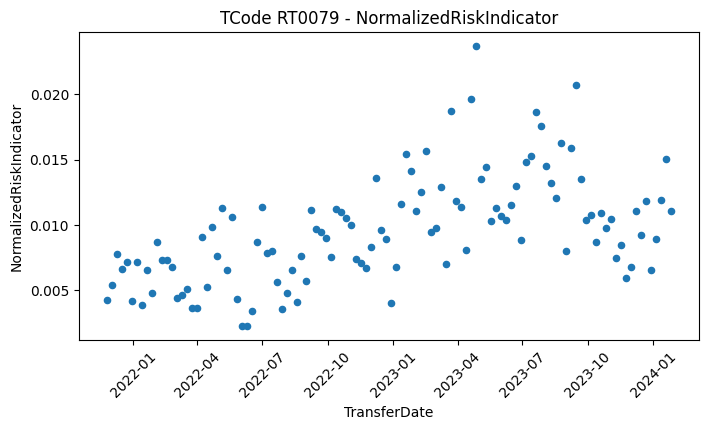

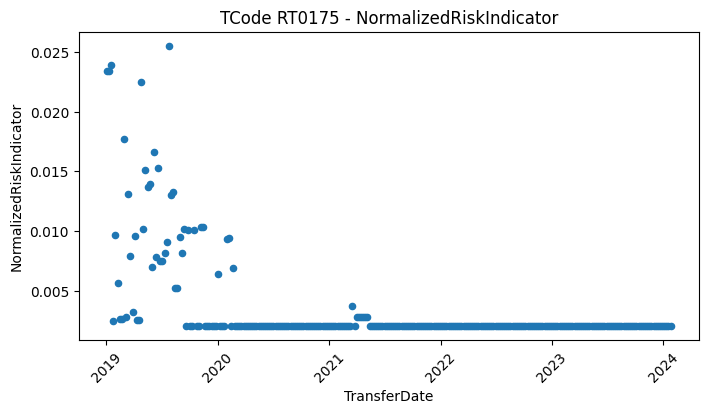

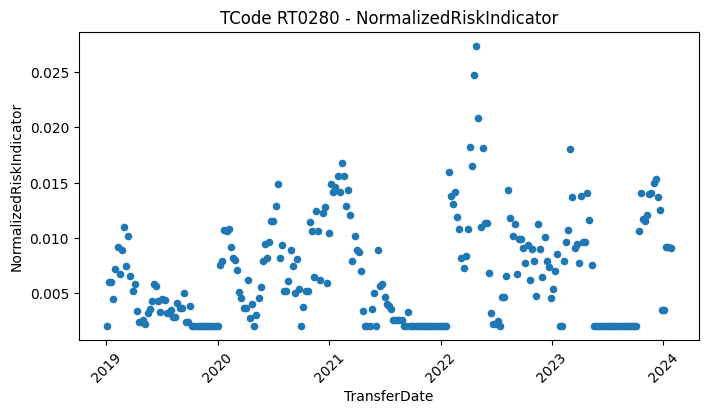

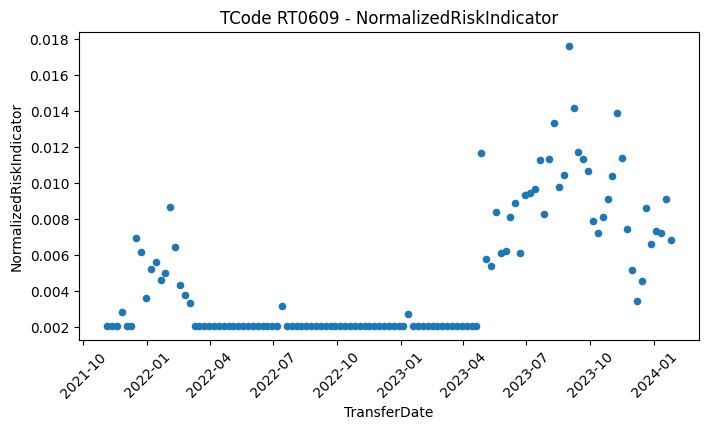

In [14]:
import pandas as pd
import matplotlib.pyplot as plt

unique_tcodes = df['TCode'].unique()

for tcode in unique_tcodes:
    subset = df[df['TCode'] == tcode]

    plt.figure(figsize=(8, 4))
    plt.scatter(subset['TransferDate'], subset['NormalizedRiskIndicator'], marker='o', s=20)

    plt.title(f'TCode {tcode} - NormalizedRiskIndicator')
    plt.xlabel('TransferDate')
    plt.ylabel('NormalizedRiskIndicator')
    plt.xticks(rotation=45)
    plt.savefig(f'TCode_{tcode}_DotPlot.png')
    plt.show()


In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33518 entries, 0 to 33517
Data columns (total 3 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   TCode                    33518 non-null  object        
 1   TransferDate             33518 non-null  datetime64[ns]
 2   NormalizedRiskIndicator  33518 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 785.7+ KB


Decomposing the detail of all the factories in to Additive Decomposition and Multiplicative Decompostion

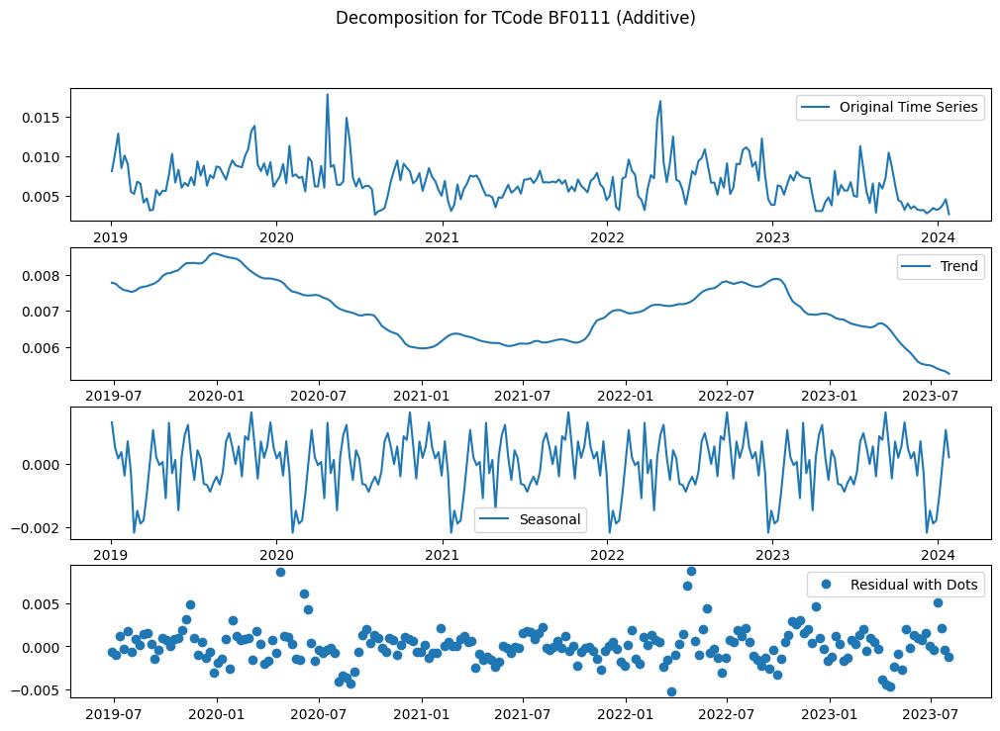

Error for TCode BF0143: x must have 2 complete cycles requires 100 observations. x only has 28 observation(s)


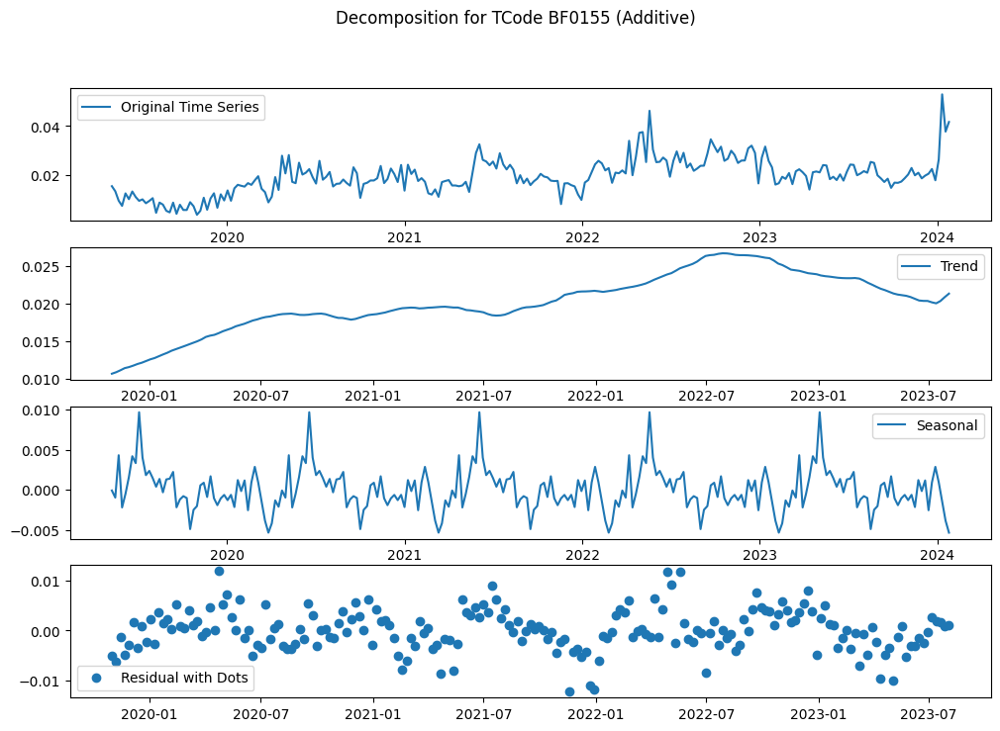

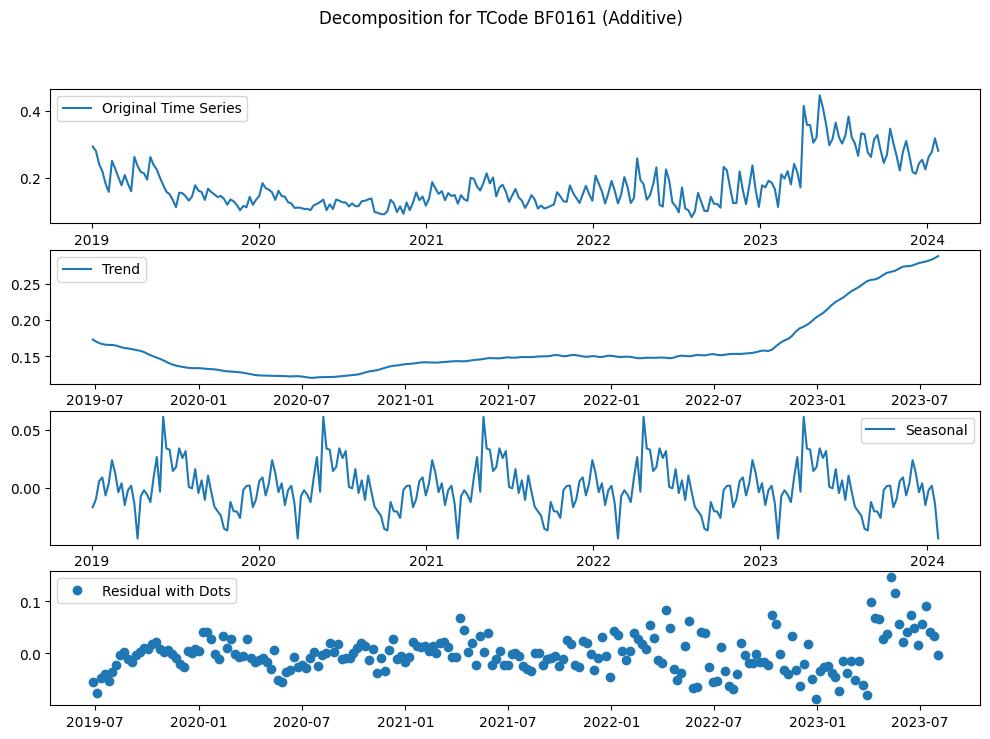

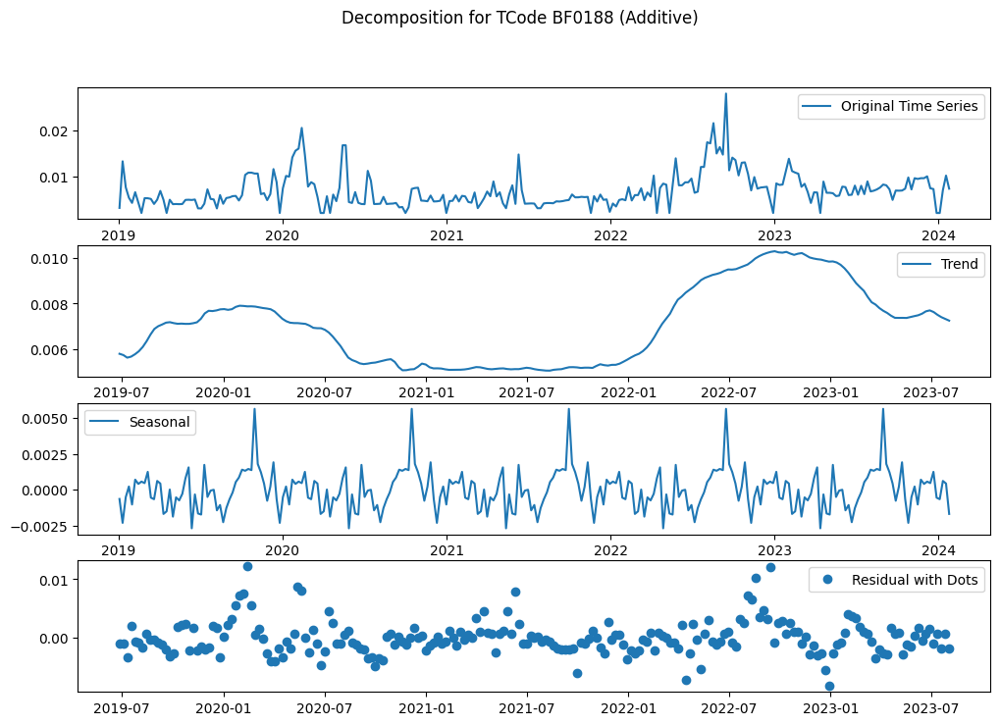

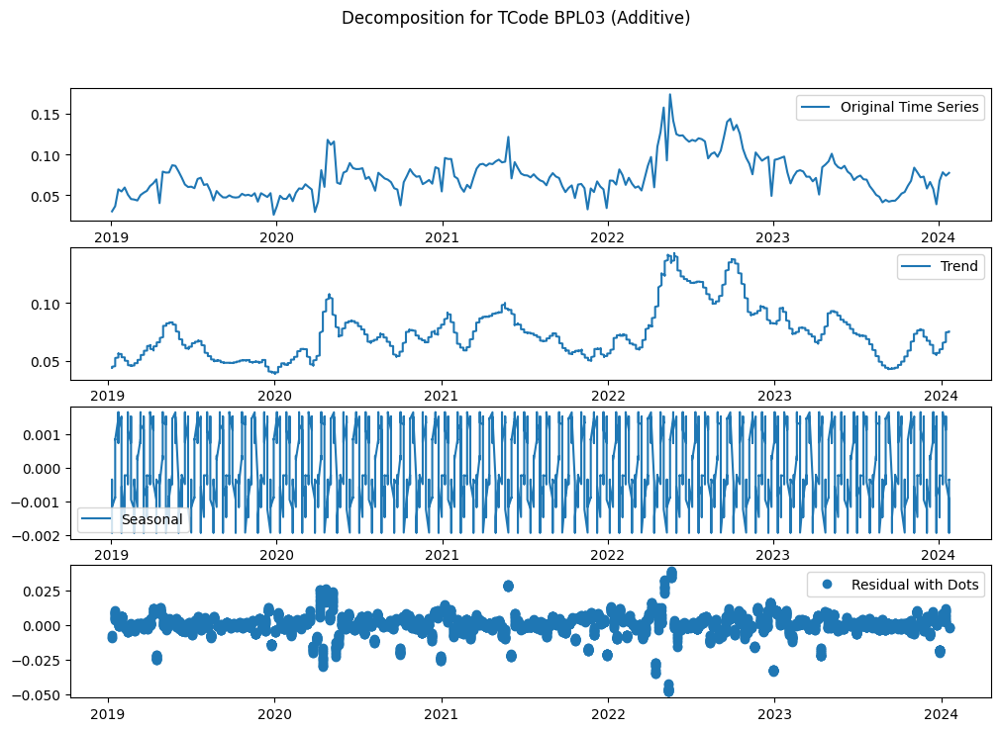

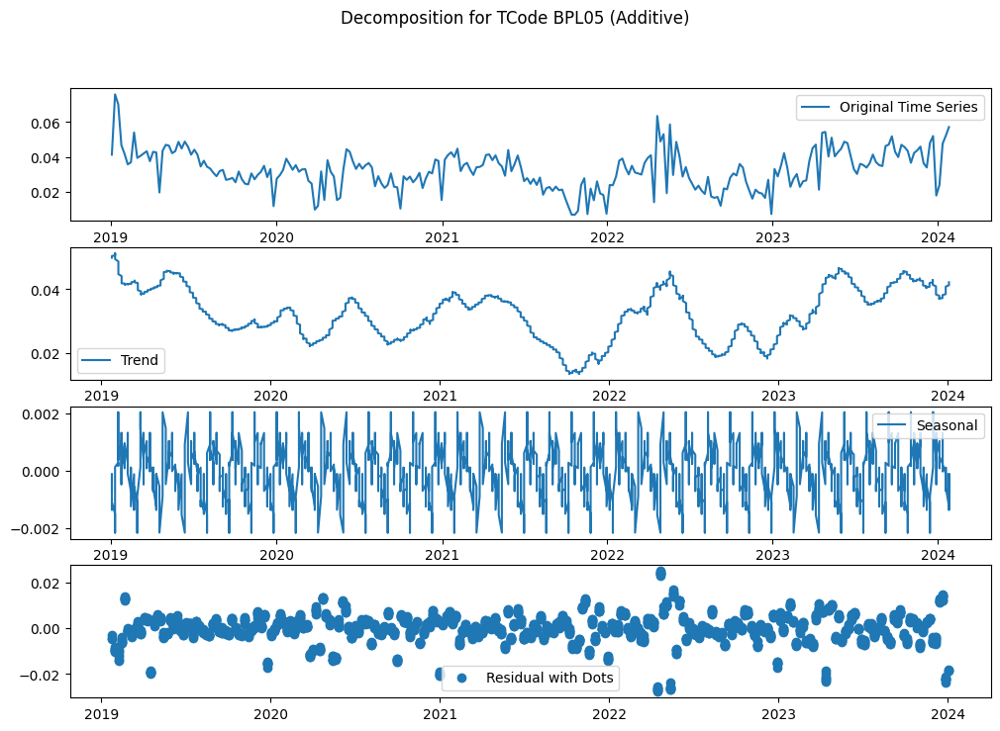

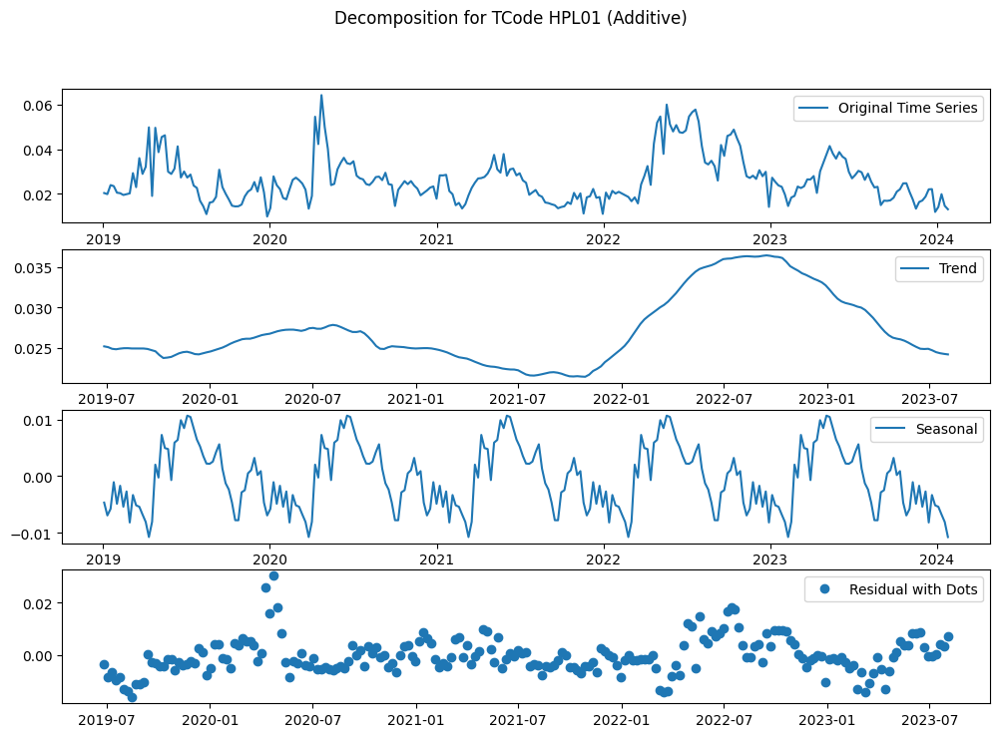

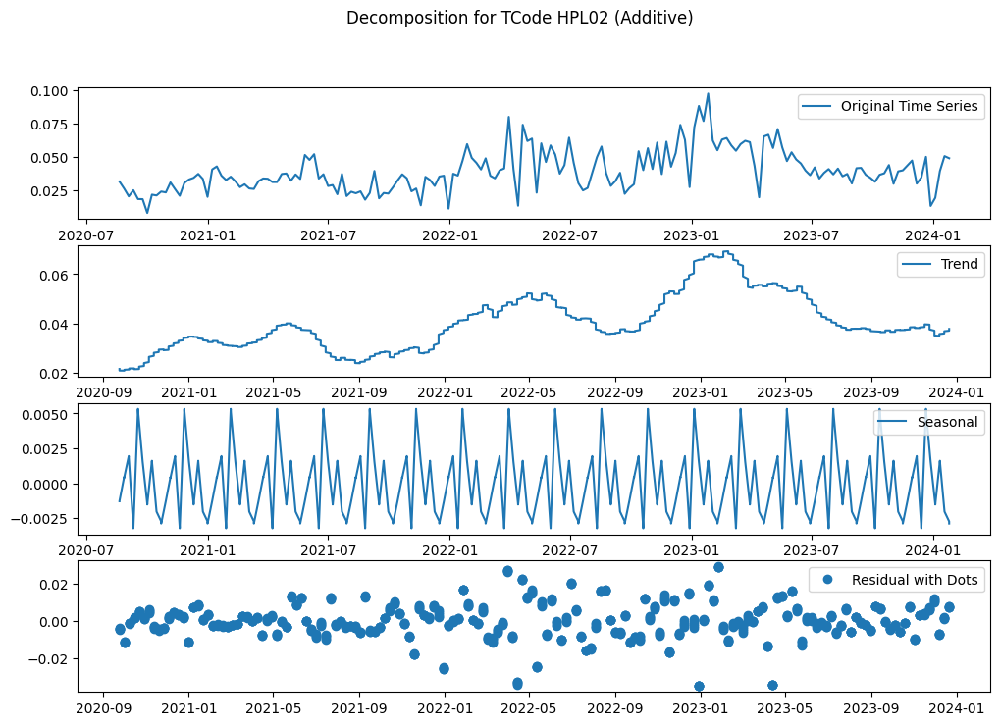

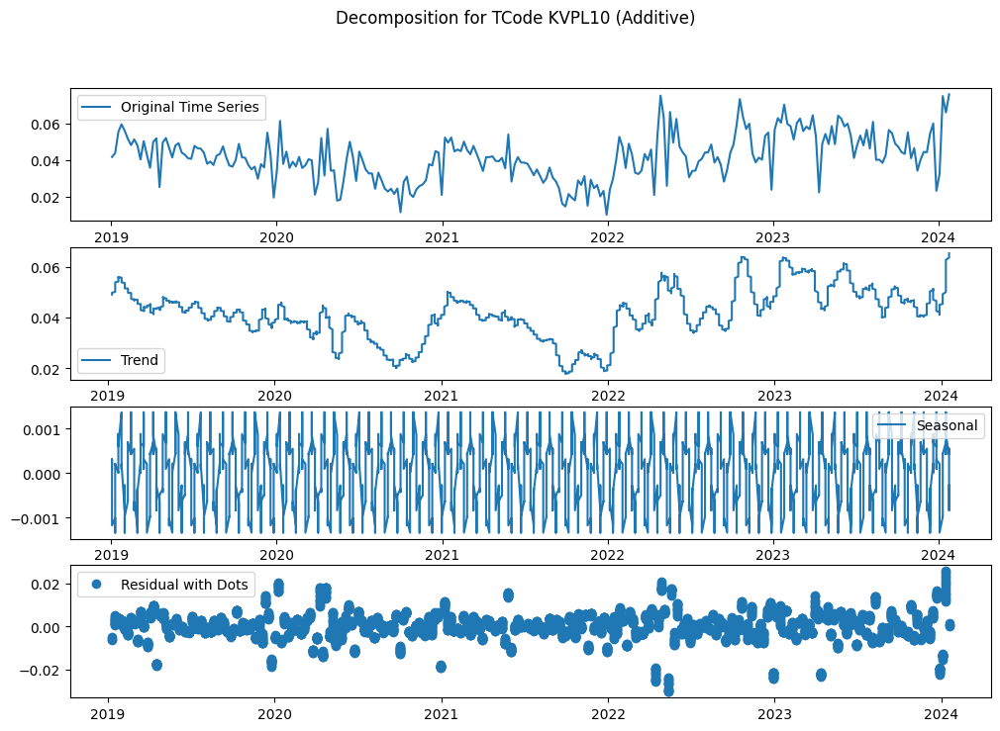

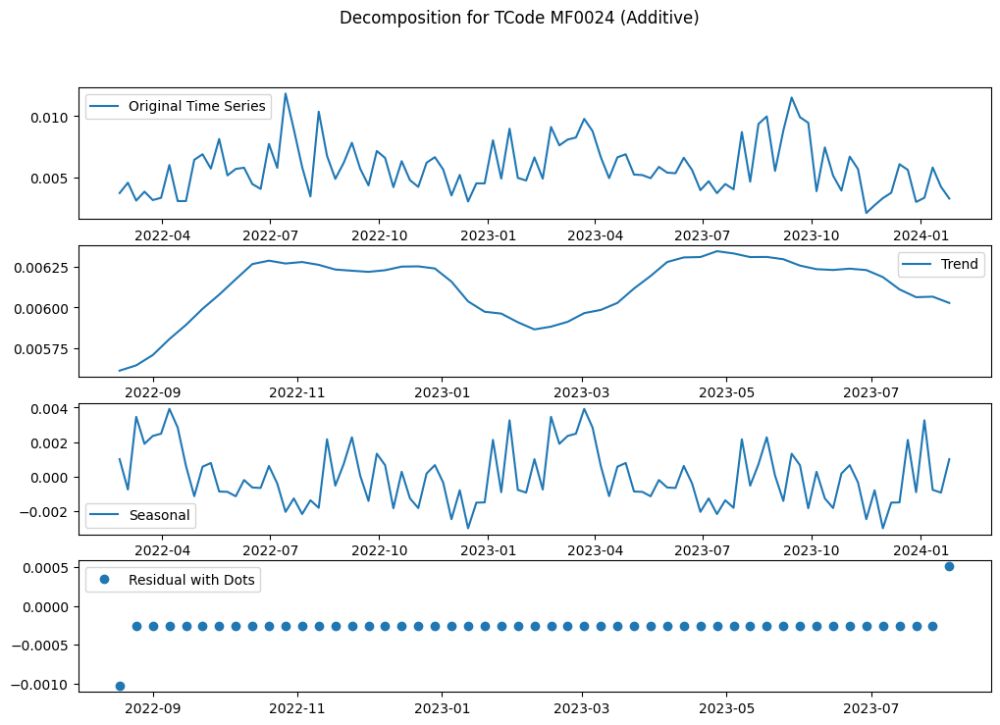

Error for TCode MF0064: x must have 2 complete cycles requires 100 observations. x only has 47 observation(s)


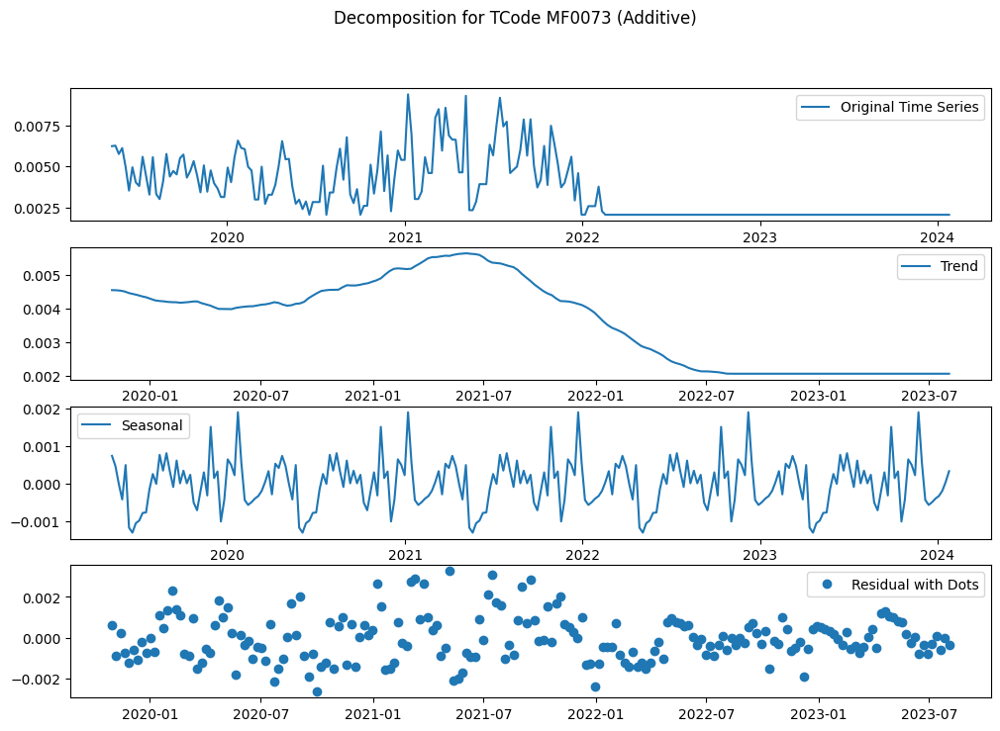

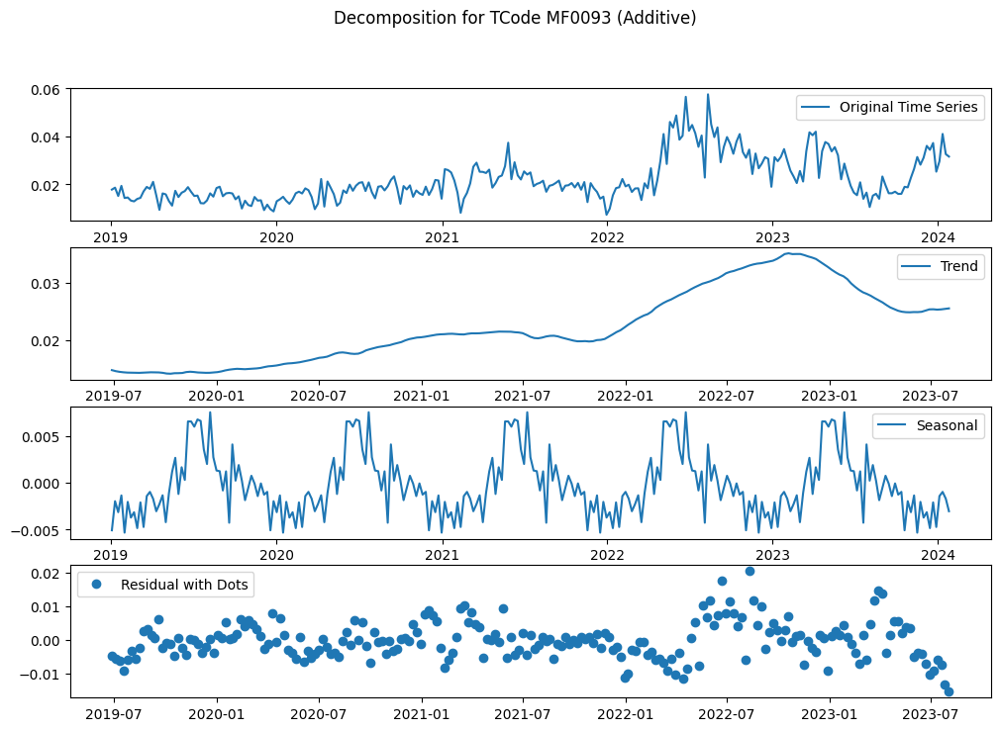

Error for TCode MF0127: x must have 2 complete cycles requires 100 observations. x only has 12 observation(s)


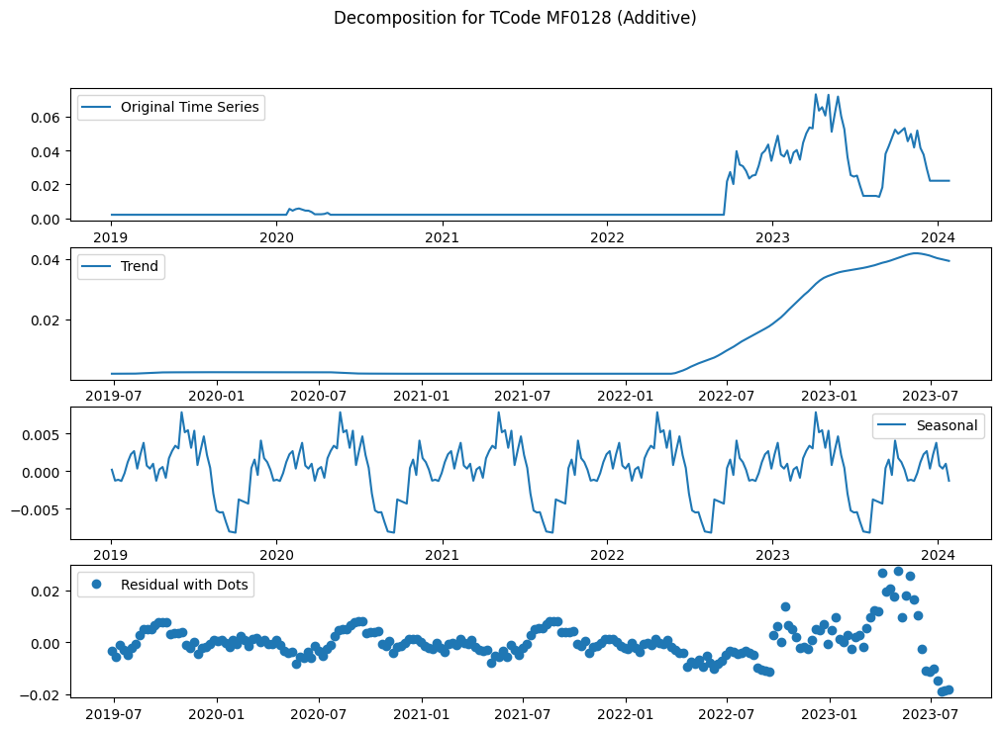

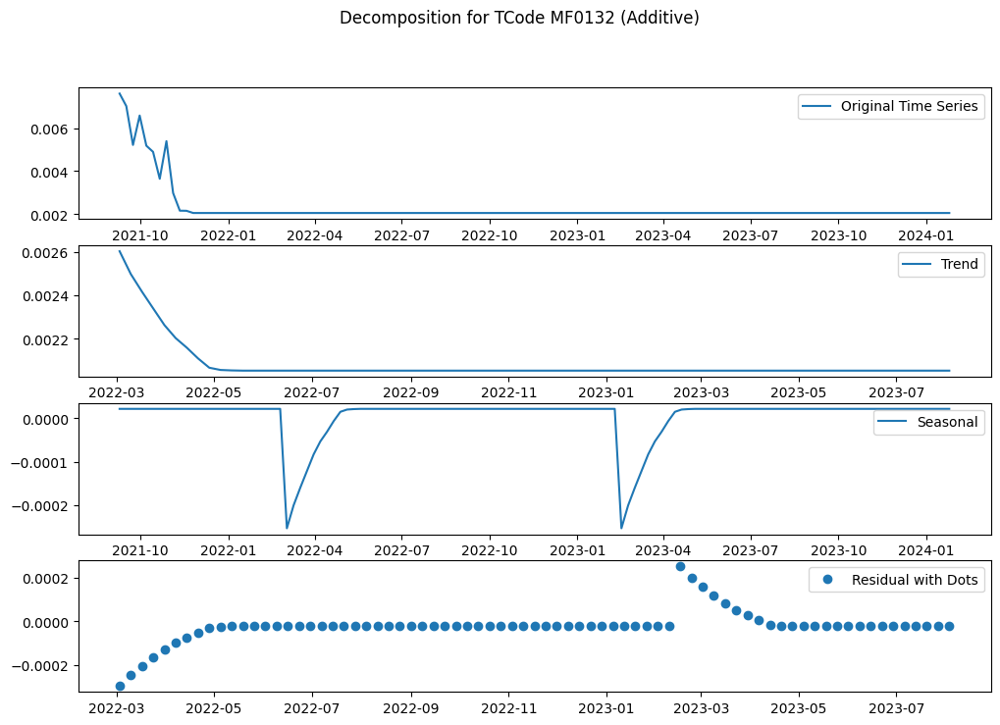

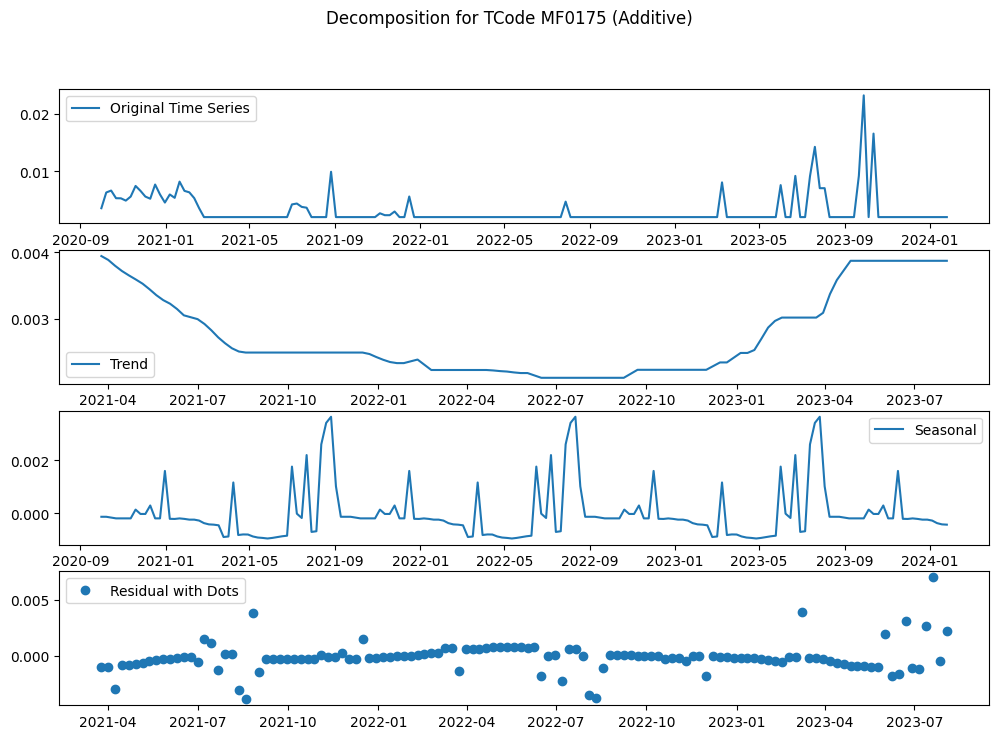

Error for TCode MF0204: x must have 2 complete cycles requires 100 observations. x only has 38 observation(s)
Error for TCode MF0206: x must have 2 complete cycles requires 100 observations. x only has 92 observation(s)
Error for TCode MF0221: x must have 2 complete cycles requires 100 observations. x only has 62 observation(s)
Error for TCode MF0255: x must have 2 complete cycles requires 100 observations. x only has 7 observation(s)


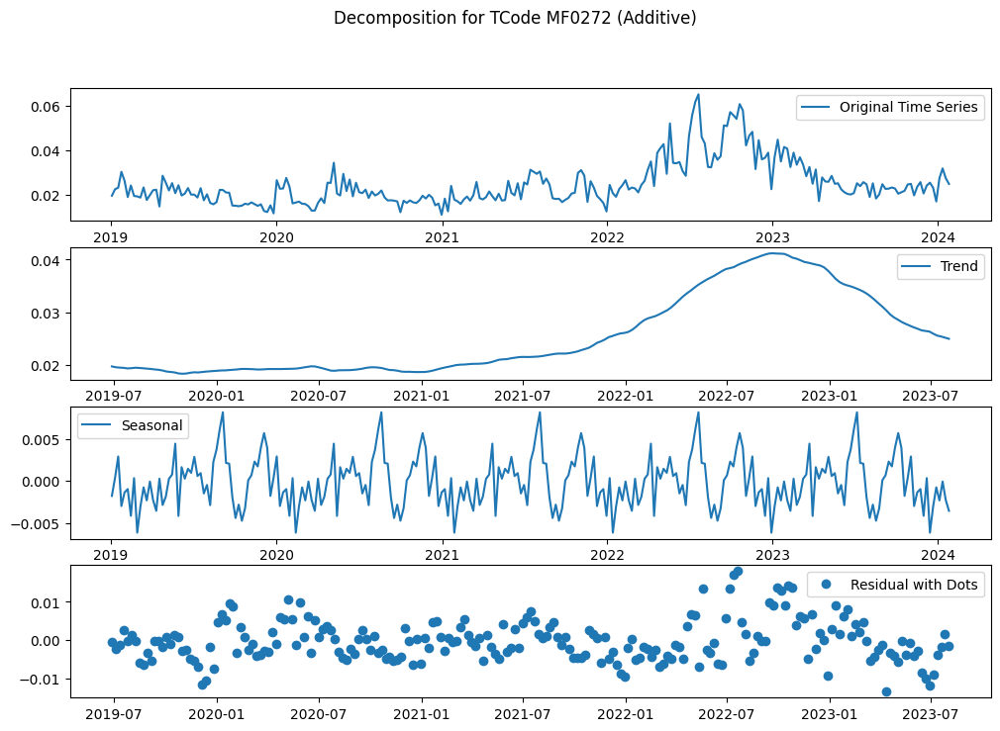

Error for TCode MF0308: x must have 2 complete cycles requires 100 observations. x only has 92 observation(s)


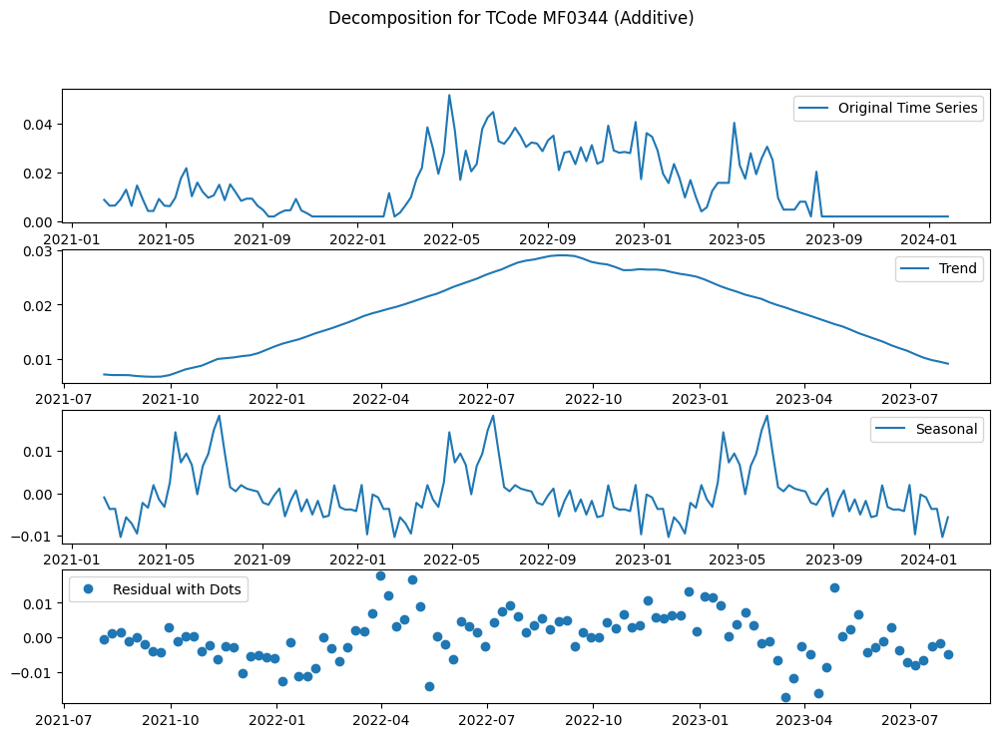

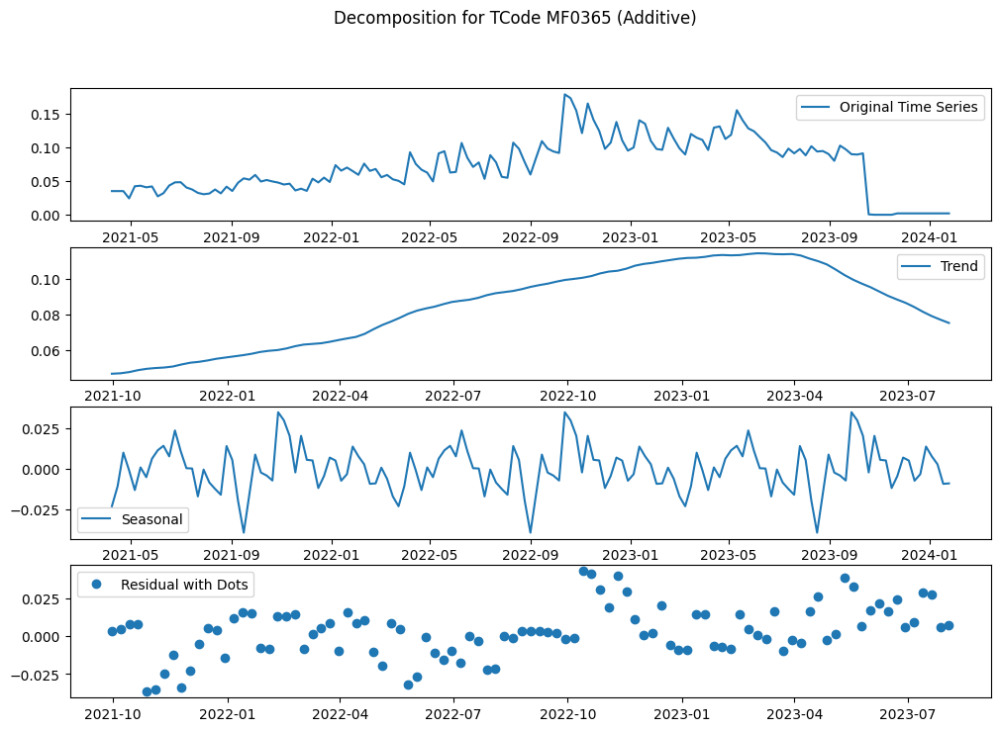

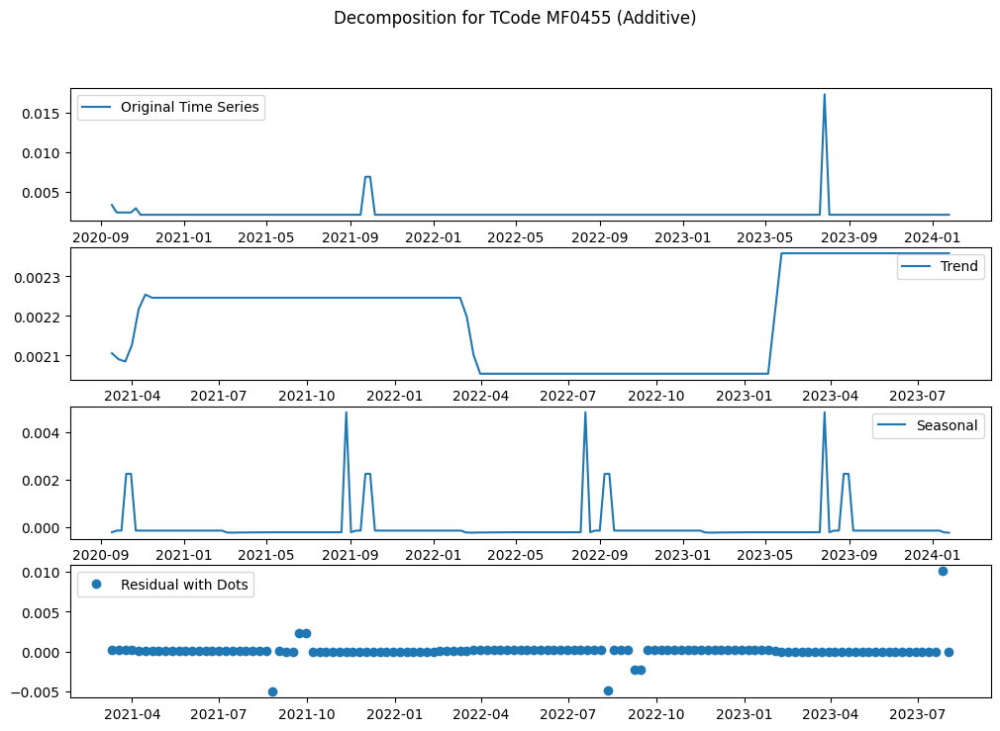

Error for TCode MF0490: x must have 2 complete cycles requires 100 observations. x only has 70 observation(s)


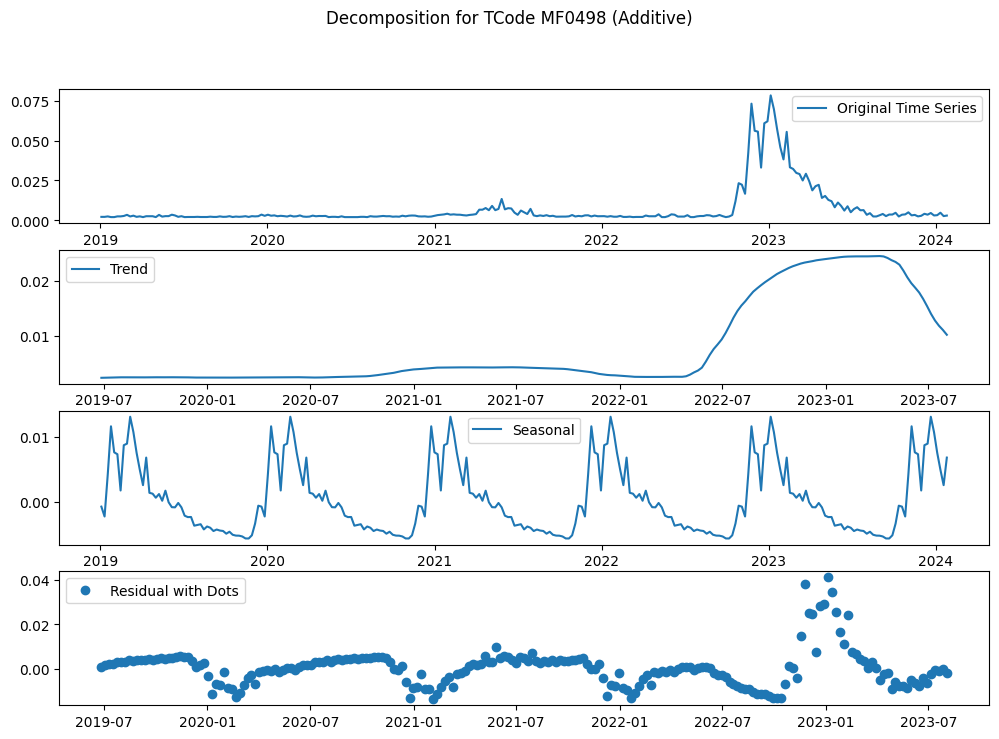

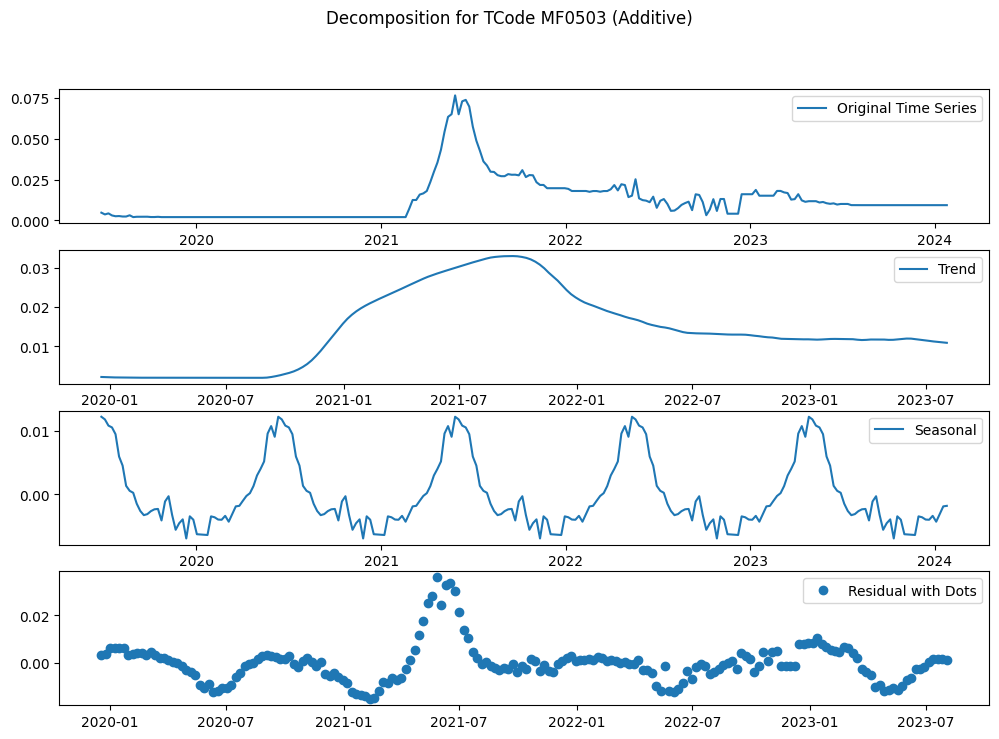

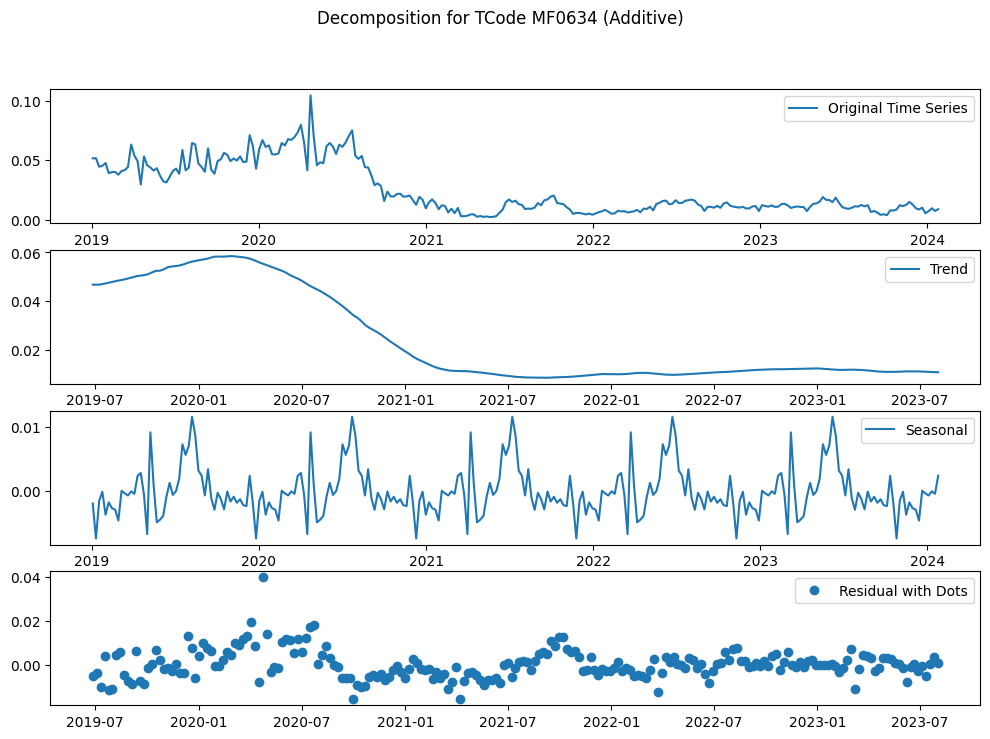

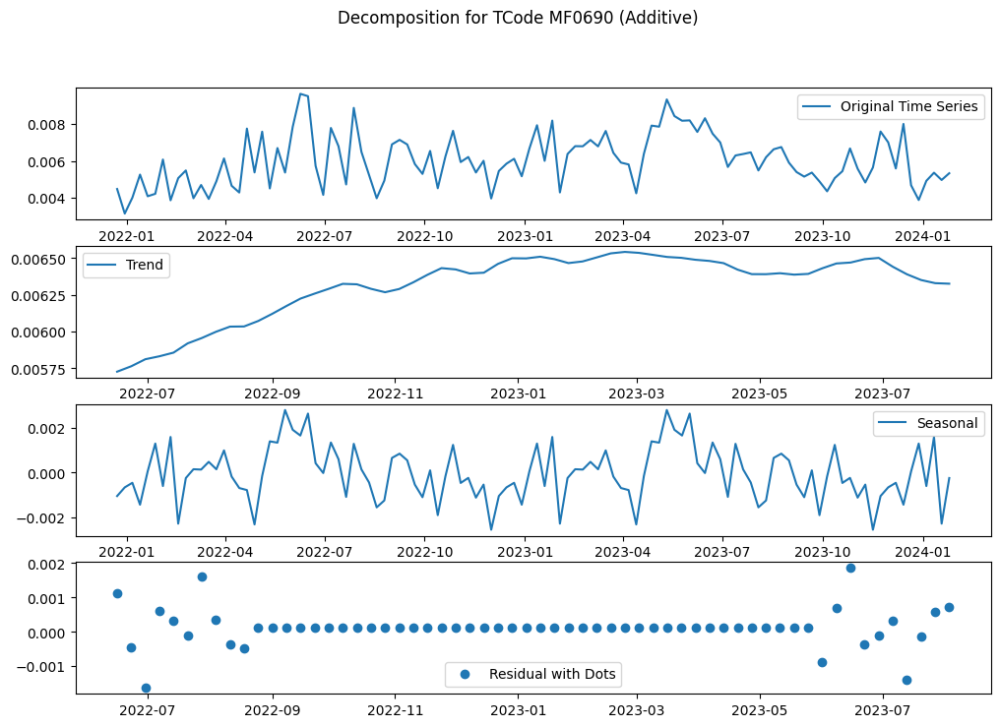

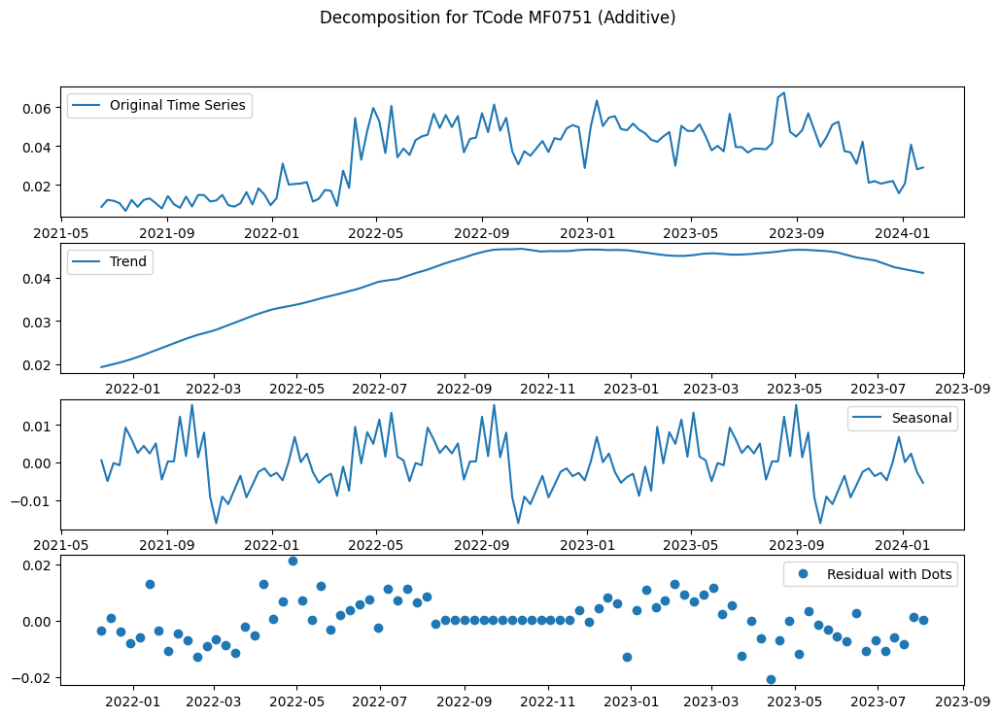

Error for TCode MF0842: x must have 2 complete cycles requires 100 observations. x only has 38 observation(s)


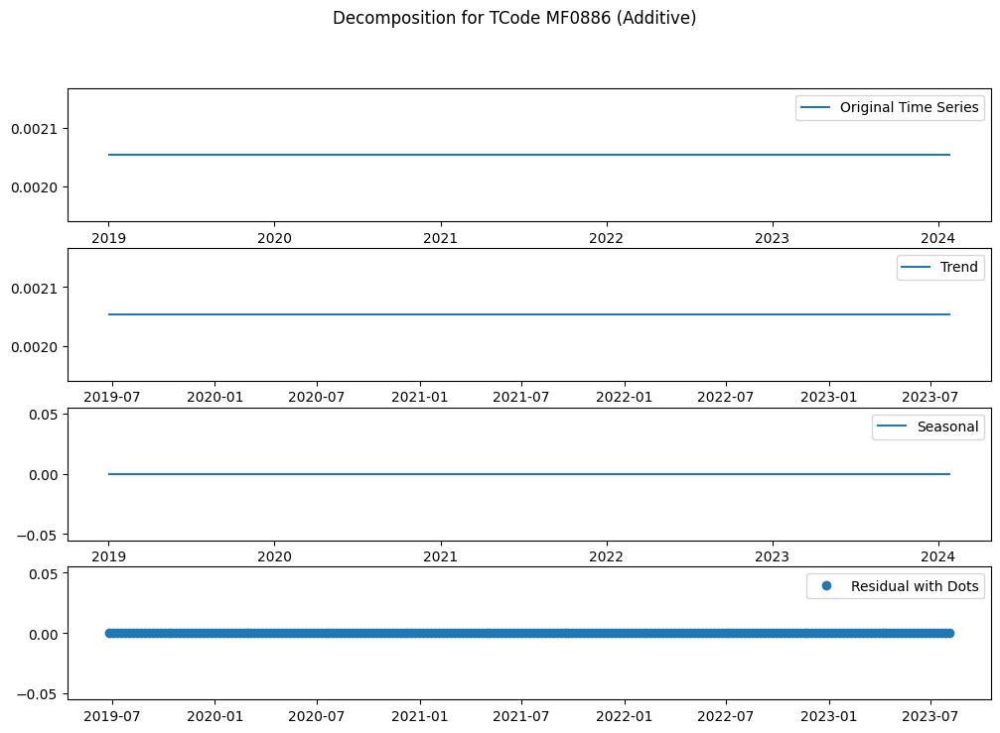

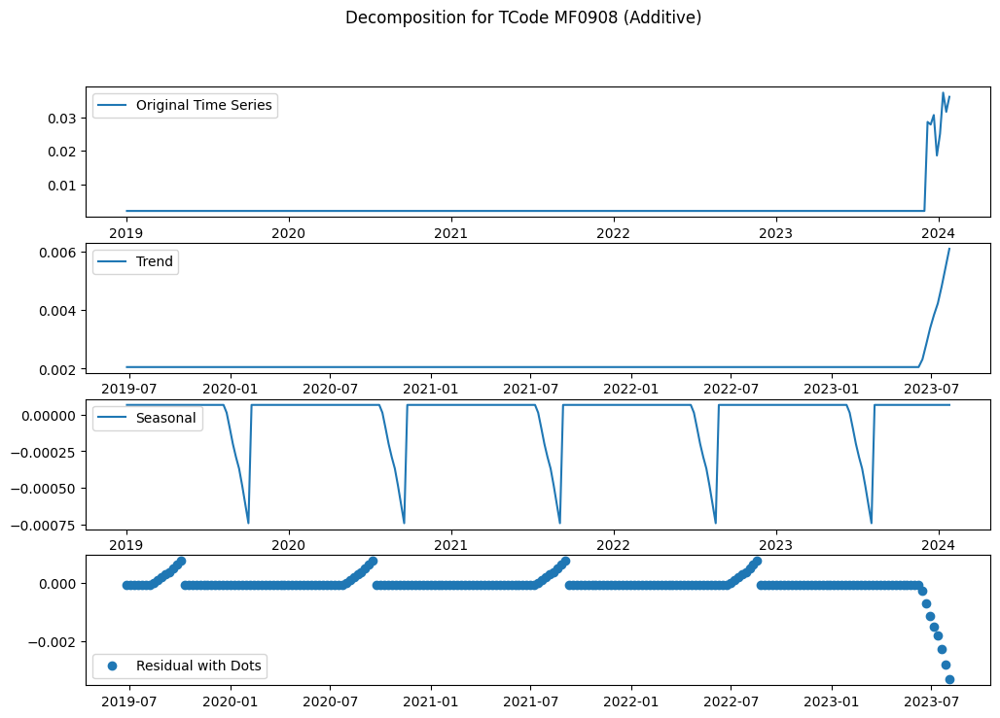

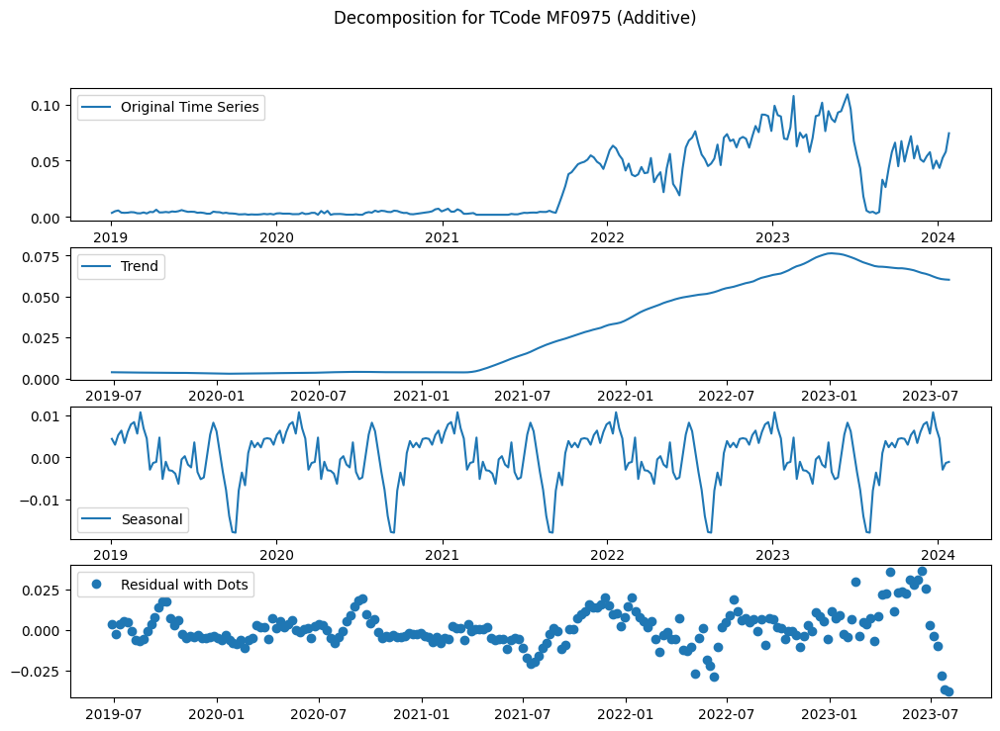

Error for TCode MF1006: x must have 2 complete cycles requires 100 observations. x only has 70 observation(s)


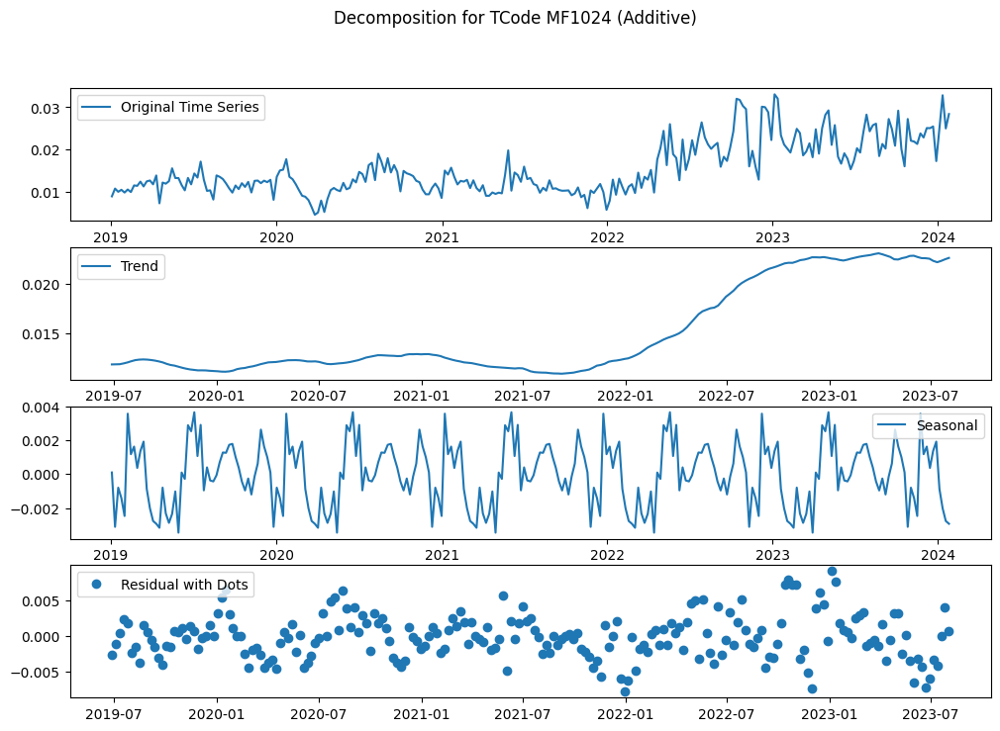

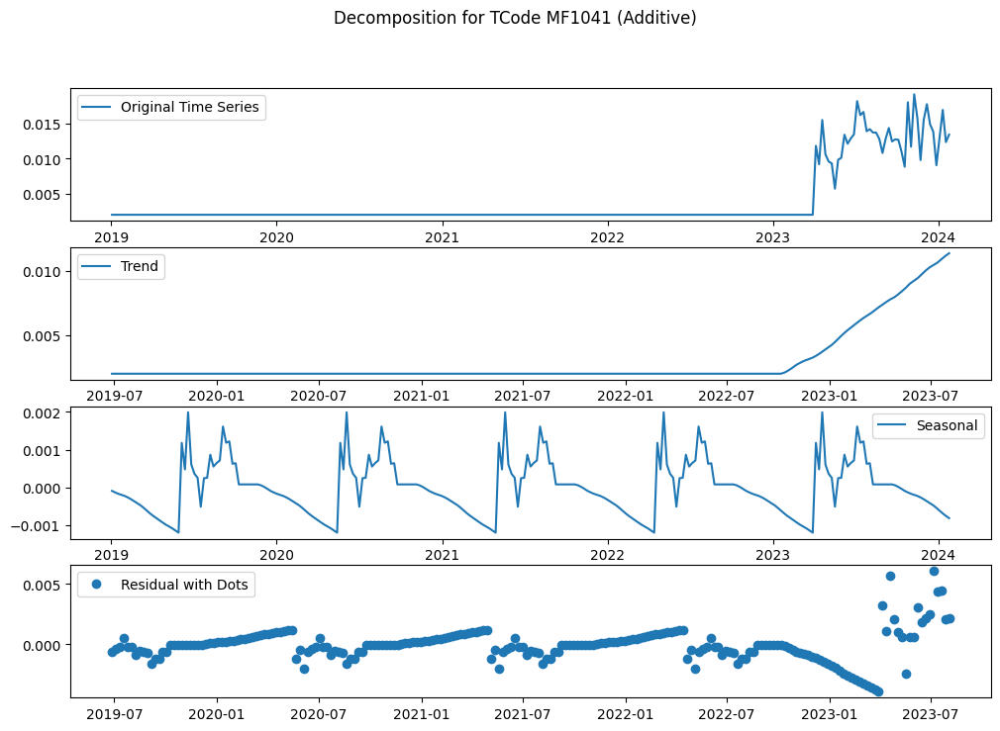

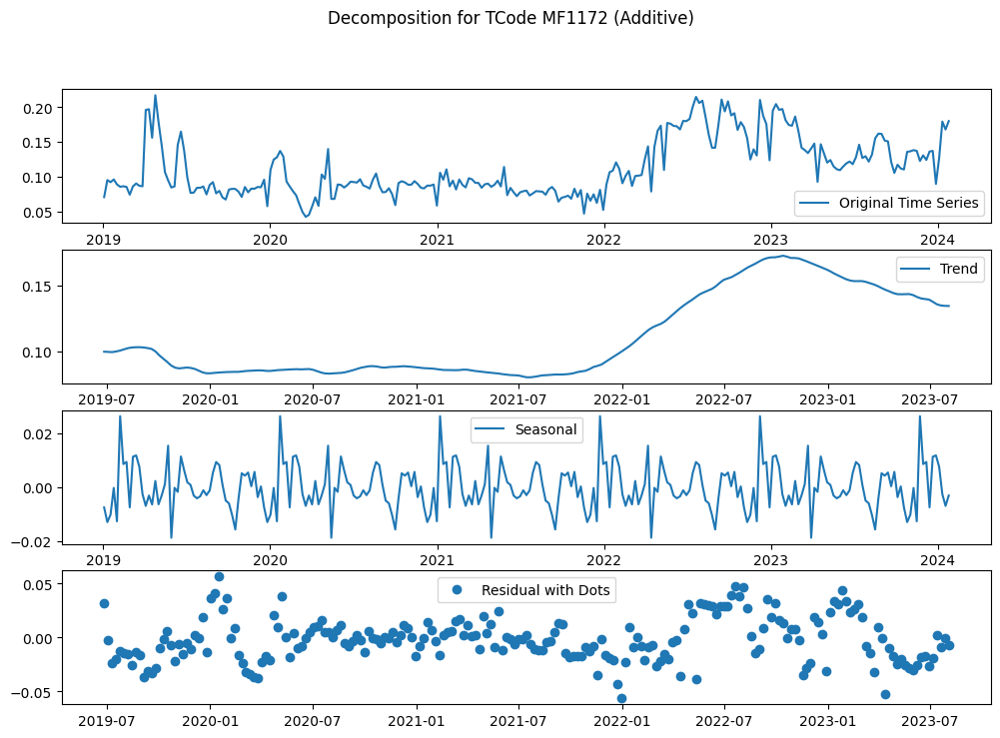

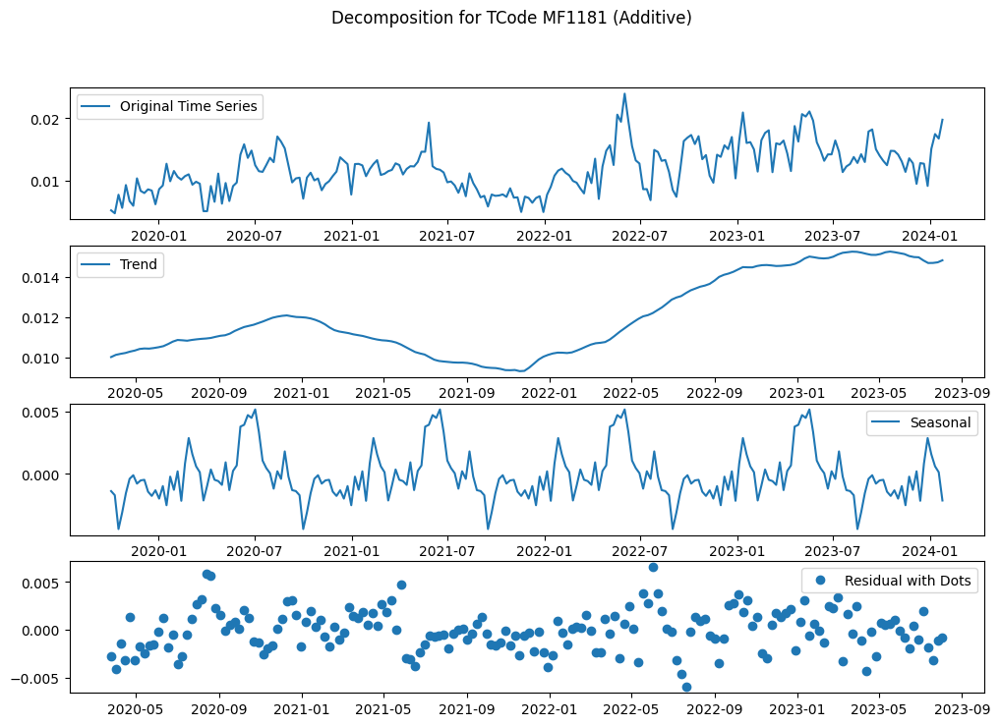

Error for TCode MF1186: x must have 2 complete cycles requires 100 observations. x only has 31 observation(s)


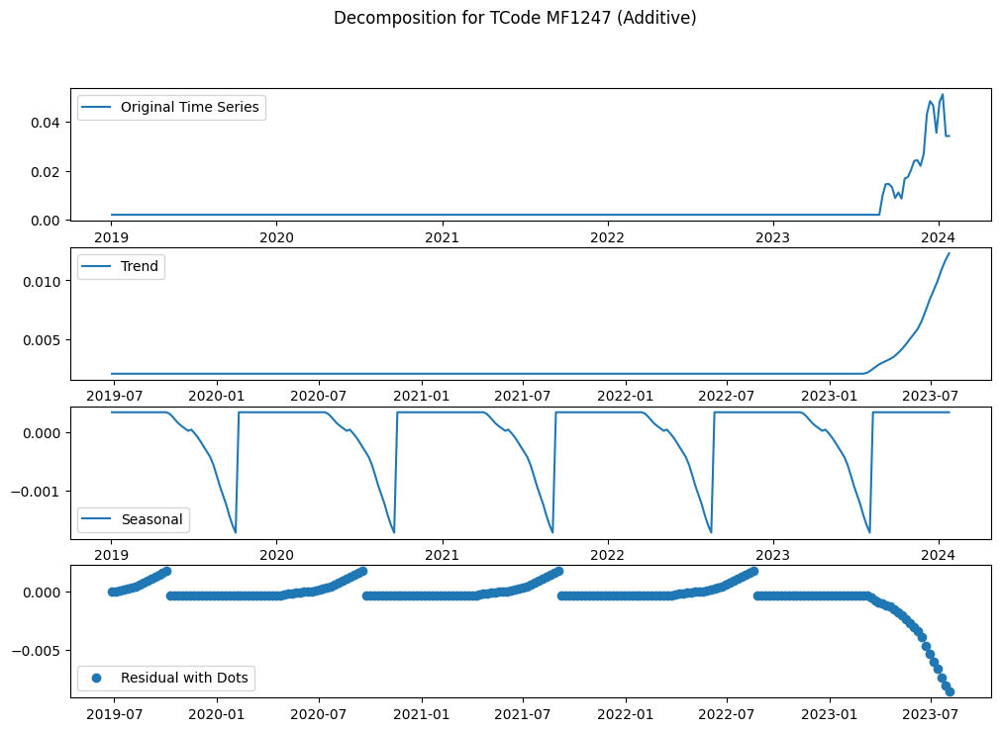

Error for TCode MF1264: x must have 2 complete cycles requires 100 observations. x only has 16 observation(s)


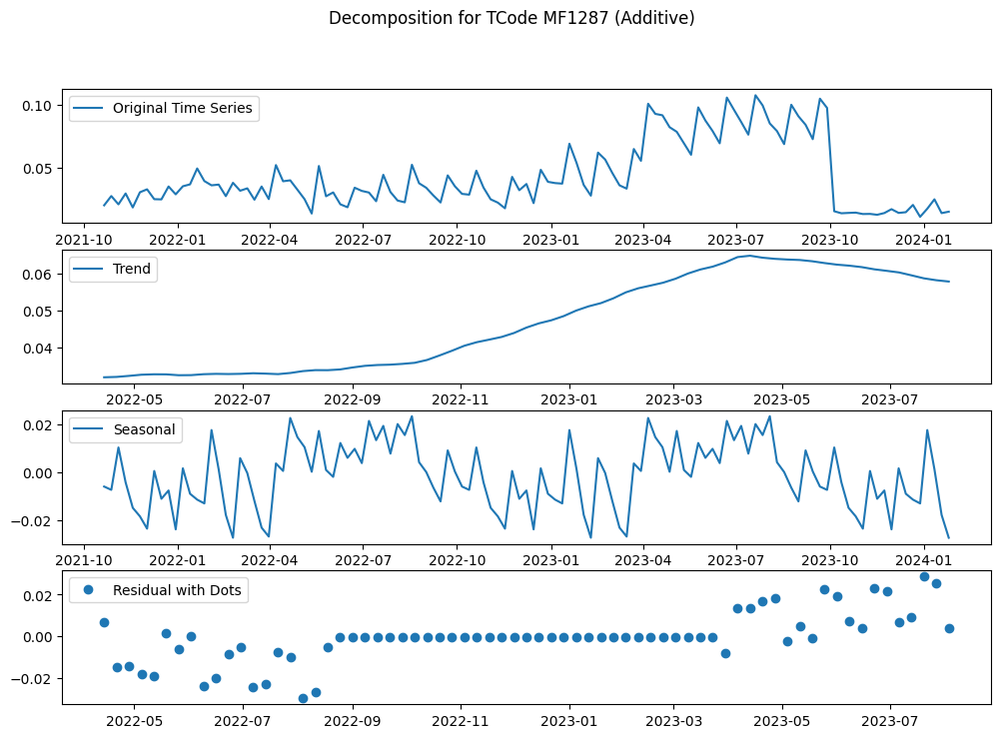

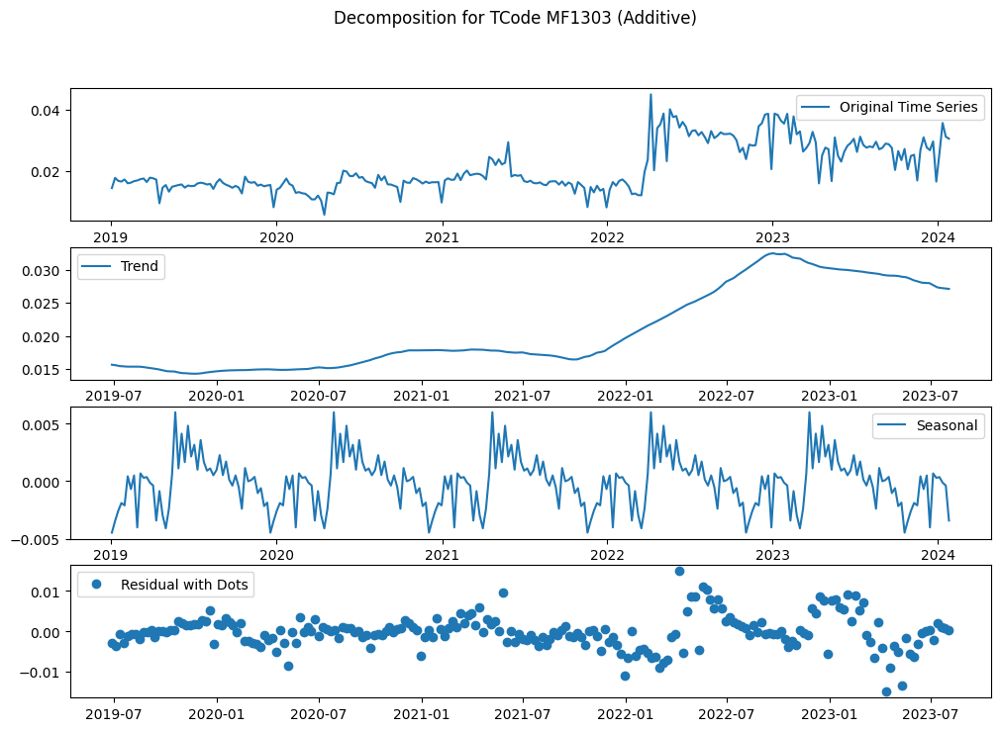

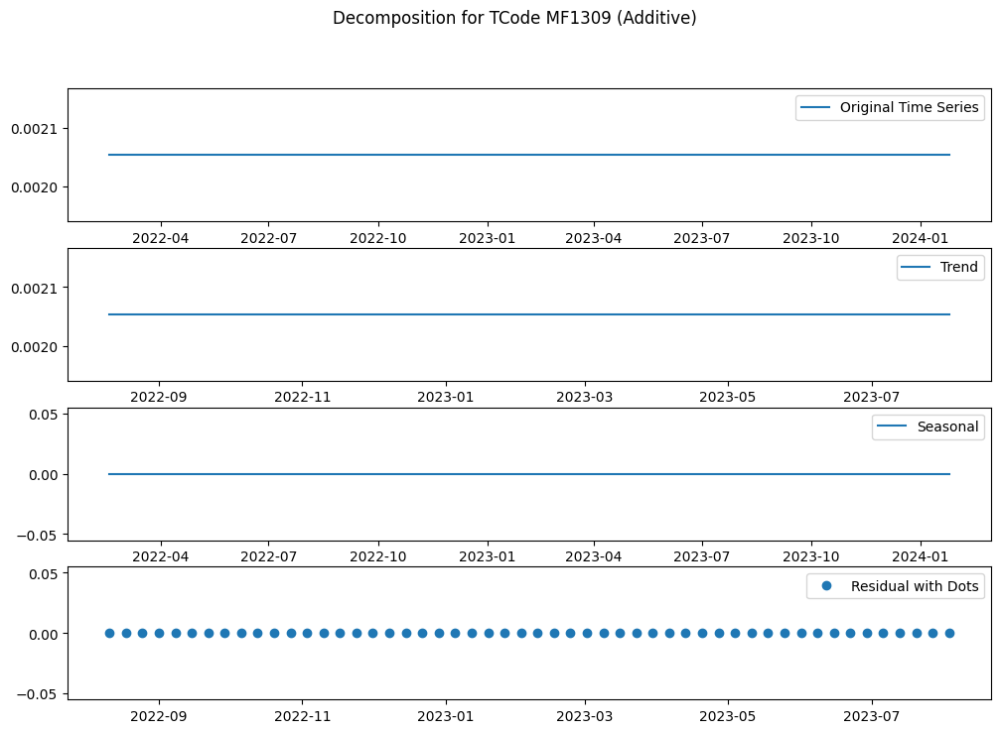

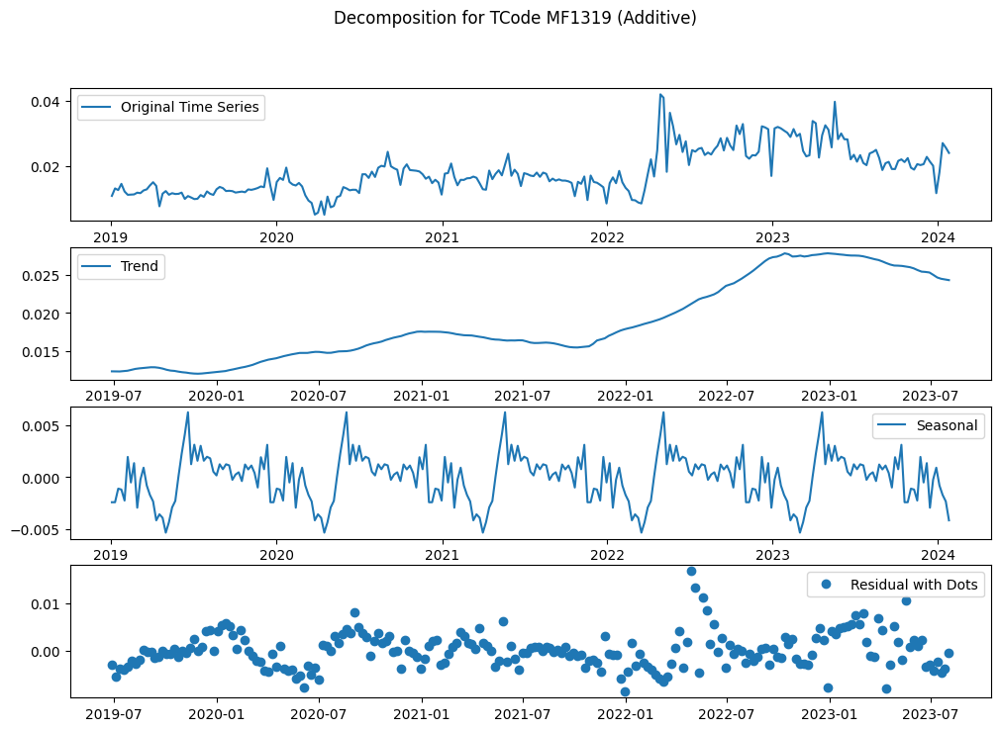

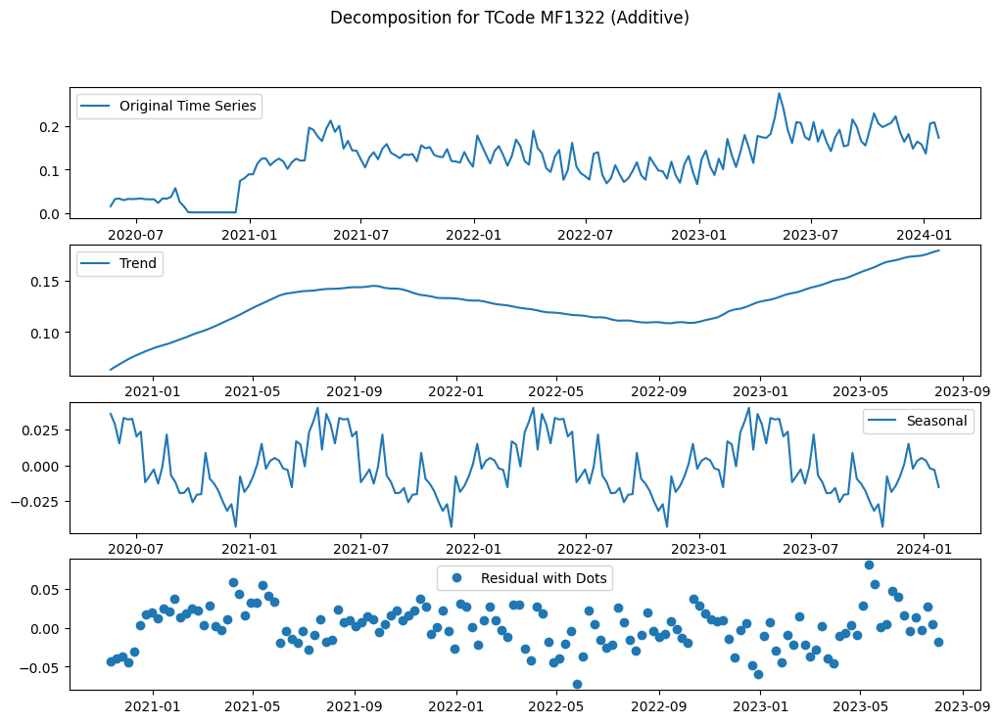

...

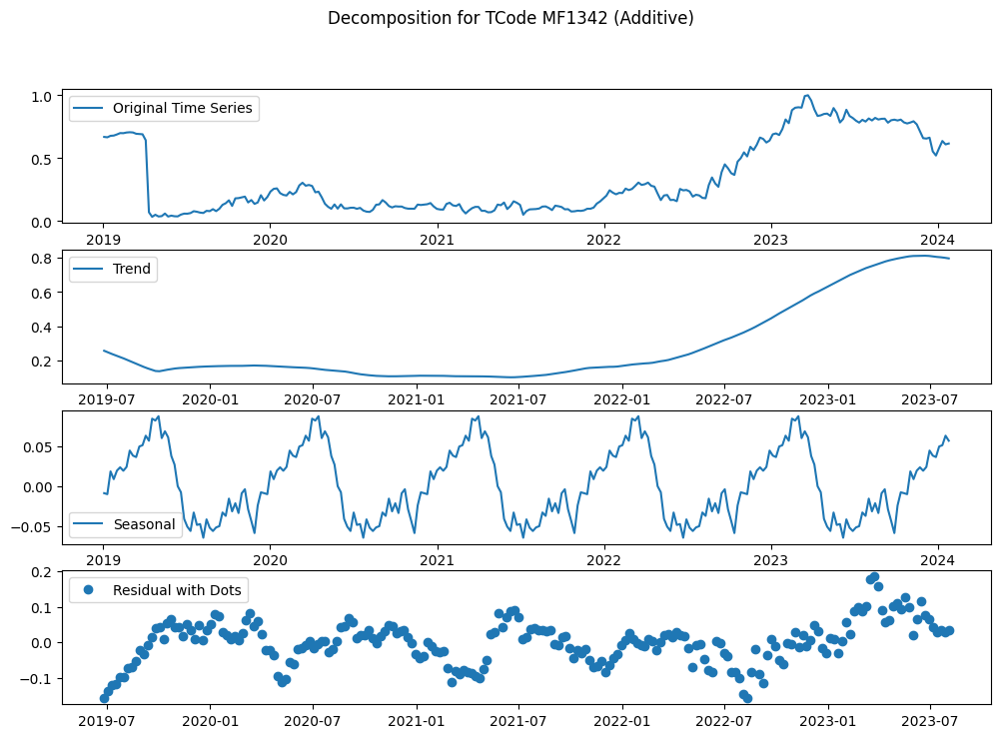

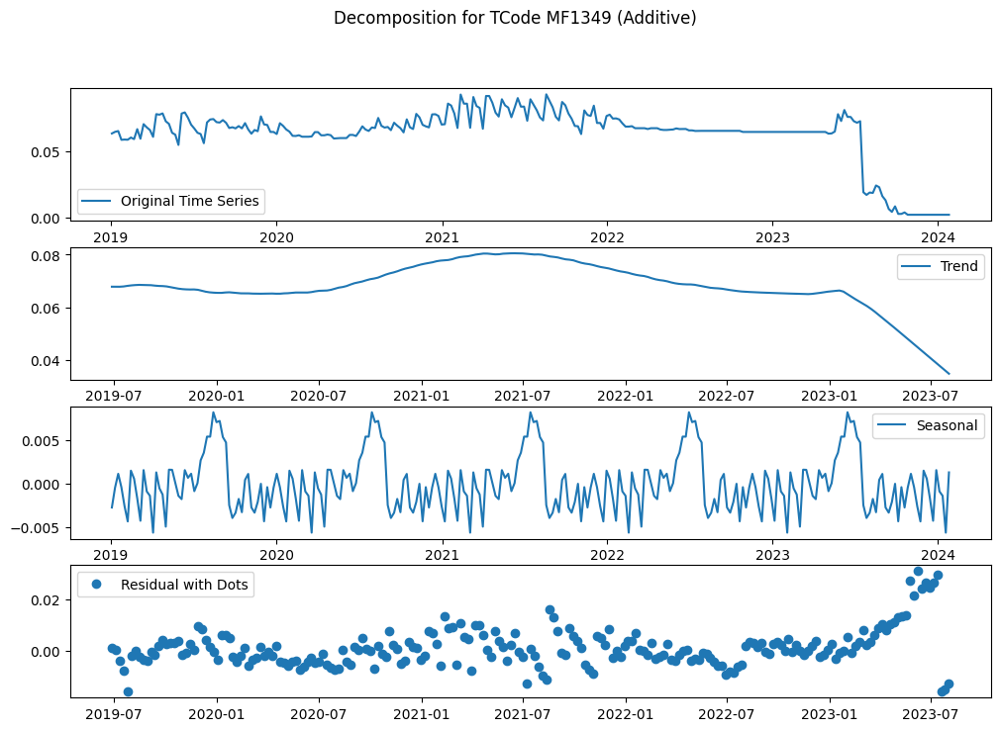

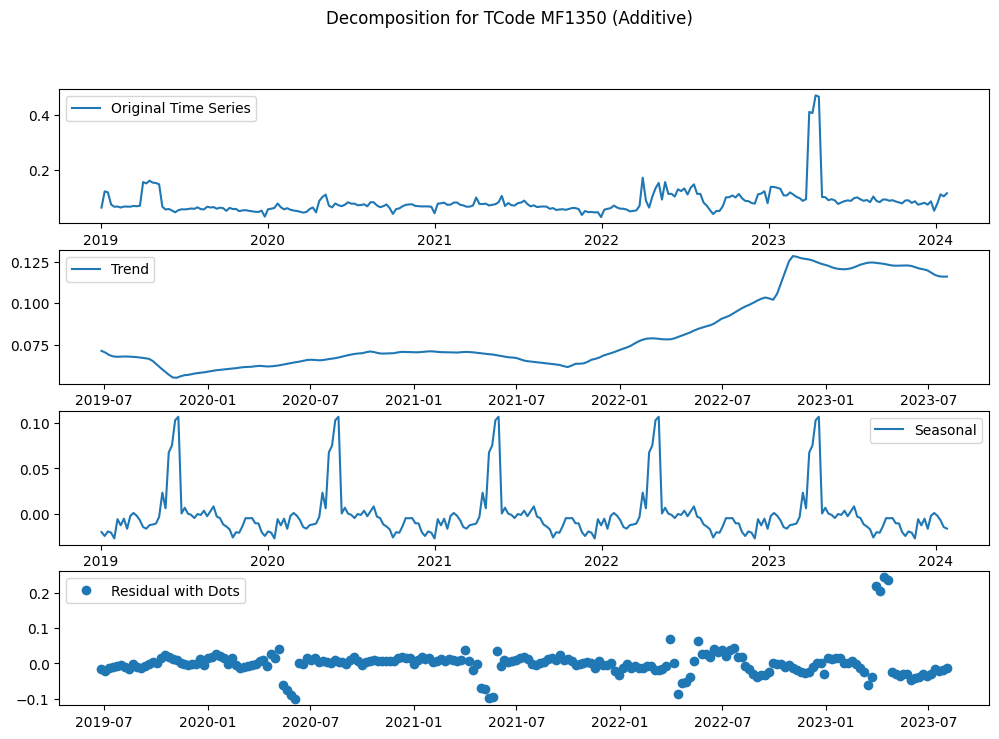

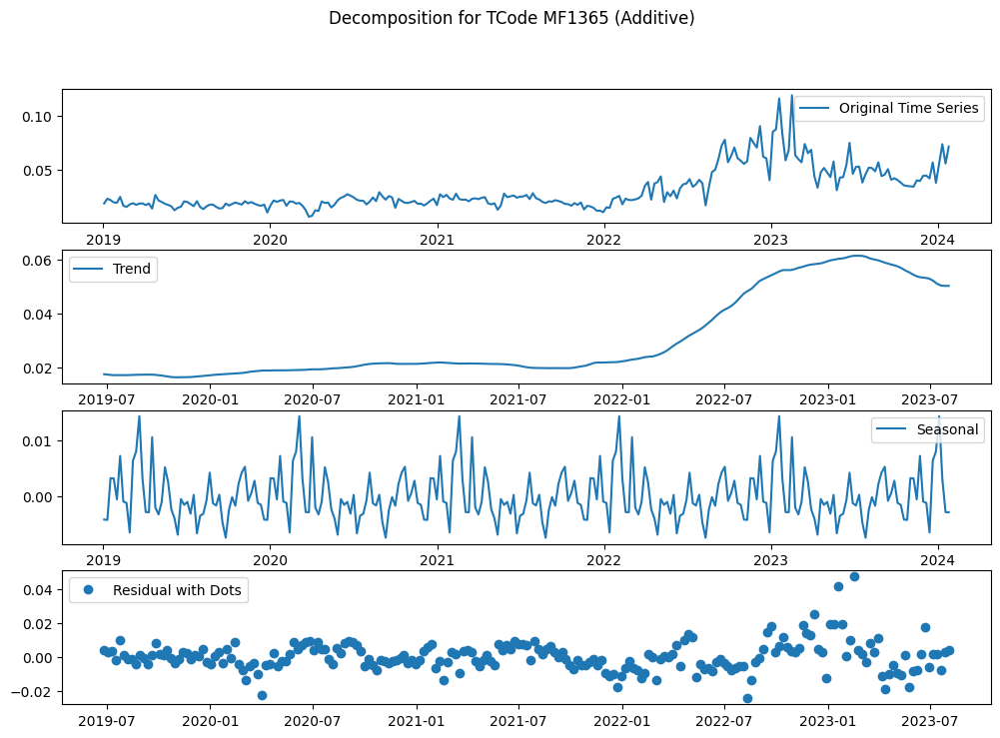

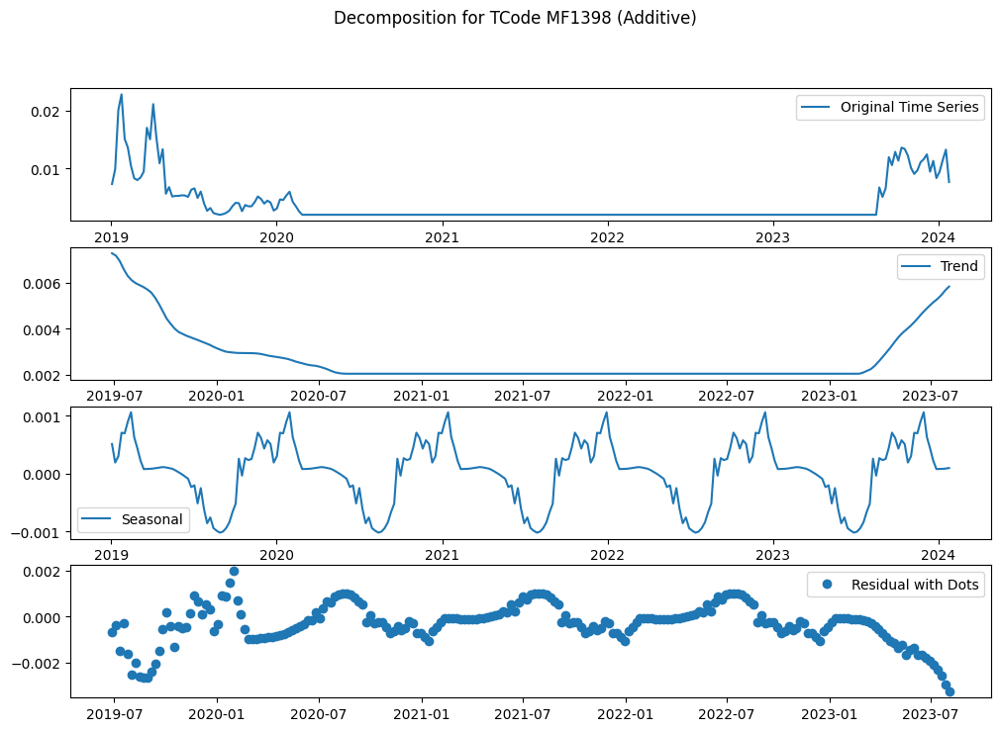

Error for TCode MF1402: x must have 2 complete cycles requires 100 observations. x only has 45 observation(s)


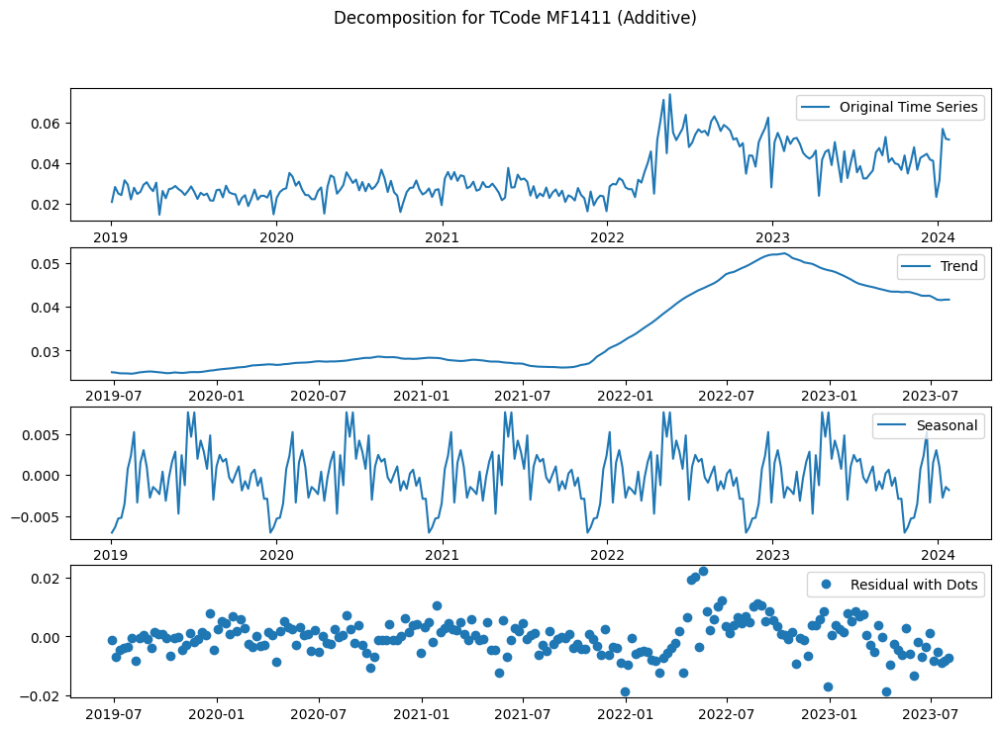

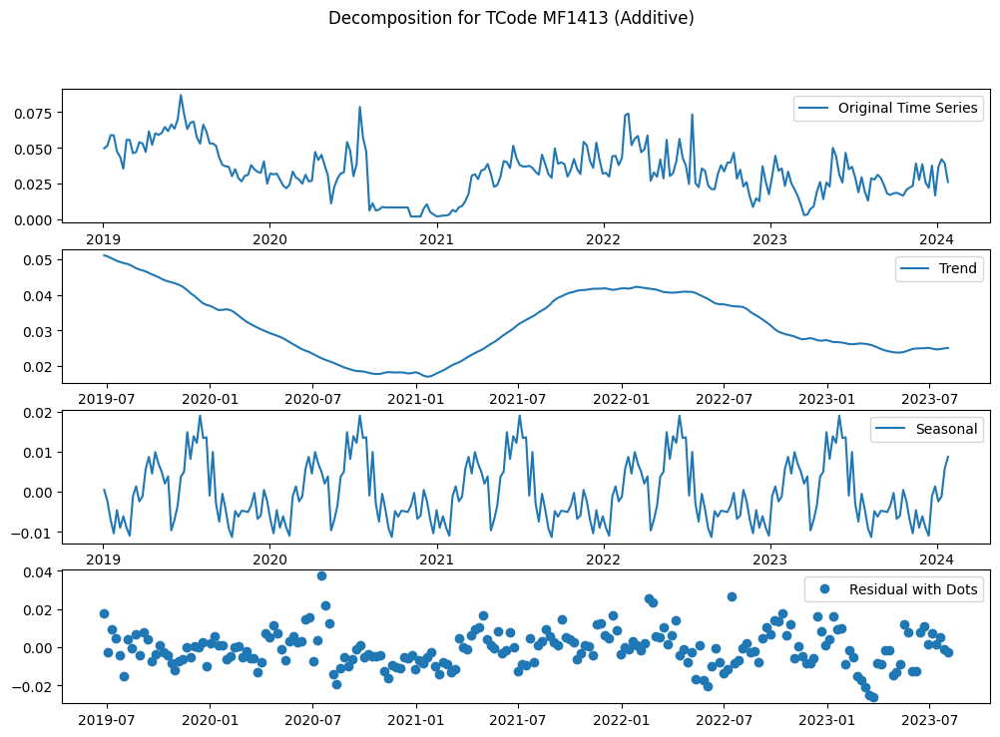

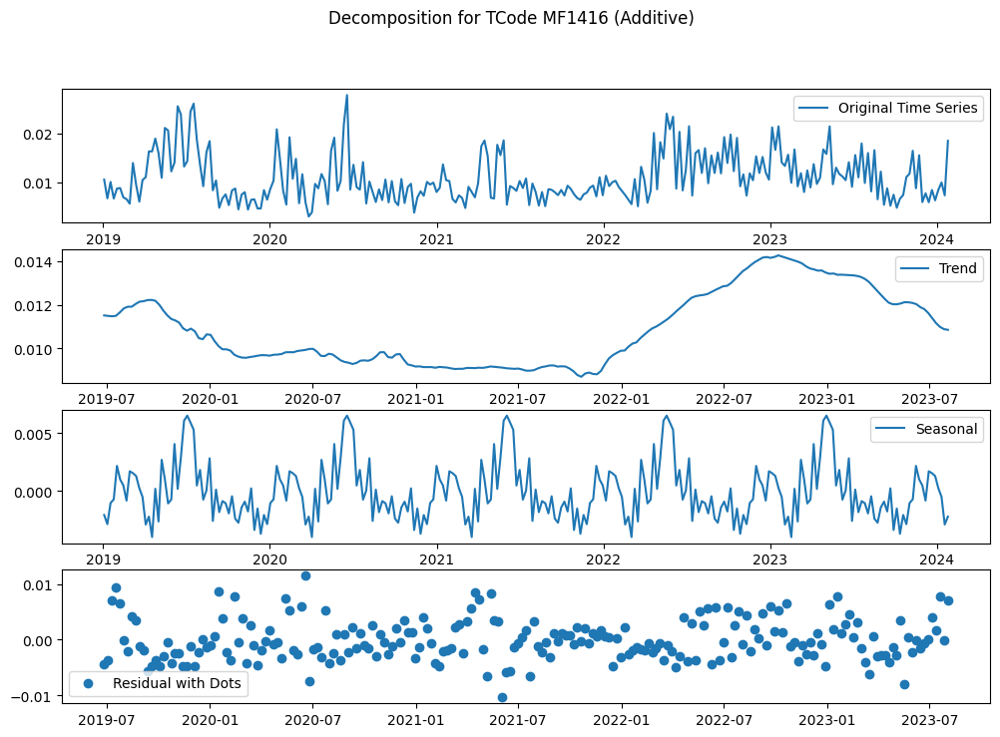

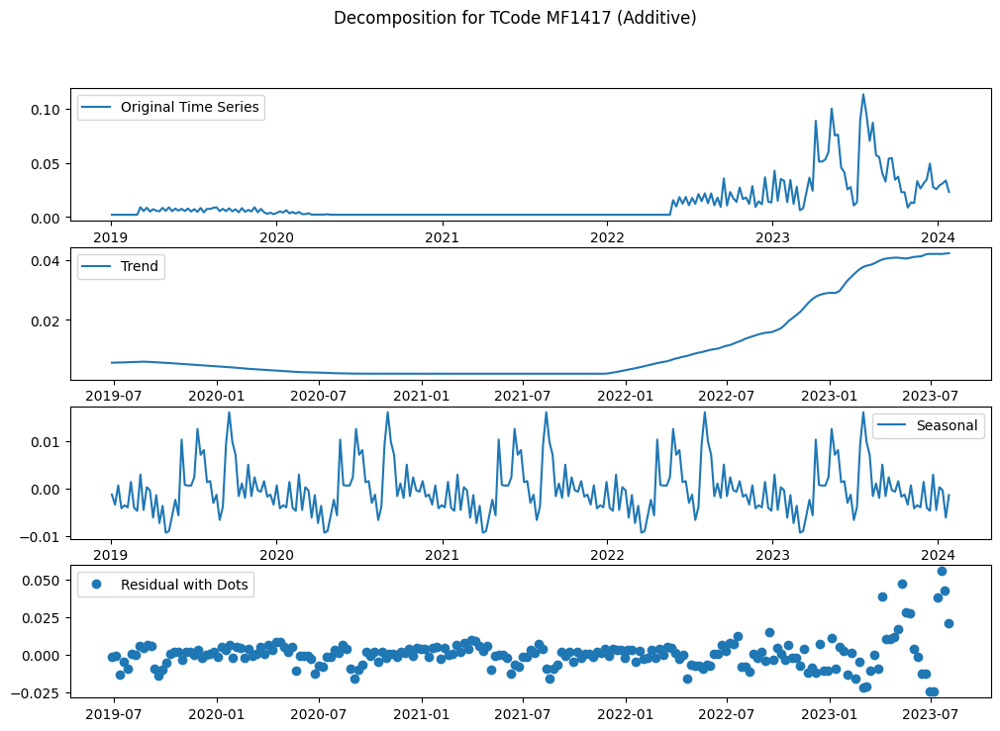

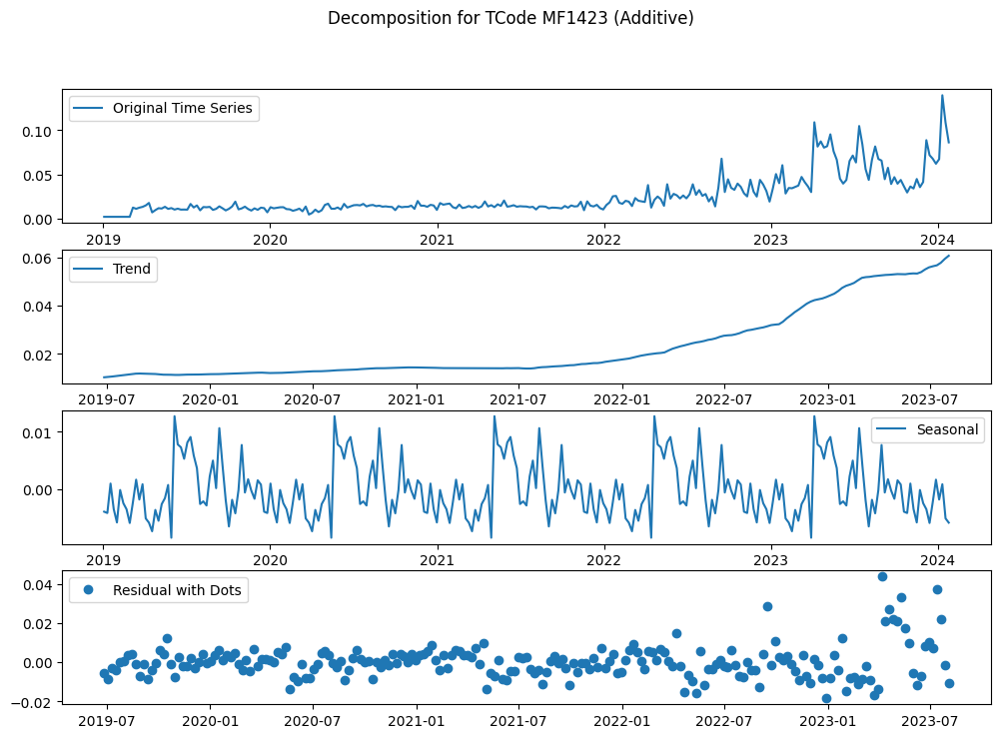

Error for TCode MF1426: x must have 2 complete cycles requires 100 observations. x only has 12 observation(s)
Error for TCode MF1433: x must have 2 complete cycles requires 100 observations. x only has 80 observation(s)
Error for TCode MF1436: x must have 2 complete cycles requires 100 observations. x only has 4 observation(s)


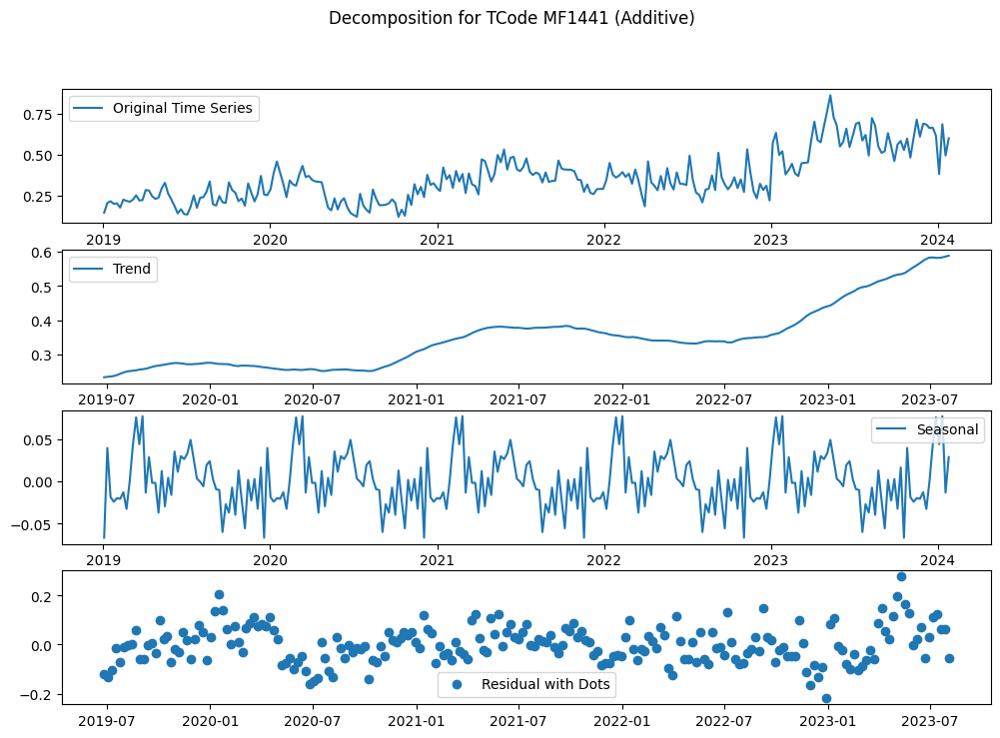

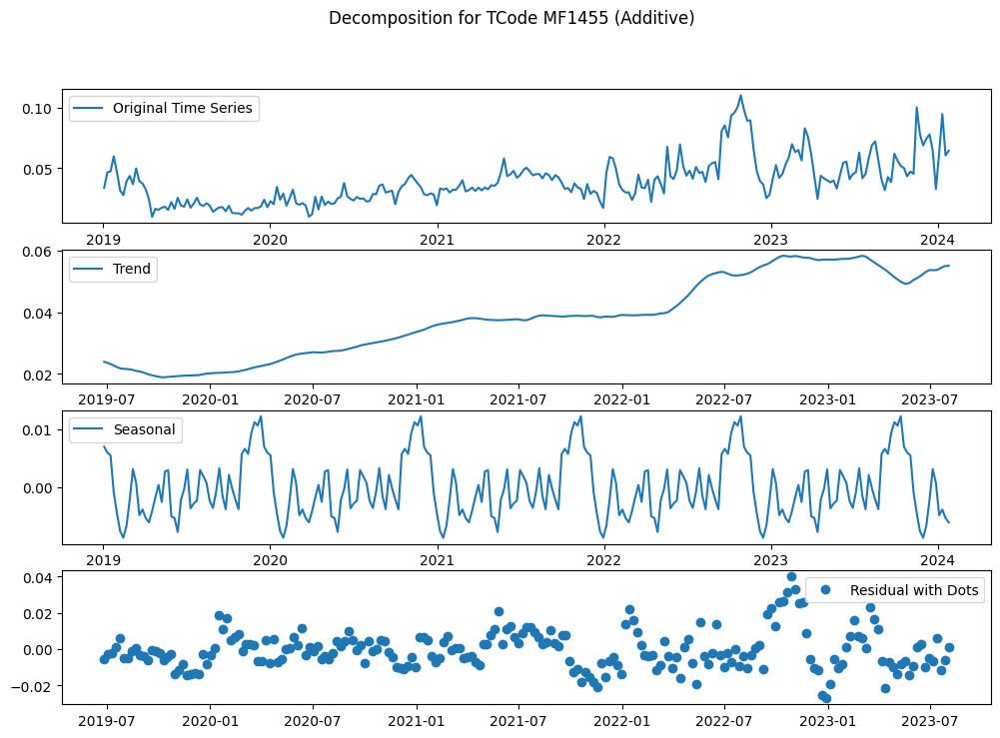

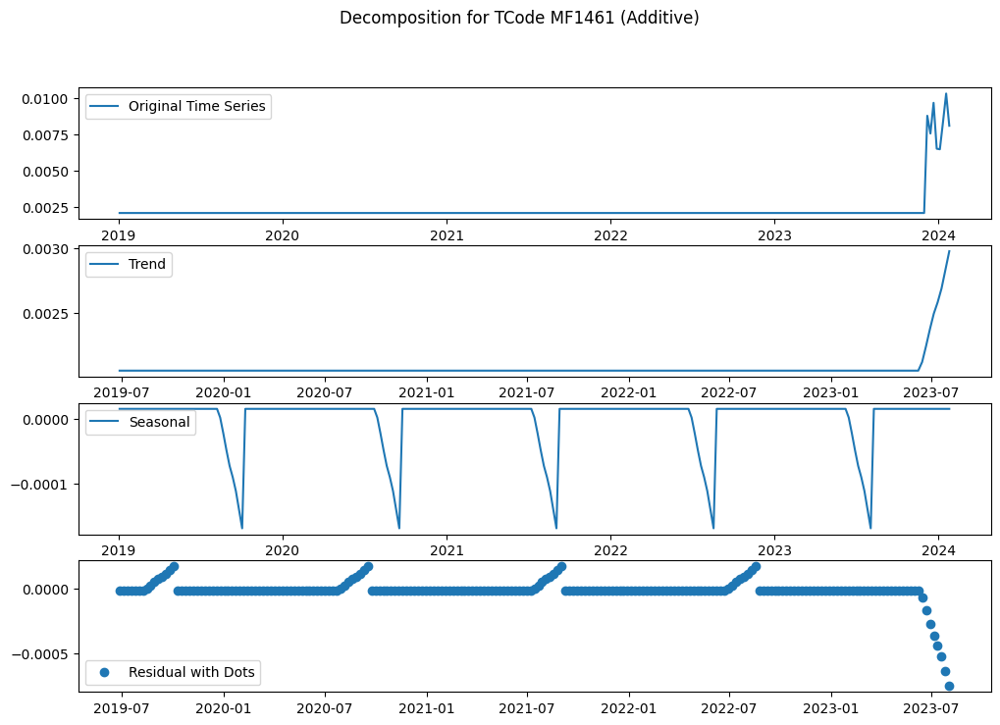

Error for TCode MF1462: x must have 2 complete cycles requires 100 observations. x only has 26 observation(s)


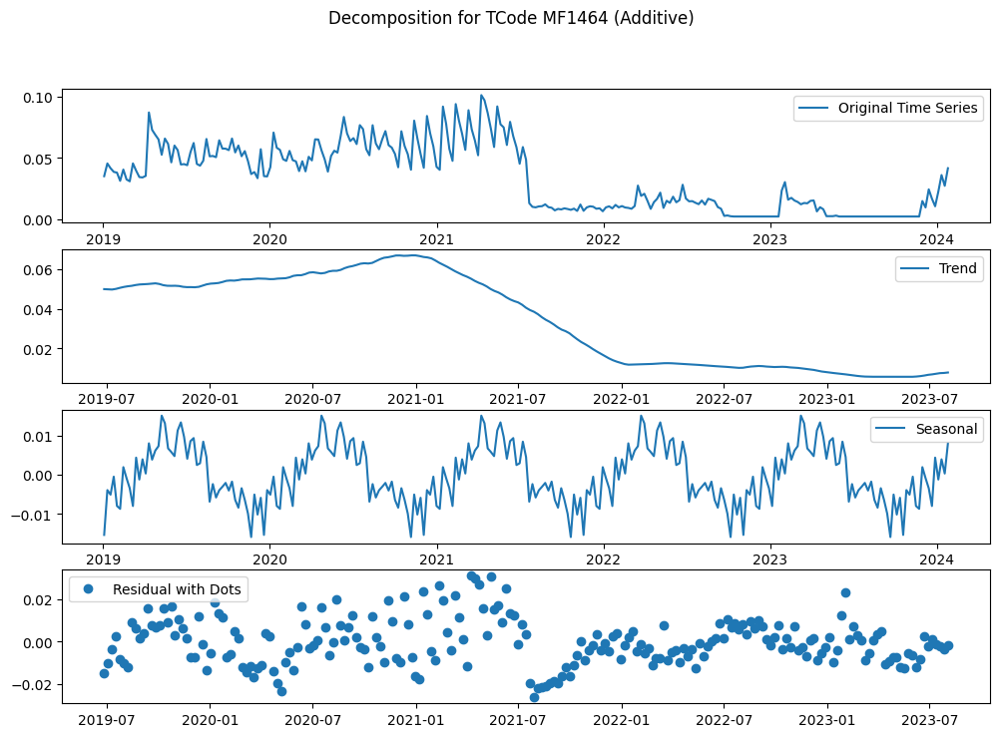

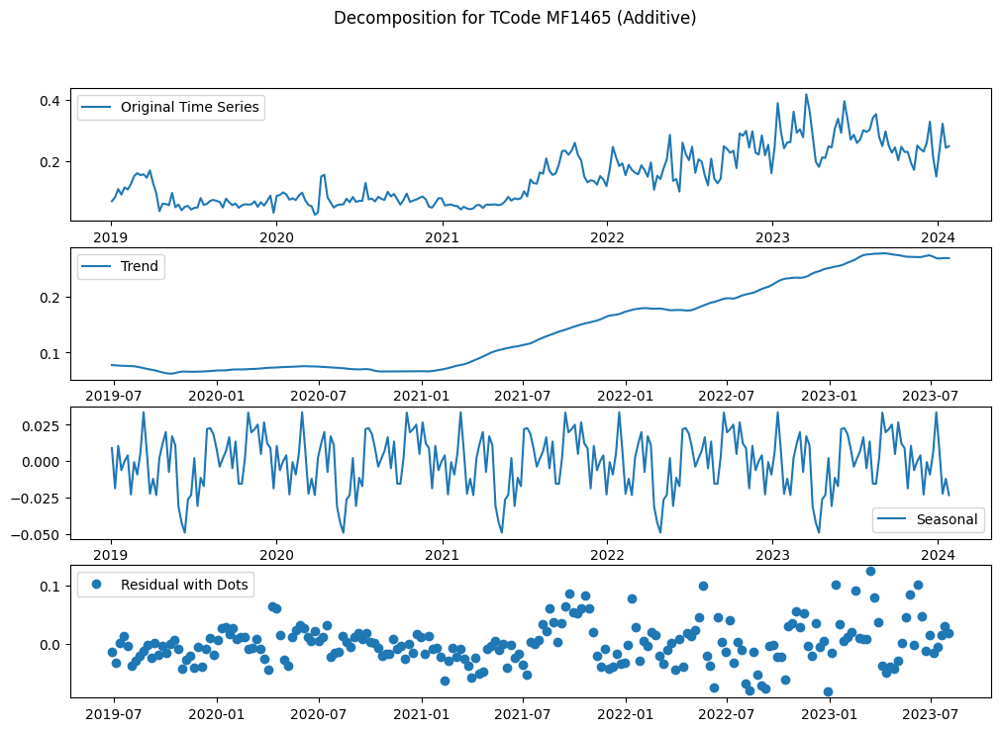

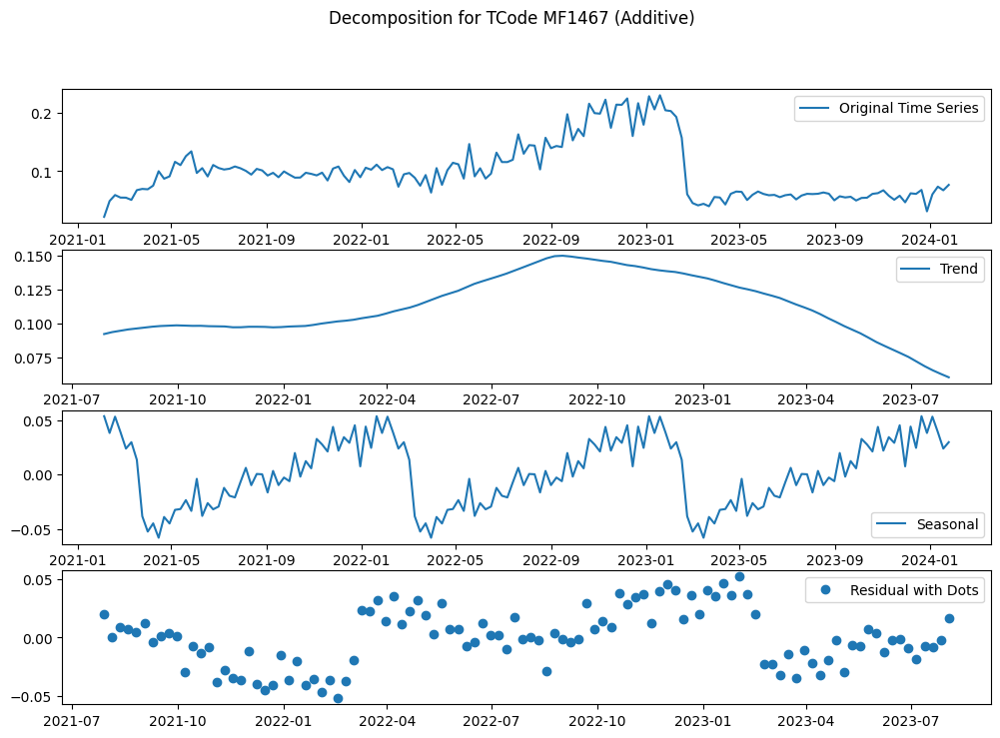

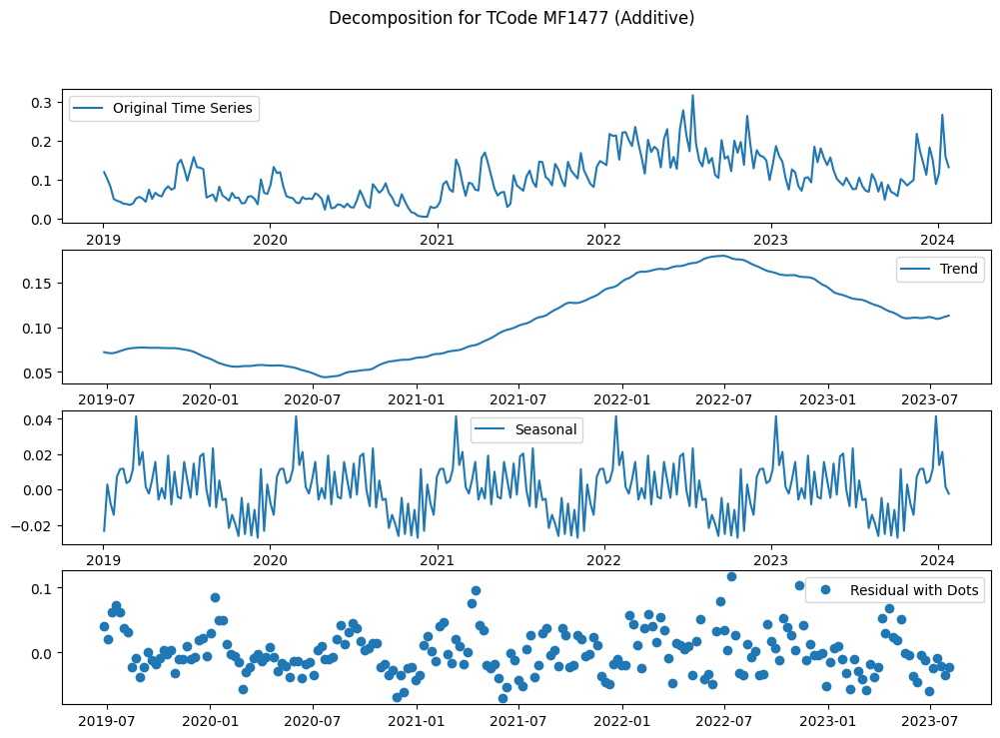

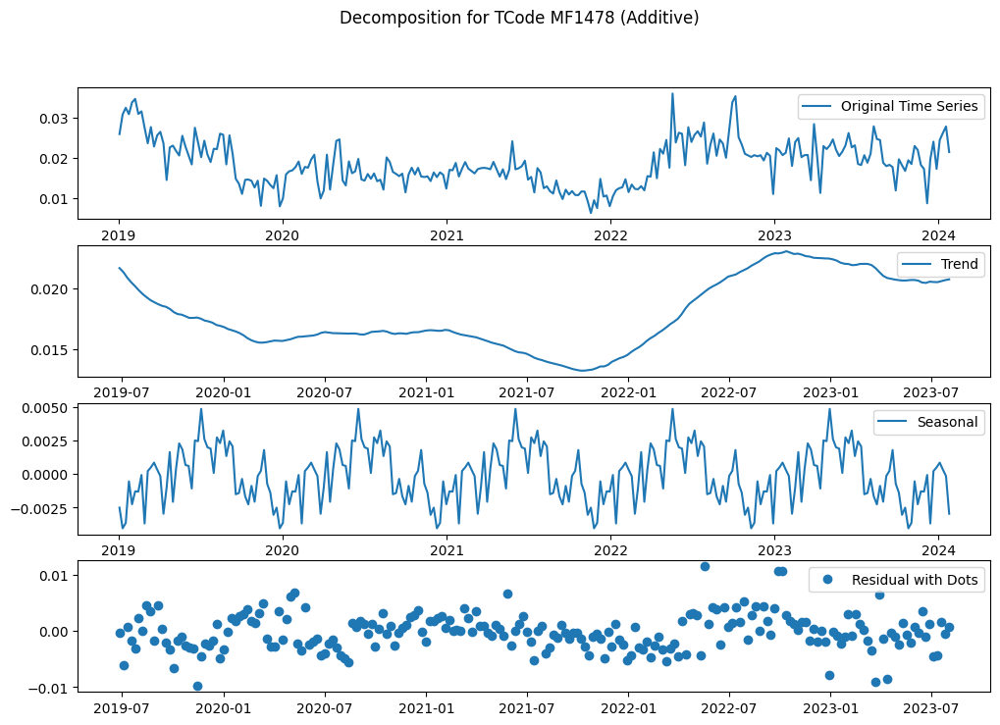

...

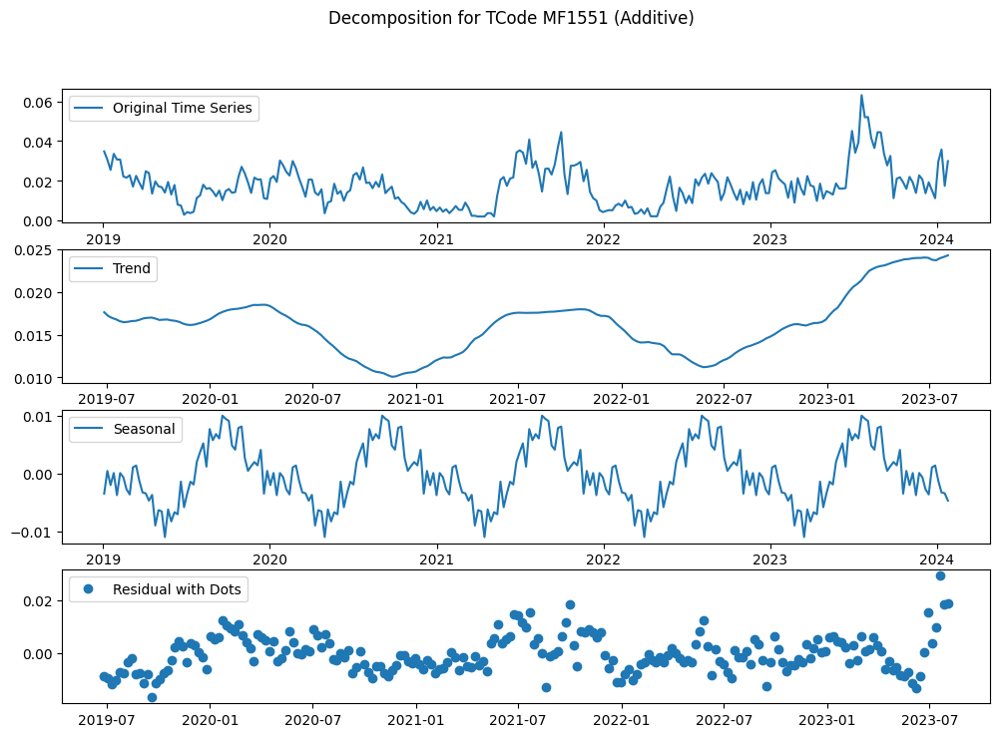

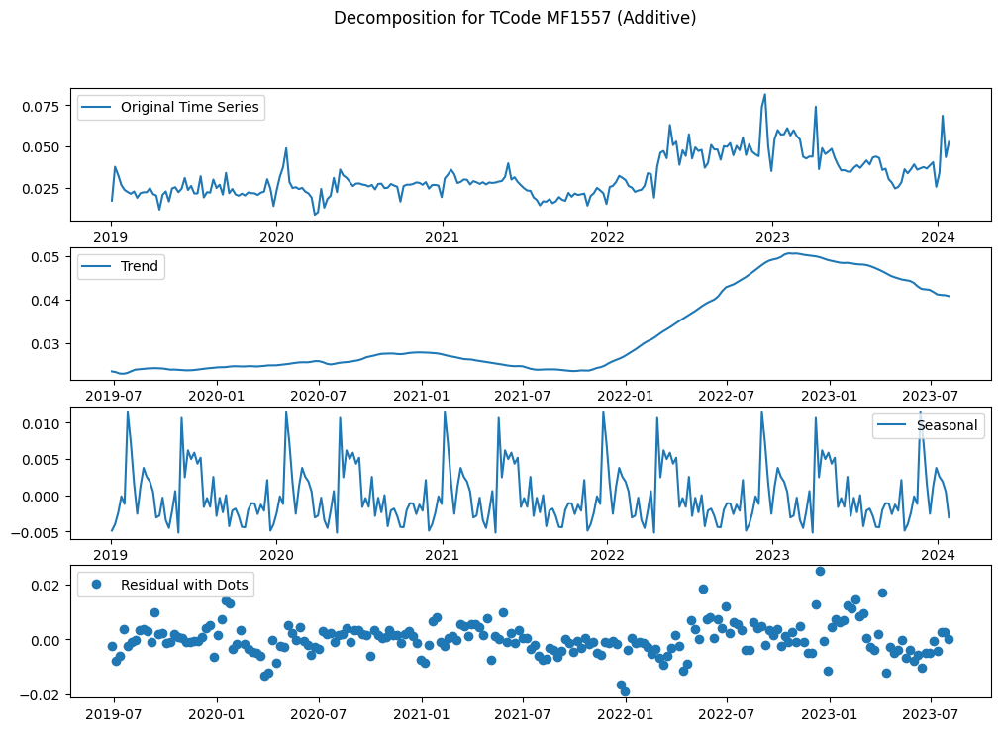

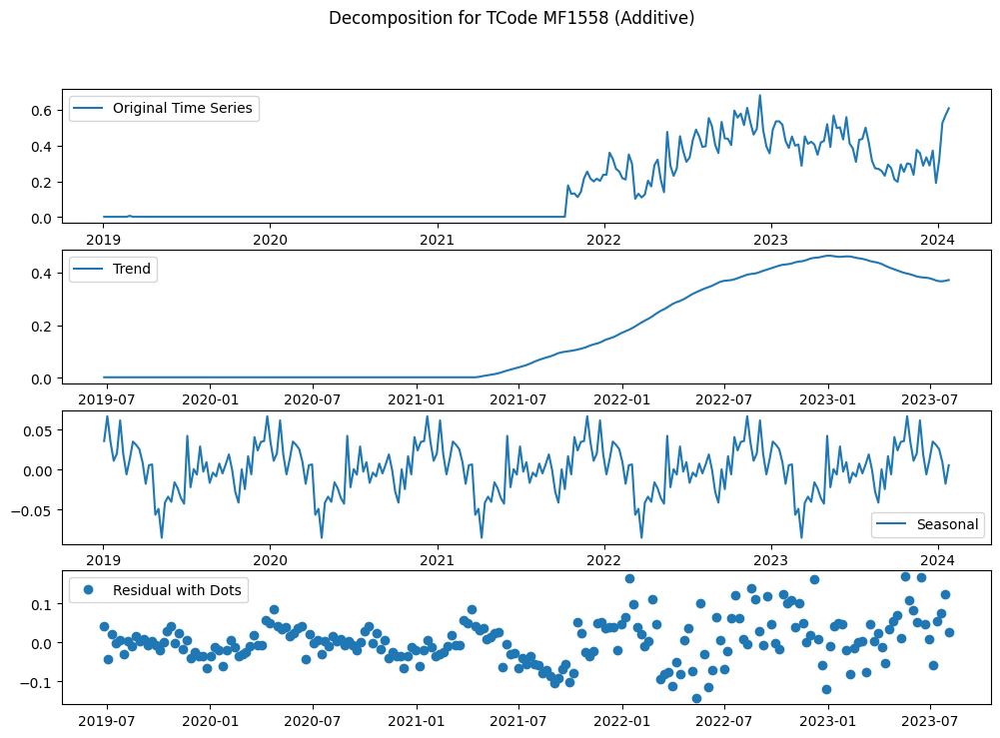

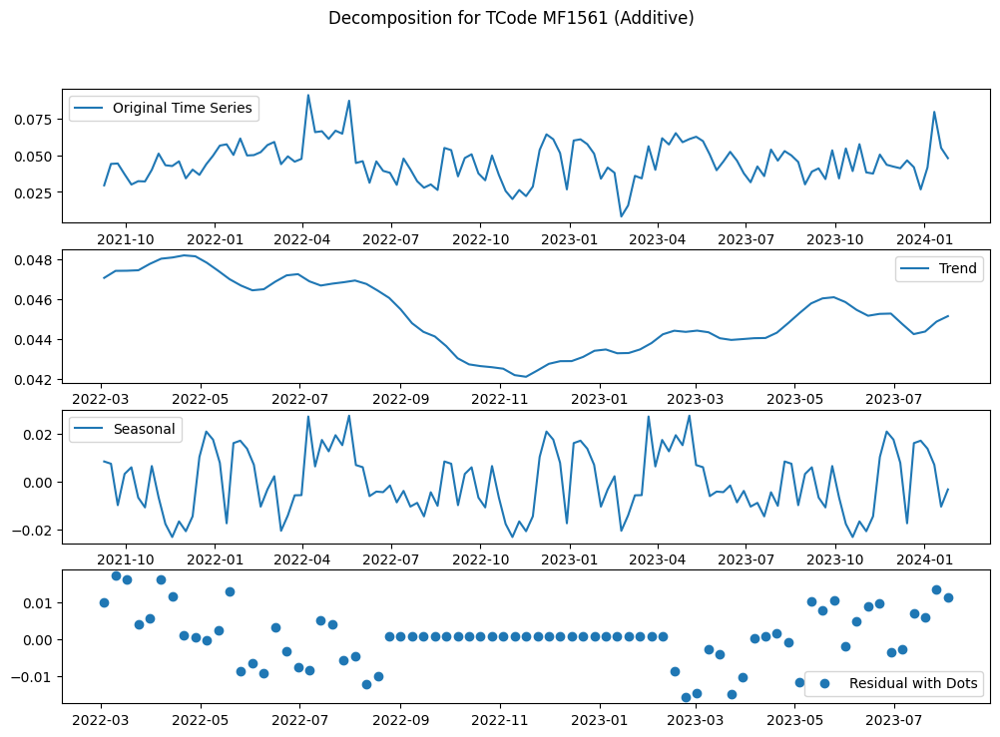

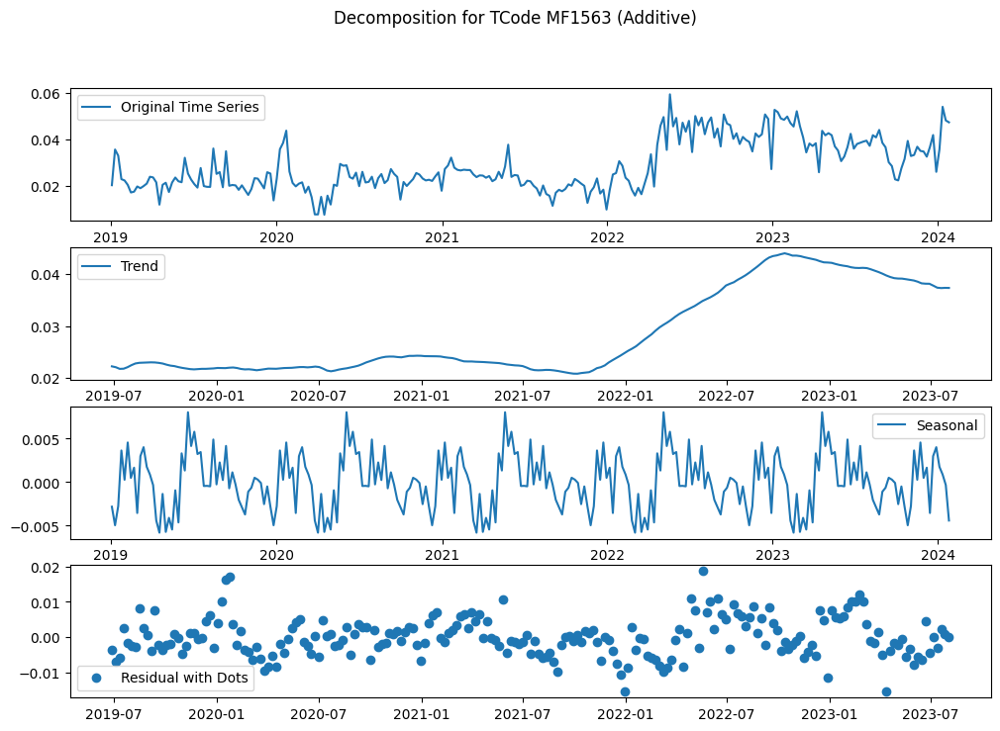

Error for TCode MF1564: x must have 2 complete cycles requires 100 observations. x only has 3 observation(s)


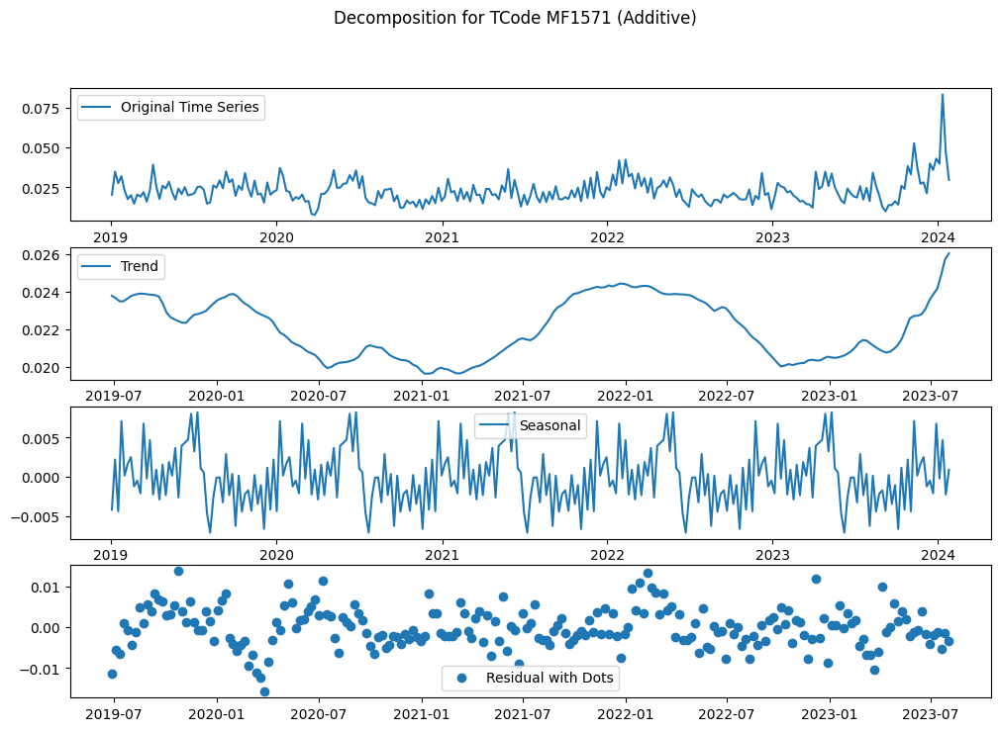

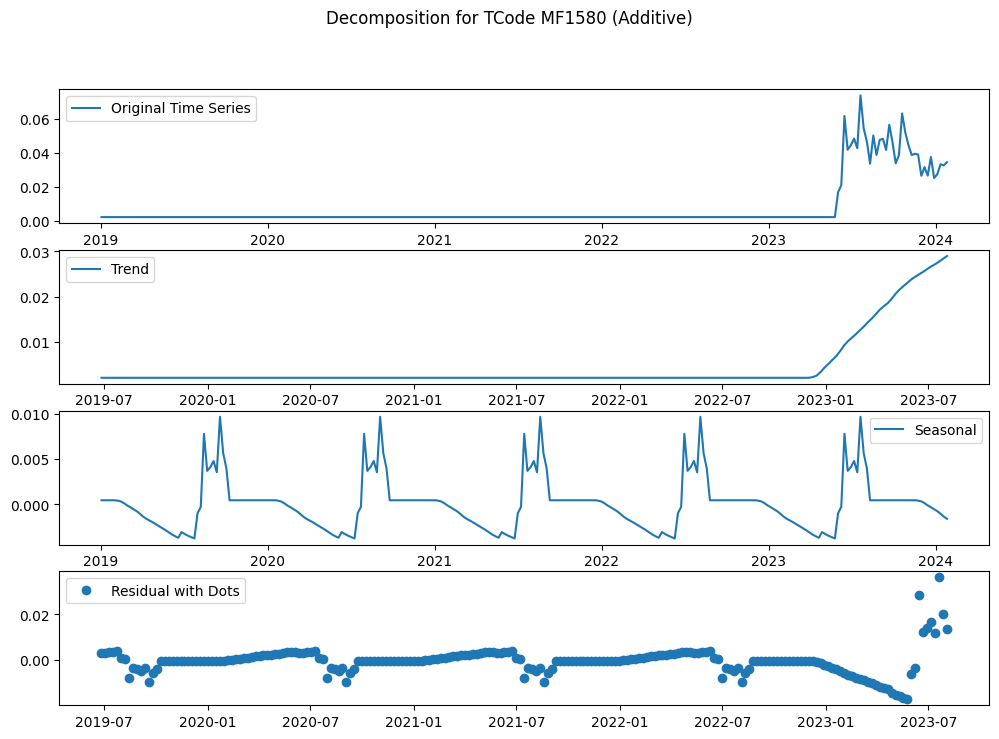

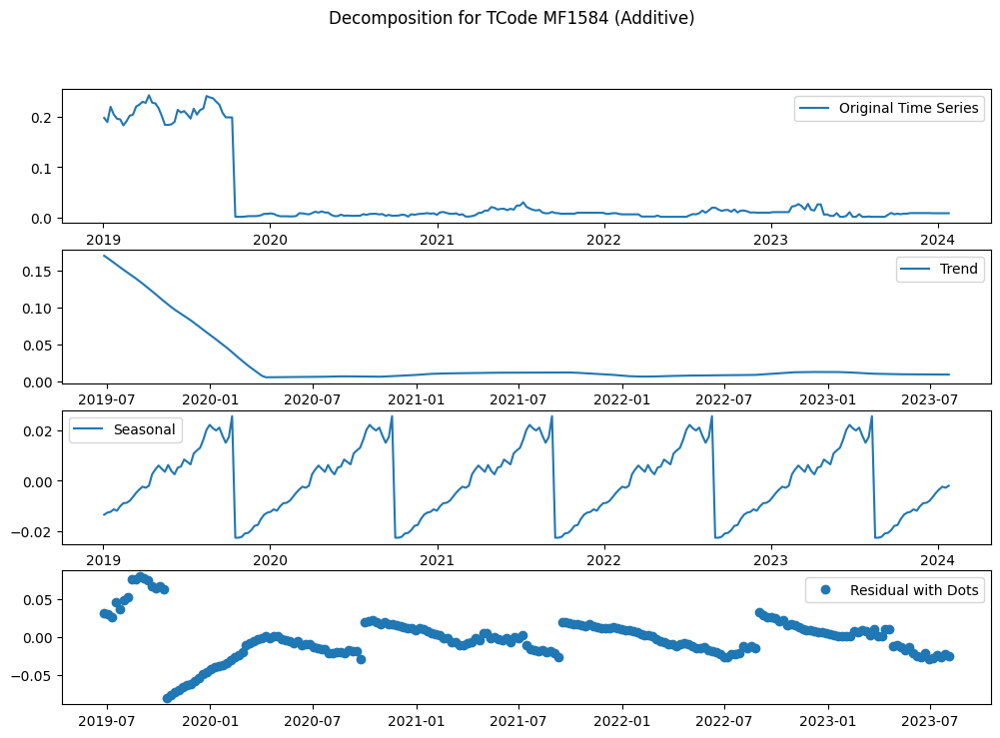

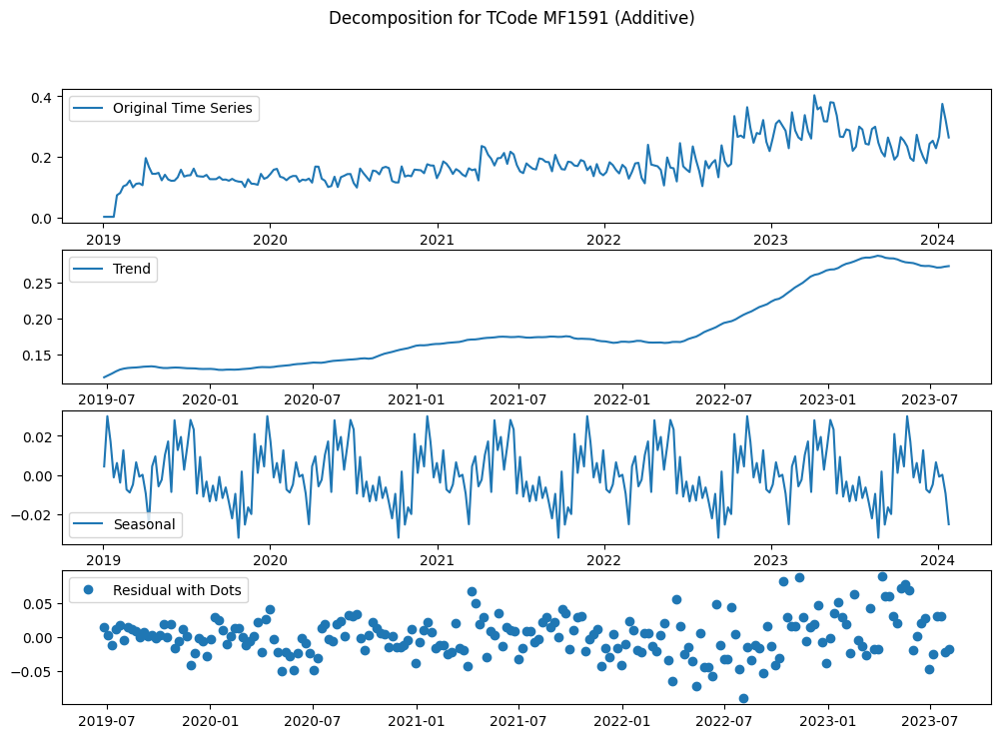

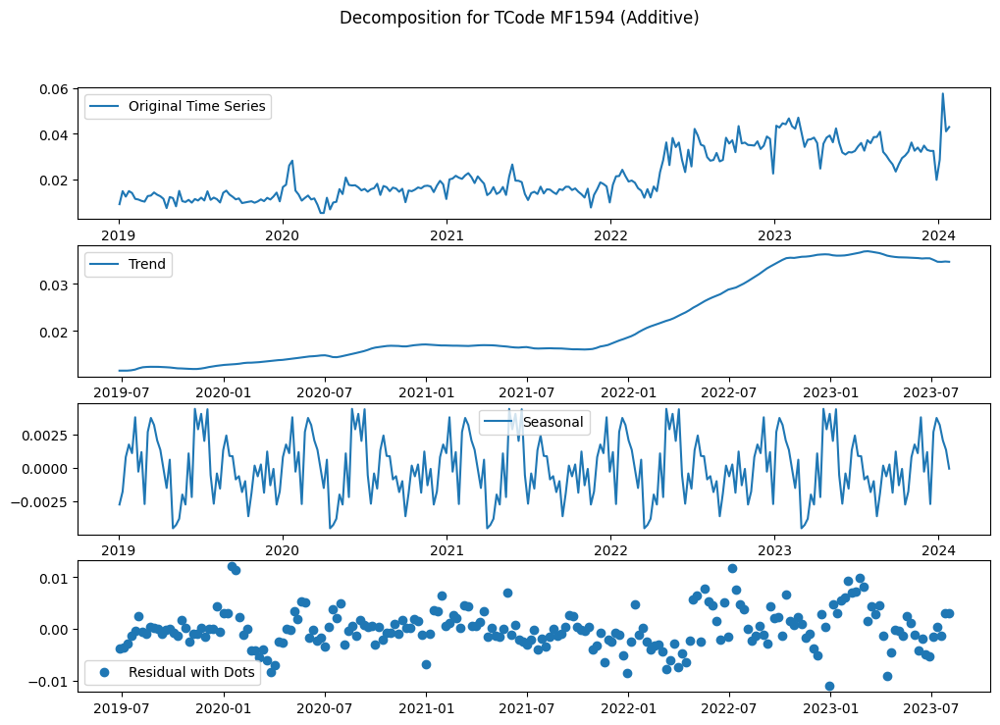

...

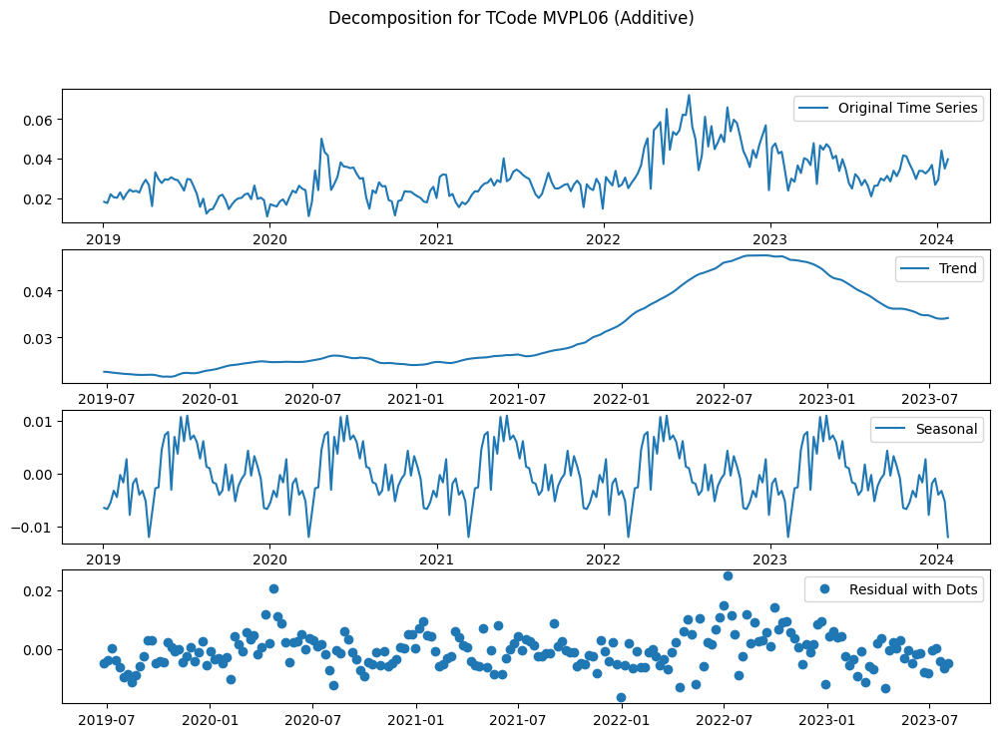

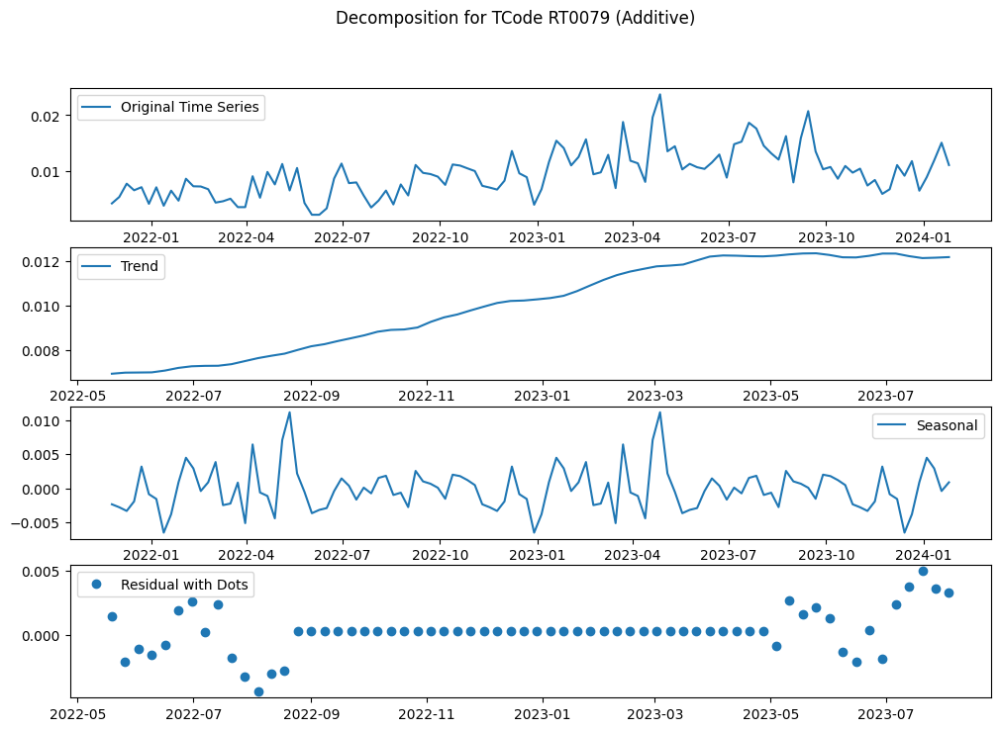

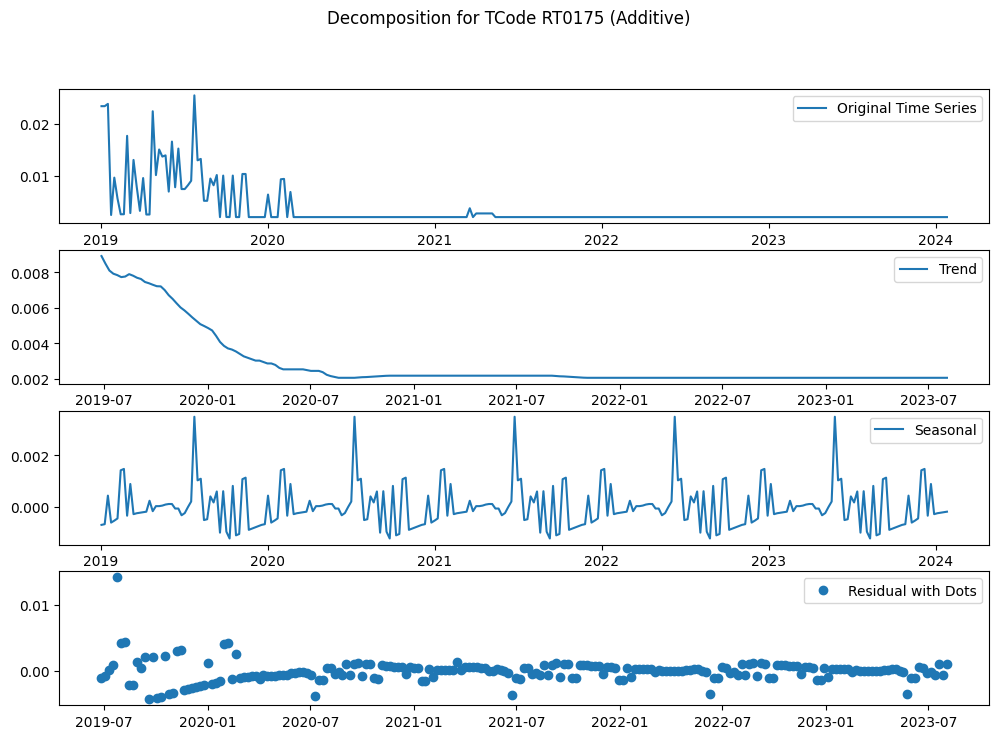

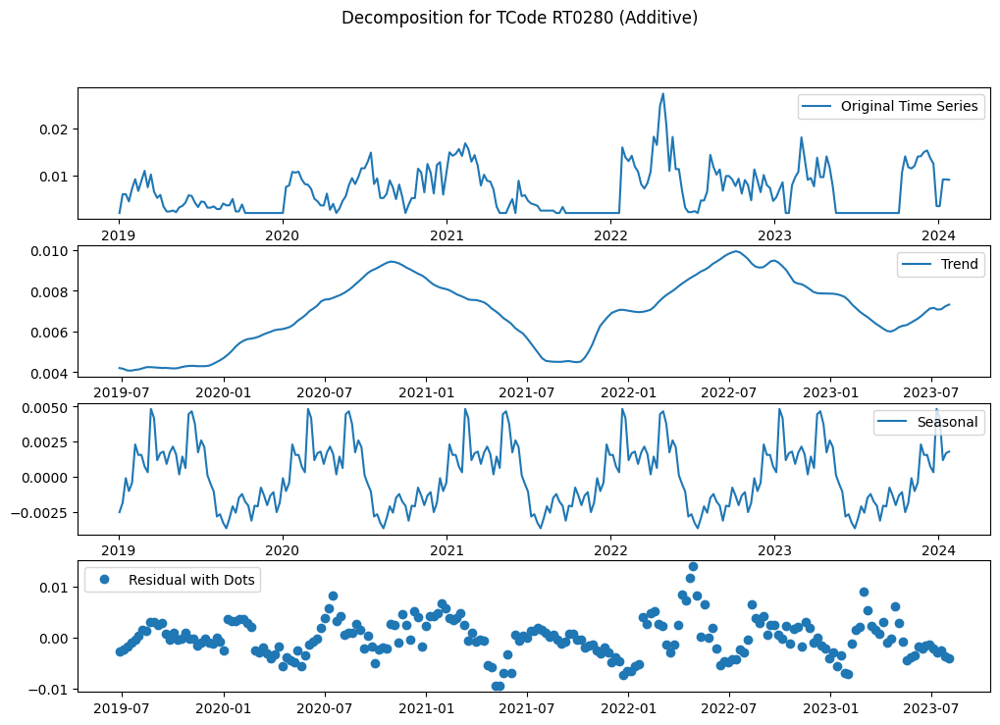

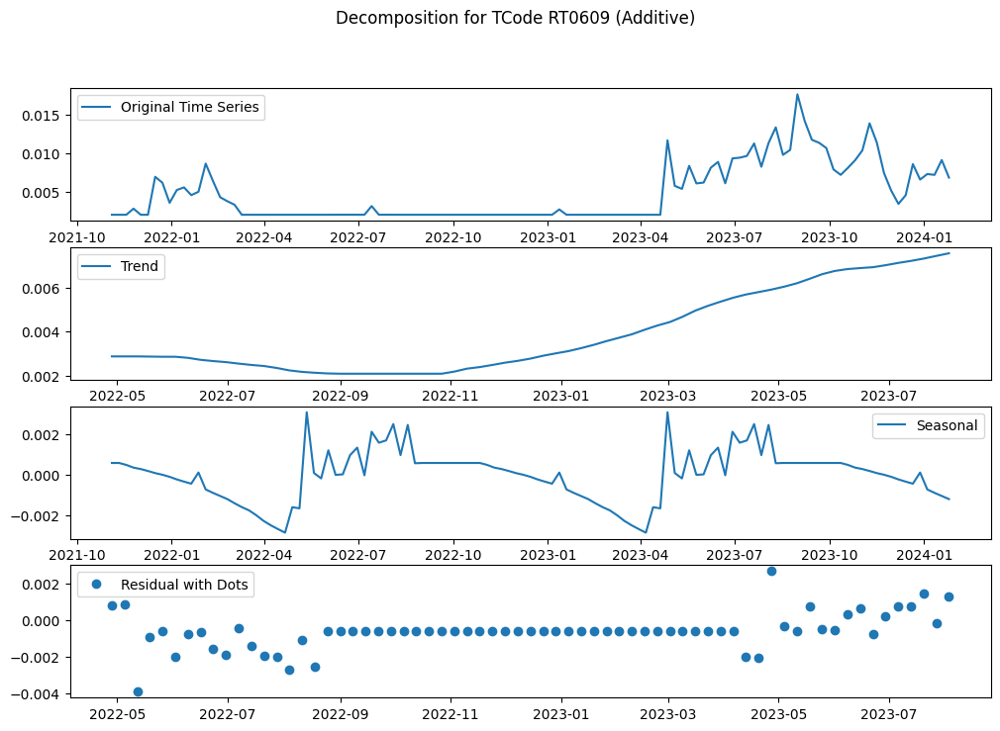

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

unique_tcodes = df['TCode'].unique()

for tcode in unique_tcodes:
    try:
        subset = df[df['TCode'] == tcode]

        # Extract the time series values and set the index
        time_series = subset['NormalizedRiskIndicator']
        time_series.index = pd.to_datetime(subset['TransferDate'])

        # Perform additive decomposition
        result_additive = seasonal_decompose(time_series, model='additive', period=50)

        # Extract components
        trend_additive = result_additive.trend
        seasonal_additive = result_additive.seasonal
        residual_additive = result_additive.resid

        plt.figure(figsize=(12, 8))

        plt.subplot(4, 1, 1)
        plt.plot(time_series, label='Original Time Series')
        plt.legend()

        plt.subplot(4, 1, 2)
        plt.plot(trend_additive, label='Trend')
        plt.legend()

        plt.subplot(4, 1, 3)
        plt.plot(seasonal_additive, label='Seasonal')
        plt.legend()

        plt.subplot(4, 1, 4)
        plt.plot(residual_additive, 'o', label='Residual with Dots')
        plt.legend()

        plt.suptitle(f'Decomposition for TCode {tcode} (Additive)')
        plt.show()

    except ValueError as e:
        print(f"Error for TCode {tcode}: {e}")
        continue


Drop the TCodes which does not have suffiecient data for the decomposition

In [17]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose

unique_tcodes = df['TCode'].unique()

error_tcodes = []

for tcode in unique_tcodes:
    try:
        subset = df[df['TCode'] == tcode]

        time_series = subset['NormalizedRiskIndicator']

        # Check if the time series has enough datapoints for decomposition
        if len(time_series) < 100:
            error_tcodes.append(tcode)

        # Perform additive decomposition
        result_additive = seasonal_decompose(time_series, model='additive', period=50)

    except ValueError as e:
        print(f"Error for TCode {tcode}: {e}")
        error_tcodes.append(tcode)

df_cleaned = df[~df['TCode'].isin(error_tcodes)]



Error for TCode BF0143: x must have 2 complete cycles requires 100 observations. x only has 28 observation(s)
Error for TCode MF0064: x must have 2 complete cycles requires 100 observations. x only has 47 observation(s)
Error for TCode MF0127: x must have 2 complete cycles requires 100 observations. x only has 12 observation(s)
Error for TCode MF0204: x must have 2 complete cycles requires 100 observations. x only has 38 observation(s)
Error for TCode MF0206: x must have 2 complete cycles requires 100 observations. x only has 92 observation(s)
Error for TCode MF0221: x must have 2 complete cycles requires 100 observations. x only has 62 observation(s)
Error for TCode MF0255: x must have 2 complete cycles requires 100 observations. x only has 7 observation(s)
Error for TCode MF0308: x must have 2 complete cycles requires 100 observations. x only has 92 observation(s)
Error for TCode MF0490: x must have 2 complete cycles requires 100 observations. x only has 70 observation(s)
Error for T

In [18]:
unique_tcode_count = df_cleaned['TCode'].nunique()

print(f"Count of unique TCode: {unique_tcode_count}")


Count of unique TCode: 88


In [19]:
df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32745 entries, 0 to 33517
Data columns (total 3 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   TCode                    32745 non-null  object        
 1   TransferDate             32745 non-null  datetime64[ns]
 2   NormalizedRiskIndicator  32745 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 1023.3+ KB


In [21]:
df = df_cleaned

In [22]:
output_csv_file = "/content/drive/MyDrive/Asia Siyaka/Final02_DroppedAfterDecomposition.csv"
df.to_csv(output_csv_file, index=False)

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32745 entries, 0 to 33517
Data columns (total 3 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   TCode                    32745 non-null  object        
 1   TransferDate             32745 non-null  datetime64[ns]
 2   NormalizedRiskIndicator  32745 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 1023.3+ KB


Creating 4 Dataframes depending on the type of the cusotmer at 2024/03/06

In [24]:

# Create df_OA_Above150 dataframe
df_OA_Above150 = df[df['TCode'].isin(['MF1342', 'BF0161', 'MF1490', 'MF1441'])]

# Create df_OA_Above100 dataframe
df_OA_Above100 = df[df['TCode'].isin(['MF1591', 'MF1533', 'MF0975', 'MF1244'])]

# Create df_Advance_Upto100 dataframe
df_Advance_Upto100 = df[df['TCode'].isin(['MF1465', 'MF1477', 'MF1564', 'MF1561'])]

# Create df_Non_OA dataframe
df_Non_OA = df[df['TCode'].isin(['MF1337', 'MF1172', 'MF1365', 'MF0154', 'MF1510'])]


Build ARIMA for OVer Advance Above 150% Factories

In [25]:
df_OA_Above150.head()

,TCode,TransferDate,NormalizedRiskIndicator
540,BF0161,2019-01-03,0.292957
541,BF0161,2019-01-10,0.279473
542,BF0161,2019-01-17,0.240030
543,BF0161,2019-01-24,0.218743
544,BF0161,2019-01-31,0.181782


In [26]:
unique_tcode_count = df_OA_Above150['TCode'].nunique()

# Print or use the count as needed
print(f"Count of unique TCode: {unique_tcode_count}")

Count of unique TCode: 4


In [27]:
tcode_value_counts = df_OA_Above150['TCode'].value_counts()

# Display the result
print(tcode_value_counts)


BF0161    265
MF1342    265
MF1441    265
MF1490    265
Name: TCode, dtype: int64


In [28]:
df_OA_Above150['TransferDate'] = pd.to_datetime(df['TransferDate'])

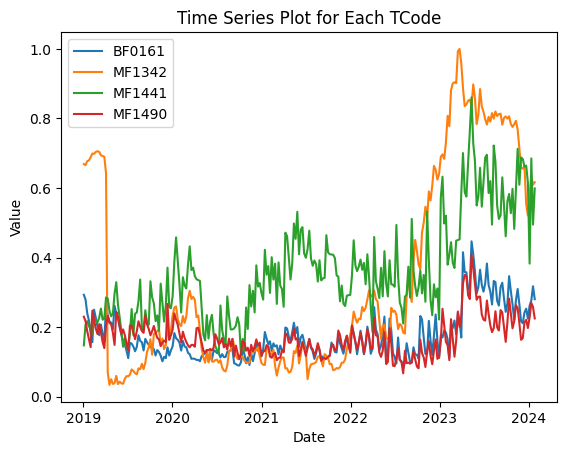

In [30]:
import matplotlib.pyplot as plt

unique_tcodes = df_OA_Above150['TCode'].unique()

for tcode in unique_tcodes:
    tcode_data = df_OA_Above150[df_OA_Above150['TCode'] == tcode]
    plt.plot(tcode_data['TransferDate'], tcode_data['NormalizedRiskIndicator'], label=tcode)

plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Time Series Plot for Each TCode')
plt.legend()
plt.show()


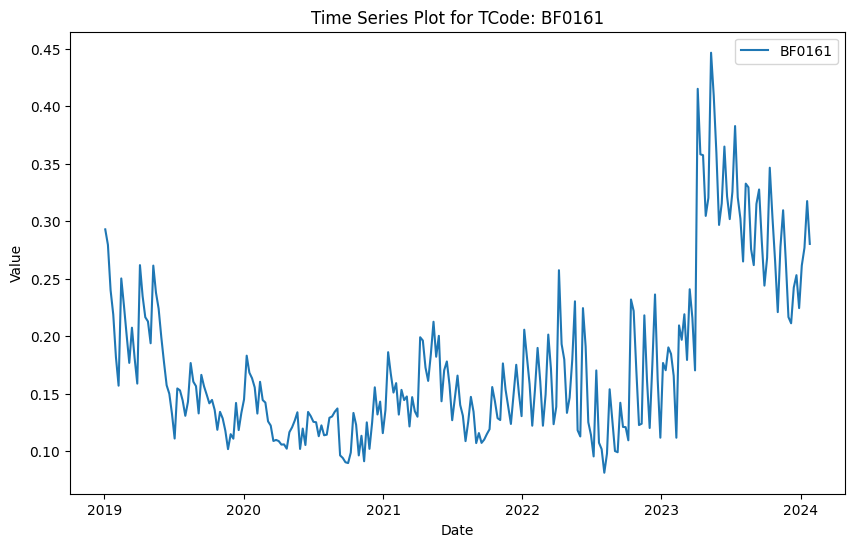

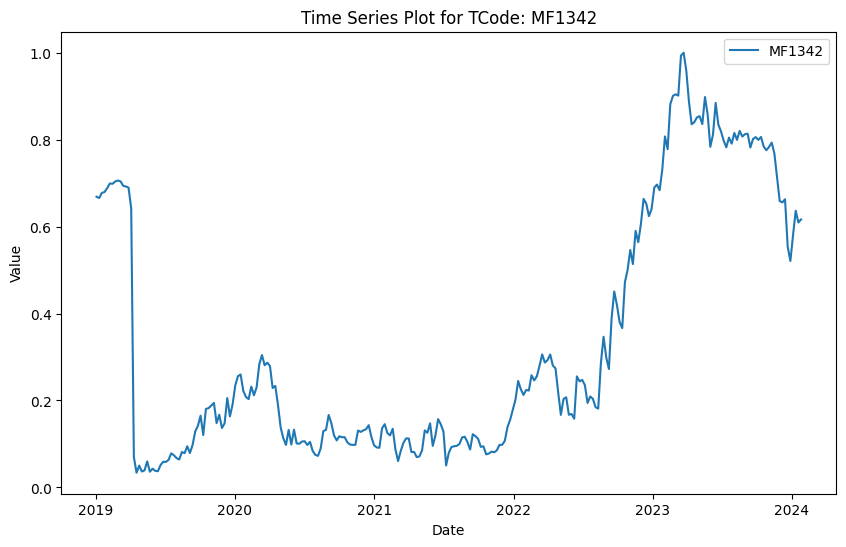

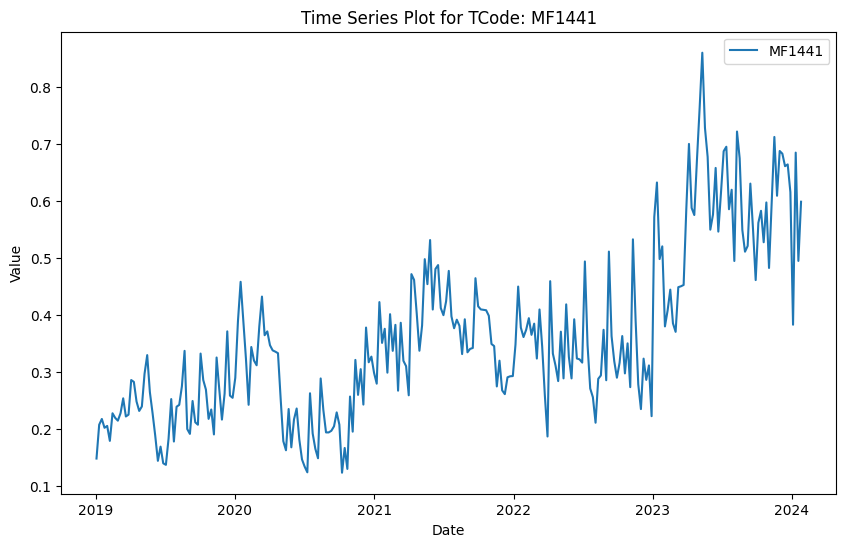

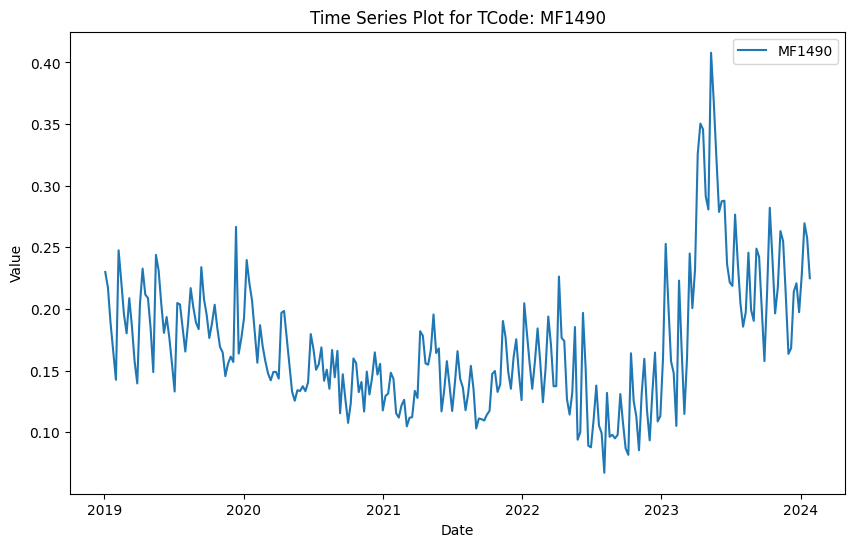

In [31]:
import matplotlib.pyplot as plt

unique_tcodes = df_OA_Above150['TCode'].unique()

for tcode in unique_tcodes:
    tcode_data = df_OA_Above150[df_OA_Above150['TCode'] == tcode]
    plt.figure(figsize=(10, 6))
    plt.plot(tcode_data['TransferDate'], tcode_data['NormalizedRiskIndicator'], label=tcode)
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title(f'Time Series Plot for TCode: {tcode}')
    plt.legend()
    plt.show()


Time Series Decomposition for Over Advance above 150%

In [32]:
!pip install matplotlib

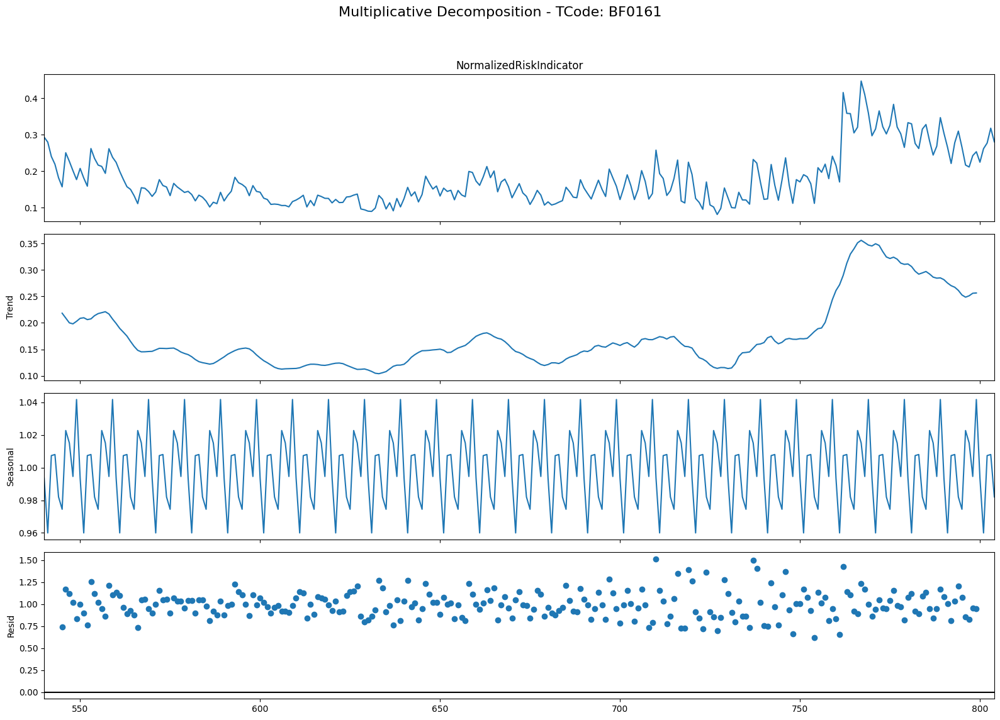

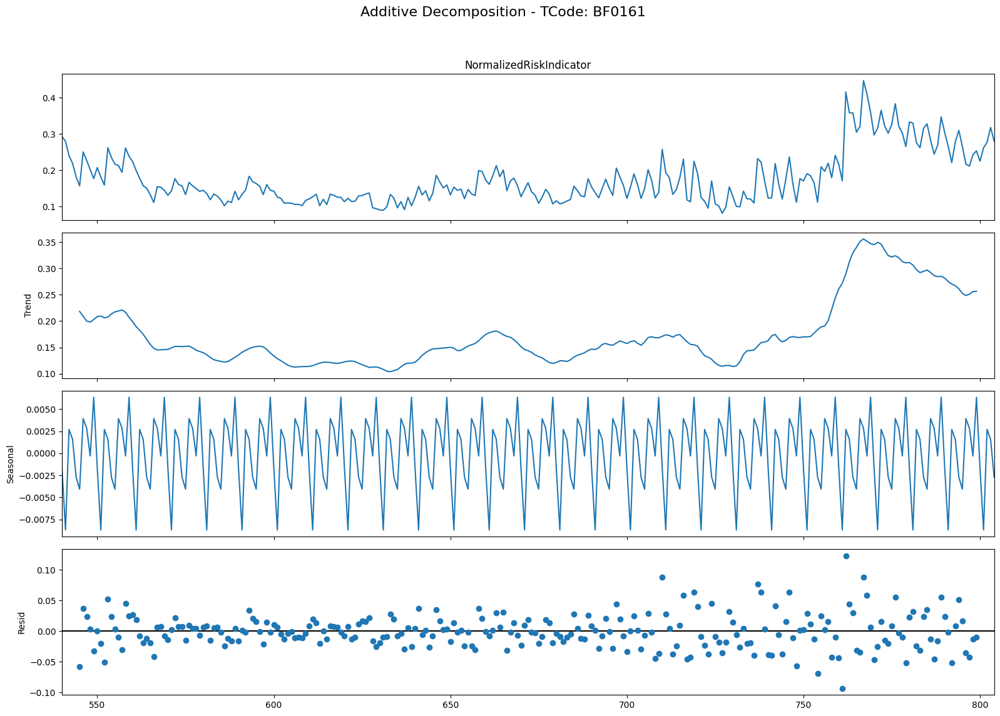

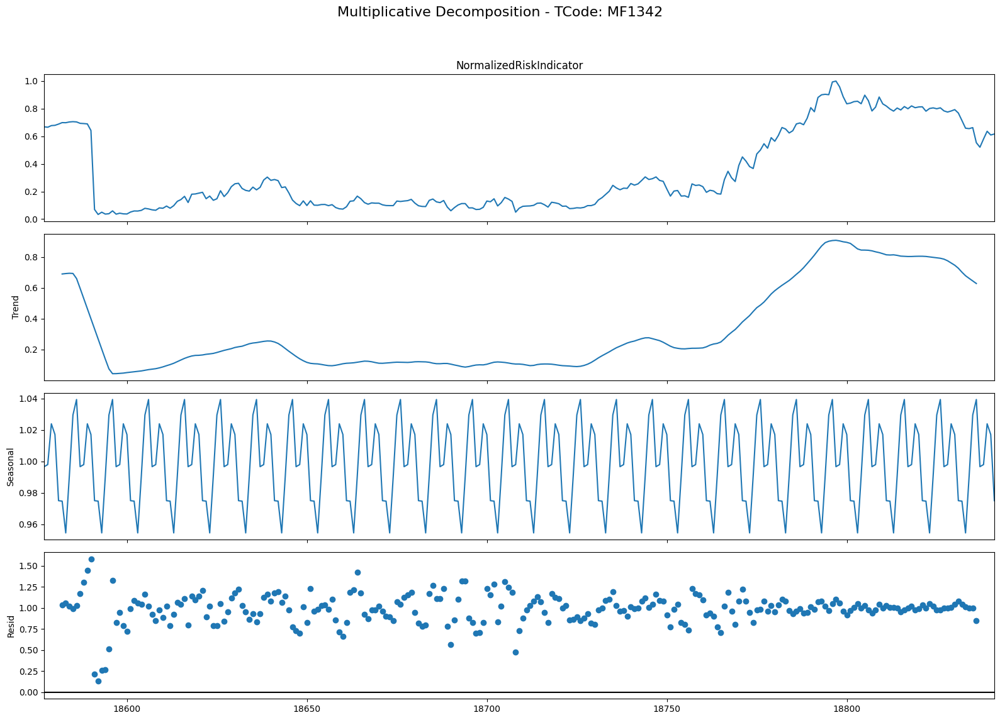

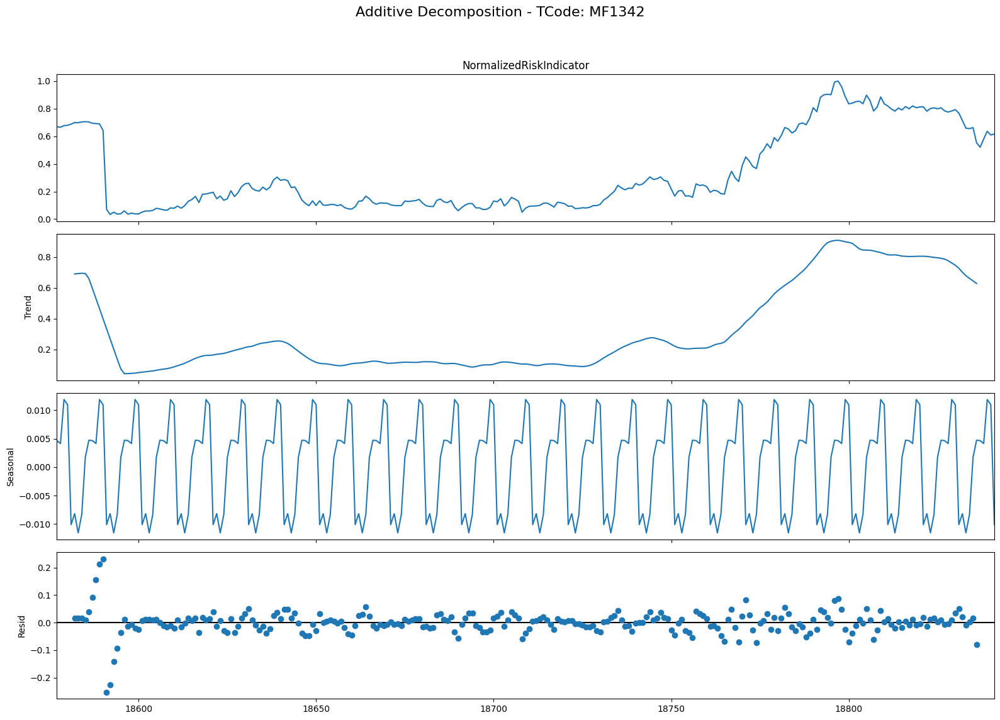

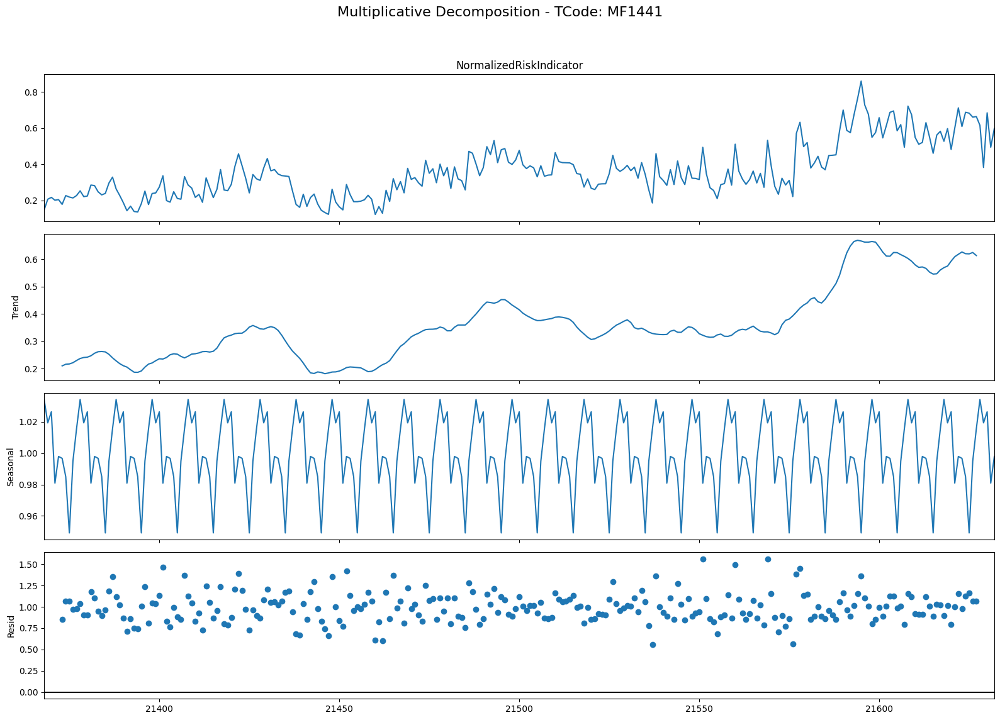

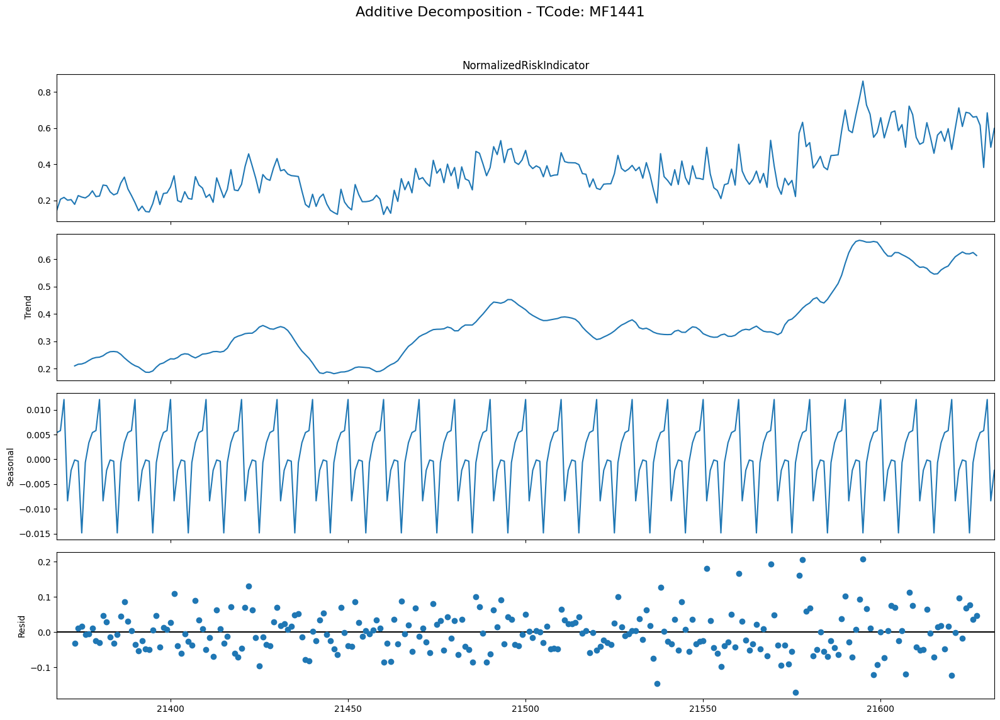

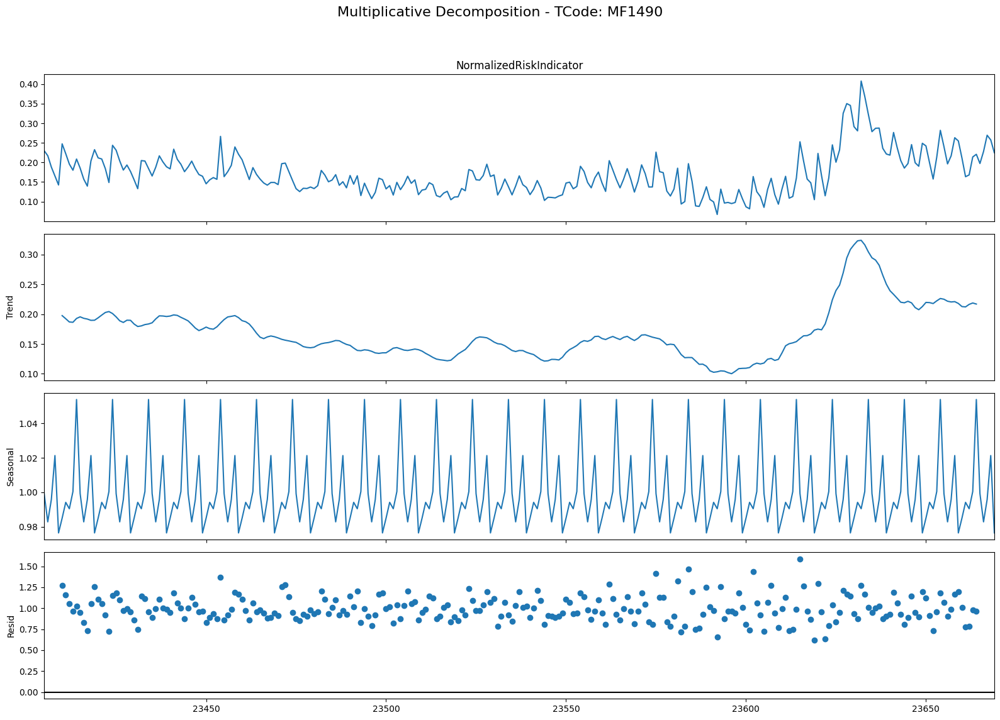

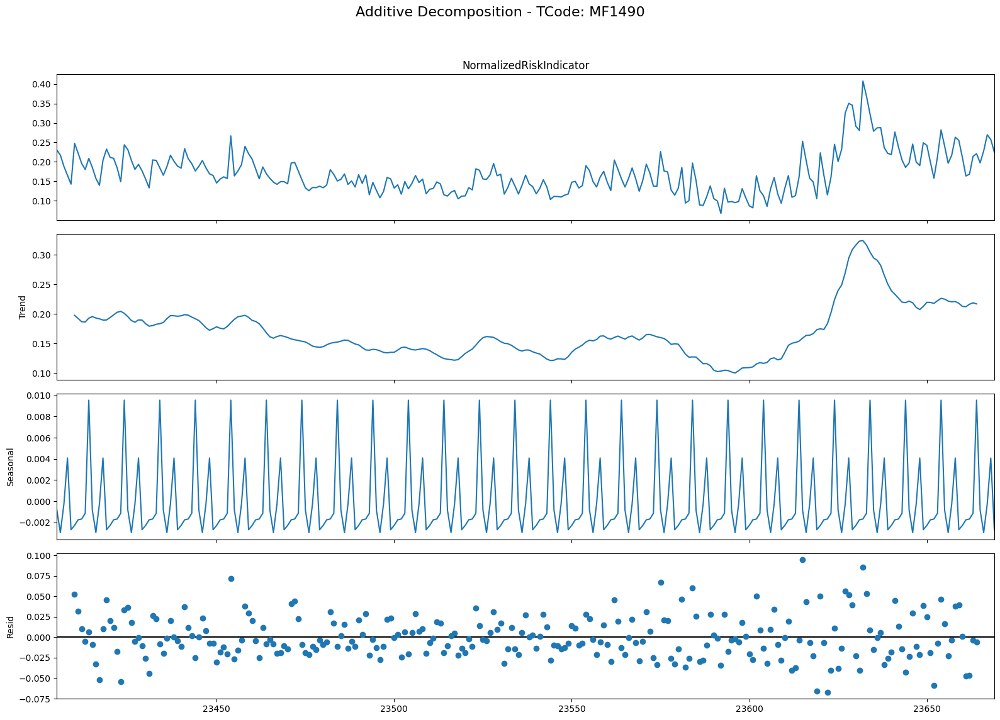

In [34]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

for tcode, subset in df_OA_Above150.groupby('TCode'):
    subset['TransferDate'] = pd.to_datetime(subset['TransferDate'])

    period = 10

    # Multiplicative Decomposition
    multiplicative_decomposition = seasonal_decompose(subset['NormalizedRiskIndicator'], model='multiplicative', period=period)

    # Additive Decomposition
    additive_decomposition = seasonal_decompose(subset['NormalizedRiskIndicator'], model='additive', period=period)

    # Plotting
    plt.rcParams.update({'figure.figsize': (16, 12)})
    multiplicative_decomposition.plot().suptitle(f'Multiplicative Decomposition - TCode: {tcode}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    additive_decomposition.plot().suptitle(f'Additive Decomposition - TCode: {tcode}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

Checking the Stationariy forthe over advacne above 150%

Plot ACF and PACF plots

ADF Statistics for TCode: BF0161
P-value: 0.6690574645875613
ADF Statistics: -1.2105119585236823
Critical Values: {'1%': -3.4566744514553016, '5%': -2.8731248767783426, '10%': -2.5729436702592023}


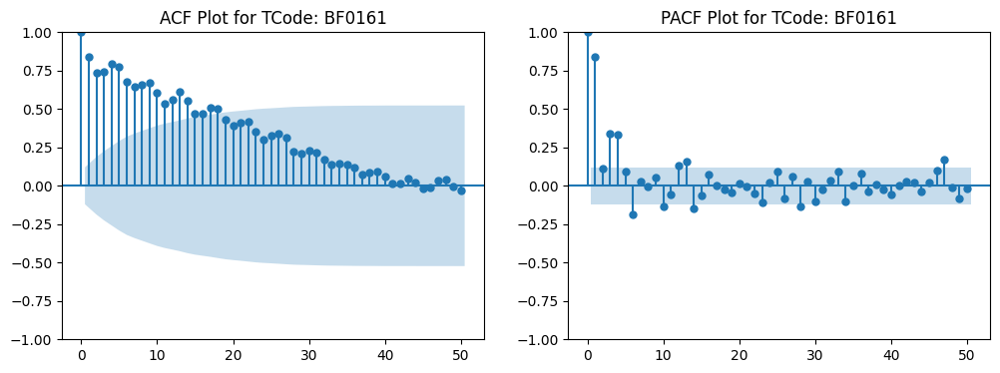

ADF Statistics for TCode: MF1342
P-value: 0.5560743638284118
ADF Statistics: -1.4541177572283042
Critical Values: {'1%': -3.455558114028747, '5%': -2.872635586277424, '10%': -2.572682677000175}


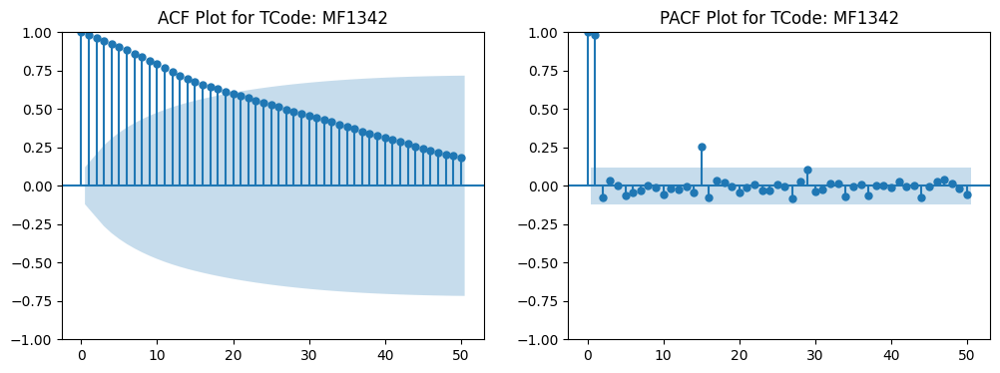

ADF Statistics for TCode: MF1441
P-value: 0.8083624710117558
ADF Statistics: -0.8358548925384853
Critical Values: {'1%': -3.4568881317725864, '5%': -2.8732185133016057, '10%': -2.5729936189738876}


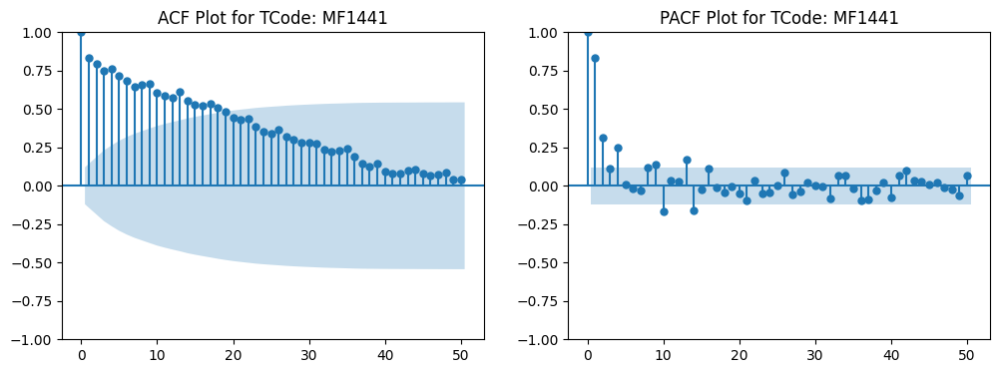

ADF Statistics for TCode: MF1490
P-value: 0.30047558945781244
ADF Statistics: -1.9686728256974566
Critical Values: {'1%': -3.456780859712, '5%': -2.8731715065600003, '10%': -2.572968544}


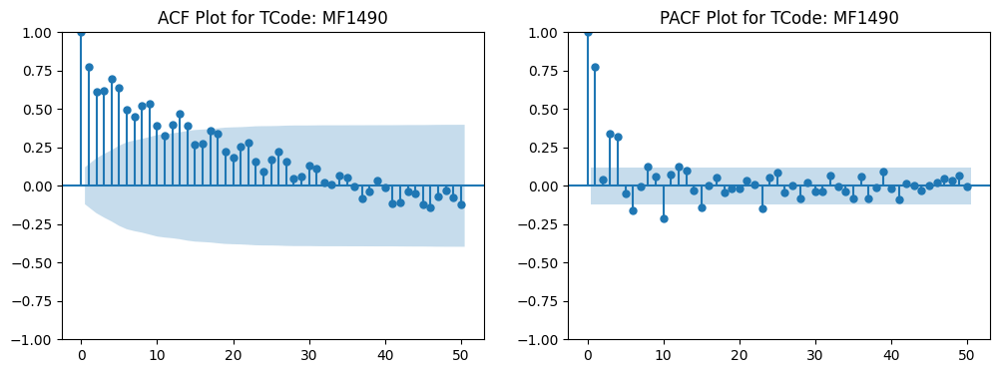

In [35]:
import matplotlib.pyplot as plt
import numpy as np
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

unique_tcodes = df_OA_Above150['TCode'].unique()

# Plot ACF and PACF for each time series separately
for tcode in unique_tcodes:
    tcode_data = df_OA_Above150[df_OA_Above150['TCode'] == tcode]['NormalizedRiskIndicator']

    # Create subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Plot ACF
    plot_acf(tcode_data, lags=50, ax=ax1)
    ax1.set_title(f'ACF Plot for TCode: {tcode}')

    # Plot PACF
    plot_pacf(tcode_data, lags=50, ax=ax2)
    ax2.set_title(f'PACF Plot for TCode: {tcode}')

    # ADF Test
    result = adfuller(tcode_data)
    pvalue = result[1]
    adf_stat = result[0]
    critical_values = result[4]

    print(f"ADF Statistics for TCode: {tcode}")
    print(f"P-value: {pvalue}")
    print(f"ADF Statistics: {adf_stat}")
    print(f"Critical Values: {critical_values}")

    plt.show()


Augmented Dickey Fuller (ADF) Test for Over Advance 150%

H0 - The time series has a unit root and is non stationary

In [36]:
from statsmodels.tsa.stattools import adfuller

unique_tcodes = df_OA_Above150['TCode'].unique()

# Perform ADF test for each TCode
for tcode in unique_tcodes:
    tcode_data = df_OA_Above150[df_OA_Above150['TCode'] == tcode]['NormalizedRiskIndicator']

    # Perform ADF test
    result = adfuller(tcode_data)
    pvalue = result[1]

    print(f"ADF Test Results for TCode: {tcode}")
    print(f"P-value: {pvalue}")

    # Determine stationary based on the p-value
    if pvalue <= 0.05:
        print("Result: Reject the null hypothesis. The time series is likely stationary.")
    else:
        print("Result: Fail to reject the null hypothesis. The time series is likely non-stationary.")

    print("-----------------------")


ADF Test Results for TCode: BF0161
P-value: 0.6690574645875613
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1342
P-value: 0.5560743638284118
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1441
P-value: 0.8083624710117558
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1490
P-value: 0.30047558945781244
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------


Kwiatkowski-Phillips-Schmidt-Shin (KPSS) Test for Over Advance above 150%

Null hypothesis (H0): The time series is stationary around a deterministic trend.
Alternative hypothesis (H1): The time series has a unit root and is non-stationary

If the p-value is greater than a significance level (e.g., 0.05), fail to reject the null hypothesis.

In [37]:
from statsmodels.tsa.stattools import kpss

unique_tcodes = df_OA_Above150['TCode'].unique()

# Perform KPSS test for each TCode
for tcode in unique_tcodes:
    tcode_data = df_OA_Above150[df_OA_Above150['TCode'] == tcode]['NormalizedRiskIndicator']

    # Perform KPSS test
    result = kpss(tcode_data)
    pvalue = result[1]

    print(f"KPSS Test Results for TCode: {tcode}")
    print(f"P-value: {pvalue}")

    if pvalue <= 0.05:
        print("Result: Reject the null hypothesis. The time series is likely non-stationary.")
    else:
        print("Result: Fail to reject the null hypothesis. The time series is likely stationary.")

    print("-----------------------")


KPSS Test Results for TCode: BF0161
P-value: 0.01
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------
KPSS Test Results for TCode: MF1342
P-value: 0.01
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------
KPSS Test Results for TCode: MF1441
P-value: 0.01
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------
KPSS Test Results for TCode: MF1490
P-value: 0.05138876034204044
Result: Fail to reject the null hypothesis. The time series is likely stationary.
-----------------------


<ipython-input-37-b18734265f6e>:10: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(tcode_data)
<ipython-input-37-b18734265f6e>:10: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(tcode_data)
<ipython-input-37-b18734265f6e>:10: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(tcode_data)


Phillips-Perron (PP) Test for Over Advance above 150%

In [38]:
!pip install arch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.0/983.0 kB 6.5 MB/s eta 0:00:00


In [39]:
from arch.unitroot import PhillipsPerron

In [40]:
!pip install statsmodels

In [41]:
from arch.unitroot import PhillipsPerron

unique_tcodes = df_OA_Above150['TCode'].unique()

for tcode in unique_tcodes:
    tcode_data = df_OA_Above150[df_OA_Above150['TCode'] == tcode]['NormalizedRiskIndicator']

    # Perform PP test
    result = PhillipsPerron(tcode_data)
    # pvalue = result[1]
    pvalue = result.pvalue

    print(f"Phillips-Perron Test Results for TCode: {tcode}")
    print(f"P-value: {pvalue}")

    if pvalue <= 0.05:
        print("Result: Reject the null hypothesis. The time series is likely non-stationary.")
    else:
        print("Result: Fail to reject the null hypothesis. The time series is likely stationary.")

    print("-----------------------")


Phillips-Perron Test Results for TCode: BF0161
P-value: 1.1783193389921724e-05
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------
Phillips-Perron Test Results for TCode: MF1342
P-value: 0.47271981263939833
Result: Fail to reject the null hypothesis. The time series is likely stationary.
-----------------------
Phillips-Perron Test Results for TCode: MF1441
P-value: 1.5651445866216516e-05
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------
Phillips-Perron Test Results for TCode: MF1490
P-value: 5.033720548871854e-09
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------


Using rolling mean and Standard deviation to identify trends or variations over time for factories which are over advacnce over 150%

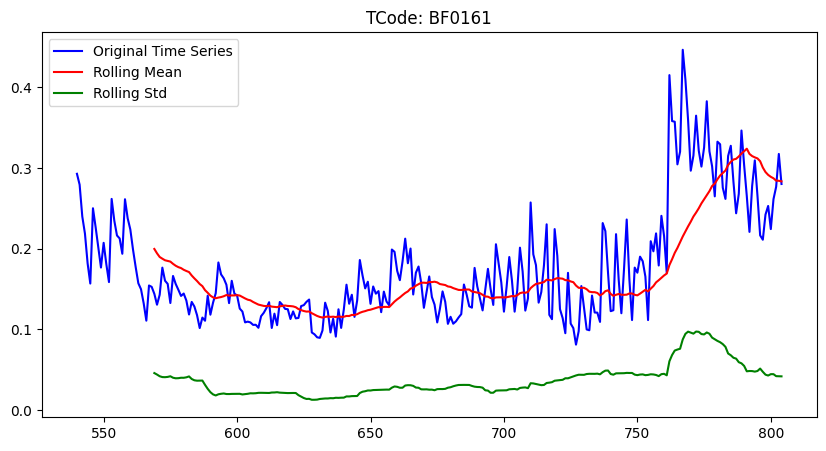

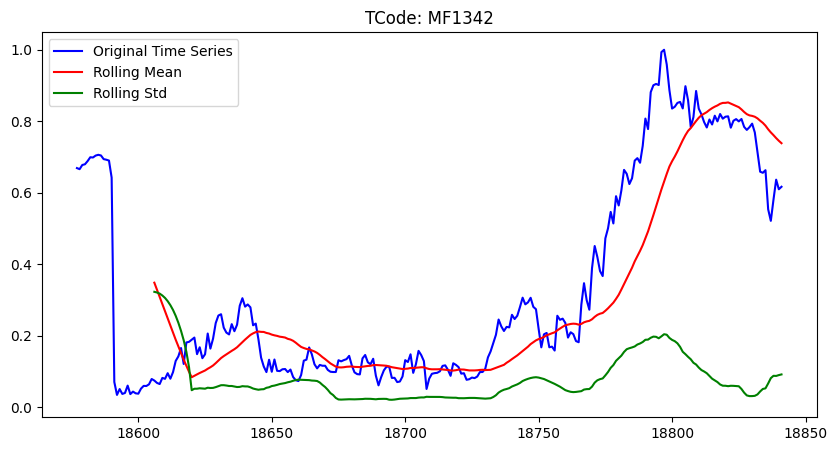

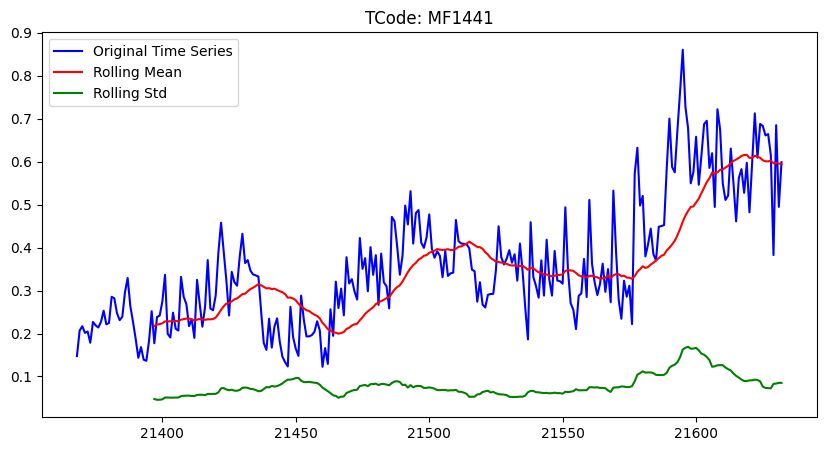

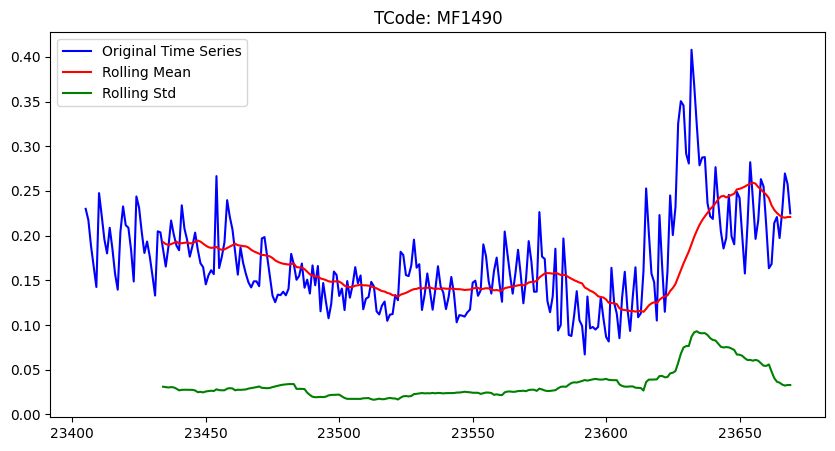

In [42]:
import matplotlib.pyplot as plt
import pandas as pd

for tcode in df_OA_Above150['TCode'].unique():
    tcode_data = df_OA_Above150[df_OA_Above150['TCode'] == tcode]['NormalizedRiskIndicator']

    # Calculate rolling mean and standard deviation
    rolling_mean = tcode_data.rolling(window=30).mean()
    rolling_std = tcode_data.rolling(window=30).std()

    # Plot the original time series
    plt.figure(figsize=(10, 5))
    plt.plot(tcode_data, label='Original Time Series', color='blue')

    # Plot the rolling mean
    plt.plot(rolling_mean, label='Rolling Mean', color='red')

    # Plot the rolling standard deviation
    plt.plot(rolling_std, label='Rolling Std', color='green')
    plt.title(f'TCode: {tcode}')
    plt.legend()
    plt.show()


Check the stationarity after first differncing

In [43]:
from statsmodels.tsa.stattools import adfuller

unique_tcodes = df_OA_Above150['TCode'].unique()

# Perform ADF test for each TCode
for tcode in unique_tcodes:
    tcode_data = df_OA_Above150[df_OA_Above150['TCode'] == tcode]['NormalizedRiskIndicator']

    # Perform ADF test
    result = adfuller(tcode_data)
    pvalue = result[1]

    print(f"ADF Test Results for TCode: {tcode}")
    print(f"P-value: {pvalue}")

    # Determine stationary based on the p-value
    if pvalue <= 0.05:
        print("Result: Reject the null hypothesis. The time series is likely stationary.")
    else:
        print("Result: Fail to reject the null hypothesis. The time series is likely non-stationary.")

    print("-----------------------")

ADF Test Results for TCode: BF0161
P-value: 0.6690574645875613
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1342
P-value: 0.5560743638284118
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1441
P-value: 0.8083624710117558
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1490
P-value: 0.30047558945781244
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------


Plot ARIMA for MF1490 Over Advance above 150%

In [44]:
!pip install pmdarima

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 9.7 MB/s eta 0:00:00


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


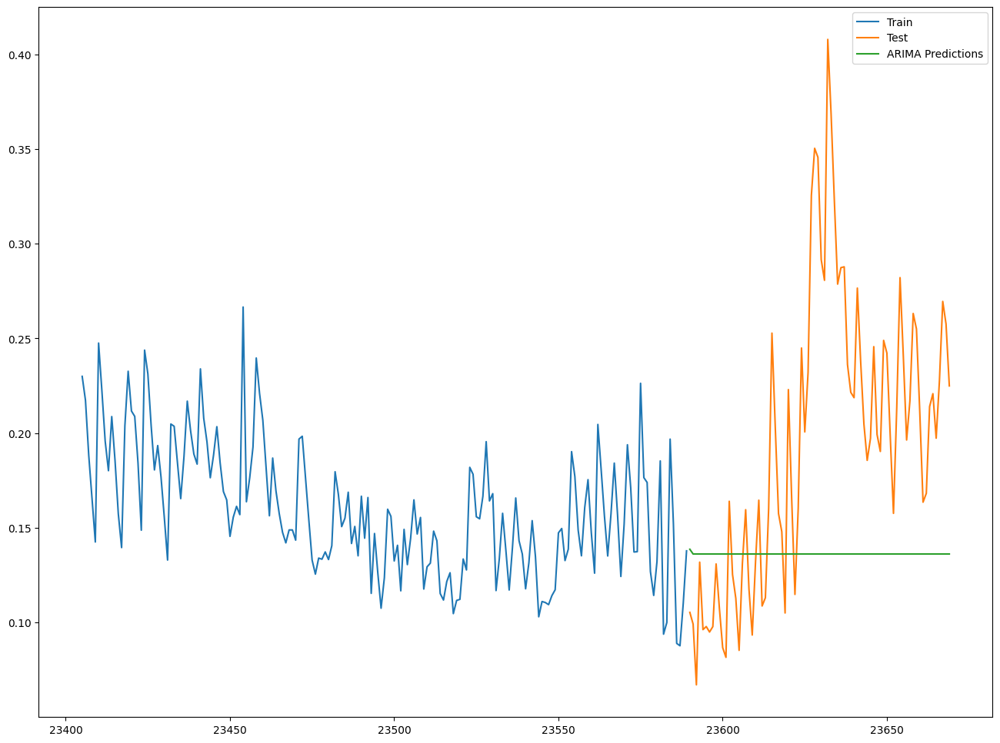

In [45]:
# Filter data for TCode MF1490
df_MF1490 = df_OA_Above150[df_OA_Above150['TCode'] == 'MF1490']

df_MF1490['TransferDate'] = pd.to_datetime(df_MF1490['TransferDate'])


# Split data into train and test (70% rule)
train_size = int(len(df_MF1490) * 0.7)
train, test = df_MF1490[:train_size], df_MF1490[train_size:]

# Import necessary libraries
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Find suitable p,d,q values using auto_arima
model = auto_arima(train['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False)

# Build ARIMA model with the determined parameters
arima_model = ARIMA(train['NormalizedRiskIndicator'], order=model.order)
arima_fit = arima_model.fit()

# Predict on the test set
predictions = arima_fit.predict(start=len(train), end=len(train) + len(test) - 1, typ='levels')

# Plot the results
plt.plot(train['NormalizedRiskIndicator'], label='Train')
plt.plot(test['NormalizedRiskIndicator'], label='Test')
plt.plot(test.index, predictions, label='ARIMA Predictions')
plt.legend()
plt.show()


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-809.121, Time=2.37 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-751.296, Time=0.23 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-758.449, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-793.471, Time=0.75 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-753.249, Time=0.20 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-809.215, Time=1.15 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-811.508, Time=1.00 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=-809.700, Time=1.07 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-805.775, Time=0.74 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=-808.323, Time=1.54 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-811.502, Time=0.40 sec

Best model:  ARIMA(0,1,2)(0,0,0)[0] intercept
Total fit time: 9.606 seconds
Optimal (p, d, q) values: (0, 1, 2)


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


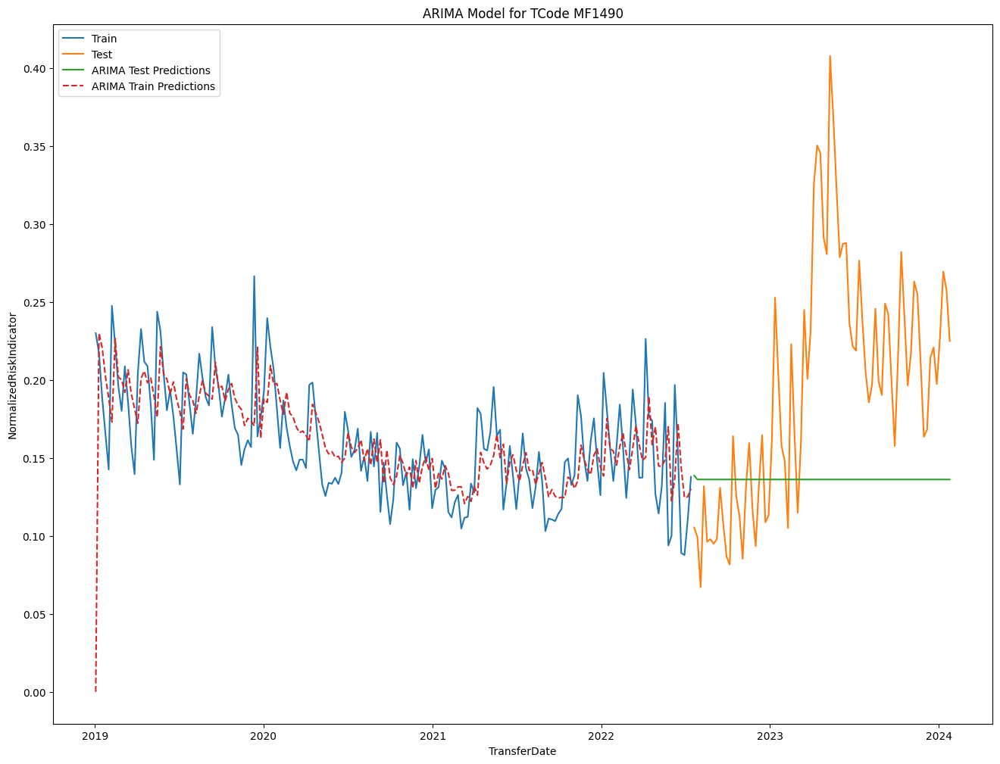

In [46]:
# Filter data for TCode MF1490
df_MF1490 = df_OA_Above150[df_OA_Above150['TCode'] == 'MF1490']

# Convert TransferDate to datetime format
df_MF1490['TransferDate'] = pd.to_datetime(df_MF1490['TransferDate'])

# Split data into train and test (70% rule)
train_size = int(len(df_MF1490) * 0.7)
train, test = df_MF1490[:train_size], df_MF1490[train_size:]

# Import necessary libraries
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Display the process of finding p, d, q values
stepwise_fit = auto_arima(train['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

# Get the optimal values
optimal_order = stepwise_fit.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order}")

# Build ARIMA model with the determined parameters
arima_model = ARIMA(train['NormalizedRiskIndicator'], order=optimal_order)
arima_fit = arima_model.fit()

# Predict on the train set
train_predictions = arima_fit.predict(start=0, end=len(train) - 1, typ='levels')

# Predict on the test set
test_predictions = arima_fit.predict(start=len(train), end=len(train) + len(test) - 1, typ='levels')

# Plot the results
plt.plot(train['TransferDate'], train['NormalizedRiskIndicator'], label='Train')
plt.plot(test['TransferDate'], test['NormalizedRiskIndicator'], label='Test')
plt.plot(test['TransferDate'], test_predictions, label='ARIMA Test Predictions')
plt.plot(train['TransferDate'], train_predictions, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1490')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()


In [48]:
test_predictions

185    0.138690
186    0.136199
187    0.136199
188    0.136199
189    0.136199
         ...   
260    0.136199
261    0.136199
262    0.136199
263    0.136199
264    0.136199
Name: predicted_mean, Length: 80, dtype: float64

In [50]:
# Create a DataFrame for train predictions with TransferDate
train_results = pd.DataFrame({'TransferDate': train['TransferDate'], 'Original': train['NormalizedRiskIndicator'], 'Predicted': train_predictions})
train_results


,TransferDate,Original,Predicted
23405,2019-01-03,0.229979,0.000000
23406,2019-01-10,0.217349,0.229979
23407,2019-01-17,0.188237,0.220600
23408,2019-01-24,0.165548,0.202239
23409,2019-01-31,0.142528,0.188535
...,...,...,...
23585,2022-06-16,0.152095,0.172273
23586,2022-06-23,0.089004,0.143215
23587,2022-06-30,0.087757,0.124530
23588,2022-07-07,0.110256,0.125149


In [51]:
# Create a DataFrame for test predictions with TransferDate
test_results = pd.DataFrame({'TransferDate': test['TransferDate'], 'Original': test['NormalizedRiskIndicator'], 'Predicted': test_predictions})
test_results


,TransferDate,Original,Predicted
185,NaT,NaN,0.138690
186,NaT,NaN,0.136199
187,NaT,NaN,0.136199
188,NaT,NaN,0.136199
189,NaT,NaN,0.136199
...,...,...,...
23665,2023-12-28,0.197330,NaN
23666,2024-01-04,0.227961,NaN
23667,2024-01-11,0.269525,NaN
23668,2024-01-18,0.257615,NaN


In [52]:
!pip install pmdarima

In [53]:
from statsmodels.tsa.arima.model import ARIMA

In [54]:
# Forecast the next 4 weeks
forecast_period = 4

# Get the forecast
forecast = arima_fit.get_forecast(steps=forecast_period)

# Extract forecasted values and confidence intervals
forecast_values = forecast.predicted_mean
conf_int = forecast.conf_int()

# Create a dataframe for the forecast
forecast_df = pd.DataFrame({
    'TransferDate': pd.date_range(start=df_OA_Above150['TransferDate'].max(), periods=forecast_period, freq='W'),
    'Forecasted_Indicator': forecast_values,
    'Lower_CI': conf_int.iloc[:, 0],
    'Upper_CI': conf_int.iloc[:, 1]
})

# Print the forecasted values and confidence intervals
print(forecast_df)


    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28              0.138690  0.087437  0.189943
186   2024-02-04              0.136199  0.079638  0.192760
187   2024-02-11              0.136199  0.079193  0.193205
188   2024-02-18              0.136199  0.078751  0.193647


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [55]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Assuming you have the actual values for the train and test sets
train_actual_values = train['NormalizedRiskIndicator'].values
test_actual_values = test['NormalizedRiskIndicator'].values

# Calculate MAE, MSE, RMSE, and MAPE for the train set
train_mae = mean_absolute_error(train_actual_values, train_predictions)
train_mse = mean_squared_error(train_actual_values, train_predictions)
train_rmse = np.sqrt(train_mse)
train_mape = np.mean(np.abs((train_actual_values - train_predictions) / train_actual_values)) * 100

# Calculate MAE, MSE, RMSE, and MAPE for the test set
test_mae = mean_absolute_error(test_actual_values, test_predictions)
test_mse = mean_squared_error(test_actual_values, test_predictions)
test_rmse = np.sqrt(test_mse)
test_mape = np.mean(np.abs((test_actual_values - test_predictions) / test_actual_values)) * 100

# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae}")
print(f"MSE: {train_mse}")
print(f"RMSE: {train_rmse}")
print(f"MAPE: {train_mape}%")

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"MAE: {test_mae}")
print(f"MSE: {test_mse}")
print(f"RMSE: {test_rmse}")
print(f"MAPE: {test_mape}%")


Train Set Metrics:
MAE: 0.02139314777985303
MSE: 0.0009730620902779535
RMSE: 0.031193943166550032
MAPE: 13.726882847476201%

Test Set Metrics:
MAE: 0.07754800701785189
MSE: 0.009336957907509474
RMSE: 0.09662793544058298
MAPE: 36.455916955171546%


In [56]:
# Assuming you have executed this code snippet
train_predictions = arima_fit.predict(start=0, end=len(train) - 1, typ='levels')

# Create a DataFrame for train predictions
train_predictions_df = pd.DataFrame({
    'TransferDate': train['TransferDate'],
    'NormalizedRiskIndicator': train_predictions,
})


In [57]:
# Assuming you have executed this code snippet
test_predictions = arima_fit.predict(start=len(train), end=len(train) + len(test) - 1, typ='levels')

# Create a DataFrame for test predictions
test_predictions_df = pd.DataFrame({
    'TransferDate': test['TransferDate'],  # Assuming 'TransferDate' is a column in the 'test' DataFrame
    'NormalizedRiskIndicator': test_predictions,
})


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


Plot ARIMA for 1441 _ Over Advnace above 150%

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-510.776, Time=2.27 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-463.091, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-492.996, Time=0.08 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-511.305, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-465.044, Time=0.08 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-510.294, Time=0.77 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-510.213, Time=0.33 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-508.234, Time=0.84 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-512.940, Time=0.34 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-511.888, Time=0.29 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-511.816, Time=0.28 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-494.856, Time=0.12 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-509.880, Time=0.41 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 6.337 seconds
Optimal (p, d, q) valu

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ

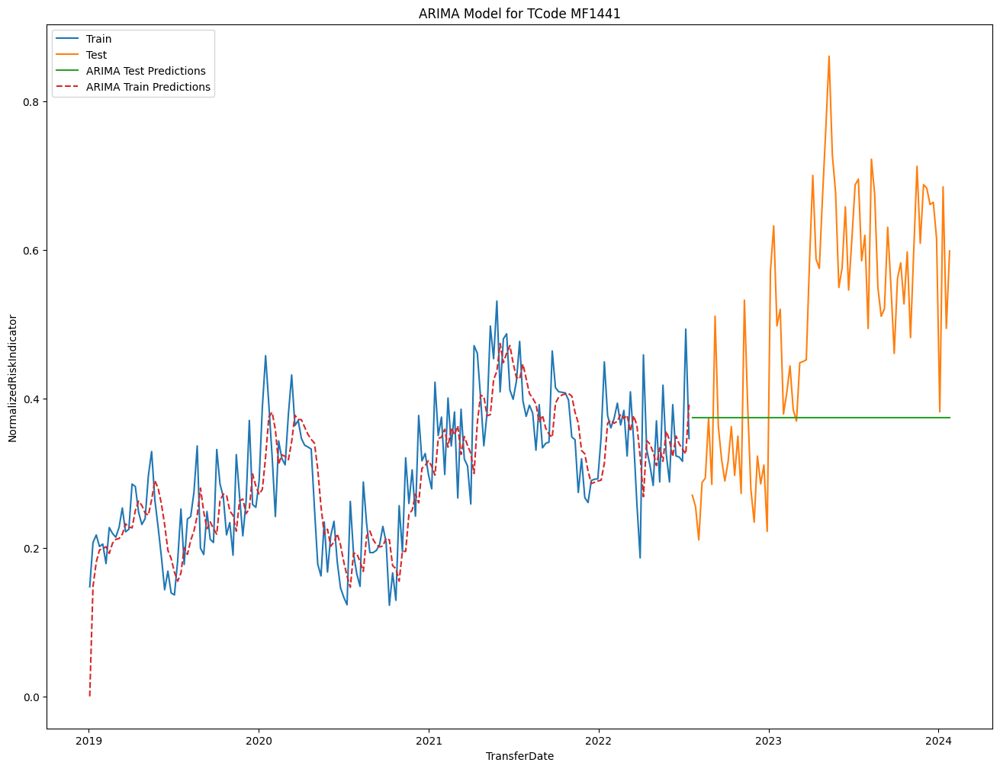

In [60]:
# Filter data for TCode MF1490
df_MF1441 = df_OA_Above150[df_OA_Above150['TCode'] == 'MF1441']

# Convert TransferDate to datetime format
df_MF1441['TransferDate'] = pd.to_datetime(df_MF1441['TransferDate'])

# Split data into train and test (70% rule)
train_size_MF1441 = int(len(df_MF1441) * 0.7)
train_MF1441, test_MF1441 = df_MF1441[:train_size], df_MF1441[train_size:]

# Import necessary libraries
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Display the process of finding p, d, q values
stepwise_fit_MF1441 = auto_arima(train_MF1441['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

# Get the optimal values
optimal_order_MF1441 = stepwise_fit_MF1441.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_MF1441}")

# Build ARIMA model with the determined parameters
arima_model_MF1441 = ARIMA(train_MF1441['NormalizedRiskIndicator'], order=optimal_order_MF1441)
arima_fit_MF1441 = arima_model_MF1441.fit()

# Predict on the train set
train_predictions_MF1441 = arima_fit_MF1441.predict(start=0, end=len(train_MF1441) - 1, typ='levels')

# Predict on the test set
test_predictions_MF1441 = arima_fit_MF1441.predict(start=len(train_MF1441), end=len(train_MF1441) + len(test_MF1441) - 1, typ='levels')

# Plot the results
plt.plot(train_MF1441['TransferDate'], train_MF1441['NormalizedRiskIndicator'], label='Train')
plt.plot(test_MF1441['TransferDate'], test_MF1441['NormalizedRiskIndicator'], label='Test')
plt.plot(test_MF1441['TransferDate'], test_predictions_MF1441, label='ARIMA Test Predictions')
plt.plot(train_MF1441['TransferDate'], train_predictions_MF1441, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1441')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()


In [61]:
# Forecast the next 4 weeks
forecast_period = 4

# Get the forecast
forecast_MF1441 = arima_fit_MF1441.get_forecast(steps=forecast_period)

# Extract forecasted values and confidence intervals
forecast_values_MF1441 = forecast_MF1441.predicted_mean
conf_int_MF1441 = forecast_MF1441.conf_int()

# Create a dataframe for the forecast
forecast_df_MF1441 = pd.DataFrame({
    'TransferDate': pd.date_range(start=df_OA_Above150['TransferDate'].max(), periods=forecast_period, freq='W'),
    'Forecasted_Indicator': forecast_values_MF1441,
    'Lower_CI': conf_int.iloc[:, 0],
    'Upper_CI': conf_int.iloc[:, 1]
})

# Print the forecasted values and confidence intervals
print(forecast_df_MF1441)

    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28              0.374325  0.087437  0.189943
186   2024-02-04              0.374325  0.079638  0.192760
187   2024-02-11              0.374325  0.079193  0.193205
188   2024-02-18              0.374325  0.078751  0.193647


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [62]:
arima_fit_MF1441.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     NormalizedRiskIndicator   No. Observations:                  185
Model:                      ARIMA(0, 1, 1)   Log Likelihood                 258.470
Date:                     Wed, 27 Mar 2024   AIC                           -512.940
Time:                             07:14:03   BIC                           -506.510
Sample:                                  0   HQIC                          -510.334
                                     - 185                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.6047      0.053    -11.471      0.000      -0.708      -0.501
sigma2         0.0035      0.000     10.691      0.000       0.003       0.004
===================================================================================
Ljung-Box (L1) (Q):                   0.30   Jarque-Bera (JB):                14.82
Prob(Q):                              0.58   Prob(JB):                         0.00
Heteroskedasticity (H):               1.27   Skew:                             0.65
Prob(H) (two-sided):                  0.35   Kurtosis:                         3.48
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [63]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Assuming you have the actual values for the train and test sets
train_actual_values_MF1441 = train_MF1441['NormalizedRiskIndicator'].values
test_actual_values_MF1441 = test_MF1441['NormalizedRiskIndicator'].values

# Calculate MAE, MSE, RMSE, and MAPE for the train set
train_mae_MF1441 = mean_absolute_error(train_actual_values_MF1441, train_predictions_MF1441)
train_mse_MF1441 = mean_squared_error(train_actual_values_MF1441, train_predictions_MF1441)
train_rmse_MF1441 = np.sqrt(train_mse_MF1441)
train_mape_MF1441 = np.mean(np.abs((train_actual_values_MF1441 - train_predictions_MF1441) / train_actual_values_MF1441)) * 100

# Calculate MAE, MSE, RMSE, and MAPE for the test set
test_mae_MF1441 = mean_absolute_error(test_actual_values_MF1441, test_predictions_MF1441)
test_mse_MF1441 = mean_squared_error(test_actual_values_MF1441, test_predictions_MF1441)
test_rmse_MF1441 = np.sqrt(test_mse_MF1441)
test_mape_MF1441 = np.mean(np.abs((test_actual_values_MF1441 - test_predictions_MF1441) / test_actual_values_MF1441)) * 100

# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae_MF1441}")
print(f"MSE: {train_mse_MF1441}")
print(f"RMSE: {train_rmse_MF1441}")
print(f"MAPE: {train_mape_MF1441}%")

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"MAE: {test_mae_MF1441}")
print(f"MSE: {test_mse_MF1441}")
print(f"RMSE: {test_rmse_MF1441}")
print(f"MAPE: {test_mape_MF1441}%")


Train Set Metrics:
MAE: 0.04551085249591525
MSE: 0.003622427502663609
RMSE: 0.060186605674880926
MAPE: 16.539538542413066%

Test Set Metrics:
MAE: 0.16915864780305861
MSE: 0.0403108470143118
RMSE: 0.20077561359465895
MAPE: 31.801150605946788%


ARIMA for MF1342_OVerAdvance Above 150%

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-580.453, Time=0.57 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-586.562, Time=0.09 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-586.240, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-586.312, Time=0.53 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-588.045, Time=0.07 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-584.380, Time=0.28 sec

Best model:  ARIMA(0,1,0)(0,0,0)[0]          
Total fit time: 1.627 seconds
Optimal (p, d, q) values: (0, 1, 0)


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


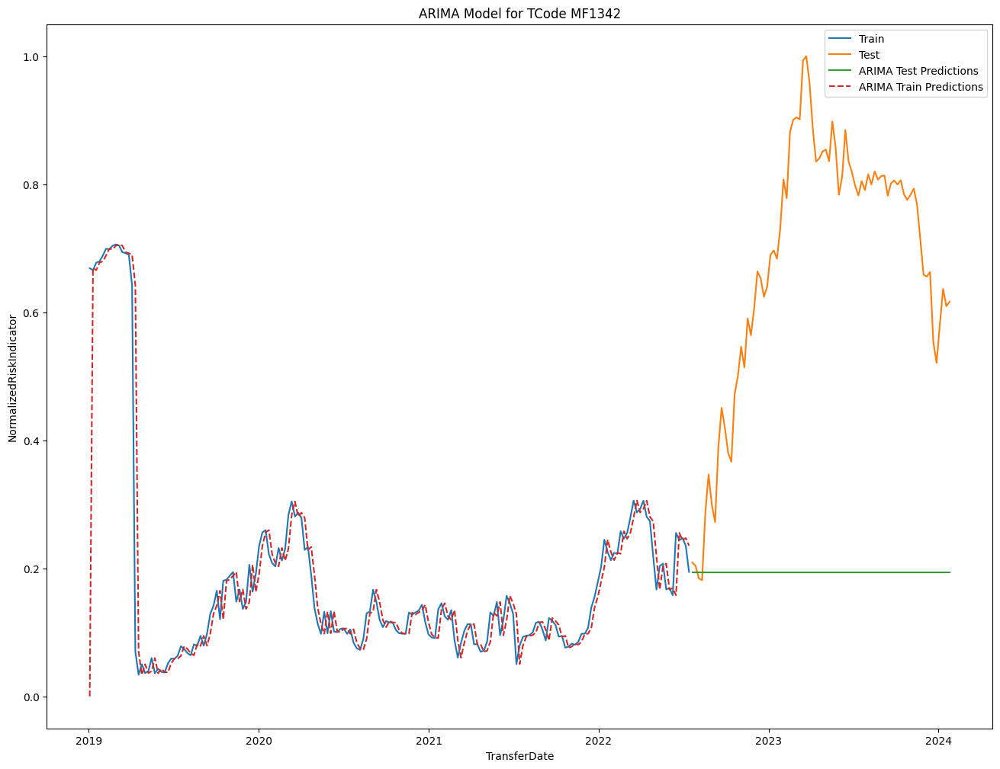

In [65]:
# Assuming df_OA_Above150 is your DataFrame

# Filter data for TCode MF1490
df_MF1342 = df_OA_Above150[df_OA_Above150['TCode'] == 'MF1342']

# Convert TransferDate to datetime format
df_MF1342['TransferDate'] = pd.to_datetime(df_MF1342['TransferDate'])

# Split data into train and test (70% rule)
train_size_MF1342 = int(len(df_MF1342) * 0.7)
train_MF1342, test_MF1342 = df_MF1342[:train_size], df_MF1342[train_size:]

# Import necessary libraries
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Display the process of finding p, d, q values
stepwise_fit_MF1342 = auto_arima(train_MF1342['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

# Get the optimal values
optimal_order_MF1342 = stepwise_fit_MF1342.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_MF1342}")

# Build ARIMA model with the determined parameters
arima_model_MF1342 = ARIMA(train_MF1342['NormalizedRiskIndicator'], order=optimal_order_MF1342)
arima_fit_MF1342 = arima_model_MF1342.fit()

# Predict on the train set
train_predictions_MF1342 = arima_fit_MF1342.predict(start=0, end=len(train_MF1342) - 1, typ='levels')

# Predict on the test set
test_predictions_MF1342 = arima_fit_MF1342.predict(start=len(train_MF1342), end=len(train_MF1342) + len(test_MF1342) - 1, typ='levels')

# Plot the results
plt.plot(train_MF1342['TransferDate'], train_MF1342['NormalizedRiskIndicator'], label='Train')
plt.plot(test_MF1342['TransferDate'], test_MF1342['NormalizedRiskIndicator'], label='Test')
plt.plot(test_MF1342['TransferDate'], test_predictions_MF1342, label='ARIMA Test Predictions')
plt.plot(train_MF1342['TransferDate'], train_predictions_MF1342, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1342')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()

In [66]:
# Forecast the next 4 weeks
forecast_period = 4

# Get the forecast
forecast_MF1342 = arima_fit_MF1342.get_forecast(steps=forecast_period)

# Extract forecasted values and confidence intervals
forecast_values_MF1342 = forecast_MF1342.predicted_mean
conf_int_MF1342 = forecast_MF1342.conf_int()

# Create a dataframe for the forecast
forecast_df_MF1342 = pd.DataFrame({
    'TransferDate': pd.date_range(start=df_OA_Above150['TransferDate'].max(), periods=forecast_period, freq='W'),
    'Forecasted_Indicator': forecast_values_MF1342,
    'Lower_CI': conf_int.iloc[:, 0],
    'Upper_CI': conf_int.iloc[:, 1]
})

# Print the forecasted values and confidence intervals
print(forecast_df_MF1342)

    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28              0.194283  0.087437  0.189943
186   2024-02-04              0.194283  0.079638  0.192760
187   2024-02-11              0.194283  0.079193  0.193205
188   2024-02-18              0.194283  0.078751  0.193647


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [67]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Assuming you have the actual values for the train and test sets
train_actual_values_MF1342 = train_MF1342['NormalizedRiskIndicator'].values
test_actual_values_MF1342 = test_MF1342['NormalizedRiskIndicator'].values

# Calculate MAE, MSE, RMSE, and MAPE for the train set
train_mae_MF1342 = mean_absolute_error(train_actual_values_MF1342, train_predictions_MF1342)
train_mse_MF1342 = mean_squared_error(train_actual_values_MF1342, train_predictions_MF1342)
train_rmse_MF1342 = np.sqrt(train_mse_MF1342)
train_mape_MF1342 = np.mean(np.abs((train_actual_values_MF1342 - train_predictions_MF1342) / train_actual_values_MF1441)) * 100

# Calculate MAE, MSE, RMSE, and MAPE for the test set
test_mae_MF1342 = mean_absolute_error(test_actual_values_MF1342, test_predictions_MF1342)
test_mse_MF1342 = mean_squared_error(test_actual_values_MF1342, test_predictions_MF1342)
test_rmse_MF1342 = np.sqrt(test_mse_MF1342)
test_mape_MF1342 = np.mean(np.abs((test_actual_values_MF1342 - test_predictions_MF1342) / test_actual_values_MF1342)) * 100

# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae_MF1342}")
print(f"MSE: {train_mse_MF1342}")
print(f"RMSE: {train_rmse_MF1342}")
print(f"MAPE: {train_mape_MF1342}%")

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"MAE: {test_mae_MF1342}")
print(f"MSE: {test_mse_MF1342}")
print(f"RMSE: {test_rmse_MF1342}")
print(f"MAPE: {test_mape_MF1342}%")


Train Set Metrics:
MAE: 0.024334836832114445
MSE: 0.004775538220180595
RMSE: 0.06910526912023855
MAPE: 9.55342075915451%

Test Set Metrics:
MAE: 0.4867522657709652
MSE: 0.27731315829004155
RMSE: 0.5266053154783396
MAPE: 66.74187854341844%


Build ARIMA for BF0161 ocer advance above 150%

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-804.333, Time=1.29 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-755.846, Time=0.08 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-761.589, Time=0.09 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-785.954, Time=0.33 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-757.759, Time=0.12 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-795.682, Time=0.92 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-802.684, Time=1.79 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=-804.229, Time=1.82 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=-819.392, Time=2.63 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=-797.346, Time=1.40 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=-811.367, Time=0.84 sec
 ARIMA(2,1,4)(0,0,0)[0] intercept   : AIC=-783.901, Time=1.13 sec
 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=-798.993, Time=0.80 sec
 ARIMA(3,1,4)(0,0,0)[0] intercept   : AIC=-796.481, Time=1.07 sec
 ARIMA(2,1,3)(0,0,0)[0]          

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ

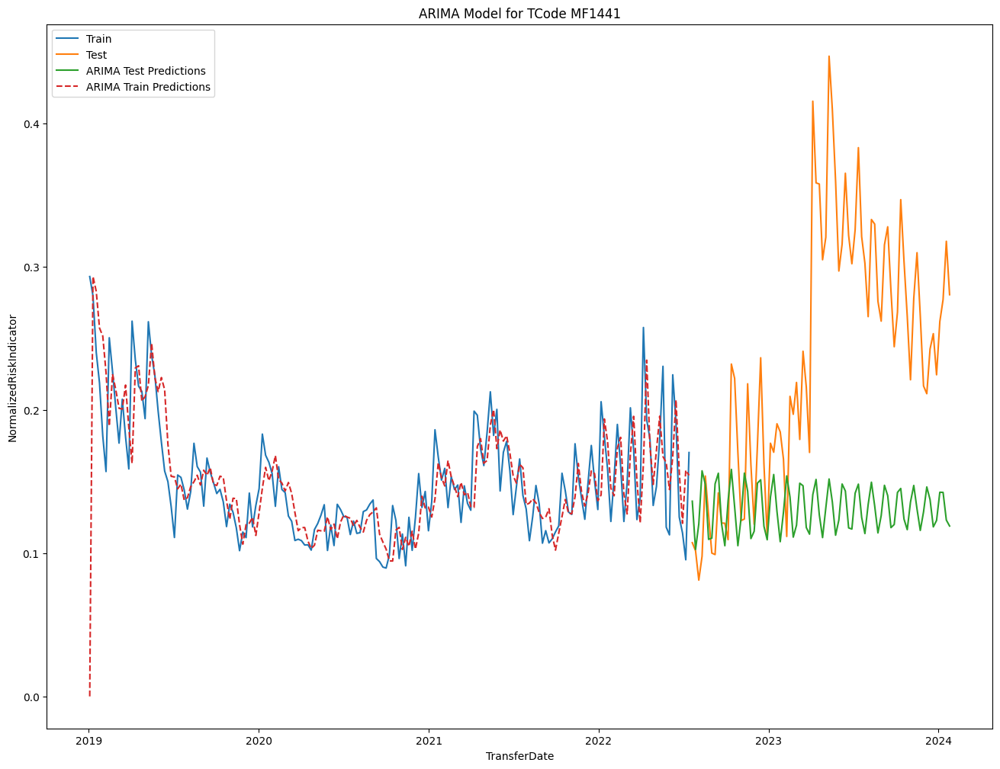

In [69]:
# Assuming df_OA_Above150 is your DataFrame

# Filter data for TCode MF1490
df_BF0161 = df_OA_Above150[df_OA_Above150['TCode'] == 'BF0161']

# Convert TransferDate to datetime format
df_BF0161['TransferDate'] = pd.to_datetime(df_BF0161['TransferDate'])

# Split data into train and test (70% rule)
train_size_BF0161 = int(len(df_BF0161) * 0.7)
train_BF0161, test_BF0161 = df_BF0161[:train_size], df_BF0161[train_size:]

# Import necessary libraries
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Display the process of finding p, d, q values
stepwise_fit_BF0161 = auto_arima(train_BF0161['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

# Get the optimal values
optimal_order_BF0161 = stepwise_fit_BF0161.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_BF0161}")

# Build ARIMA model with the determined parameters
arima_model_BF0161 = ARIMA(train_BF0161['NormalizedRiskIndicator'], order=optimal_order_BF0161)
arima_fit_BF0161 = arima_model_BF0161.fit()

# Predict on the train set
train_predictions_BF0161 = arima_fit_BF0161.predict(start=0, end=len(train_BF0161) - 1, typ='levels')

# Predict on the test set
test_predictions_BF0161 = arima_fit_BF0161.predict(start=len(train_BF0161), end=len(train_BF0161) + len(test_BF0161) - 1, typ='levels')

# Plot the results
plt.plot(train_BF0161['TransferDate'], train_BF0161['NormalizedRiskIndicator'], label='Train')
plt.plot(test_BF0161['TransferDate'], test_BF0161['NormalizedRiskIndicator'], label='Test')
plt.plot(test_BF0161['TransferDate'], test_predictions_BF0161, label='ARIMA Test Predictions')
plt.plot(train_BF0161['TransferDate'], train_predictions_BF0161, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1441')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()


In [70]:
# Forecast the next 4 weeks
forecast_period = 4

# Get the forecast
forecast_BF0161 = arima_fit_BF0161.get_forecast(steps=forecast_period)

# Extract forecasted values and confidence intervals
forecast_values_BF0161 = forecast_BF0161.predicted_mean
conf_int_BF0161 = forecast_BF0161.conf_int()

# Create a dataframe for the forecast
forecast_df_BF0161 = pd.DataFrame({
    'TransferDate': pd.date_range(start=df_OA_Above150['TransferDate'].max(), periods=forecast_period, freq='W'),
    'Forecasted_Indicator': forecast_values_BF0161,
    'Lower_CI': conf_int.iloc[:, 0],
    'Upper_CI': conf_int.iloc[:, 1]
})

# Print the forecasted values and confidence intervals
print(forecast_df_BF0161)

    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28              0.136221  0.087437  0.189943
186   2024-02-04              0.102504  0.079638  0.192760
187   2024-02-11              0.120386  0.079193  0.193205
188   2024-02-18              0.157391  0.078751  0.193647


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [71]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Assuming you have the actual values for the train and test sets
train_actual_values_BF0161 = train_BF0161['NormalizedRiskIndicator'].values
test_actual_values_BF0161 = test_BF0161['NormalizedRiskIndicator'].values

# Calculate MAE, MSE, RMSE, and MAPE for the train set
train_mae_BF0161= mean_absolute_error(train_actual_values_BF0161, train_predictions_BF0161)
train_mse_BF0161 = mean_squared_error(train_actual_values_BF0161, train_predictions_BF0161)
train_rmse_BF0161 = np.sqrt(train_mse_BF0161)
train_mape_BF0161 = np.mean(np.abs((train_actual_values_BF0161 - train_predictions_BF0161) / train_actual_values_BF0161)) * 100

# Calculate MAE, MSE, RMSE, and MAPE for the test set
test_mae_BF0161 = mean_absolute_error(test_actual_values_BF0161, test_predictions_BF0161)
test_mse_BF0161 = mean_squared_error(test_actual_values_BF0161, test_predictions_BF0161)
test_rmse_BF0161 = np.sqrt(test_mse_BF0161)
test_mape_BF0161 = np.mean(np.abs((test_actual_values_BF0161- test_predictions_BF0161) / test_actual_values_BF0161)) * 100

# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae_BF0161}")
print(f"MSE: {train_mse_BF0161}")
print(f"RMSE: {train_rmse_BF0161}")
print(f"MAPE: {train_mape_BF0161}%")

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"MAE: {test_mae_BF0161}")
print(f"MSE: {test_mse_BF0161}")
print(f"RMSE: {test_rmse_BF0161}")
print(f"MAPE: {test_mape_BF0161}%")

Train Set Metrics:
MAE: 0.01993767685021735
MSE: 0.0011009471841687051
RMSE: 0.03318052416958938
MAPE: 12.777031522842245%

Test Set Metrics:
MAE: 0.11310630295746901
MSE: 0.018716578789021464
RMSE: 0.13680854793842914
MAPE: 42.059444234756995%


Build ARIMA for OverAdvance between 100% and 150%

In [72]:
df_OA_Above100.head()

,TCode,TransferDate,NormalizedRiskIndicator
15435,MF0975,2019-01-03,0.003729
15436,MF0975,2019-01-10,0.005174
15437,MF0975,2019-01-17,0.005862
15438,MF0975,2019-01-24,0.003934
15439,MF0975,2019-01-31,0.003757


In [73]:
# Assuming df_OA_Above150 is your DataFrame
tcode_value_counts = df_OA_Above100['TCode'].value_counts()

# Display the result
print(tcode_value_counts)

MF0975    265
MF1591    265
Name: TCode, dtype: int64


In [74]:
df_OA_Above100['TransferDate'] = pd.to_datetime(df['TransferDate'])

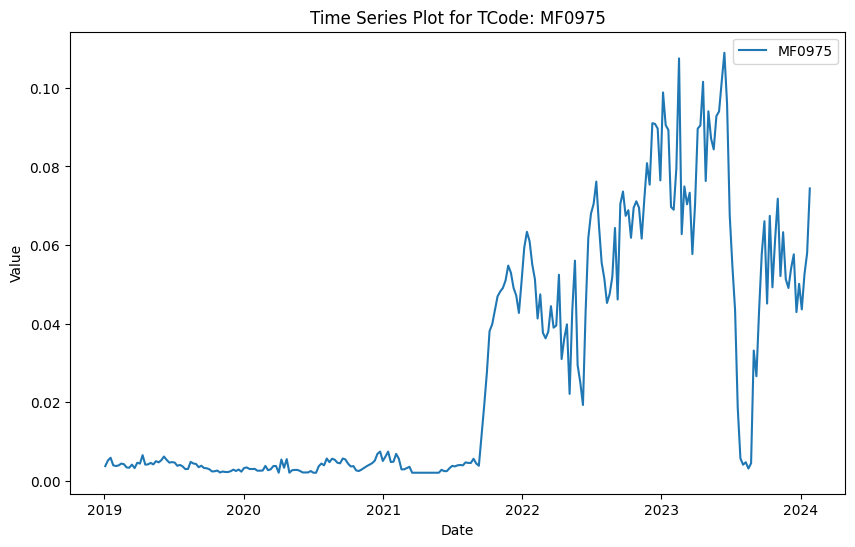

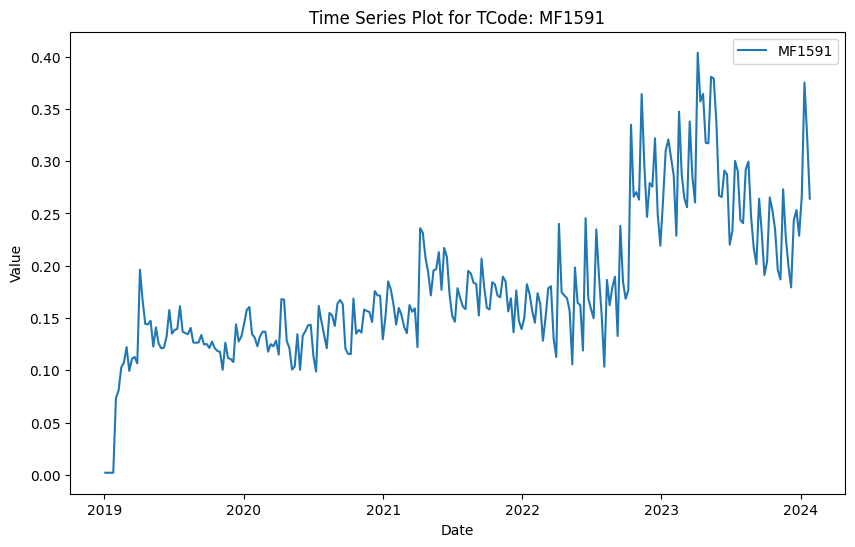

In [76]:
import matplotlib.pyplot as plt


# Get unique TCodes
unique_tcodes = df_OA_Above100['TCode'].unique()

# Plot each time series separately
for tcode in unique_tcodes:
    tcode_data = df_OA_Above100[df_OA_Above100['TCode'] == tcode]
    plt.figure(figsize=(10, 6))  # Adjust the figure size if needed
    plt.plot(tcode_data['TransferDate'], tcode_data['NormalizedRiskIndicator'], label=tcode)
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title(f'Time Series Plot for TCode: {tcode}')
    plt.legend()
    plt.show()

Time Series Decomposition for over advance between 1005 and 150%

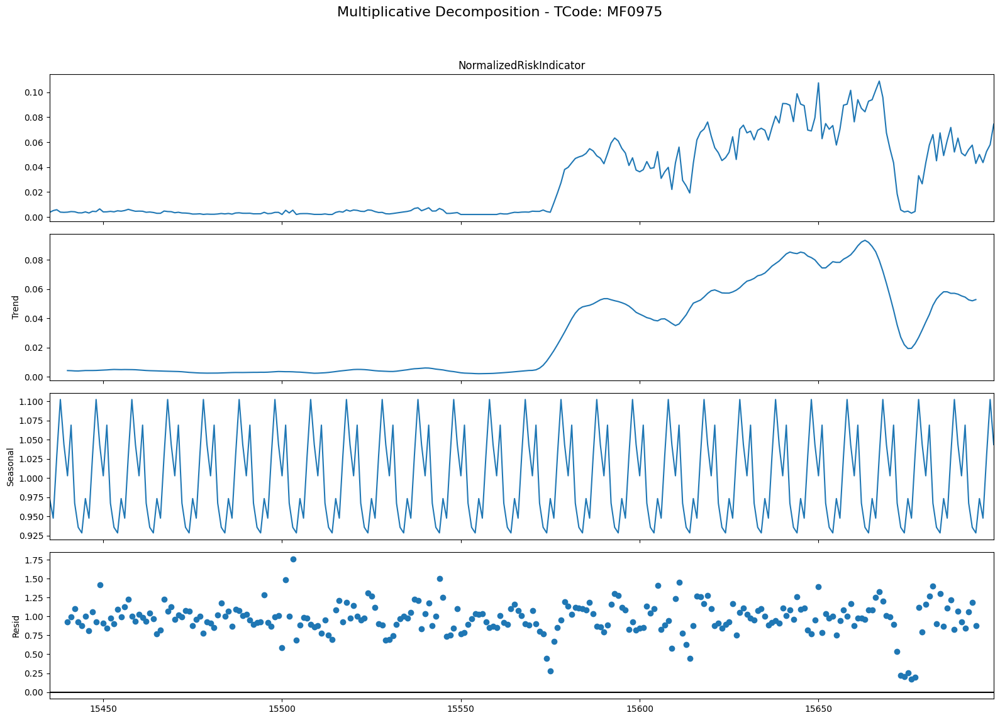

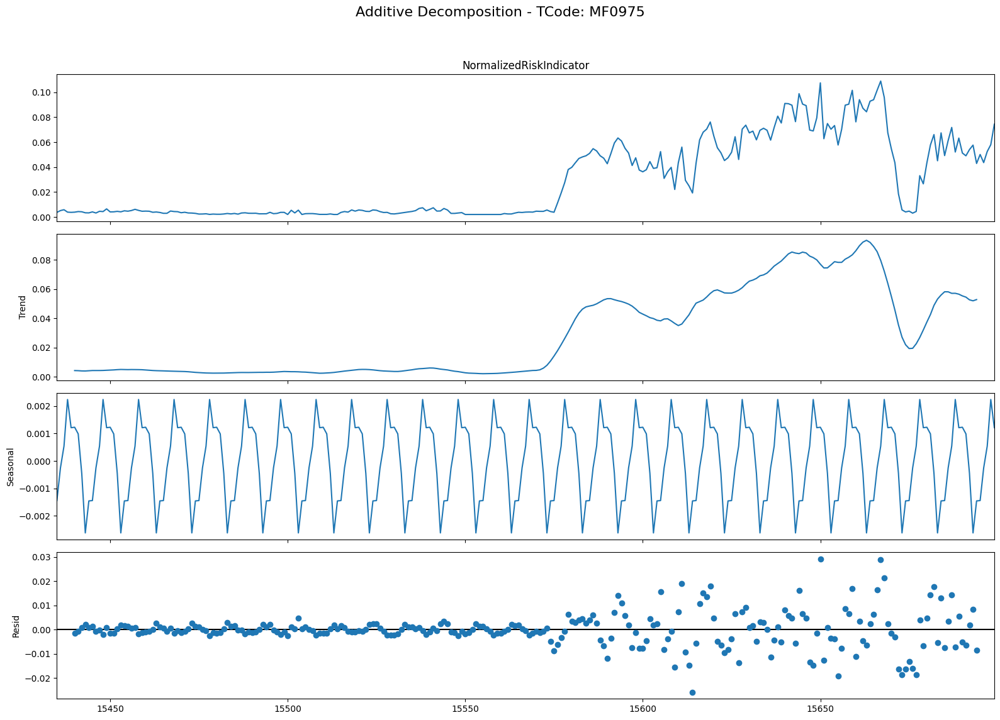

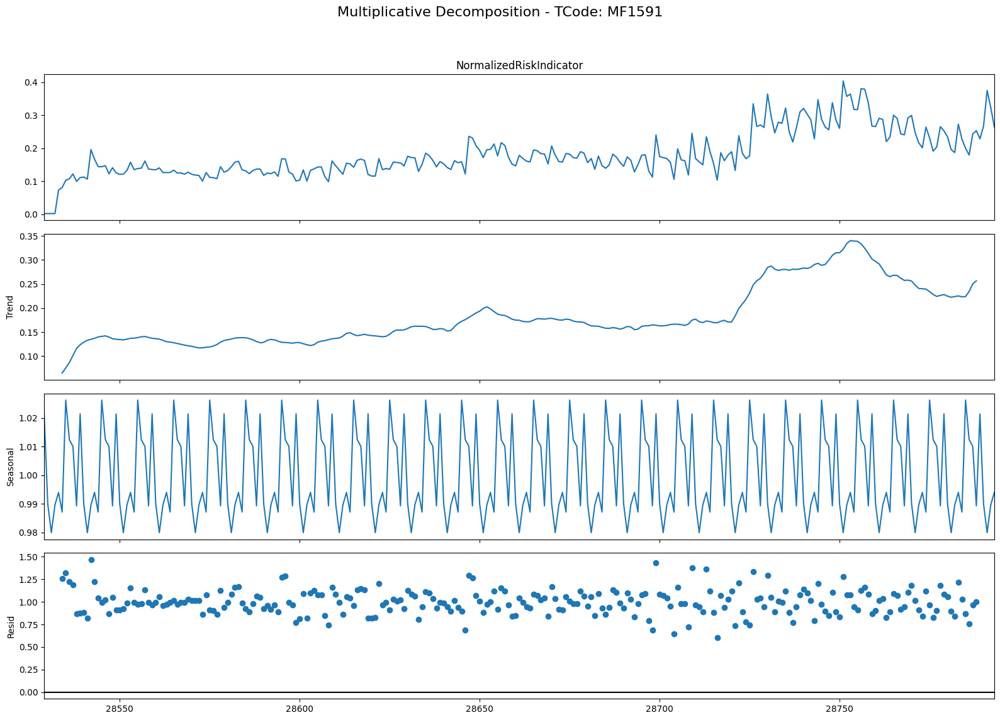

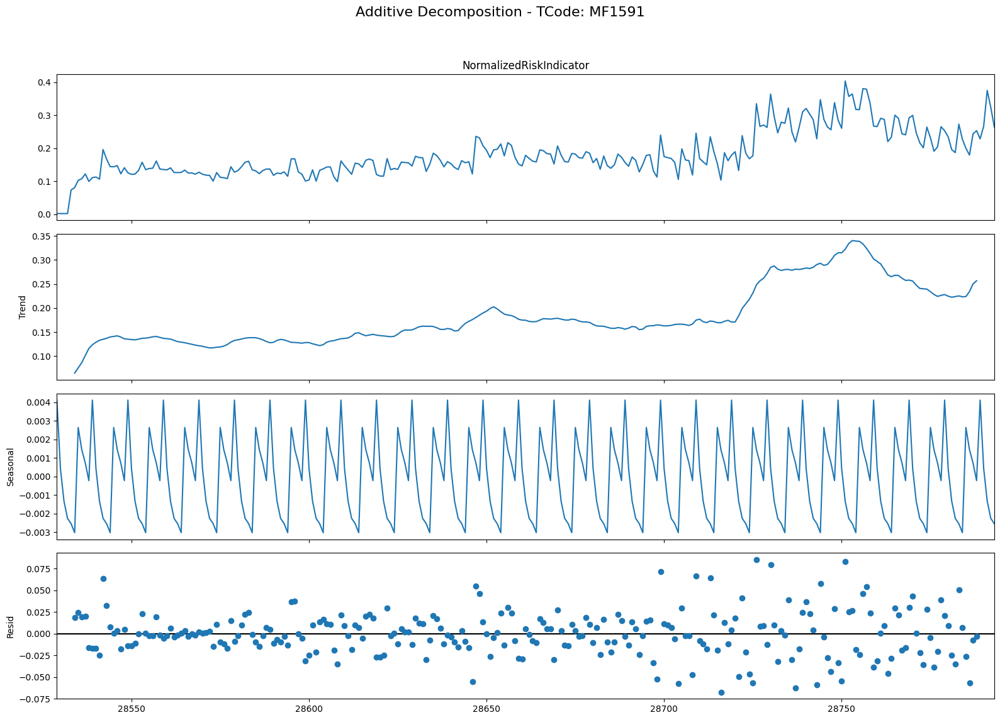

In [77]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

for tcode, subset in df_OA_Above100.groupby('TCode'):
    # Assuming 'TransferDate' is in datetime format
    subset['TransferDate'] = pd.to_datetime(subset['TransferDate'])

    # Replace 'your_period' with the actual seasonality period
    period = 10  # Change this to your determined seasonality period

    # Multiplicative Decomposition
    multiplicative_decomposition = seasonal_decompose(subset['NormalizedRiskIndicator'], model='multiplicative', period=period)

    # Additive Decomposition
    additive_decomposition = seasonal_decompose(subset['NormalizedRiskIndicator'], model='additive', period=period)

    # Plotting
    plt.rcParams.update({'figure.figsize': (16, 12)})
    multiplicative_decomposition.plot().suptitle(f'Multiplicative Decomposition - TCode: {tcode}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])

    additive_decomposition.plot().suptitle(f'Additive Decomposition - TCode: {tcode}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])

    plt.show()

Checking the Staionarity for over advance between 100% and 150%

Plot ACF and PACF plots

ADF Statistics for TCode: MF0975
P-value: 0.45060718689799734
ADF Statistics: -1.6623511114812648
Critical Values: {'1%': -3.4554613060274972, '5%': -2.8725931472675046, '10%': -2.5726600403359887}


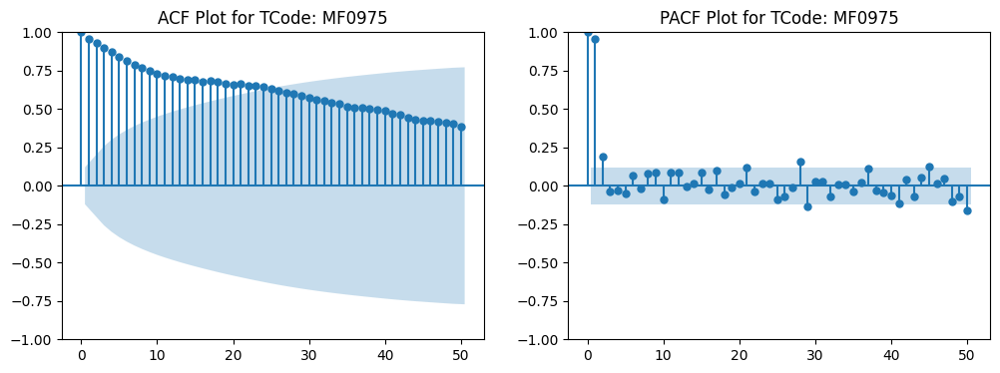

ADF Statistics for TCode: MF1591
P-value: 0.7894633367165361
ADF Statistics: -0.8954614986936708
Critical Values: {'1%': -3.456780859712, '5%': -2.8731715065600003, '10%': -2.572968544}


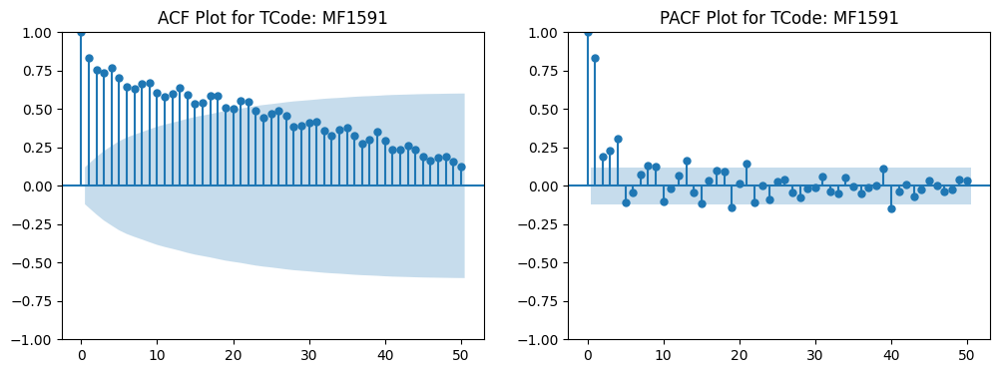

In [78]:
import matplotlib.pyplot as plt
import numpy as np
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

unique_tcodes = df_OA_Above100['TCode'].unique()

# Plot ACF and PACF for each time series separately
for tcode in unique_tcodes:
    tcode_data = df_OA_Above100[df_OA_Above100['TCode'] == tcode]['NormalizedRiskIndicator']

    # Create subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Plot ACF
    plot_acf(tcode_data, lags=50, ax=ax1)
    ax1.set_title(f'ACF Plot for TCode: {tcode}')

    # Plot PACF
    plot_pacf(tcode_data, lags=50, ax=ax2)
    ax2.set_title(f'PACF Plot for TCode: {tcode}')

    # ADF Test
    result = adfuller(tcode_data)
    pvalue = result[1]
    adf_stat = result[0]
    critical_values = result[4]

    print(f"ADF Statistics for TCode: {tcode}")
    print(f"P-value: {pvalue}")
    print(f"ADF Statistics: {adf_stat}")
    print(f"Critical Values: {critical_values}")

    plt.show()


Augmented Dickey Fuller Test

In [79]:
from statsmodels.tsa.stattools import adfuller

unique_tcodes = df_OA_Above100['TCode'].unique()

# Perform ADF test for each TCode
for tcode in unique_tcodes:
    tcode_data = df_OA_Above100[df_OA_Above100['TCode'] == tcode]['NormalizedRiskIndicator']

    # Perform ADF test
    result = adfuller(tcode_data)
    pvalue = result[1]

    print(f"ADF Test Results for TCode: {tcode}")
    print(f"P-value: {pvalue}")

    # Determine stationary based on the p-value
    if pvalue <= 0.05:
        print("Result: Reject the null hypothesis. The time series is likely stationary.")
    else:
        print("Result: Fail to reject the null hypothesis. The time series is likely non-stationary.")

    print("-----------------------")

ADF Test Results for TCode: MF0975
P-value: 0.45060718689799734
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1591
P-value: 0.7894633367165361
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------


Kwiatkowski-Phillips-Schmidt-Shin (KPSS) Test

In [80]:
from statsmodels.tsa.stattools import kpss

unique_tcodes = df_OA_Above100['TCode'].unique()

# Perform KPSS test for each TCode
for tcode in unique_tcodes:
    tcode_data = df_OA_Above100[df_OA_Above100['TCode'] == tcode]['NormalizedRiskIndicator']

    # Perform KPSS test
    result = kpss(tcode_data)
    pvalue = result[1]

    print(f"KPSS Test Results for TCode: {tcode}")
    print(f"P-value: {pvalue}")

    # Determine stationary based on the p-value
    if pvalue <= 0.05:
        print("Result: Reject the null hypothesis. The time series is likely non-stationary.")
    else:
        print("Result: Fail to reject the null hypothesis. The time series is likely stationary.")

    print("-----------------------")


KPSS Test Results for TCode: MF0975
P-value: 0.01
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------
KPSS Test Results for TCode: MF1591
P-value: 0.01
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------


<ipython-input-80-22a93e40c5c7>:10: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(tcode_data)
<ipython-input-80-22a93e40c5c7>:10: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(tcode_data)


Using rolling mean and Standard deviation to identify trends or variations over time.

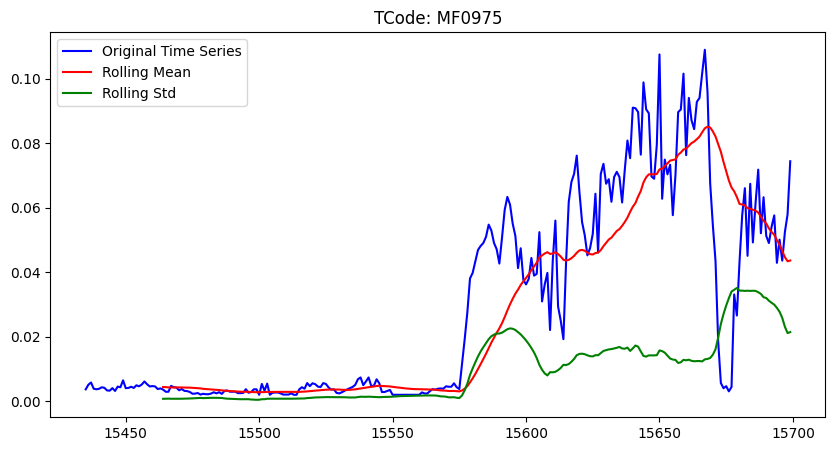

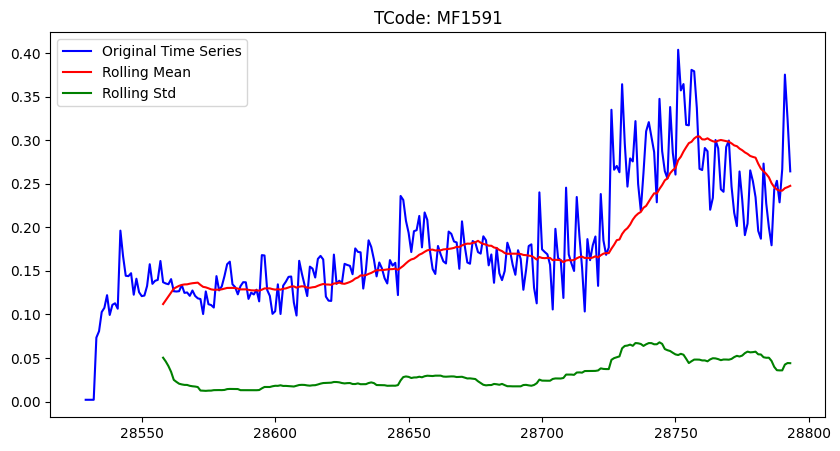

In [81]:
import matplotlib.pyplot as plt
import pandas as pd

for tcode in df_OA_Above100['TCode'].unique():
    tcode_data = df_OA_Above100[df_OA_Above100['TCode'] == tcode]['NormalizedRiskIndicator']

    # Calculate rolling mean and standard deviation
    rolling_mean = tcode_data.rolling(window=30).mean()
    rolling_std = tcode_data.rolling(window=30).std()

    # Plot the original time series
    plt.figure(figsize=(10, 5))
    plt.plot(tcode_data, label='Original Time Series', color='blue')

    # Plot the rolling mean
    plt.plot(rolling_mean, label='Rolling Mean', color='red')

    # Plot the rolling standard deviation
    plt.plot(rolling_std, label='Rolling Std', color='green')

    plt.title(f'TCode: {tcode}')
    plt.legend()
    plt.show()

ARIMA for MF0975 over advance between 100% and 150%

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-1439.410, Time=0.85 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-1433.627, Time=0.10 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-1431.682, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-1431.656, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-1434.427, Time=0.09 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-1437.974, Time=0.37 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-1438.785, Time=1.29 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=-1437.906, Time=0.80 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=-1434.080, Time=0.67 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-1436.338, Time=0.30 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=-1436.406, Time=0.81 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=-1431.064, Time=0.26 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=-1433.370, Time=1.02 sec
 ARIMA(2,1,2)(0,0,0)[0]             : AIC=-1440.131, Time=0.33 sec
 ARIMA(1,1,2)(0,0,0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ

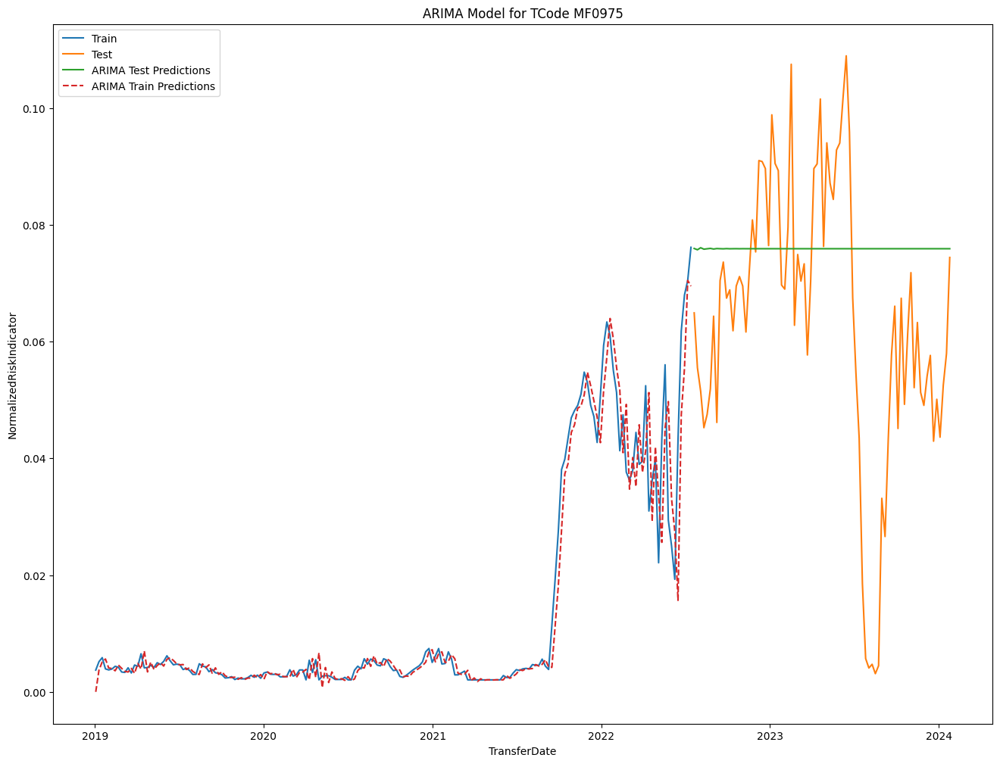

In [83]:
# Filter data for TCode MF1490
df_MF0975 = df_OA_Above100[df_OA_Above100['TCode'] == 'MF0975']

# Convert TransferDate to datetime format
df_MF0975['TransferDate'] = pd.to_datetime(df_MF0975['TransferDate'])

# Split data into train and test (70% rule)
train_size_MF0975 = int(len(df_MF0975) * 0.7)
train_MF0975, test_MF0975 = df_MF0975[:train_size_MF0975], df_MF0975[train_size_MF0975:]

# Import necessary libraries
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Display the process of finding p, d, q values
stepwise_fit_MF0975 = auto_arima(train_MF0975['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

# Get the optimal values
optimal_order_MF0975 = stepwise_fit_MF0975.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_MF0975}")

# Build ARIMA model with the determined parameters
arima_model_MF0975 = ARIMA(train_MF0975['NormalizedRiskIndicator'], order=optimal_order_MF0975)
arima_fit_MF0975 = arima_model_MF0975.fit()

# Predict on the train set
train_predictions_MF0975 = arima_fit_MF0975.predict(start=0, end=len(train_MF0975) - 1, typ='levels')

# Predict on the test set
test_predictions_MF0975 = arima_fit_MF0975.predict(start=len(train_MF0975), end=len(train_MF0975) + len(test_MF0975) - 1, typ='levels')

# Plot the results
plt.plot(train_MF0975['TransferDate'], train_MF0975['NormalizedRiskIndicator'], label='Train')
plt.plot(test_MF0975['TransferDate'], test_MF0975['NormalizedRiskIndicator'], label='Test')
plt.plot(test_MF0975['TransferDate'], test_predictions_MF0975, label='ARIMA Test Predictions')
plt.plot(train_MF0975['TransferDate'], train_predictions_MF0975, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF0975')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()

In [84]:
# Forecast the next 4 weeks
forecast_period = 4

# Get the forecast
forecast_MF0975 = arima_fit_MF0975.get_forecast(steps=forecast_period)

# Extract forecasted values and confidence intervals
forecast_values_MF0975 = forecast_MF0975.predicted_mean
conf_int_MF0975 = forecast_MF0975.conf_int()

# Create a dataframe for the forecast
forecast_df_MF0975 = pd.DataFrame({
    'TransferDate': pd.date_range(start=df_OA_Above100['TransferDate'].max(), periods=forecast_period, freq='W'),
    'Forecasted_Indicator': forecast_values_MF0975,
    'Lower_CI': conf_int.iloc[:, 0],
    'Upper_CI': conf_int.iloc[:, 1]
})

print(forecast_df_MF0975)

    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28              0.075949  0.087437  0.189943
186   2024-02-04              0.075728  0.079638  0.192760
187   2024-02-11              0.076077  0.079193  0.193205
188   2024-02-18              0.075828  0.078751  0.193647


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [85]:

# Assuming you have the actual values for the train and test sets
train_actual_values_MF0975 = train_MF0975['NormalizedRiskIndicator'].values
test_actual_values_MF0975 = test_MF0975['NormalizedRiskIndicator'].values

# Calculate MAE, MSE, RMSE, and MAPE for the train set
train_mae_MF0975 = mean_absolute_error(train_actual_values_MF0975, train_predictions_MF0975)
train_mse_MF0975 = mean_squared_error(train_actual_values_MF0975, train_predictions_MF0975)
train_rmse_MF0975 = np.sqrt(train_mse_MF0975)
train_mape_MF0975 = np.mean(np.abs((train_actual_values_MF0975 - train_predictions_MF0975) / train_actual_values_MF0975)) * 100

# Calculate MAE, MSE, RMSE, and MAPE for the test set
test_mae_MF0975 = mean_absolute_error(test_actual_values_MF0975, test_predictions_MF0975)
test_mse_MF0975 = mean_squared_error(test_actual_values_MF0975, test_predictions_MF0975)
test_rmse_MF0975 = np.sqrt(test_mse_MF0975)
test_mape_MF0975 = np.mean(np.abs((test_actual_values_MF0975 - test_predictions_MF0975) / test_actual_values_MF0975)) * 100

# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae_MF0975}")
print(f"MSE: {train_mse_MF0975}")
print(f"RMSE: {train_rmse_MF0975}")
print(f"MAPE: {train_mape_MF0975}%")

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"MAE: {test_mae_MF0975}")
print(f"MSE: {test_mse_MF0975}")
print(f"RMSE: {test_rmse_MF0975}")
print(f"MAPE: {test_mape_MF0975}%")

Train Set Metrics:
MAE: 0.002328963082031609
MSE: 2.205169930907546e-05
RMSE: 0.004695923690721077
MAPE: 20.12930009061997%

Test Set Metrics:
MAE: 0.02037921912448073
MSE: 0.0007176342617784214
RMSE: 0.026788696530037095
MAPE: 136.22383062234545%


ARIMA for MF1591        OVer Advance between 100%-150%

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-820.423, Time=1.47 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-772.053, Time=0.11 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-795.716, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-820.866, Time=0.34 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-773.712, Time=0.08 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-820.197, Time=0.46 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-820.477, Time=0.56 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-818.501, Time=1.31 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-821.002, Time=0.25 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-820.176, Time=0.46 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-820.447, Time=0.28 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-797.118, Time=0.11 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-818.481, Time=0.57 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 6.192 seconds
Optimal (p, d, q) valu

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


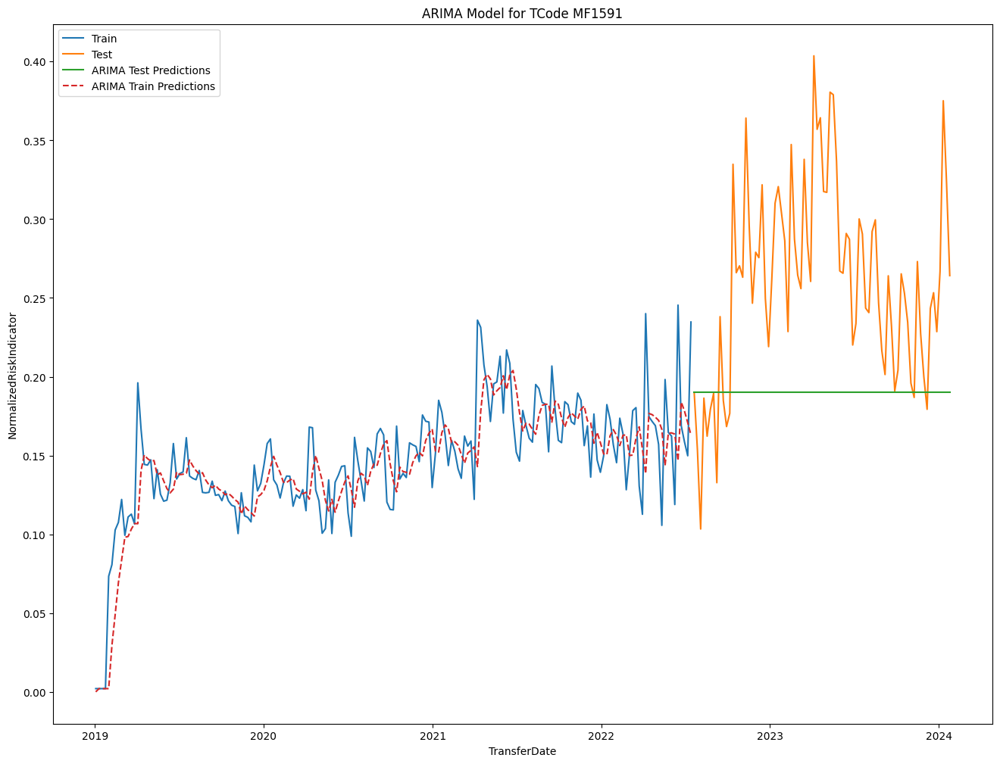

In [87]:
# # Filter data for TCode MF1591
df_MF1591 = df_OA_Above100[df_OA_Above100['TCode'] == 'MF1591']

df_MF1591['TransferDate'] = pd.to_datetime(df_MF1591['TransferDate'])

train_size_MF1591 = int(len(df_MF1591) * 0.7)
train_MF1591, test_MF1591 = df_MF1591[:train_size_MF1591], df_MF1591[train_size_MF1591:]


from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

stepwise_fit_MF1591 = auto_arima(train_MF1591['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

optimal_order_MF1591 = stepwise_fit_MF1591.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_MF1591}")


arima_model_MF1591 = ARIMA(train_MF1591['NormalizedRiskIndicator'], order=optimal_order_MF1591)
arima_fit_MF1591 = arima_model_MF1591.fit()


train_predictions_MF1591 = arima_fit_MF1591.predict(start=0, end=len(train_MF1591) - 1, typ='levels')

test_predictions_MF1591 = arima_fit_MF1591.predict(start=len(train_MF1591), end=len(train_MF1591) + len(test_MF1591) - 1, typ='levels')

plt.plot(train_MF1591['TransferDate'], train_MF1591['NormalizedRiskIndicator'], label='Train')
plt.plot(test_MF1591['TransferDate'], test_MF1591['NormalizedRiskIndicator'], label='Test')
plt.plot(test_MF1591['TransferDate'], test_predictions_MF1591, label='ARIMA Test Predictions')
plt.plot(train_MF1591['TransferDate'], train_predictions_MF1591, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1591')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()

In [88]:
# Forecast the next 4 weeks
forecast_period = 4

# Get the forecast
forecast_MF1591 = arima_fit_MF1591.get_forecast(steps=forecast_period)

# Extract forecasted values and confidence intervals
forecast_values_MF1591 = forecast_MF1591.predicted_mean
conf_int_MF1591 = forecast_MF1591.conf_int()

# Create a dataframe for the forecast
forecast_df_MF1591 = pd.DataFrame({
    'TransferDate': pd.date_range(start=df_OA_Above100['TransferDate'].max(), periods=forecast_period, freq='W'),
    'Forecasted_Indicator': forecast_values_MF1591,
    'Lower_CI': conf_int.iloc[:, 0],
    'Upper_CI': conf_int.iloc[:, 1]
})

# Print the forecasted values and confidence intervals
print(forecast_df_MF1591)

    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28              0.189955  0.087437  0.189943
186   2024-02-04              0.189955  0.079638  0.192760
187   2024-02-11              0.189955  0.079193  0.193205
188   2024-02-18              0.189955  0.078751  0.193647


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [89]:
train_actual_values_MF1591 = train_MF1591['NormalizedRiskIndicator'].values
test_actual_values_MF1591 = test_MF1591['NormalizedRiskIndicator'].values

train_mae_MF1591 = mean_absolute_error(train_actual_values_MF1591, train_predictions_MF1591)
train_mse_MF1591 = mean_squared_error(train_actual_values_MF1591, train_predictions_MF1591)
train_rmse_MF1591 = np.sqrt(train_mse_MF1591)
train_mape_MF1591 = np.mean(np.abs((train_actual_values_MF1591 - train_predictions_MF1591) / train_actual_values_MF1591)) * 100
test_mae_MF1591 = mean_absolute_error(test_actual_values_MF1591, test_predictions_MF1591)
test_mse_MF1591 = mean_squared_error(test_actual_values_MF1591, test_predictions_MF1591)
test_rmse_MF1591 = np.sqrt(test_mse_MF1591)
test_mape_MF1591 = np.mean(np.abs((test_actual_values_MF1591 - test_predictions_MF1591) / test_actual_values_MF1591)) * 100


# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae_MF1591}")
print(f"MSE: {train_mse_MF1591}")
print(f"RMSE: {train_rmse_MF1591}")
print(f"MAPE: {train_mape_MF1591}%")

print("\nTest Set Metrics:")
print(f"MAE: {test_mae_MF1591}")
print(f"MSE: {test_mse_MF1591}")
print(f"RMSE: {test_rmse_MF1591}")
print(f"MAPE: {test_mape_MF1591}%")


Train Set Metrics:
MAE: 0.01784490684366947
MSE: 0.0006563139250961525
RMSE: 0.025618624574636175
MAPE: 12.789138734968317%

Test Set Metrics:
MAE: 0.07714615420540924
MSE: 0.00868910776932984
RMSE: 0.09321538375895815
MAPE: 27.319859801017486%


----------------------------------------------------------------

Build ARIMA for Advance Upto 100%

In [90]:
df_Advance_Upto100.head()

,TCode,TransferDate,NormalizedRiskIndicator
22454,MF1465,2019-01-03,0.067530
22455,MF1465,2019-01-10,0.080689
22456,MF1465,2019-01-17,0.107083
22457,MF1465,2019-01-24,0.089255
22458,MF1465,2019-01-31,0.112632


In [91]:
unique_tcode_count = df_Advance_Upto100['TCode'].nunique()

# Print or use the count as needed
print(f"Count of unique TCode: {unique_tcode_count}")

Count of unique TCode: 3


In [92]:
# Assuming df_OA_Above150 is your DataFrame
tcode_value_counts = df_Advance_Upto100['TCode'].value_counts()

# Display the result
print(tcode_value_counts)


MF1465    265
MF1477    265
MF1561    125
Name: TCode, dtype: int64


In [93]:
df_Advance_Upto100['TransferDate'] = pd.to_datetime(df['TransferDate'])

In [94]:
df_Advance_Upto100 = df_Advance_Upto100[df_Advance_Upto100['TCode'] != 'MF1564']

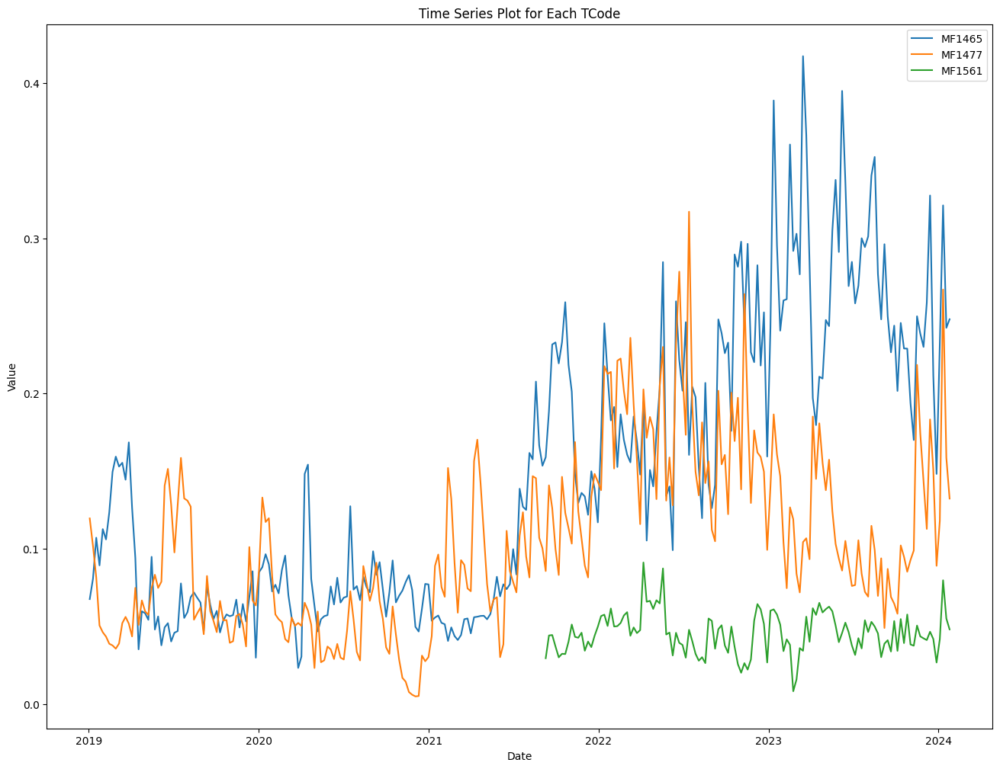

In [95]:
import matplotlib.pyplot as plt


# Get unique TCodes
unique_tcodes = df_Advance_Upto100['TCode'].unique()

# Plot each time series separately
for tcode in unique_tcodes:
    tcode_data = df_Advance_Upto100[df_Advance_Upto100['TCode'] == tcode]
    plt.plot(tcode_data['TransferDate'], tcode_data['NormalizedRiskIndicator'], label=tcode)

# Customize the plot
plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Time Series Plot for Each TCode')
plt.legend()
plt.show()

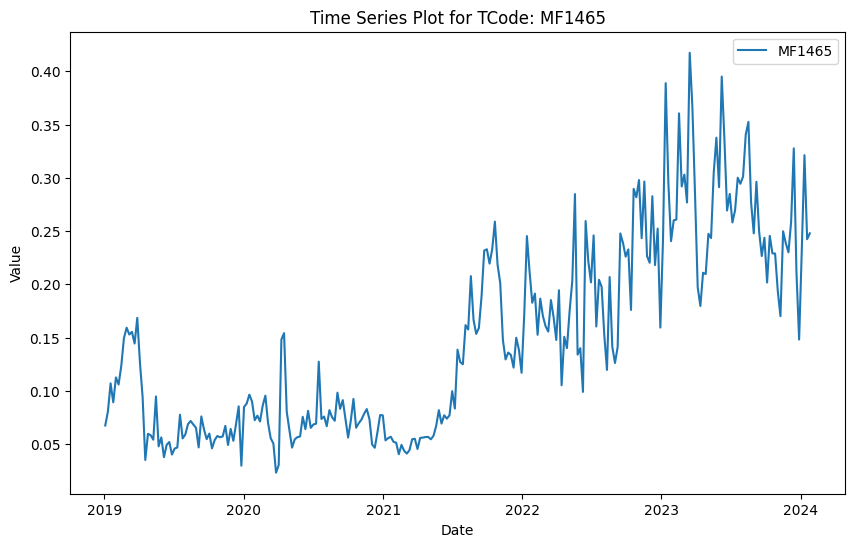

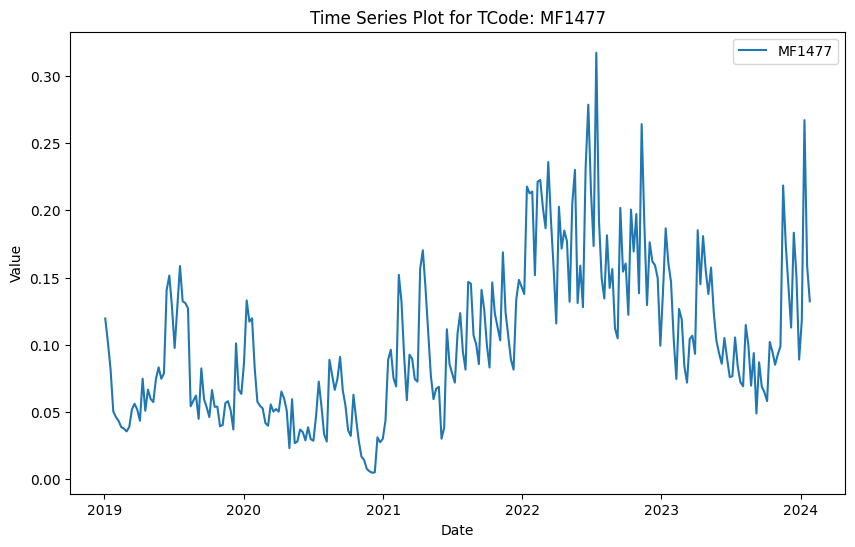

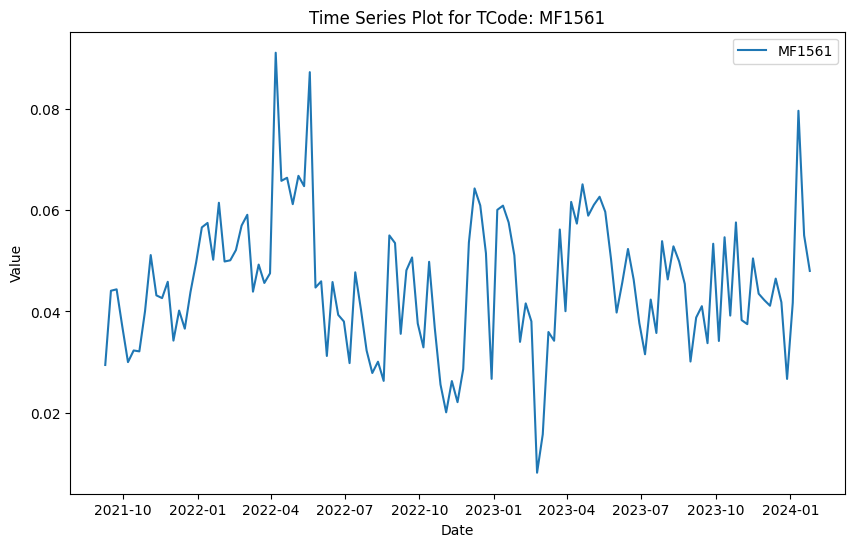

In [96]:
import matplotlib.pyplot as plt

# Get unique TCodes
unique_tcodes = df_Advance_Upto100['TCode'].unique()

# Plot each time series separately
for tcode in unique_tcodes:
    tcode_data = df_Advance_Upto100[df_Advance_Upto100['TCode'] == tcode]
    plt.figure(figsize=(10, 6))  # Adjust the figure size if needed
    plt.plot(tcode_data['TransferDate'], tcode_data['NormalizedRiskIndicator'], label=tcode)
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title(f'Time Series Plot for TCode: {tcode}')
    plt.legend()
    plt.show()

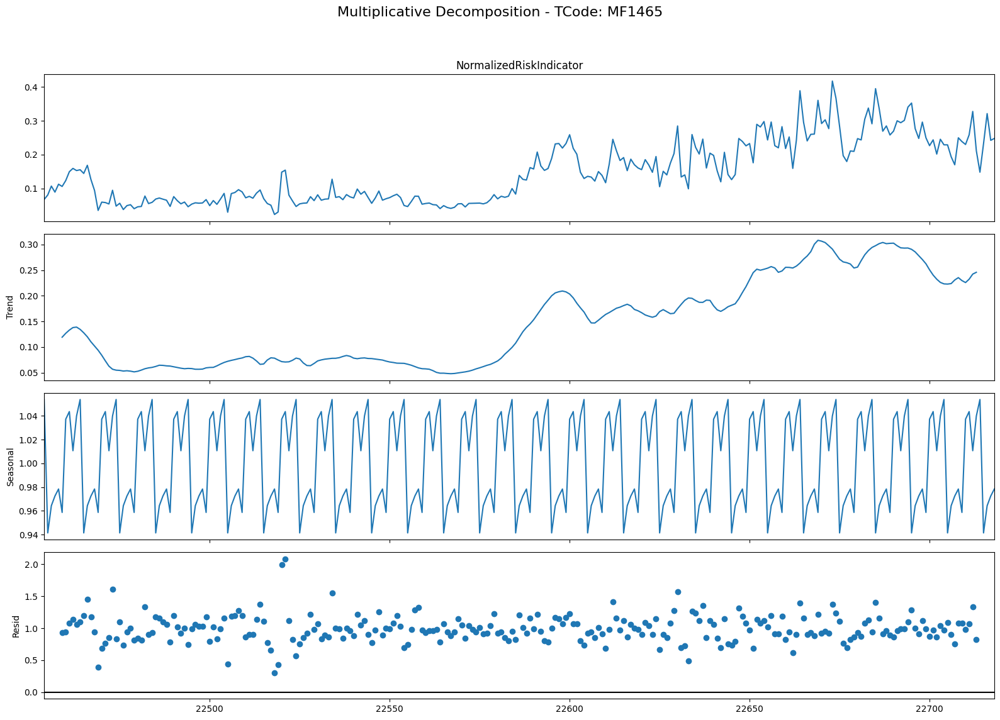

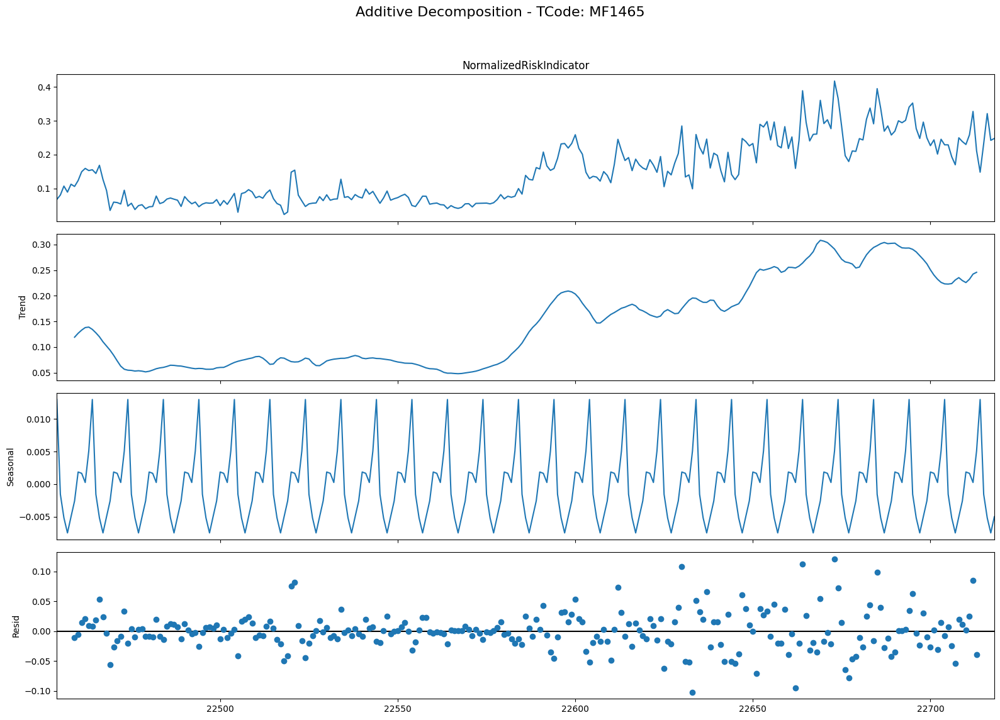

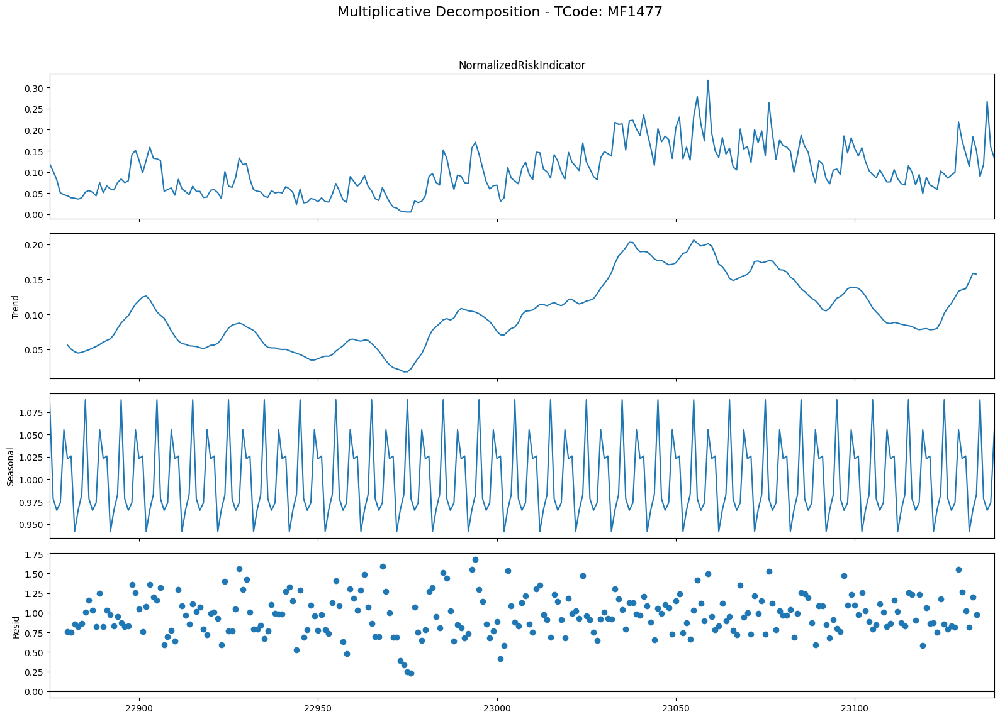

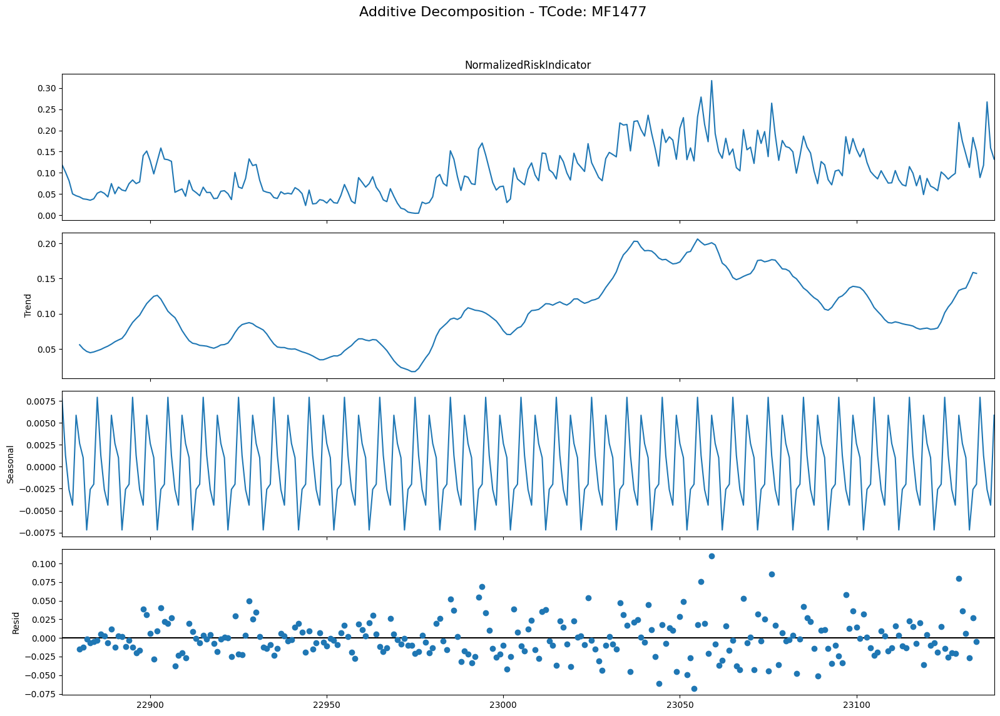

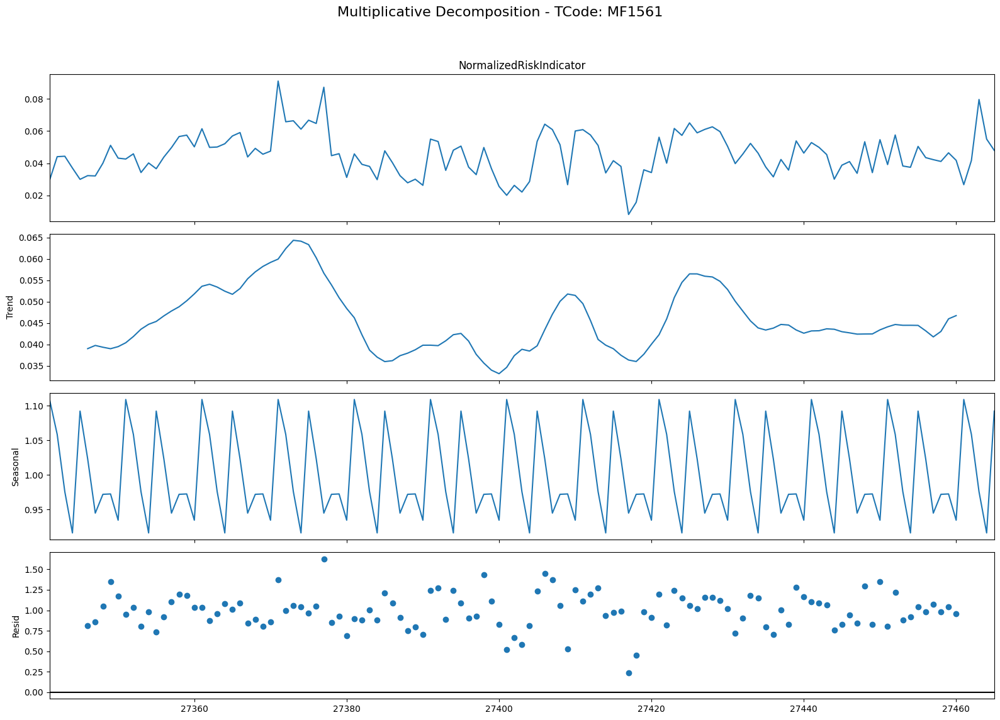

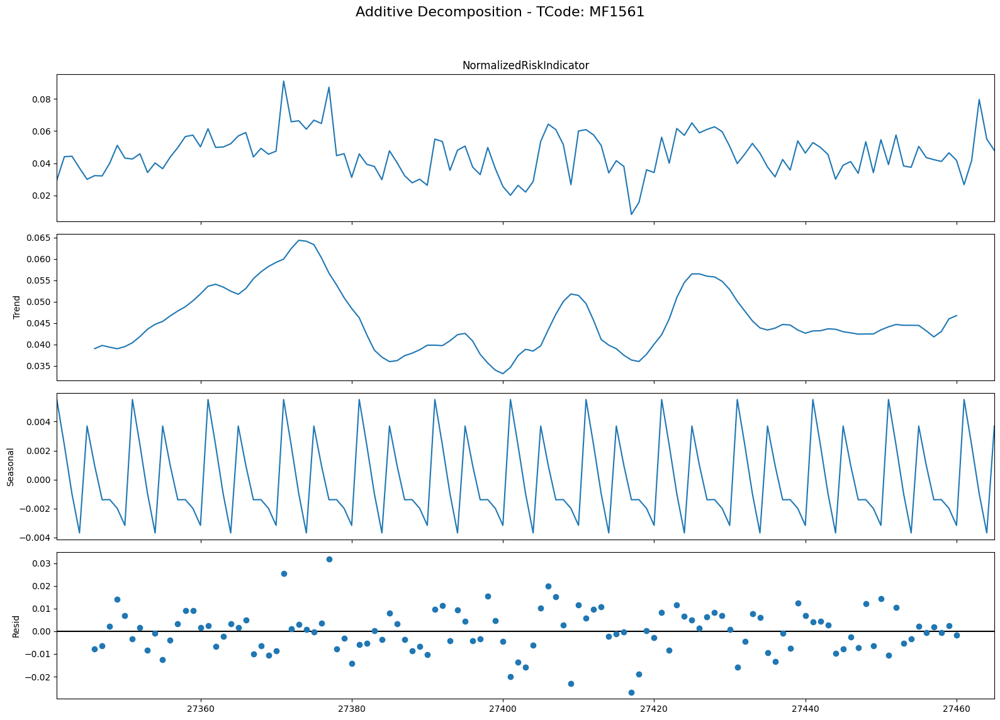

In [97]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

for tcode, subset in df_Advance_Upto100.groupby('TCode'):
    # Assuming 'TransferDate' is in datetime format
    subset['TransferDate'] = pd.to_datetime(subset['TransferDate'])

    period = 10

    # Multiplicative Decomposition
    multiplicative_decomposition = seasonal_decompose(subset['NormalizedRiskIndicator'], model='multiplicative', period=period)

    # Additive Decomposition
    additive_decomposition = seasonal_decompose(subset['NormalizedRiskIndicator'], model='additive', period=period)

    # Plotting
    plt.rcParams.update({'figure.figsize': (16, 12)})
    multiplicative_decomposition.plot().suptitle(f'Multiplicative Decomposition - TCode: {tcode}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])

    additive_decomposition.plot().suptitle(f'Additive Decomposition - TCode: {tcode}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])

    plt.show()

ADF Statistics for TCode: MF1465
P-value: 0.7727910826051612
ADF Statistics: -0.945003964835387
Critical Values: {'1%': -3.4561550092339512, '5%': -2.8728972266578676, '10%': -2.5728222369384763}


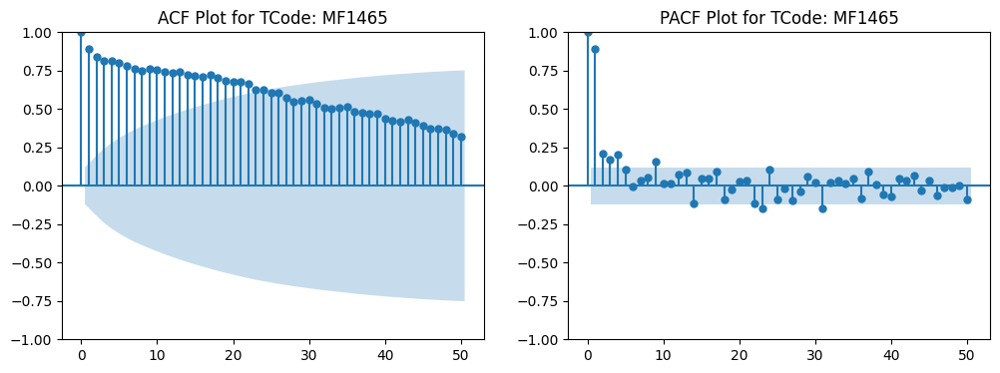

ADF Statistics for TCode: MF1477
P-value: 0.3999845734420989
ADF Statistics: -1.7610081387759584
Critical Values: {'1%': -3.4565688966099373, '5%': -2.8730786194395455, '10%': -2.5729189953388762}


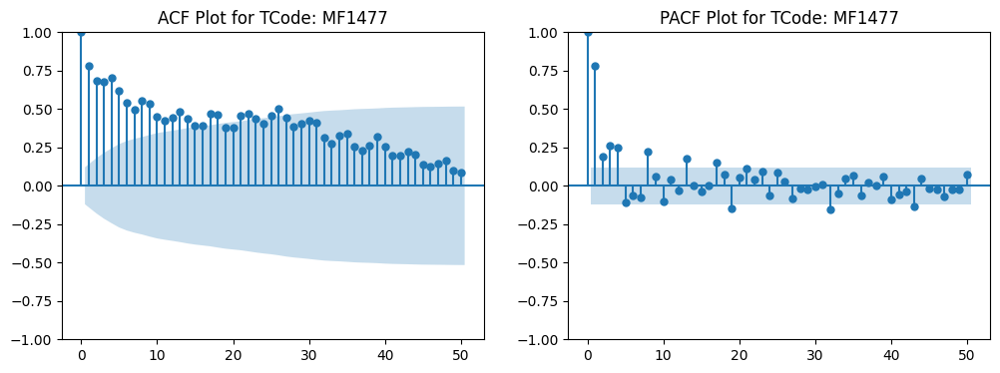

ADF Statistics for TCode: MF1561
P-value: 1.8466308661550192e-08
ADF Statistics: -6.415401139702125
Critical Values: {'1%': -3.484219653271961, '5%': -2.885145235641637, '10%': -2.579359138917794}


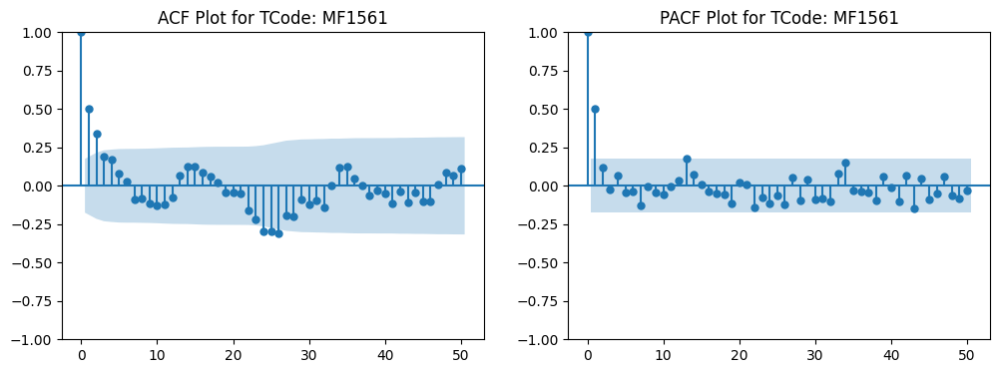

In [98]:
import matplotlib.pyplot as plt
import numpy as np
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

unique_tcodes = df_Advance_Upto100['TCode'].unique()

# Plot ACF and PACF for each time series separately
for tcode in unique_tcodes:
    tcode_data = df_Advance_Upto100[df_Advance_Upto100['TCode'] == tcode]['NormalizedRiskIndicator']

    # Create subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Plot ACF
    plot_acf(tcode_data, lags=50, ax=ax1)
    ax1.set_title(f'ACF Plot for TCode: {tcode}')

    # Plot PACF
    plot_pacf(tcode_data, lags=50, ax=ax2)
    ax2.set_title(f'PACF Plot for TCode: {tcode}')

    # ADF Test
    result = adfuller(tcode_data)
    pvalue = result[1]
    adf_stat = result[0]
    critical_values = result[4]

    print(f"ADF Statistics for TCode: {tcode}")
    print(f"P-value: {pvalue}")
    print(f"ADF Statistics: {adf_stat}")
    print(f"Critical Values: {critical_values}")

    plt.show()

In [99]:
from statsmodels.tsa.stattools import adfuller

unique_tcodes = df_Advance_Upto100['TCode'].unique()

# Perform ADF test for each TCode
for tcode in unique_tcodes:
    tcode_data = df_Advance_Upto100[df_Advance_Upto100['TCode'] == tcode]['NormalizedRiskIndicator']

    # Perform ADF test
    result = adfuller(tcode_data)
    pvalue = result[1]

    print(f"ADF Test Results for TCode: {tcode}")
    print(f"P-value: {pvalue}")

    # Determine stationary based on the p-value
    if pvalue <= 0.05:
        print("Result: Reject the null hypothesis. The time series is likely stationary.")
    else:
        print("Result: Fail to reject the null hypothesis. The time series is likely non-stationary.")

    print("-----------------------")

ADF Test Results for TCode: MF1465
P-value: 0.7727910826051612
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1477
P-value: 0.3999845734420989
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1561
P-value: 1.8466308661550192e-08
Result: Reject the null hypothesis. The time series is likely stationary.
-----------------------


In [100]:
from statsmodels.tsa.stattools import kpss

unique_tcodes = df_Advance_Upto100['TCode'].unique()

# Perform KPSS test for each TCode
for tcode in unique_tcodes:
    tcode_data = df_Advance_Upto100[df_Advance_Upto100['TCode'] == tcode]['NormalizedRiskIndicator']

    # Perform KPSS test
    result = kpss(tcode_data)
    pvalue = result[1]

    print(f"KPSS Test Results for TCode: {tcode}")
    print(f"P-value: {pvalue}")

    # Determine stationary based on the p-value
    if pvalue <= 0.05:
        print("Result: Reject the null hypothesis. The time series is likely non-stationary.")
    else:
        print("Result: Fail to reject the null hypothesis. The time series is likely stationary.")

    print("-----------------------")

KPSS Test Results for TCode: MF1465
P-value: 0.01
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------
KPSS Test Results for TCode: MF1477
P-value: 0.01
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------
KPSS Test Results for TCode: MF1561
P-value: 0.1
Result: Fail to reject the null hypothesis. The time series is likely stationary.
-----------------------


<ipython-input-100-476ab97a4d57>:10: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(tcode_data)
<ipython-input-100-476ab97a4d57>:10: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(tcode_data)
<ipython-input-100-476ab97a4d57>:10: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(tcode_data)


ARIMA for MF1465 _Advance upto 100%

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-771.051, Time=1.74 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-749.679, Time=0.11 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-763.247, Time=0.10 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-768.999, Time=0.76 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-751.630, Time=0.03 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-771.011, Time=0.75 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-772.179, Time=1.61 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-773.656, Time=0.93 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-771.036, Time=0.94 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-762.775, Time=0.46 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-775.213, Time=0.47 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-770.753, Time=0.31 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-765.126, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-773.677, Time=0.67 sec
 ARIMA(1,1,2)(0,0,0)[0]          

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


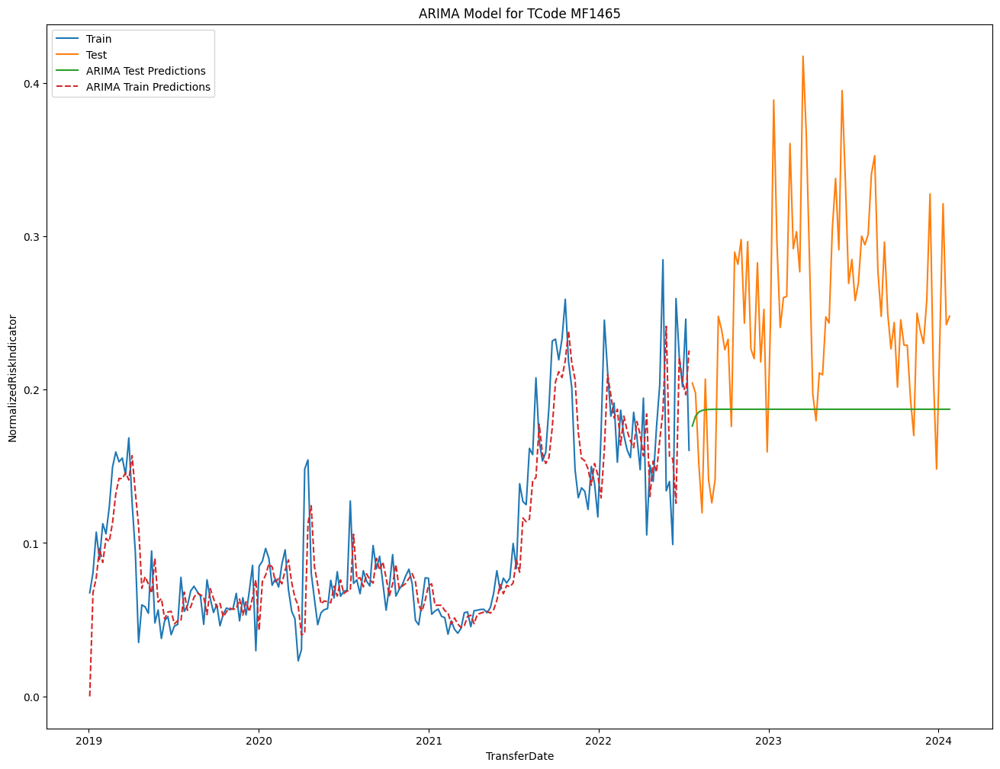

In [102]:
# Filter data for TCode MF1465
df_MF1465 = df_Advance_Upto100[df_Advance_Upto100['TCode'] == 'MF1465']

# Convert TransferDate to datetime format
df_MF1465['TransferDate'] = pd.to_datetime(df_MF1465['TransferDate'])

# Split data into train and test (70% rule)
train_size_MF1465 = int(len(df_MF1465) * 0.7)
train_MF1465, test_MF1465 = df_MF1465[:train_size_MF1465], df_MF1465[train_size_MF1465:]

# Import necessary libraries
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Display the process of finding p, d, q values
stepwise_fit_MF1465 = auto_arima(train_MF1465['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

# Get the optimal values
optimal_order_MF1465 = stepwise_fit_MF1465.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_MF1465}")

# Build ARIMA model with the determined parameters
arima_model_MF1465 = ARIMA(train_MF1465['NormalizedRiskIndicator'], order=optimal_order_MF1465)
arima_fit_MF1465 = arima_model_MF1465.fit()

# Predict on the train set
train_predictions_MF1465 = arima_fit_MF1465.predict(start=0, end=len(train_MF1465) - 1, typ='levels')

# Predict on the test set
test_predictions_MF1465 = arima_fit_MF1465.predict(start=len(train_MF1465), end=len(train_MF1465) + len(test_MF1465) - 1, typ='levels')

# Plot the results
plt.plot(train_MF1465['TransferDate'], train_MF1465['NormalizedRiskIndicator'], label='Train')
plt.plot(test_MF1465['TransferDate'], test_MF1465['NormalizedRiskIndicator'], label='Test')
plt.plot(test_MF1465['TransferDate'], test_predictions_MF1465, label='ARIMA Test Predictions')
plt.plot(train_MF1465['TransferDate'], train_predictions_MF1465, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1465')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()


In [103]:
# # Forecast the next 4 weeks
forecast_period = 4

forecast_MF1465 = arima_fit_MF1465.get_forecast(steps=forecast_period)

forecast_values_MF1465 = forecast_MF1465.predicted_mean
conf_int_MF1465 = forecast_MF1465.conf_int()

forecast_df_MF1465 = pd.DataFrame({
'TransferDate': pd.date_range(start=df_Advance_Upto100['TransferDate'].max(), periods=forecast_period, freq='W'),
'Forecasted_Indicator': forecast_values_MF1465,
'Lower_CI': conf_int_MF1465.iloc[:, 0],
'Upper_CI': conf_int_MF1465.iloc[:, 1]
})

print(forecast_df_MF1465)


    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28              0.176263  0.119564  0.232962
186   2024-02-04              0.182731  0.115751  0.249710
187   2024-02-11              0.185378  0.113144  0.257611
188   2024-02-18              0.186461  0.110494  0.262428


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [104]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

train_actual_values_MF1465 = train_MF1465['NormalizedRiskIndicator'].values
test_actual_values_MF1465 = test_MF1465['NormalizedRiskIndicator'].values

train_mae_MF1465 = mean_absolute_error(train_actual_values_MF1465, train_predictions_MF1465)
train_mse_MF1465 = mean_squared_error(train_actual_values_MF1465, train_predictions_MF1465)
train_rmse_MF1465 = np.sqrt(train_mse_MF1465)
train_mape_MF1465 = np.mean(np.abs((train_actual_values_MF1465 - train_predictions_MF1465) / train_actual_values_MF1465)) * 100

test_mae_MF1465 = mean_absolute_error(test_actual_values_MF1465, test_predictions_MF1465)
test_mse_MF1465 = mean_squared_error(test_actual_values_MF1465, test_predictions_MF1465)
test_rmse_MF1465 = np.sqrt(test_mse_MF1465)
test_mape_MF1465 = np.mean(np.abs((test_actual_values_MF1465 - test_predictions_MF1465) / test_actual_values_MF1465)) * 100

print("Train Set Metrics:")
print(f"MAE: {train_mae_MF1465}")
print(f"MSE: {train_mse_MF1465}")
print(f"RMSE: {train_rmse_MF1465}")
print(f"MAPE: {train_mape_MF1465}%")

print("\nTest Set Metrics:")
print(f"MAE: {test_mae_MF1465}")
print(f"MSE: {test_mse_MF1465}")
print(f"RMSE: {test_rmse_MF1465}")
print(f"MAPE: {test_mape_MF1465}%")



Train Set Metrics:
MAE: 0.01964366936478924
MSE: 0.0008579880078776003
RMSE: 0.029291432328884162
MAPE: 21.197219055479742%

Test Set Metrics:
MAE: 0.07578268697371786
MSE: 0.00817547984737357
RMSE: 0.09041836012322702
MAPE: 27.82595862671316%


ARIMA for MF1477 Advance Upto 100%

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-776.177, Time=1.26 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-733.582, Time=0.16 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-737.558, Time=0.10 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-749.524, Time=0.67 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-735.383, Time=0.03 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-756.231, Time=1.31 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-762.020, Time=1.80 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=-777.854, Time=2.03 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=-770.835, Time=1.19 sec
 ARIMA(4,1,2)(0,0,0)[0] intercept   : AIC=-765.846, Time=1.58 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=-777.456, Time=1.82 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=-772.441, Time=0.71 sec
 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=-768.237, Time=0.69 sec
 ARIMA(4,1,3)(0,0,0)[0] intercept   : AIC=-765.902, Time=0.86 sec
 ARIMA(3,1,2)(0,0,0)[0]          

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ

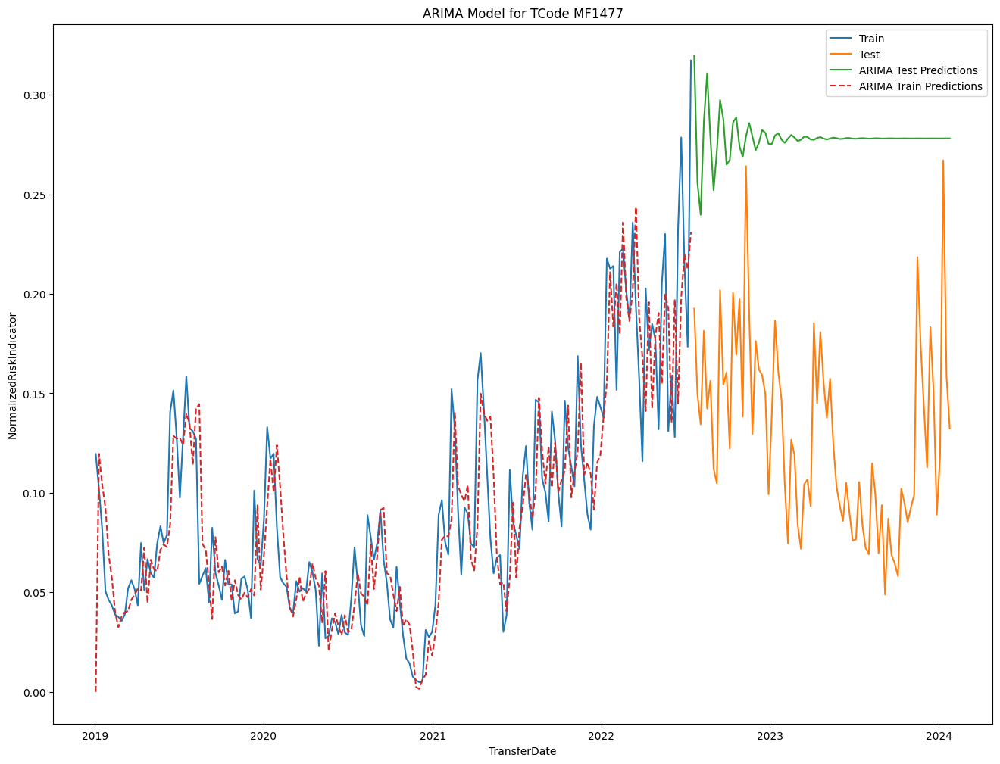

In [106]:
# Filter data for TCode MF1490
df_MF1477 = df_Advance_Upto100[df_Advance_Upto100['TCode'] == 'MF1477']

df_MF1477['TransferDate'] = pd.to_datetime(df_MF1477['TransferDate'])

train_size_MF1477 = int(len(df_MF1477) * 0.7)
train_MF1477, test_MF1477 = df_MF1477[:train_size_MF1477], df_MF1477[train_size_MF1477:]

from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

stepwise_fit_MF1477 = auto_arima(train_MF1477['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

optimal_order_MF1477 = stepwise_fit_MF1477.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_MF1477}")

arima_model_MF1477 = ARIMA(train_MF1477['NormalizedRiskIndicator'], order=optimal_order_MF1477)
arima_fit_MF1477 = arima_model_MF1477.fit()

train_predictions_MF1477 = arima_fit_MF1477.predict(start=0, end=len(train_MF1477) - 1, typ='levels')

test_predictions_MF1477 = arima_fit_MF1477.predict(start=len(train_MF1477), end=len(train_MF1477) + len(test_MF1477) - 1, typ='levels')

plt.plot(train_MF1477['TransferDate'], train_MF1477['NormalizedRiskIndicator'], label='Train')
plt.plot(test_MF1477['TransferDate'], test_MF1477['NormalizedRiskIndicator'], label='Test')
plt.plot(test_MF1477['TransferDate'], test_predictions_MF1477, label='ARIMA Test Predictions')
plt.plot(train_MF1477['TransferDate'], train_predictions_MF1477, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1477')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()



In [107]:
# Forecast the next 4 weeks
forecast_period = 4

forecast_MF1477 = arima_fit_MF1477.get_forecast(steps=forecast_period)

forecast_values_MF1477 = forecast_MF1477.predicted_mean
conf_int_MF1477 = forecast_MF1477.conf_int()

forecast_df_MF1477 = pd.DataFrame({
'TransferDate': pd.date_range(start=df_Advance_Upto100['TransferDate'].max(), periods=forecast_period, freq='W'),
'Forecasted_Indicator': forecast_values_MF1477,
'Lower_CI': conf_int_MF1477.iloc[:, 0],
'Upper_CI': conf_int_MF1477.iloc[:, 1]
})

print(forecast_df_MF1477)

    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28              0.319536  0.264016  0.375056
186   2024-02-04              0.255855  0.186128  0.325582
187   2024-02-11              0.239685  0.164708  0.314662
188   2024-02-18              0.286842  0.204016  0.369668


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [108]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Assuming you have the actual values for the train and test sets
train_actual_values_MF1477 = train_MF1465['NormalizedRiskIndicator'].values
test_actual_values_MF1477 = test_MF1465['NormalizedRiskIndicator'].values

# Calculate MAE, MSE, RMSE, and MAPE for the train set
train_mae_MF1477 = mean_absolute_error(train_actual_values_MF1477, train_predictions_MF1477)
train_mse_MF1477 = mean_squared_error(train_actual_values_MF1477, train_predictions_MF1477)
train_rmse_MF1477 = np.sqrt(train_mse_MF1477)
train_mape_MF1477 = np.mean(np.abs((train_actual_values_MF1477 - train_predictions_MF1477) / train_actual_values_MF1477)) * 100

# Calculate MAE, MSE, RMSE, and MAPE for the test set
test_mae_MF1477 = mean_absolute_error(test_actual_values_MF1477, test_predictions_MF1477)
test_mse_MF1477 = mean_squared_error(test_actual_values_MF1477, test_predictions_MF1477)
test_rmse_MF1477 = np.sqrt(test_mse_MF1477)
test_mape_MF1477 = np.mean(np.abs((test_actual_values_MF1477 - test_predictions_MF1477) / test_actual_values_MF1477)) * 100

# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae_MF1477}")
print(f"MSE: {train_mse_MF1477}")
print(f"RMSE: {train_rmse_MF1477}")
print(f"MAPE: {train_mape_MF1477}%")

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"MAE: {test_mae_MF1477}")
print(f"MSE: {test_mse_MF1477}")
print(f"RMSE: {test_rmse_MF1477}")
print(f"MAPE: {test_mape_MF1477}%")


Train Set Metrics:
MAE: 0.041057688902074084
MSE: 0.00275507675795489
RMSE: 0.05248882507691413
MAPE: 46.64616060615057%

Test Set Metrics:
MAE: 0.05234040273473913
MSE: 0.004270706672414868
RMSE: 0.06535064400918225
MAPE: 24.756389592876317%


ARIMA for MF1561 _ Advance Upto 100%

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-506.871, Time=0.65 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-280.439, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-498.973, Time=0.06 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-356.370, Time=0.17 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-505.488, Time=0.24 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-509.004, Time=0.49 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-506.562, Time=0.21 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-504.202, Time=0.22 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-501.214, Time=0.63 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-503.163, Time=0.22 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-499.284, Time=0.91 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-515.374, Time=0.47 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-517.163, Time=0.38 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=-506.350, Time=0.42 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


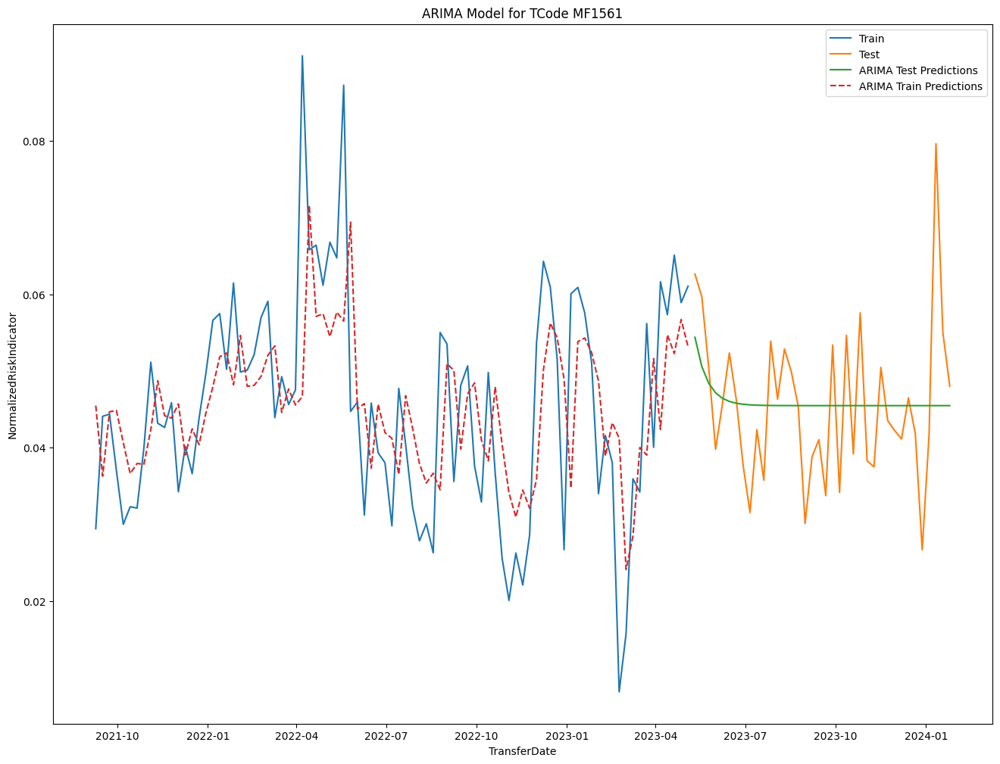

In [110]:
# Filter data for TCode MF1561
df_MF1561 = df_Advance_Upto100[df_Advance_Upto100['TCode'] == 'MF1561']

# Convert TransferDate to datetime format
df_MF1561['TransferDate'] = pd.to_datetime(df_MF1561['TransferDate'])

# Split data into train and test (70% rule)
train_size_MF1561 = int(len(df_MF1561) * 0.7)
train_MF1561, test_MF1561 = df_MF1561[:train_size_MF1561], df_MF1561[train_size_MF1561:]

# Import necessary libraries
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Display the process of finding p, d, q values
stepwise_fit_MF1561 = auto_arima(train_MF1561['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

# Get the optimal values
optimal_order_MF1561 = stepwise_fit_MF1561.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_MF1561}")

# Build ARIMA model with the determined parameters
arima_model_MF1561 = ARIMA(train_MF1561['NormalizedRiskIndicator'], order=optimal_order_MF1561)
arima_fit_MF1561 = arima_model_MF1561.fit()

# Predict on the train set
train_predictions_MF1561 = arima_fit_MF1561.predict(start=0, end=len(train_MF1561) - 1, typ='levels')

# Predict on the test set
test_predictions_MF1561 = arima_fit_MF1561.predict(start=len(train_MF1561), end=len(train_MF1561) + len(test_MF1561) - 1, typ='levels')

# Plot the results
plt.plot(train_MF1561['TransferDate'], train_MF1561['NormalizedRiskIndicator'], label='Train')
plt.plot(test_MF1561['TransferDate'], test_MF1561['NormalizedRiskIndicator'], label='Test')
plt.plot(test_MF1561['TransferDate'], test_predictions_MF1561, label='ARIMA Test Predictions')
plt.plot(train_MF1561['TransferDate'], train_predictions_MF1561, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1561')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()


In [111]:
# Forecast the next 4 weeks
forecast_period = 4

# Get the forecast
forecast_MF1561 = arima_fit_MF1561.get_forecast(steps=forecast_period)

# Extract forecasted values and confidence intervals
forecast_values_MF1561 = forecast_MF1561.predicted_mean
conf_int_MF1561 = forecast_MF1561.conf_int()

# Create a dataframe for the forecast
forecast_df_MF1561 = pd.DataFrame({
    'TransferDate': pd.date_range(start=df_Advance_Upto100['TransferDate'].max(), periods=forecast_period, freq='W'),
    'Forecasted_Indicator': forecast_values_MF1561,
    'Lower_CI': conf_int_MF1561.iloc[:, 0],
    'Upper_CI': conf_int_MF1561.iloc[:, 1]
})

# Print the forecasted values and confidence intervals
print(forecast_df_MF1561)


   TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
87   2024-01-28              0.054400  0.031143  0.077657
88   2024-02-04              0.050586  0.023790  0.077382
89   2024-02-11              0.048403  0.020546  0.076261
90   2024-02-18              0.047154  0.018958  0.075351


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [112]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Assuming you have the actual values for the train and test sets
train_actual_values_MF1561 = train_MF1561['NormalizedRiskIndicator'].values
test_actual_values_MF1561 = test_MF1561['NormalizedRiskIndicator'].values

# Calculate MAE, MSE, RMSE, and MAPE for the train set
train_mae_MF1561 = mean_absolute_error(train_actual_values_MF1561, train_predictions_MF1561)
train_mse_MF1561 = mean_squared_error(train_actual_values_MF1561, train_predictions_MF1561)
train_rmse_MF1561 = np.sqrt(train_mse_MF1561)
train_mape_MF1561 = np.mean(np.abs((train_actual_values_MF1561 - train_predictions_MF1561) / train_actual_values_MF1561)) * 100

# Calculate MAE, MSE, RMSE, and MAPE for the test set
test_mae_MF1561 = mean_absolute_error(test_actual_values_MF1561, test_predictions_MF1561)
test_mse_MF1561 = mean_squared_error(test_actual_values_MF1561, test_predictions_MF1561)
test_rmse_MF1561 = np.sqrt(test_mse_MF1561)
test_mape_MF1561 = np.mean(np.abs((test_actual_values_MF1561 - test_predictions_MF1561) / test_actual_values_MF1561)) * 100

# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae_MF1561}")
print(f"MSE: {train_mse_MF1561}")
print(f"RMSE: {train_rmse_MF1561}")
print(f"MAPE: {train_mape_MF1561}%")

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"MAE: {test_mae_MF1561}")
print(f"MSE: {test_mse_MF1561}")
print(f"RMSE: {test_rmse_MF1561}")
print(f"MAPE: {test_mape_MF1561}%")


Train Set Metrics:
MAE: 0.009208496020235676
MSE: 0.0001417968543096432
RMSE: 0.011907848433266323
MAPE: 25.765226021733795%

Test Set Metrics:
MAE: 0.007334244529268074
MSE: 9.166004388009055e-05
RMSE: 0.009573925207567195
MAPE: 17.136698868985768%


----------------------------------------------------------------

Non OVer Advance Clients

In [113]:
df_Non_OA.head()

,TCode,TransferDate,NormalizedRiskIndicator
16300,MF1172,2019-01-03,0.070542
16301,MF1172,2019-01-10,0.095085
16302,MF1172,2019-01-17,0.092042
16303,MF1172,2019-01-24,0.095996
16304,MF1172,2019-01-31,0.088883


In [114]:
unique_tcode_count = df_Non_OA['TCode'].nunique()

# Print or use the count as needed
print(f"Count of unique TCode: {unique_tcode_count}")

Count of unique TCode: 4


In [115]:
# Assuming df_OA_Above150 is your DataFrame
tcode_value_counts = df_Non_OA['TCode'].value_counts()

# Display the result
print(tcode_value_counts)

MF1172    265
MF1337    265
MF1365    265
MF1510    265
Name: TCode, dtype: int64


In [116]:
df_Non_OA['TransferDate'] = pd.to_datetime(df['TransferDate'])

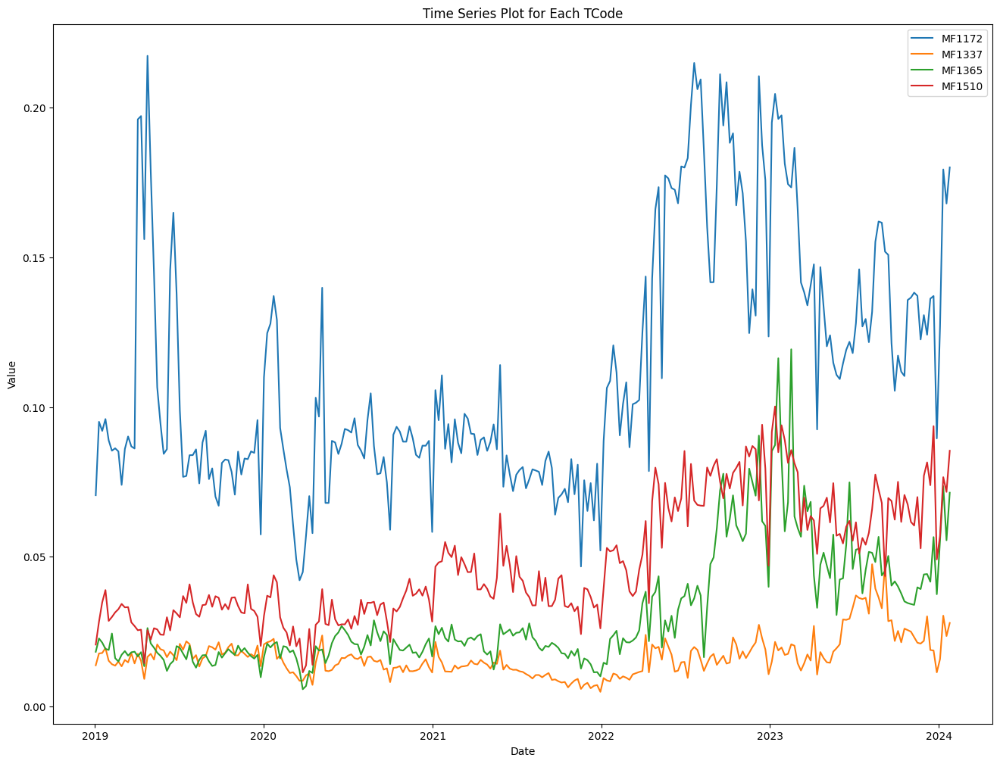

In [117]:
import matplotlib.pyplot as plt

unique_tcodes = df_Non_OA['TCode'].unique()

# Plot each time series separately
for tcode in unique_tcodes:
    tcode_data = df_Non_OA[df_Non_OA['TCode'] == tcode]
    plt.plot(tcode_data['TransferDate'], tcode_data['NormalizedRiskIndicator'], label=tcode)

# Customize the plot
plt.xlabel('Date')
plt.ylabel('Value')
plt.title('Time Series Plot for Each TCode')
plt.legend()
plt.show()


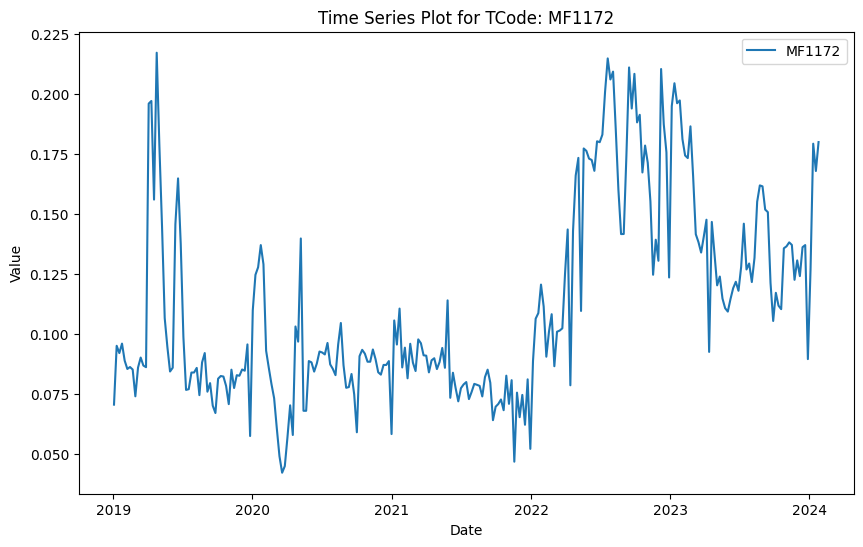

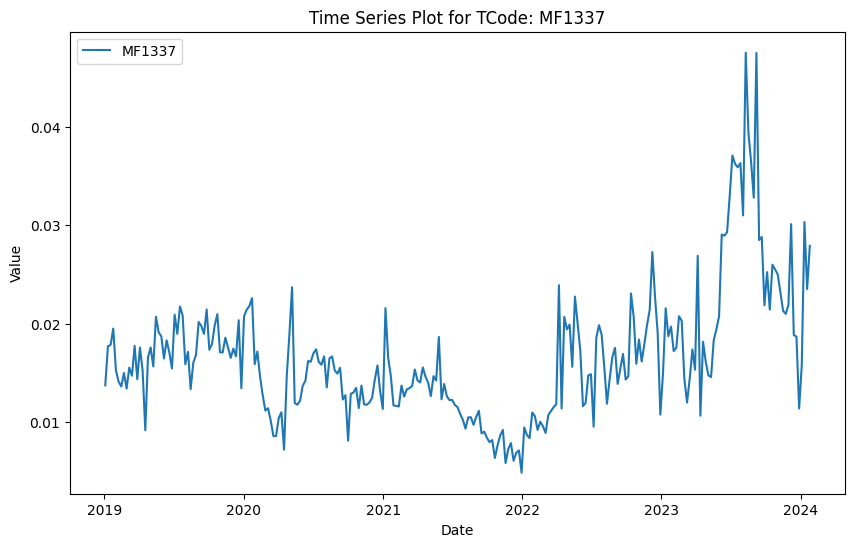

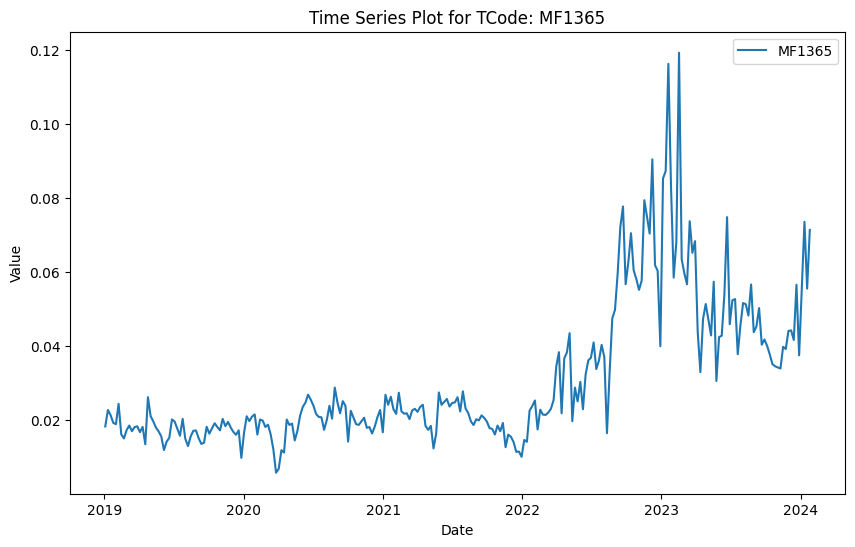

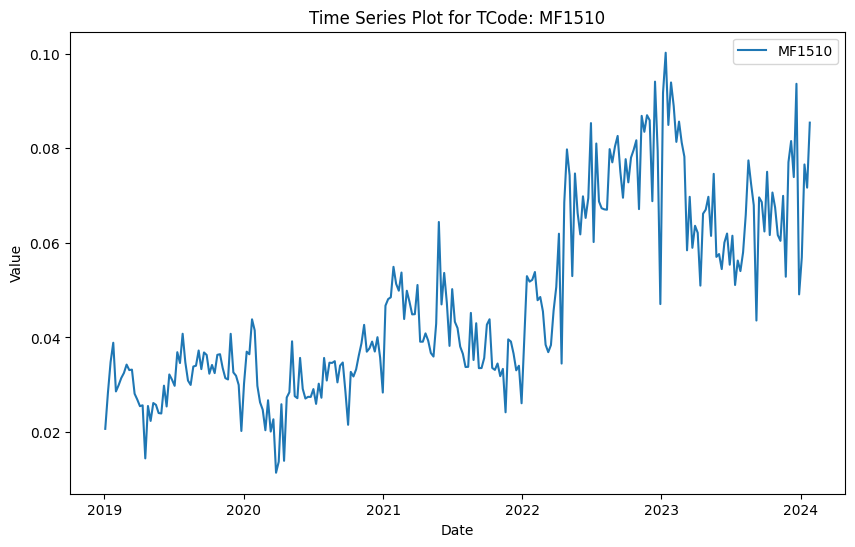

In [118]:
import matplotlib.pyplot as plt

unique_tcodes = df_Non_OA['TCode'].unique()

# Plot each time series separately
for tcode in unique_tcodes:
    tcode_data = df_Non_OA[df_Non_OA['TCode'] == tcode]
    plt.figure(figsize=(10, 6))  # Adjust the figure size if needed
    plt.plot(tcode_data['TransferDate'], tcode_data['NormalizedRiskIndicator'], label=tcode)
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title(f'Time Series Plot for TCode: {tcode}')
    plt.legend()
    plt.show()


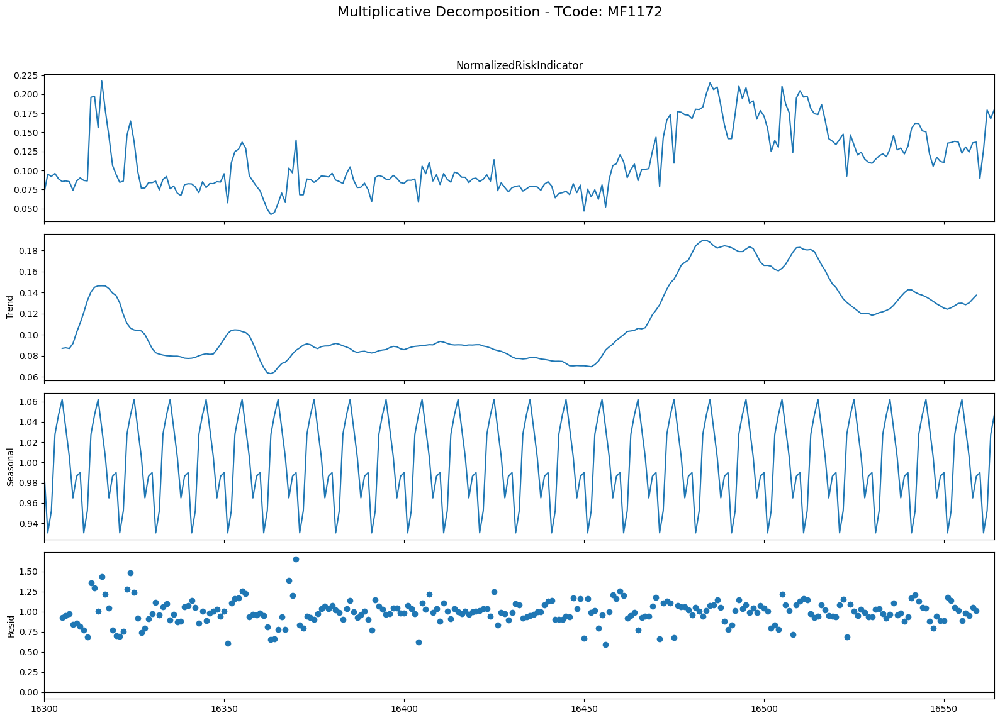

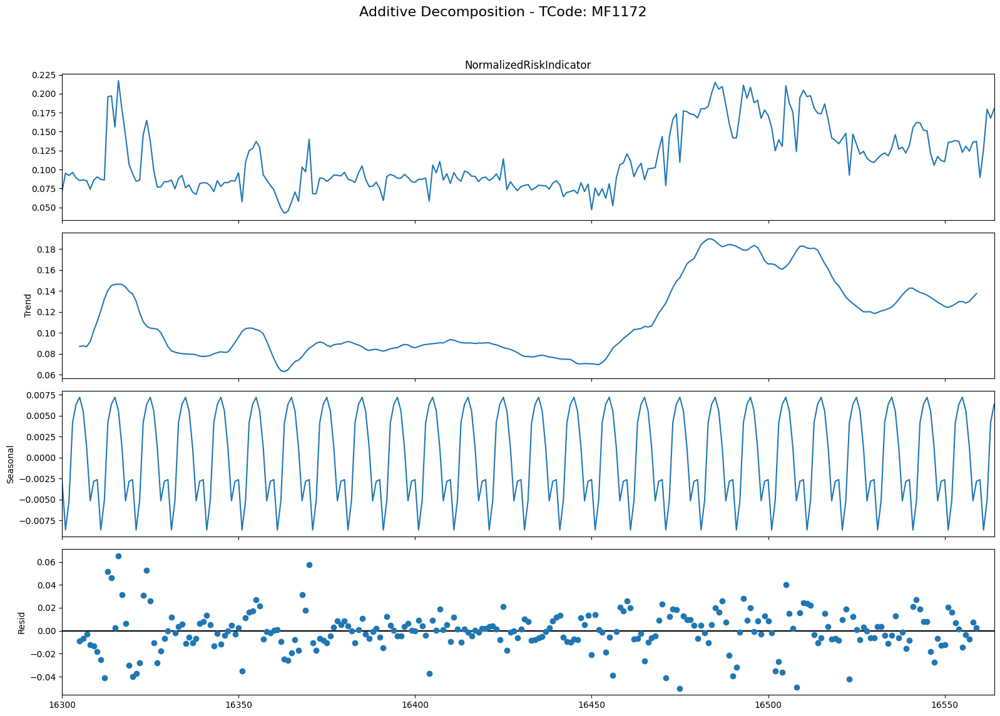

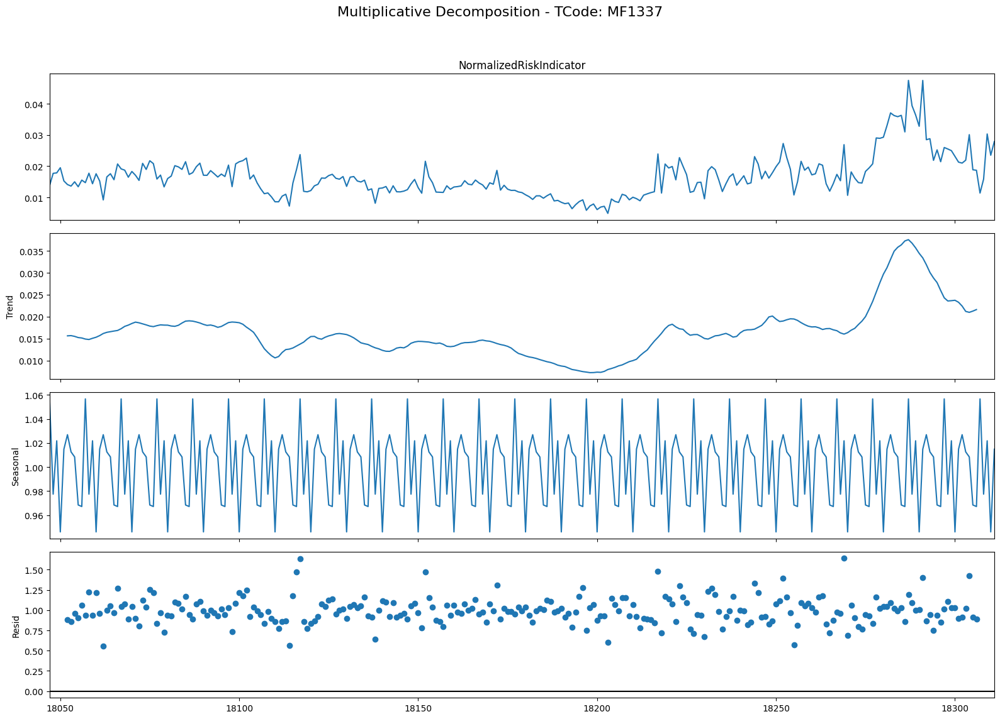

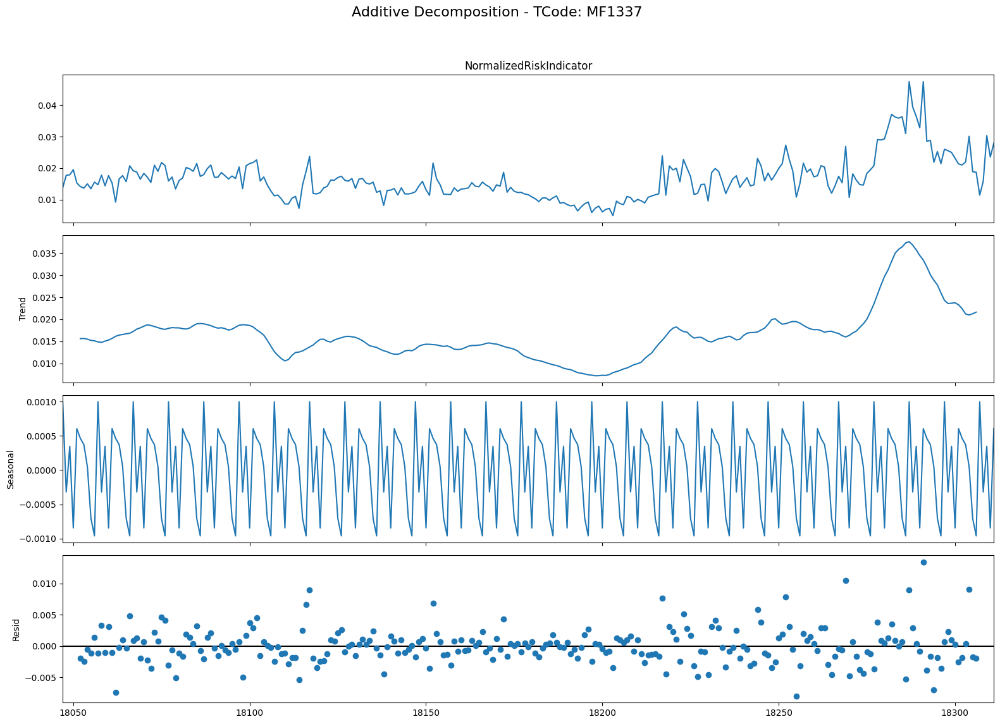

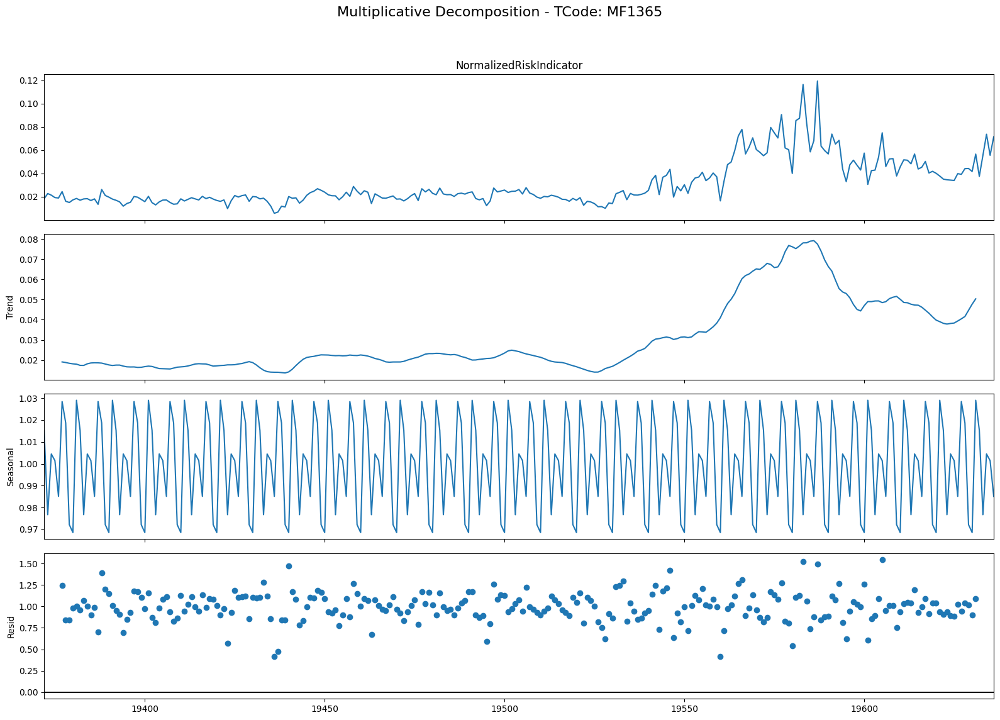

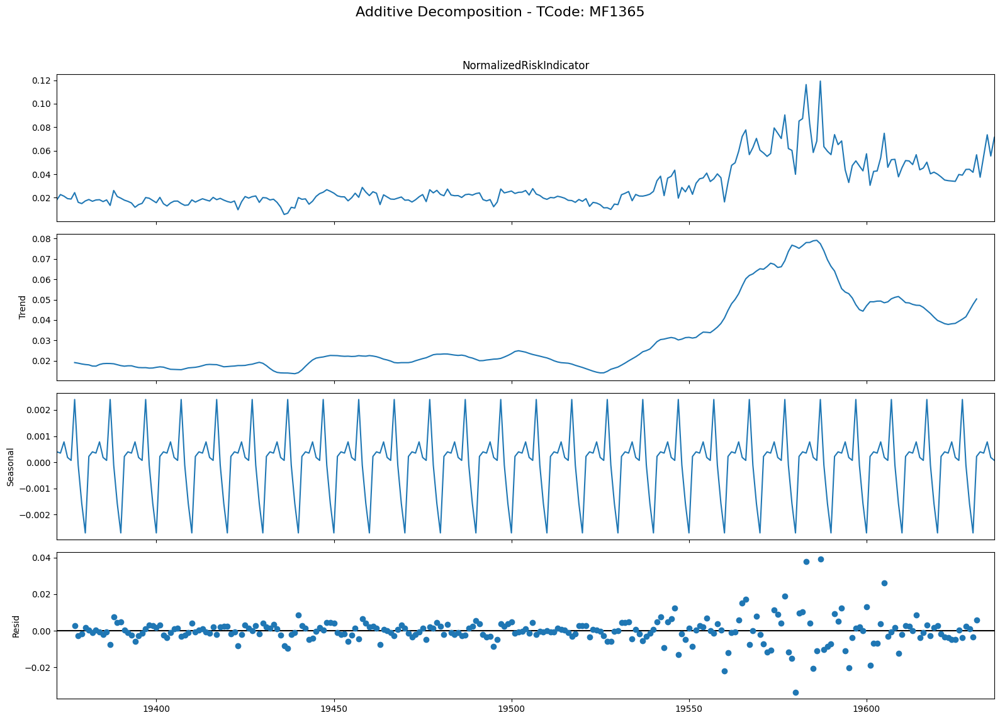

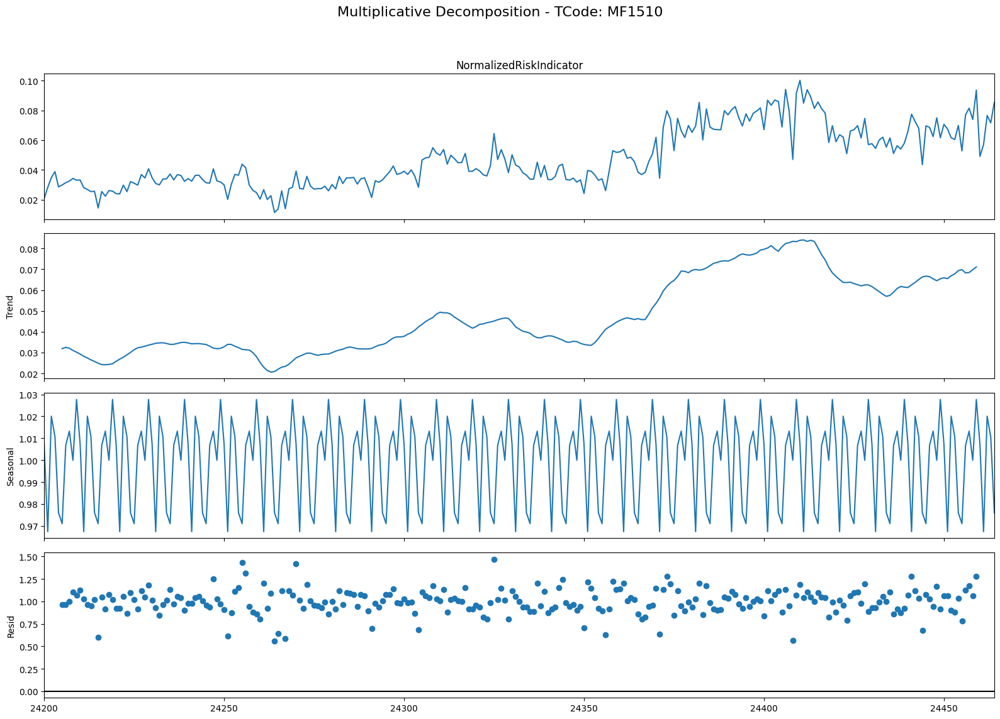

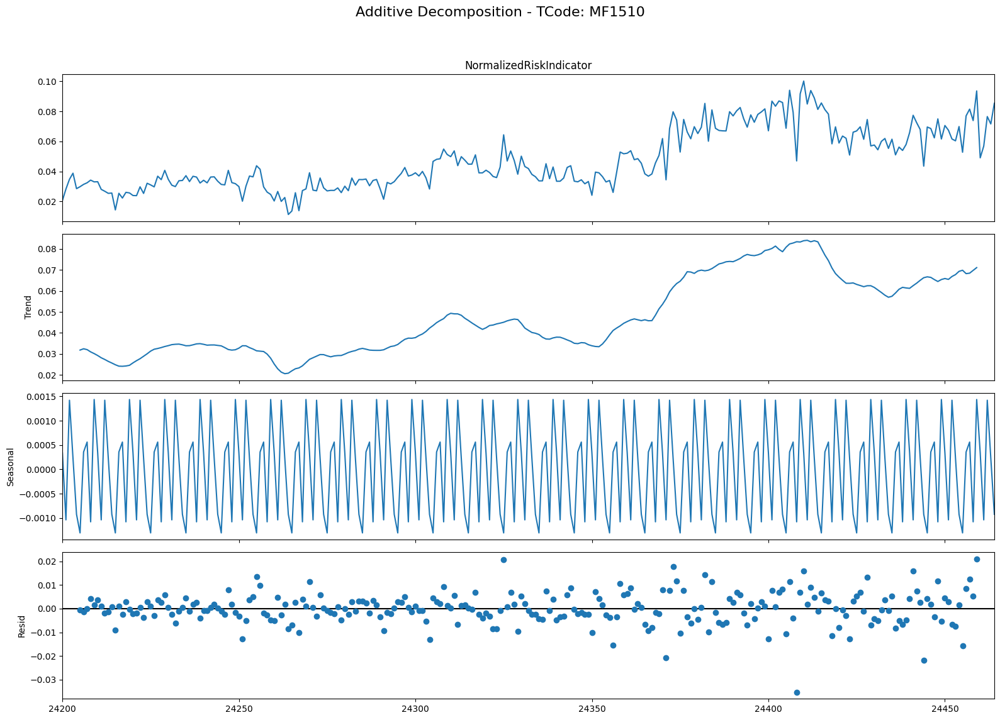

In [119]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

for tcode, subset in df_Non_OA.groupby('TCode'):
    # Assuming 'TransferDate' is in datetime format
    subset['TransferDate'] = pd.to_datetime(subset['TransferDate'])

    period = 10

    # Multiplicative Decomposition
    multiplicative_decomposition = seasonal_decompose(subset['NormalizedRiskIndicator'], model='multiplicative', period=period)

    # Additive Decomposition
    additive_decomposition = seasonal_decompose(subset['NormalizedRiskIndicator'], model='additive', period=period)

    # Plotting
    plt.rcParams.update({'figure.figsize': (16, 12)})
    multiplicative_decomposition.plot().suptitle(f'Multiplicative Decomposition - TCode: {tcode}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])

    additive_decomposition.plot().suptitle(f'Additive Decomposition - TCode: {tcode}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])

    plt.show()

ADF Statistics for TCode: MF1172
P-value: 0.17746873224797022
ADF Statistics: -2.2831235852563143
Critical Values: {'1%': -3.4558530692911504, '5%': -2.872764881778665, '10%': -2.572751643088207}


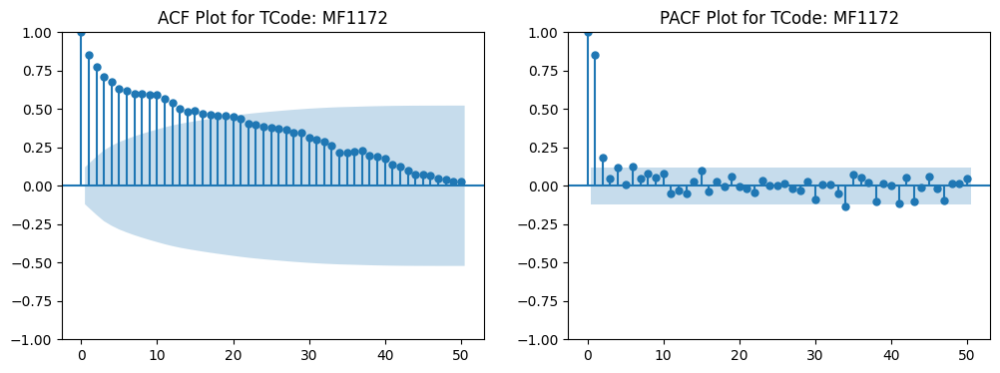

ADF Statistics for TCode: MF1337
P-value: 0.14774481328645972
ADF Statistics: -2.379022773029925
Critical Values: {'1%': -3.4556556713934934, '5%': -2.872678352489859, '10%': -2.57270548832225}


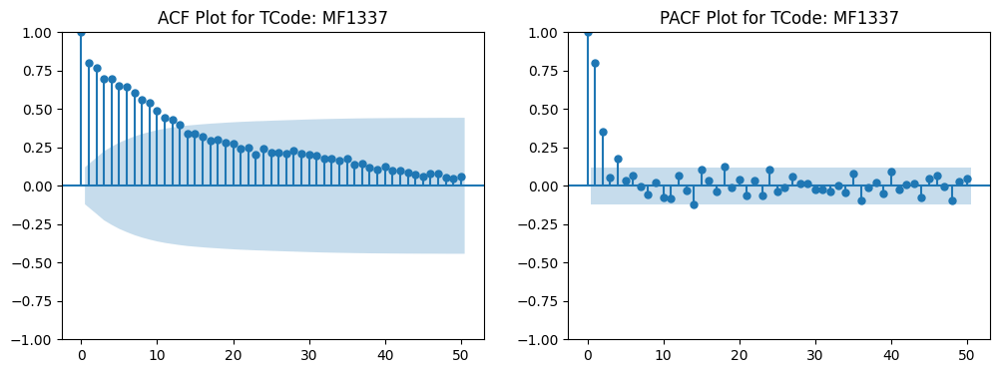

ADF Statistics for TCode: MF1365
P-value: 0.7496024983541898
ADF Statistics: -1.0099920729565028
Critical Values: {'1%': -3.4558530692911504, '5%': -2.872764881778665, '10%': -2.572751643088207}


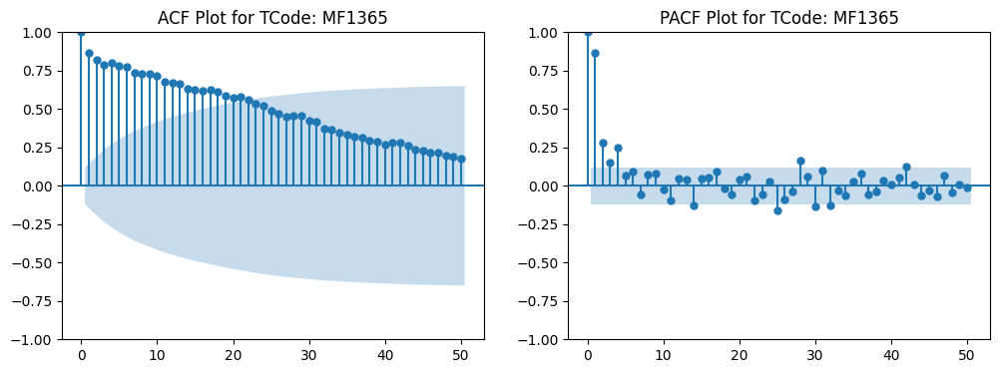

ADF Statistics for TCode: MF1510
P-value: 0.6686136766348333
ADF Statistics: -1.211535899870389
Critical Values: {'1%': -3.4558530692911504, '5%': -2.872764881778665, '10%': -2.572751643088207}


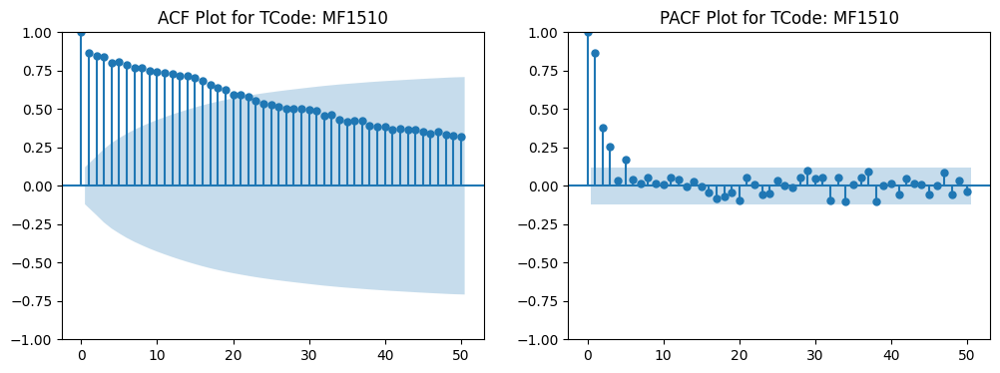

In [120]:
import matplotlib.pyplot as plt
import numpy as np
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

unique_tcodes = df_Non_OA['TCode'].unique()

# Plot ACF and PACF for each time series separately
for tcode in unique_tcodes:
    tcode_data = df_Non_OA[df_Non_OA['TCode'] == tcode]['NormalizedRiskIndicator']

    # Create subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Plot ACF
    plot_acf(tcode_data, lags=50, ax=ax1)
    ax1.set_title(f'ACF Plot for TCode: {tcode}')

    # Plot PACF
    plot_pacf(tcode_data, lags=50, ax=ax2)
    ax2.set_title(f'PACF Plot for TCode: {tcode}')

    # ADF Test
    result = adfuller(tcode_data)
    pvalue = result[1]
    adf_stat = result[0]
    critical_values = result[4]

    print(f"ADF Statistics for TCode: {tcode}")
    print(f"P-value: {pvalue}")
    print(f"ADF Statistics: {adf_stat}")
    print(f"Critical Values: {critical_values}")

    plt.show()


In [121]:
from statsmodels.tsa.stattools import adfuller

unique_tcodes = df_Non_OA['TCode'].unique()

# Perform ADF test for each TCode
for tcode in unique_tcodes:
    tcode_data = df_Non_OA[df_Non_OA['TCode'] == tcode]['NormalizedRiskIndicator']

    # Perform ADF test
    result = adfuller(tcode_data)
    pvalue = result[1]

    print(f"ADF Test Results for TCode: {tcode}")
    print(f"P-value: {pvalue}")

    # Determine stationary based on the p-value
    if pvalue <= 0.05:
        print("Result: Reject the null hypothesis. The time series is likely stationary.")
    else:
        print("Result: Fail to reject the null hypothesis. The time series is likely non-stationary.")

    print("-----------------------")

ADF Test Results for TCode: MF1172
P-value: 0.17746873224797022
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1337
P-value: 0.14774481328645972
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1365
P-value: 0.7496024983541898
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------
ADF Test Results for TCode: MF1510
P-value: 0.6686136766348333
Result: Fail to reject the null hypothesis. The time series is likely non-stationary.
-----------------------


In [122]:
from statsmodels.tsa.stattools import kpss

unique_tcodes = df_Non_OA['TCode'].unique()

# Perform KPSS test for each TCode
for tcode in unique_tcodes:
    tcode_data = df_Non_OA[df_Non_OA['TCode'] == tcode]['NormalizedRiskIndicator']

    # Perform KPSS test
    result = kpss(tcode_data)
    pvalue = result[1]

    print(f"KPSS Test Results for TCode: {tcode}")
    print(f"P-value: {pvalue}")

    # Determine stationary based on the p-value
    if pvalue <= 0.05:
        print("Result: Reject the null hypothesis. The time series is likely non-stationary.")
    else:
        print("Result: Fail to reject the null hypothesis. The time series is likely stationary.")

    print("-----------------------")

KPSS Test Results for TCode: MF1172
P-value: 0.01
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------
KPSS Test Results for TCode: MF1337
P-value: 0.014470063759904209
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------
KPSS Test Results for TCode: MF1365
P-value: 0.01
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------
KPSS Test Results for TCode: MF1510
P-value: 0.01
Result: Reject the null hypothesis. The time series is likely non-stationary.
-----------------------


<ipython-input-122-6e5c6f4536ad>:10: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(tcode_data)
<ipython-input-122-6e5c6f4536ad>:10: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(tcode_data)
<ipython-input-122-6e5c6f4536ad>:10: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(tcode_data)


ARIMA for MF1337 NON OVER ADVANCE

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-1629.182, Time=2.88 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-1591.874, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-1628.590, Time=0.30 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-1636.038, Time=0.31 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-1593.861, Time=0.08 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-1633.210, Time=0.63 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-1634.038, Time=1.57 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-1627.596, Time=0.57 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-1638.036, Time=0.30 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-1635.207, Time=0.38 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-1635.453, Time=0.39 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-1630.590, Time=0.16 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-1634.191, Time=1.24 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 9.014 seconds
Optimal (

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


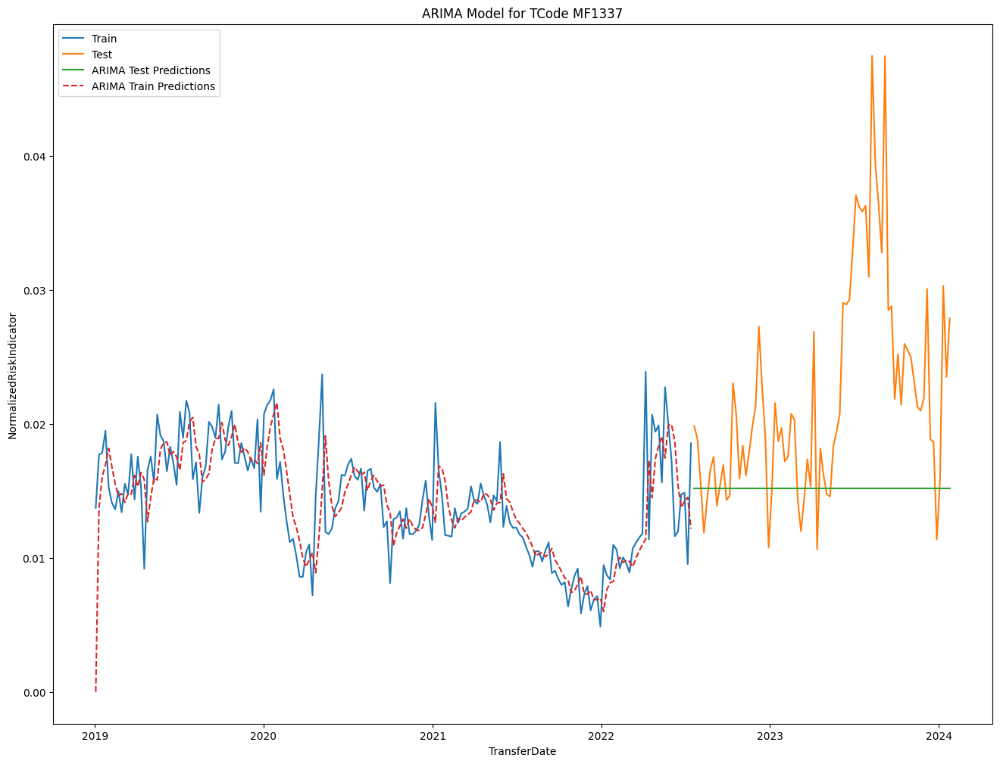

In [124]:
df_MF1337 = df_Non_OA[df_Non_OA['TCode'] == 'MF1337']

df_MF1337['TransferDate'] = pd.to_datetime(df_MF1337['TransferDate'])

train_size_MF1337 = int(len(df_MF1337) * 0.7)
train_MF1337, test_MF1337 = df_MF1337[:train_size_MF1337], df_MF1337[train_size_MF1337:]

from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt


stepwise_fit_MF1337 = auto_arima(train_MF1337['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

optimal_order_MF1337 = stepwise_fit_MF1337.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_MF1337}")

arima_model_MF1337 = ARIMA(train_MF1337['NormalizedRiskIndicator'], order=optimal_order_MF1337)
arima_fit_MF1337 = arima_model_MF1337.fit()

train_predictions_MF1337 = arima_fit_MF1337.predict(start=0, end=len(train_MF1337) - 1, typ='levels')

test_predictions_MF1337 = arima_fit_MF1337.predict(start=len(train_MF1337), end=len(train_MF1337) + len(test_MF1337) - 1, typ='levels')

plt.plot(train_MF1337['TransferDate'], train_MF1337['NormalizedRiskIndicator'], label='Train')
plt.plot(test_MF1337['TransferDate'], test_MF1337['NormalizedRiskIndicator'], label='Test')
plt.plot(test_MF1337['TransferDate'], test_predictions_MF1337, label='ARIMA Test Predictions')
plt.plot(train_MF1337['TransferDate'], train_predictions_MF1337, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1337')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()



In [125]:
# Forecast the next 4 weeks
forecast_period = 4

# Get the forecast
forecast_MF1337 = arima_fit_MF1337.get_forecast(steps=forecast_period)

# Extract forecasted values and confidence intervals
forecast_values_MF1337 = forecast_MF1337.predicted_mean
conf_int_MF1337 = forecast_MF1337.conf_int()

# Create a dataframe for the forecast
forecast_df_MF1337 = pd.DataFrame({
    'TransferDate': pd.date_range(start=df_Non_OA['TransferDate'].max(), periods=forecast_period, freq='W'),
    'Forecasted_Indicator': forecast_values_MF1337,
    'Lower_CI': conf_int_MF1337.iloc[:, 0],
    'Upper_CI': conf_int_MF1337.iloc[:, 1]
})

# Print the forecasted values and confidence intervals
print(forecast_df_MF1337)


    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28              0.015187  0.009722  0.020651
186   2024-02-04              0.015187  0.009147  0.021227
187   2024-02-11              0.015187  0.008622  0.021751
188   2024-02-18              0.015187  0.008136  0.022237


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [126]:
# Assuming you have the actual values for the train and test sets
train_actual_values_MF1337 = train_MF1337['NormalizedRiskIndicator'].values
test_actual_values_MF1337 = test_MF1337['NormalizedRiskIndicator'].values

# Calculate MAE, MSE, RMSE, and MAPE for the train set
train_mae_MF1337 = mean_absolute_error(train_actual_values_MF1337, train_predictions_MF1337)
train_mse_MF1337 = mean_squared_error(train_actual_values_MF1337, train_predictions_MF1337)
train_rmse_MF1337 = np.sqrt(train_mse_MF1337)
train_mape_MF1337 = np.mean(np.abs((train_actual_values_MF1337 - train_predictions_MF1337) / train_actual_values_MF1337)) * 100

# Calculate MAE, MSE, RMSE, and MAPE for the test set
test_mae_MF1337 = mean_absolute_error(test_actual_values_MF1337, test_predictions_MF1337)
test_mse_MF1337 = mean_squared_error(test_actual_values_MF1337, test_predictions_MF1337)
test_rmse_MF1337 = np.sqrt(test_mse_MF1337)
test_mape_MF1337 = np.mean(np.abs((test_actual_values_MF1337 - test_predictions_MF1337) / test_actual_values_MF1337)) * 100

# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae_MF1337}")
print(f"MSE: {train_mse_MF1337}")
print(f"RMSE: {train_rmse_MF1337}")
print(f"MAPE: {train_mape_MF1337}%")

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"MAE: {test_mae_MF1337}")
print(f"MSE: {test_mse_MF1337}")
print(f"RMSE: {test_rmse_MF1337}")
print(f"MAPE: {test_mape_MF1337}%")


Train Set Metrics:
MAE: 0.0020769223867922824
MSE: 8.780270318948436e-06
RMSE: 0.0029631520917678925
MAPE: 15.114918251610451%

Test Set Metrics:
MAE: 0.0076228924314112306
MSE: 0.00011243304057551914
RMSE: 0.010603444750434603
MAPE: 28.65534651453327%


ARIMA for MF1172 _ NON OVER ADVANCE CLIENT

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-901.578, Time=1.74 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-320.700, Time=0.10 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-891.852, Time=0.11 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-505.432, Time=0.15 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-902.344, Time=0.31 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-635.241, Time=0.34 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-904.500, Time=0.17 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-906.530, Time=0.26 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-901.030, Time=0.49 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=inf, Time=0.20 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=inf, Time=2.05 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-910.588, Time=1.38 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-912.330, Time=0.44 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=-827.3

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


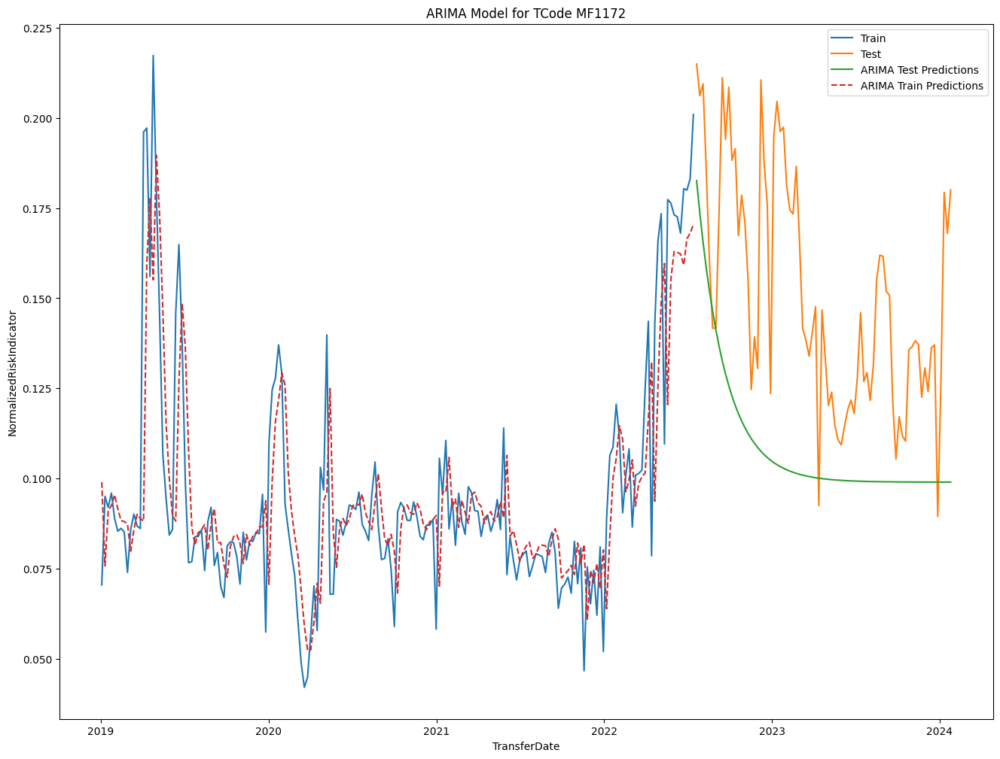

In [128]:
# Assuming df_Non_OA is your DataFrame

# Filter data for TCode MF1172
df_MF1172 = df_Non_OA[df_Non_OA['TCode'] == 'MF1172']

# Convert TransferDate to datetime format
df_MF1172['TransferDate'] = pd.to_datetime(df_MF1172['TransferDate'])

# Split data into train and test (70% rule)
train_size_MF1172 = int(len(df_MF1172) * 0.7)
train_MF1172, test_MF1172 = df_MF1172[:train_size_MF1172], df_MF1172[train_size_MF1172:]

# Import necessary libraries
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Display the process of finding p, d, q values
stepwise_fit_MF1172 = auto_arima(train_MF1172['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

# Get the optimal values
optimal_order_MF1172 = stepwise_fit_MF1172.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_MF1172}")

# Build ARIMA model with the determined parameters
arima_model_MF1172 = ARIMA(train_MF1172['NormalizedRiskIndicator'], order=optimal_order_MF1172)
arima_fit_MF1172 = arima_model_MF1172.fit()

# Predict on the train set
train_predictions_MF1172 = arima_fit_MF1172.predict(start=0, end=len(train_MF1172) - 1, typ='levels')

# Predict on the test set
test_predictions_MF1172 = arima_fit_MF1172.predict(start=len(train_MF1172), end=len(train_MF1172) + len(test_MF1172) - 1, typ='levels')

# Plot the results
plt.plot(train_MF1172['TransferDate'], train_MF1172['NormalizedRiskIndicator'], label='Train')
plt.plot(test_MF1172['TransferDate'], test_MF1172['NormalizedRiskIndicator'], label='Test')
plt.plot(test_MF1172['TransferDate'], test_predictions_MF1172, label='ARIMA Test Predictions')
plt.plot(train_MF1172['TransferDate'], train_predictions_MF1172, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1172')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()


In [129]:
# Forecast the next 4 weeks
forecast_period = 4

# Get the forecast
forecast_MF1172 = arima_fit_MF1172.get_forecast(steps=forecast_period)

# Extract forecasted values and confidence intervals
forecast_values_MF1172 = forecast_MF1172.predicted_mean
conf_int_MF1172 = forecast_MF1172.conf_int()

# Create a dataframe for the forecast
forecast_df_MF1172 = pd.DataFrame({
    'TransferDate': pd.date_range(start=df_Non_OA['TransferDate'].max(), periods=forecast_period, freq='W'),
    'Forecasted_Indicator': forecast_values_MF1172,
    'Lower_CI': conf_int_MF1172.iloc[:, 0],
    'Upper_CI': conf_int_MF1172.iloc[:, 1]
})

# Print the forecasted values and confidence intervals
print(forecast_df_MF1172)


    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28              0.182628  0.143371  0.221885
186   2024-02-04              0.173626  0.126771  0.220480
187   2024-02-11              0.165593  0.113475  0.217710
188   2024-02-18              0.158425  0.102469  0.214380


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [130]:
# Assuming you have the actual values for the train and test sets
train_actual_values_MF1172 = train_MF1172['NormalizedRiskIndicator'].values
test_actual_values_MF1172 = test_MF1172['NormalizedRiskIndicator'].values

# Calculate MAE, MSE, RMSE, and MAPE for the train set
train_mae_MF1172 = mean_absolute_error(train_actual_values_MF1172, train_predictions_MF1172)
train_mse_MF1172 = mean_squared_error(train_actual_values_MF1172, train_predictions_MF1172)
train_rmse_MF1172 = np.sqrt(train_mse_MF1172)
train_mape_MF1172 = np.mean(np.abs((train_actual_values_MF1172 - train_predictions_MF1172) / train_actual_values_MF1172)) * 100

# Calculate MAE, MSE, RMSE, and MAPE for the test set
test_mae_MF1172 = mean_absolute_error(test_actual_values_MF1172, test_predictions_MF1172)
test_mse_MF1172 = mean_squared_error(test_actual_values_MF1172, test_predictions_MF1172)
test_rmse_MF1172 = np.sqrt(test_mse_MF1172)
test_mape_MF1172 = np.mean(np.abs((test_actual_values_MF1172 - test_predictions_MF1172) / test_actual_values_MF1172)) * 100

# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae_MF1172}")
print(f"MSE: {train_mse_MF1172}")
print(f"RMSE: {train_rmse_MF1172}")
print(f"MAPE: {train_mape_MF1172}%")

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"MAE: {test_mae_MF1172}")
print(f"MSE: {test_mse_MF1172}")
print(f"RMSE: {test_rmse_MF1172}")
print(f"MAPE: {test_mape_MF1172}%")


Train Set Metrics:
MAE: 0.013339364370155248
MSE: 0.0004044054288710786
RMSE: 0.020109834133355715
MAPE: 14.032496295262465%

Test Set Metrics:
MAE: 0.04266702482945762
MSE: 0.0024958736894983855
RMSE: 0.049958719854479715
MAPE: 26.509568193622872%


ARIMA ffor MF1365 NON OVER ADVNACE CLIENTS

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-1502.783, Time=2.63 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-1466.144, Time=0.21 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-1494.658, Time=0.20 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-1501.339, Time=0.76 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-1468.078, Time=0.07 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-1497.393, Time=1.13 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-1495.270, Time=0.74 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=-1493.273, Time=1.42 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=-1500.001, Time=0.37 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-1498.633, Time=0.42 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=-1500.048, Time=0.56 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=-1496.789, Time=0.31 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=-1495.793, Time=1.14 sec
 ARIMA(2,1,2)(0,0,0)[0]             : AIC=-1504.125, Time=1.05 sec
 ARIMA(1,1,2)(0,0,0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


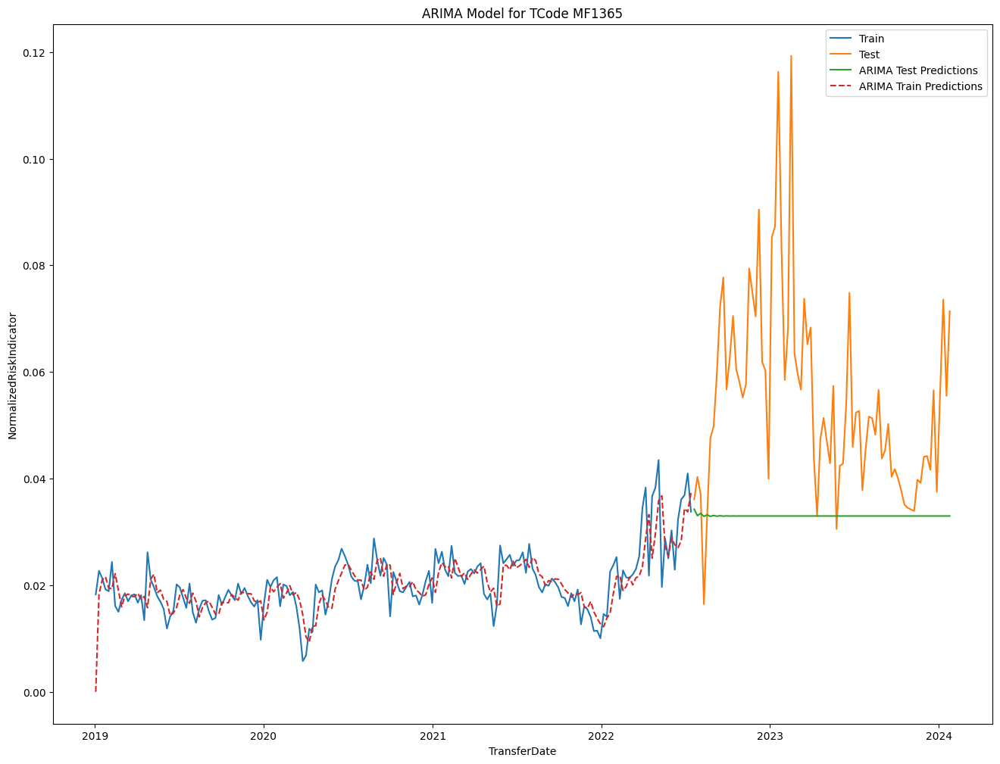

In [132]:
# Filter data for TCode MF1365
df_MF1365 = df_Non_OA[df_Non_OA['TCode'] == 'MF1365']

# Convert TransferDate to datetime format
df_MF1365['TransferDate'] = pd.to_datetime(df_MF1365['TransferDate'])

# Split data into train and test (70% rule)
train_size_MF1365 = int(len(df_MF1365) * 0.7)
train_MF1365, test_MF1365 = df_MF1365[:train_size_MF1365], df_MF1365[train_size_MF1365:]

# Import necessary libraries
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Display the process of finding p, d, q values
stepwise_fit_MF1365 = auto_arima(train_MF1365['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

# Get the optimal values
optimal_order_MF1365 = stepwise_fit_MF1365.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_MF1365}")

# Build ARIMA model with the determined parameters
arima_model_MF1365 = ARIMA(train_MF1365['NormalizedRiskIndicator'], order=optimal_order_MF1365)
arima_fit_MF1365 = arima_model_MF1365.fit()

# Predict on the train set
train_predictions_MF1365 = arima_fit_MF1365.predict(start=0, end=len(train_MF1365) - 1, typ='levels')

# Predict on the test set
test_predictions_MF1365 = arima_fit_MF1365.predict(start=len(train_MF1365), end=len(train_MF1365) + len(test_MF1365) - 1, typ='levels')

# Plot the results
plt.plot(train_MF1365['TransferDate'], train_MF1365['NormalizedRiskIndicator'], label='Train')
plt.plot(test_MF1365['TransferDate'], test_MF1365['NormalizedRiskIndicator'], label='Test')
plt.plot(test_MF1365['TransferDate'], test_predictions_MF1365, label='ARIMA Test Predictions')
plt.plot(train_MF1365['TransferDate'], train_predictions_MF1365, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1365')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()



In [133]:
# Forecast the next 4 weeks
forecast_period = 4

# Get the forecast
forecast_MF1365 = arima_fit_MF1365.get_forecast(steps=forecast_period)

# Extract forecasted values and confidence intervals
forecast_values_MF1365 = forecast_MF1365.predicted_mean
conf_int_MF1365 = forecast_MF1365.conf_int()

# Create a dataframe for the forecast
forecast_df_MF1365 = pd.DataFrame({
    'TransferDate': pd.date_range(start=df_Non_OA['TransferDate'].max(), periods=forecast_period, freq='W'),
    'Forecasted_Indicator': forecast_values_MF1365,
    'Lower_CI': conf_int_MF1365.iloc[:, 0],
    'Upper_CI': conf_int_MF1365.iloc[:, 1]
})

# Print the forecasted values and confidence intervals
print(forecast_df_MF1365)


    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28              0.034262  0.026536  0.041988
186   2024-02-04              0.033042  0.024298  0.041785
187   2024-02-11              0.033478  0.023822  0.043135
188   2024-02-18              0.032907  0.022891  0.042924


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [134]:
# Assuming you have the actual values for the train and test sets
train_actual_values_MF1365 = train_MF1365['NormalizedRiskIndicator'].values
test_actual_values_MF1365 = test_MF1365['NormalizedRiskIndicator'].values

# Calculate MAE, MSE, RMSE, and MAPE for the train set
train_mae_MF1365 = mean_absolute_error(train_actual_values_MF1365, train_predictions_MF1365)
train_mse_MF1365 = mean_squared_error(train_actual_values_MF1365, train_predictions_MF1365)
train_rmse_MF1365 = np.sqrt(train_mse_MF1365)
train_mape_MF1365 = np.mean(np.abs((train_actual_values_MF1365 - train_predictions_MF1365) / train_actual_values_MF1365)) * 100

# Calculate MAE, MSE, RMSE, and MAPE for the test set
test_mae_MF1365 = mean_absolute_error(test_actual_values_MF1365, test_predictions_MF1365)
test_mse_MF1365 = mean_squared_error(test_actual_values_MF1365, test_predictions_MF1365)
test_rmse_MF1365 = np.sqrt(test_mse_MF1365)
test_mape_MF1365 = np.mean(np.abs((test_actual_values_MF1365 - test_predictions_MF1365) / test_actual_values_MF1365)) * 100

# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae_MF1365}")
print(f"MSE: {train_mse_MF1365}")
print(f"RMSE: {train_rmse_MF1365}")
print(f"MAPE: {train_mape_MF1365}%")

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"MAE: {test_mae_MF1365}")
print(f"MSE: {test_mse_MF1365}")
print(f"RMSE: {test_rmse_MF1365}")
print(f"MAPE: {test_mape_MF1365}%")


Train Set Metrics:
MAE: 0.002907061341933882
MSE: 1.7330327616014827e-05
RMSE: 0.004162971008308228
MAPE: 15.283948995360117%

Test Set Metrics:
MAE: 0.02220362337668049
MSE: 0.0007963945920130361
RMSE: 0.028220464064452166
MAPE: 35.82721533719195%


ARIMA for MF1510 _NON OVER ADVANCE CLIENT

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-1295.424, Time=0.94 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-1259.790, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-1291.133, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-1301.832, Time=0.15 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-1261.466, Time=0.06 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-1299.740, Time=0.56 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-1299.995, Time=0.53 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-1297.718, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-1302.642, Time=0.21 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-1300.539, Time=0.20 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-1300.736, Time=0.35 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-1292.553, Time=0.12 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-1298.709, Time=0.44 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 3.969 seconds
Optimal (

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


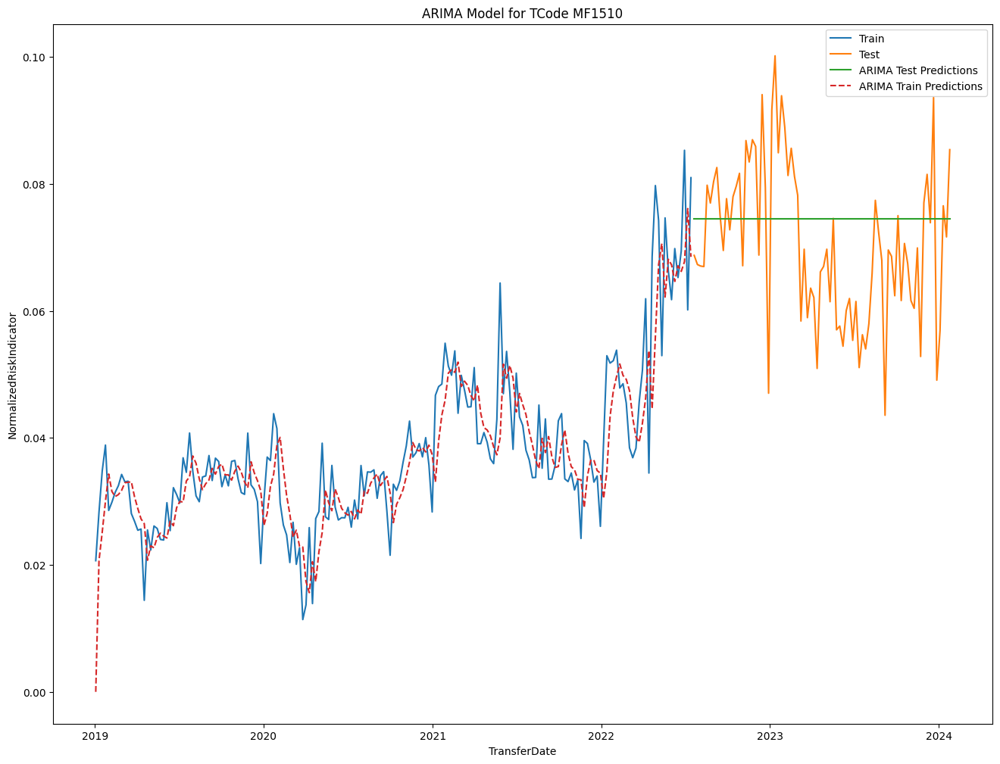

In [136]:
# Filter data for TCode MF1510
df_MF1510 = df_Non_OA[df_Non_OA['TCode'] == 'MF1510']

# Convert TransferDate to datetime format
df_MF1510['TransferDate'] = pd.to_datetime(df_MF1510['TransferDate'])

# Split data into train and test (70% rule)
train_size_MF1510 = int(len(df_MF1510) * 0.7)
train_MF1510, test_MF1510 = df_MF1510[:train_size_MF1510], df_MF1510[train_size_MF1510:]

# Import necessary libraries
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Display the process of finding p, d, q values
stepwise_fit_MF1510 = auto_arima(train_MF1510['NormalizedRiskIndicator'], suppress_warnings=True, seasonal=False, trace=True)

# Get the optimal values
optimal_order_MF1510 = stepwise_fit_MF1510.get_params()['order']
print(f"Optimal (p, d, q) values: {optimal_order_MF1510}")

# Build ARIMA model with the determined parameters
arima_model_MF1510 = ARIMA(train_MF1510['NormalizedRiskIndicator'], order=optimal_order_MF1510)
arima_fit_MF1510 = arima_model_MF1510.fit()

# Predict on the train set
train_predictions_MF1510 = arima_fit_MF1510.predict(start=0, end=len(train_MF1510) - 1, typ='levels')

# Predict on the test set
test_predictions_MF1510 = arima_fit_MF1510.predict(start=len(train_MF1510), end=len(train_MF1510) + len(test_MF1510) - 1, typ='levels')

# Plot the results
plt.plot(train_MF1510['TransferDate'], train_MF1510['NormalizedRiskIndicator'], label='Train')
plt.plot(test_MF1510['TransferDate'], test_MF1510['NormalizedRiskIndicator'], label='Test')
plt.plot(test_MF1510['TransferDate'], test_predictions_MF1510, label='ARIMA Test Predictions')
plt.plot(train_MF1510['TransferDate'], train_predictions_MF1510, label='ARIMA Train Predictions', linestyle='dashed')
plt.title('ARIMA Model for TCode MF1510')
plt.xlabel('TransferDate')
plt.ylabel('NormalizedRiskIndicator')
plt.legend()
plt.show()


In [137]:
# Forecast the next 4 weeks for TCode MF1510
forecast_period = 4

# Get the forecast
forecast_MF1510 = arima_fit_MF1510.get_forecast(steps=forecast_period)

# Extract forecasted values and confidence intervals
forecast_values_MF1510 = forecast_MF1510.predicted_mean
conf_int_MF1510 = forecast_MF1510.conf_int()

# Create a dataframe for the forecast
forecast_df_MF1510 = pd.DataFrame({
    'TransferDate': pd.date_range(start=df_Non_OA['TransferDate'].max(), periods=forecast_period, freq='W'),
    'Forecasted_Indicator': forecast_values_MF1510,
    'Lower_CI': conf_int_MF1510.iloc[:, 0],
    'Upper_CI': conf_int_MF1510.iloc[:, 1]
})

# Print the forecasted values and confidence intervals
print(forecast_df_MF1510)


    TransferDate  Forecasted_Indicator  Lower_CI  Upper_CI
185   2024-01-28               0.07447  0.060875  0.088065
186   2024-02-04               0.07447  0.059412  0.089528
187   2024-02-11               0.07447  0.058079  0.090861
188   2024-02-18               0.07447  0.056847  0.092093


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [138]:
# Assuming you have the actual values for the train and test sets
train_actual_values_MF1510 = train_MF1510['NormalizedRiskIndicator'].values
test_actual_values_MF1510 = test_MF1510['NormalizedRiskIndicator'].values

# Calculate MAE, MSE, RMSE, and MAPE for the train set
train_mae_MF1510 = mean_absolute_error(train_actual_values_MF1510, train_predictions_MF1510)
train_mse_MF1510 = mean_squared_error(train_actual_values_MF1510, train_predictions_MF1510)
train_rmse_MF1510 = np.sqrt(train_mse_MF1510)
train_mape_MF1510 = np.mean(np.abs((train_actual_values_MF1510 - train_predictions_MF1510) / train_actual_values_MF1510)) * 100

# Calculate MAE, MSE, RMSE, and MAPE for the test set
test_mae_MF1510 = mean_absolute_error(test_actual_values_MF1510, test_predictions_MF1510)
test_mse_MF1510 = mean_squared_error(test_actual_values_MF1510, test_predictions_MF1510)
test_rmse_MF1510 = np.sqrt(test_mse_MF1510)
test_mape_MF1510 = np.mean(np.abs((test_actual_values_MF1510 - test_predictions_MF1510) / test_actual_values_MF1510)) * 100

# Print the evaluation metrics for the train set
print("Train Set Metrics:")
print(f"MAE: {train_mae_MF1510}")
print(f"MSE: {train_mse_MF1510}")
print(f"RMSE: {train_rmse_MF1510}")
print(f"MAPE: {train_mape_MF1510}%")

# Print the evaluation metrics for the test set
print("\nTest Set Metrics:")
print(f"MAE: {test_mae_MF1510}")
print(f"MSE: {test_mse_MF1510}")
print(f"RMSE: {test_rmse_MF1510}")
print(f"MAPE: {test_mape_MF1510}%")


Train Set Metrics:
MAE: 0.005299999507142662
MSE: 5.031293118145095e-05
RMSE: 0.007093160873788988
MAPE: 15.001191029138926%

Test Set Metrics:
MAE: 0.010622463229983456
MSE: 0.0001637902885693059
RMSE: 0.012798057999919593
MAPE: 16.541560452226857%
